# This notebook simulates a simple mountain island eroded across seasons of intense rainfall


figured out that scipy zoom really makes the figures shine

***The key is to introduce nonlinear water erosion***

***There is an island surrounded by ocean on a continental plateau**


## Principles:

* The land starts as rock

* Rain falls on a random set of figures at every step

* Rain flows downhill, and can barely scratch the rock, but drags the gravel along

* The temperature is determined by height

* Rain freezes to glacier if it's below zero

* Glaciers destroy the rock into gravel below them

* Glaciers flow downhill slowly

* When above zero, a glacier melts at a constant rate


In [74]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
# %matplotlib widget
# %matplotlib notebook
import matplotlib as mpl

import scipy.signal as signal
import scipy.ndimage as ndimage
import numba
from numba import jit, njit
import popdyn
import popdyn.convolve as cv
import copy
from importlib import reload
import matplotlib.animation as animation
from IPython.display import HTML

import skimage.transform as sktransform 
from skimage import color, morphology

plt.rcParams["animation.html"] = "jshtml"

import pickle

# Making a mountainside

In [75]:
def distance_kernel(half_extent=50):
    size = half_extent * 2 + 1
    kernel = np.zeros((size, size))
    vals = np.arange(-half_extent,half_extent+1)
    xx, yy = np.meshgrid(vals, vals, indexing='xy')
    # y, x = np.ogrid[-half_extent:half_extent+1, -half_extent:half_extent+1]
    distance = np.sqrt(xx**2 + yy**2)
    return distance
    
def tophat(dists, scale=50.):
    kernel = np.zeros(dists.shape)
    kernel[dists < scale] = 1
    kernel = kernel / kernel.sum()
    return kernel

def gaussian(dists, scale=50.):
    kernel = np.zeros(dists.shape)
    kernel = np.exp(- dists**2. / (2 * scale**2.))
    kernel = kernel / kernel.sum()
    return kernel

def triangle(dists, scale=50):
    """triangle kernel, scale is when it hits zero"""
    kernel = np.zeros(dists.shape)
    kernel = scale - dists
    kernel[kernel < 0] = 0
    kernel = kernel / kernel.sum()
    return kernel

kernels = {
    "gauss": gaussian,
    "tophat": tophat,
    "triangle": triangle,
}

def make_noise_map(scale, shape, which="gauss"):
    num = shape[0] * shape[1]
    noise = np.random.uniform(size=num).reshape(shape)
    dists = distance_kernel(half_extent=scale*3)
    
    
    kern = kernels[which](dists, scale=scale)
    tmp = np.fft.irfft2(np.fft.rfft2(noise) * np.fft.rfft2(kern, noise.shape))
    tmp = tmp - tmp.min()
    tmp = tmp / tmp.max()
    
    return tmp

def convolve_map(canvas, scale, which = "gauss",):
    pad_width = scale*3
    padded = np.pad(canvas, pad_width = scale*3)
    half_extent = scale*2
    dists = distance_kernel(half_extent = half_extent)    
    kern = kernels[which](dists, scale = scale)
    
    # There's some shape difference here, which needs to be manually corrected with the padding
    # just offset the convolved image by the half_extent of the kernel...
    tmp = np.fft.irfft2(np.fft.rfft2(padded) * np.fft.rfft2(kern, padded.shape))
    tmp = tmp[pad_width+half_extent:-pad_width+half_extent, pad_width+half_extent:-pad_width+half_extent]
    return tmp

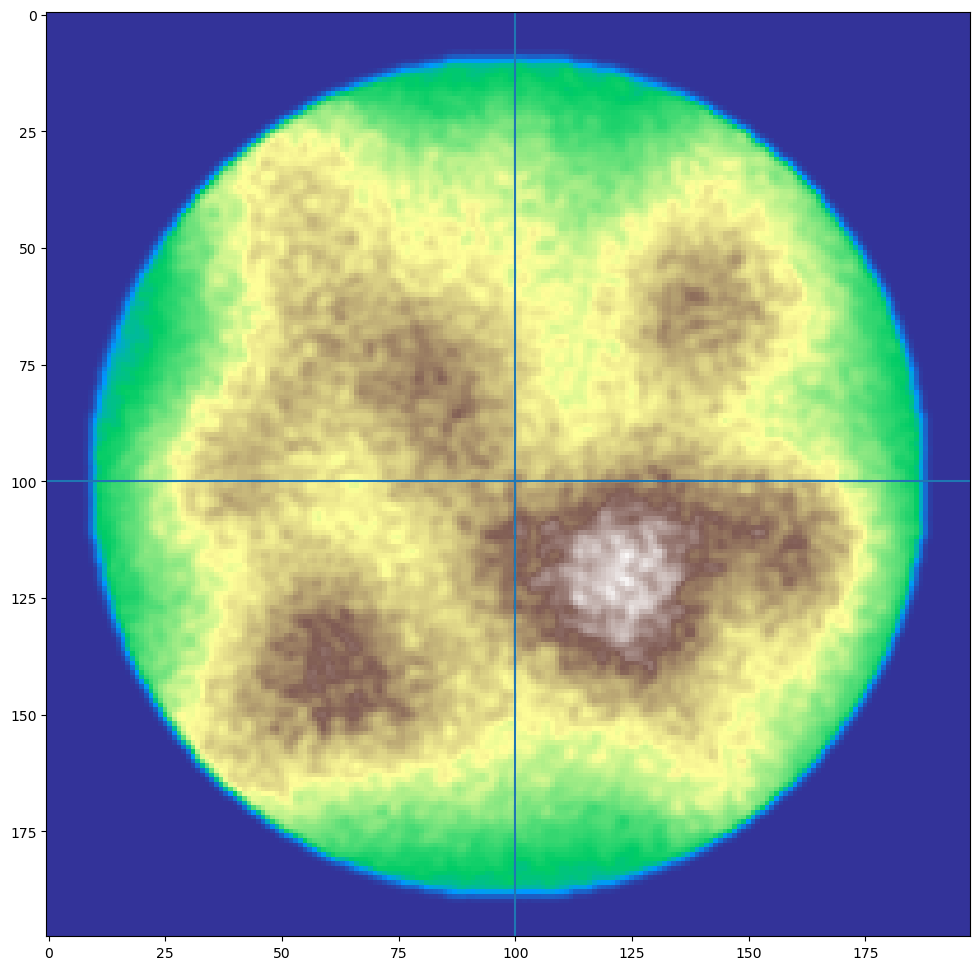

In [107]:
np.random.seed(9)
plat = np.zeros((201, 201))
dists = distance_kernel(100)
plat += tophat(dists, scale=90, ) 
plat /= plat.max()


ndraw = 200
pos = np.random.uniform(low=0.1, high=0.9, size=ndraw*2).reshape(ndraw, 2)
std = np.random.uniform(low=200, high=300, size=ndraw)
# nums = np.random.uniform(low=1, high=, size=ndraw)
nums = np.ones(ndraw) 
# std = np.ones(ndraw) * 300
samples = []
for i in np.arange(ndraw):
#     print(pos[i])
    _sample = np.random.multivariate_normal(pos[i], cov=np.eye(2) / std[i], size=int(nums[i] * 5e3))
    samples.append(_sample)
samples = np.concatenate(samples)


bins = np.linspace(0, 1, 202)
bcens = bins[:-1] + np.diff(bins) / 2
land = np.histogram2d(samples[:, 0], samples[:, 1], bins=(bins, bins), density=True)[0]

bulk = np.random.multivariate_normal((0.5, 0.5), cov=np.eye(2) * 0.4, size=int(5e7))    
bulk = np.histogram2d(bulk[:, 0], bulk[:, 1], bins=(bins, bins), density=True)[0] * 2

land += bulk
# land *= 500
# land += 1

land *= plat
land += 1
land = land**2.2

land = convolve_map(land, 1, which="gauss")
land = land[1:-2, 1:-1]
# land *= 400
land = (land - land.min()) * 4000 / land.max() + 1

land += np.random.uniform(size=land.shape) * 5


fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(111)
plt.imshow(land, cmap=plt.cm.terrain, vmin=10, vmax=4000)
plt.axhline(100)
plt.axvline(100)


In [110]:
pickle.dump(land, open("land.p", "wb"))

In [7]:
zland = ndimage.zoom(land, 1.5)
# zland = land

In [8]:
zland.shape

(297, 297)

In [9]:
zland.max()

3905.1546697969125

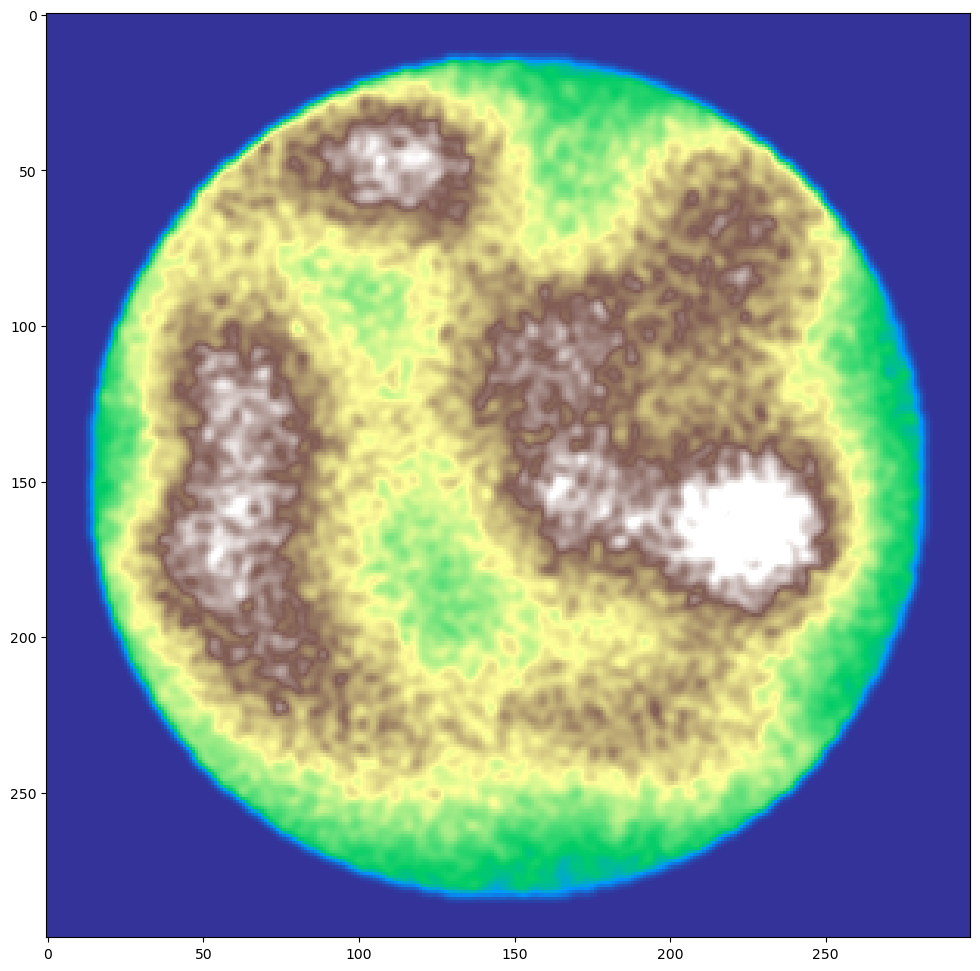

In [10]:
fig = plt.figure(figsize=(12, 12))
ax = fig.add_subplot(111)
plt.imshow(zland, cmap=plt.cm.terrain, vmin=10, vmax=3000)

# Erosion model of the mountain side

In [24]:
def calc_shifted(inmap):
    """shift up, down, left, right"""

    omap = []
    tmp = np.roll(inmap, -1, axis=0)
    tmp[-1:, :] = 0
    omap.append(tmp)

    tmp = np.roll(inmap, 1, axis=0)
    tmp[:1, :] = 0
    omap.append(tmp)

    tmp = np.roll(inmap, -1, axis=1)
    tmp[:, -1:] = 0
    omap.append(tmp)        

    tmp = np.roll(inmap, 1, axis=1)
    tmp[:, :1] = 0
    omap.append(tmp)     
    return np.array(omap)   

def calc_unshifted(inmap):
    omap = []

    tmp = np.roll(inmap[0, :, :], 1, axis=0)
    tmp[:1, :] = 0
    omap.append(tmp)

    tmp = np.roll(inmap[1, :, :], -1, axis=0)
    tmp[-1:, :] = 0
    omap.append(tmp)

    tmp = np.roll(inmap[2, :, :], 1, axis=1)
    tmp[:, :1] = 0
    omap.append(tmp)     

    tmp = np.roll(inmap[3, :, :], -1, axis=1)
    tmp[:, -1:] = 0
    omap.append(tmp)        

    return np.array(omap)

def center_cut(arr):
    return arr[1:-1, 1:-1]

def null_edges(arr, depth=1, value=0):
    arr[:depth, :] = value
    arr[:, :depth] = value
    arr[:, -depth:] = value
    arr[-depth:, :] = value
    return arr

In [25]:
arr = np.arange(49).reshape(7, 7)
null_edges(arr, depth=1, value=400)

array([[400, 400, 400, 400, 400, 400, 400],
       [400,   8,   9,  10,  11,  12, 400],
       [400,  15,  16,  17,  18,  19, 400],
       [400,  22,  23,  24,  25,  26, 400],
       [400,  29,  30,  31,  32,  33, 400],
       [400,  36,  37,  38,  39,  40, 400],
       [400, 400, 400, 400, 400, 400, 400]])

In [26]:
%timeit calc_shifted(arr)

24.8 µs ± 259 ns per loop (mean ± std. dev. of 7 runs, 10000 loops each)


In [27]:
def pad(canvases):
    """padsfor each canvas pad the 2d array"""
    keys = canvases.keys()
    padded_canvases = {}
    for key in keys:
        arr = canvases[key]
        arr = np.pad(arr, pad_width=1, mode="edge")
        padded_canvases.update({key: arr})
    return padded_canvases

class CellSpace(object):
    def __init__(self, initial_maps, rules):
        """
        Cell automata, considers the direct neighbor cells only
        
        Initialize with a dict of initial maps in the style
        
        initial_maps = {
            "layer_name": initial map,
        }
        
        The rules are a similar dictionary of class instances which will be passed 
        
        
        """
        self.canvases = copy.deepcopy(initial_maps)
        self.layers = list(initial_maps.keys())
        self.padded_canvases = pad(self.canvases)

        self.shape_canvas = self.canvases[self.layers[0]].shape
        self.shape_canvas_padded = self.padded_canvases[self.layers[0]].shape
    
        self.imap = np.arange(len(self.canvases[self.layers[0]].flatten())).reshape(self.shape_canvas)
        self.imap_padded = np.arange(len(self.padded_canvases[self.layers[0]].flatten())).reshape(self.shape_canvas_padded)
        self.imap_center = center_cut(self.imap_padded)
        self.imap_shifted = [center_cut(tmp) for tmp in calc_shifted(self.imap_padded)]
        self.imap_unshifted = [
            self.imap_shifted[1],
            self.imap_shifted[0],
            self.imap_shifted[3],
            self.imap_shifted[2],
        ]
        
        self.shifted_canvases = self.shift()
        self.rules = rules
        
        self.maps = {}
        self.reset_maps()
            
    def update_maps(self):
        for key in self.layers:
            self.maps[key].append(self.canvases[key].copy())
            
    def reset_maps(self):
        self.maps = {}
        for key in self.layers:
#             dd = {key: [self.canvases[key],]}
            dd = {key: []}
            self.maps.update(dd)            
       
    def shift(self):
        shifted_canvases = {}
        for key in self.canvases.keys():
            arr = np.array([self.padded_canvases[key].flat[ii] for ii in self.imap_shifted])
            shifted_canvases.update({key: arr})
        return shifted_canvases
            
            
    def step(self):
        
        new_canvases = {}
        for rule in self.rules:
            canvas = rule.evolve(self)
            new_canvases.update(canvas)
            
        self.canvases = new_canvases
        self.padded_canvases = pad(self.canvases)
        self.shifted_canvases = self.shift()


    def flow(self, nstep=100, savestep=5):
        """
        a series of steps
        """
        self.reset_maps()
        self.update_maps()
        for i in np.arange(nstep):
#             print(str(i) + ' out of ' + str(nstep-1), end="\r")
            print(str(i) + ' out of ' + str(nstep-1), end="\n")
            self.step()
            if i % savestep == 0:
                self.update_maps()

In [30]:
class FlowRule(object):
    def __init__(self, flow_factor=0.5):
        """
        The way this automata is set up is with a walled boundary condition, matter can flow to the edges, but not out of it
        Therefore matter is conserved in the canvas. That's good
        
        An erosion factor of 1 makes a really unstable checkerboard behaviour, use smaller values for a balanced behaviour,
        """
        self.layers = np.sort(("terrain",))
        self.key = "terrain"
#         self.needed_keys ["terrain",]
        if flow_factor >= 1:
            raise ValueError("flow_factor must be less than 1, current value is {:.3f}".format(flow_factor))
        self.flow_factor = flow_factor
        
    def evolve(self, cell):
        height_local = cell.canvases[self.key]
        height_shifted = cell.shifted_canvases[self.key]
        
        diffs = height_local - height_shifted
#         diffs[diffs < 0] = 0
        diffs[diffs < diffs.max(axis=0)] = 0. 
#         fractions = np.nan_to_num(diffs / diffs.sum(axis=0))
        
        outflow = diffs * self.flow_factor # this is the outgoing amount
#         print(outflow)
        height_local = self.calc_flows(height_local, outflow, cell)
        resdict = cell.canvases
        resdict.update({self.key: height_local})
        return resdict

    def _calc_flows(self, vmap, outflow, cell):
        shifted_landslide = [] 
        for i, ii in enumerate(cell.imap_unshifted):
            # the padding here is what restricts the landslide to the frozen boundary condition
            tmp = np.pad(outflow[i], pad_width=1, mode="constant", constant_values=0)
            tmp = tmp.flat[ii]
            shifted_landslide.append(tmp)
        shifted_landslide = np.array(shifted_landslide)
        return shifted_landslide.sum(axis=0)
    
    def calc_flows(self, vmap, outflow, cell):
        vmap -= outflow.sum(axis=0)
        vmap += self._calc_flows(vmap, outflow, cell)
        return vmap
         
        
class RainFallClosed(FlowRule):
    def __init__(self, net_water=1e5, fraction=0.2, seed=10, net_evap=0.0, **kwargs):
        """
        This is adds new rain water to the water canvas
    
        """
        self.layers = np.sort(("water",))
        self.key = "water"
        self.net_water = net_water
        self.fraction = fraction
        self.net_evap = net_evap
        self.rng = np.random.RandomState(seed)

    def evolve(self,  cell):
        water_local = cell.canvases[self.key]

        sshape = water_local.shape
        darea = sshape[0] * sshape[1]
        rainmap = np.ones(shape=sshape) * self.net_water / darea
        water_local += rainmap
        print(rainmap.sum())
        resdict = cell.canvases
        resdict.update({self.key: water_local})
        return resdict              

    
class RainBurst(FlowRule):
    def __init__(self, net_water=1e5, burst_step=40, seed=10, **kwargs):
        """
        This is adds new rain water to the water canvas
    
        """
        self.layers = np.sort(("water",))
        self.key = "water"
        self.net_water = net_water
        self.burst_step = burst_step
        self.step = 0
        self.rng = np.random.RandomState(seed)

    def evolve(self,  cell):
        resdict = cell.canvases
        
        if self.step % self.burst_step == 0:
            water_local = cell.canvases[self.key]
            sshape = water_local.shape
            darea = sshape[0] * sshape[1]
            rainmap = np.ones(shape=sshape) * self.net_water / darea
            water_local += rainmap
            print(rainmap.sum())
            resdict.update({self.key: water_local})
            
        self.step += 1
        return resdict              
    
#     def evolve(self,  cell):
#         water_local = cell.canvases[self.key]
        
#         # so far this is the evaporation and outflow
# #         if self.net_evap > 0:
# #             water_local -= self.net_evap
# #             water_local[water_local < 0] = 0.
# #         water_local = null_edges(water_local) # this is the flow out of the box
# #         if (water_tmp < 0).sum():
# #             raise ValueError("water should never be negative")
            
# #         net_rainfall = self.net_water - water_local.sum()
# #         print(net_rainfall)
# #         if net_rainfall > 0:
# #             rmax = 100
# #             rainmap = np.random.random(size=water_local.shape) * rmax
# #             rpiv = rmax * (1 - self.fraction)
# #             rainmap[rainmap <= rpiv] = 0.
# #             ii = rainmap > rpiv
# #             rainmap[ii] = net_rainfall / ii.sum()
# #             print(net_rainfall / ii.sum())

# #         print(water_local.sum(), water_tmp.sum())
# #         print("net_rainfall", net_rainfall)
# #         if (net_rainfall  < 0).sum():
# #             raise ValueError("rainfall should never be negative")
#         water_local += rainmap
            
# #         print("SUM", water_local.sum(), self.net_water)
        
#         resdict = cell.canvases
#         resdict.update({self.key: water_local})
#         return resdict               
        


In [31]:
arr = np.linspace(0, 5000, 100)

In [32]:
def temperature(vals, h2k=3000, temperature_2k=0., temperature0=20):
    res = (temperature_2k - temperature0) / h2k * vals + temperature0
    return res

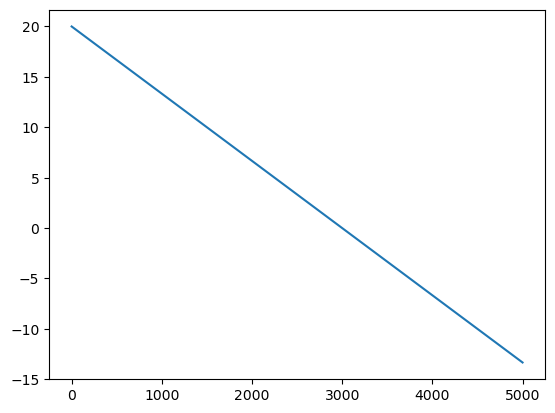

In [33]:
plt.plot(arr, temperature(arr))

In [70]:
   
class IceWaterGravelFlow(FlowRule):
    def __init__(self, altitude=10000, water_flow_rate=0.5, land_coerosion_rate=0.1,
                 drag_coeff=0.1, gravel_factor=4, flow_limit=10.,
                 ice_fracturing_rate=0.1, ice_melt_rate=0.05, ice_melt_min=40, ice_flow_rate=0.05,
                 ice_freeze_t=0, ice_melt_t=0,
                 temperature0=30, temperature_2k=0, h2k=3000.
                ):
        """
        This is a four component erosion model with glaciers
        
        This is a three component erosion model where water flows fast, and drags a fraction of the land with it
        Any land once dragged, will becone gravel, which erodes very easily
        
        wflow_rate is the water flaw per time step
        lflow rate is the land coerosion per time step, this should be much smaller than the water flow rate
        gravel_factor is the multiplier to the land coerosion rate
        
        The local gradient step is determined by the total land plus water height,
        and each component is dragged separately
        
        this is the lazy river approximation, where the velocity of water is negligible. Perhaps this is a mistake
        
        """
        self.layers = np.sort(("rock", "gravel" , "water", "ice", "temperature"))
        self.wkey = "water"
        self.lkey = "rock"
        self.gkey = "gravel"
        self.ikey = "ice"
        self.tkey = "temperature"
        self.water_flow_rate = water_flow_rate
        self.land_coerosion_rate = land_coerosion_rate
        self.drag_coeff = drag_coeff
        self.gravel_factor = gravel_factor
        self.ice_fracturing_rate = ice_fracturing_rate
        self.ice_melt_rate = ice_melt_rate
        self.ice_melt_min = ice_melt_min
        self.ice_flow_rate = ice_flow_rate
        self.altitude = altitude
        self.ice_freeze_t = ice_freeze_t
        self.ice_melt_t = ice_melt_t
        
        self.temperature0 = temperature0
        self.temperature_2k = temperature_2k
        self.h2k = h2k
        
    def get_temperature_map(self, height_local):
        res = (self.temperature_2k - self.temperature0) / self.h2k * height_local + self.temperature0
#         print(res)
        return res
    
    
    def freezing(self, ice, temp, water):
        """
        This is actually melting and freezing melting is negative freezing
        
        Ice has some time to melt, and to freeze,
        this is a self similar proportional process, with a minimum cutoff step
        """
        
        meltwater = np.zeros(ice.shape)
        newice = np.zeros(ice.shape)
        
        imelt = np.where(temp > self.ice_melt_t)
        ifreeze = np.where(temp < self.ice_freeze_t)
#         print(temp[imelt].mean())
#         print(temp[ifreeze].mean())
        
        meltwater[imelt] = ice[imelt] * self.ice_melt_rate
        ii = np.where(meltwater[imelt] < self.ice_melt_min)
        meltwater[imelt][ii] = ice[imelt][ii] # this cuts off the iteration process for melting graciers
        
        newice[ifreeze] = water[ifreeze] * self.ice_melt_rate
        ii = np.where(newice[ifreeze] < self.ice_melt_min)
        newice[ifreeze][ii] = water[ifreeze][ii] # this cuts off the iteration process for freezing glaciers        
        
        # This is just a two field component continuity equation
        ice += (newice - meltwater)
        water -= (newice - meltwater)
        
        return ice, water
                 
    
    def local_evolve(self,
                     rock_local, rock_shifted,
                     gravel_local, gravel_shifted,
                     water_local, water_shifted,
                     ice_local, ice_shifted
                    ):
        
        temp_height_local = rock_local + gravel_local
        temp_local = self.get_temperature_map(temp_height_local) # temperature is static, it matter locally only
        ice_local, water_local = self.freezing(ice_local, temp_local, water_local)
        water_shifted = cell.shifted_canvases[self.wkey]
        ice_shifted = cell.shifted_canvases[self.ikey]
        
        height_local = rock_local + gravel_local + water_local + ice_local
        height_shifted = rock_shifted + gravel_shifted + water_shifted + ice_shifted
        
#     @njit    
    def flow_water(self, diffs):
        diffs[diffs < 0] = 0
        fractions = np.nan_to_num(diffs / diffs.sum(axis=0))
        outflow_w = water_local * fractions * self.water_flow_rate
        water_local = self.calc_flows(water_local, outflow_w, cell)
        return water_local, outflow_w
            
    def evolve(self, cell):
        """
        It is interesting that the outflow direction is set by land + gravel,
        but the amount of drag possible is two
        """
        np.set_printoptions(suppress=True)

#         these are the only canvases we are going to care about at all
        rock_local = cell.canvases[self.lkey]
        rock_shifted = cell.shifted_canvases[self.lkey]
        
        gravel_local = cell.canvases[self.gkey]
        gravel_shifted = cell.shifted_canvases[self.gkey]
        
        water_local = cell.canvases[self.wkey]
        ice_local = cell.canvases[self.ikey]
        
        temp_height_local = rock_local + gravel_local
        temp_local = self.get_temperature_map(temp_height_local) # temperature is static, it matter locally only
        ice_local, water_local = self.freezing(ice_local, temp_local, water_local)
        
        water_shifted = cell.shifted_canvases[self.wkey]
        ice_shifted = cell.shifted_canvases[self.ikey]
        
        height_local = rock_local + gravel_local + water_local + ice_local
        height_shifted = rock_shifted + gravel_shifted + water_shifted + ice_shifted

#         # 1) water flows along the gradient
#         diffs = height_local - height_shifted
#         diffs[diffs < 0] = 0
#         fractions = np.nan_to_num(diffs / diffs.sum(axis=0))
#         outflow_w = water_local * fractions * self.water_flow_rate
#         water_local = self.calc_flows(water_local, outflow_w, cell)
#         # no more land can outflow than there is difference
#         # Due to the megaoutflow approximation, the water height can be VERY high, this means we need to rationalize
#         # The amount of land drag possible to an actual sensible maximum
        
#         # The rock must only eroded if there is no more gravel left... This is a really curious nonlinearity
        
#         # and now we tag on glaciers to erode the bedrock into gravel, and flow
#         outflow_i = ice_local * fractions * self.ice_flow_rate
#         ice_local = self.calc_flows(ice_local, outflow_i, cell)
#         ice_local = null_edges(ice_local)       # a glacier simply flows out of the frame and goes away to the distance 
        
        
#         # 2) the gravel flows
#         gflow_limit = gravel_local * self.drag_coeff * self.gravel_factor
#         ii = np.where(gflow_limit > 0.1 * gravel_local)
#         gflow_limit[ii] = 0.1 * gravel_local[ii]        
#         gflow_limit = np.array([gflow_limit, ] * 4) / 4.
#         outflow_g = (outflow_w + outflow_i) * self.land_coerosion_rate * self.gravel_factor
#         oufflow_g = (outflow_g / (gflow_limit * 2))**2
#         ii = outflow_g > (gflow_limit)
#         outflow_g[ii] = gflow_limit[ii]
#         print(outflow_g.mean())
#         gravel_local = self.calc_flows(gravel_local, outflow_g, cell)

#         # 3) The rock erodes from water and ice flow
#         # we have to establish the local gravel coverage
#         # The rock is eroded into gravel by the flow of water and ice
#         lflow_limit = np.sqrt(rock_local) * self.drag_coeff
#         ii = np.where(lflow_limit > 0.1 * rock_local)
#         lflow_limit[ii] = 0.1 * rock_local[ii]
#         ii = np.where(gravel_local > 0)
#         lflow_limit[ii] = 0. # This means the rock will never erode if its covered by gravel,
#         # the gravel has to flow away first in order to occur
#         lflow_limit = np.array([lflow_limit, ] * 4) / 4.
# #         lflow_limit = np.array([rock_local * self.drag_coeff,] * 4) / 4 # limit how much land can be dragged at each point
        
#         # in megaoutflow, water can pile up really high, this must be regularized
#         outflow_l = outflow_w * self.land_coerosion_rate # this is water
#         outflow_l += outflow_i * self.ice_fracturing_rate # This is ice
#         ii = outflow_l > (lflow_limit)
#         outflow_l[ii] = lflow_limit[ii]        
        
#         rock_local -= outflow_l.sum(axis=0)    
#         gravel_local += self._calc_flows(gravel_local, outflow_l, cell)
#         gravel_local = null_edges(gravel_local)

        resdict = cell.canvases
#         resdict.update({self.wkey: water_local, self.lkey: rock_local, self.gkey: gravel_local,
#                         self.ikey: ice_local, self.tkey: temp_local})
        
        np.set_printoptions(suppress=False)
        return resdict    


In [71]:
rules = (
#     RainFallClosed(net_water=2e4, fraction=0.2, net_evap=0.),
#     RainBurst(net_water=2e4, burst_step=200),
    IceWaterGravelFlow(land_coerosion_rate=0.1, water_flow_rate=0.9, drag_coeff=1, gravel_factor=4,
                       ice_fracturing_rate=0.9, ice_melt_rate=0.4, ice_melt_min=20, ice_flow_rate=0.4,
                       temperature0=20, temperature_2k=0, h2k=2500
                  ),
)
# lmap = np.pad(zland, 4) # meters in height of rock
lmap = zland  # meters in height of rock
wmap = np.zeros(shape=lmap.shape) + 500 # meters of water
gmap = np.zeros(shape=lmap.shape) # meters in height of gravel and sand
imap = np.zeros(shape=lmap.shape) # meters in height of ice glaciers
tmap = np.zeros(shape=lmap.shape) + 20. # degrees Celsius
initial_maps = {
    "rock": null_edges(lmap * 0.8),
    "gravel": null_edges(lmap * 0.2),
    "water": null_edges(wmap),
    "ice": null_edges(imap),
    "temperature": null_edges(tmap),
}

In [72]:
tag = "test_v7_seasons"
cs = CellSpace(initial_maps, rules)
cs.flow(100, savestep=77)
# 
all_rock = copy.deepcopy(cs.maps["rock"])
all_gravel = copy.deepcopy(cs.maps["gravel"])
all_waters = copy.deepcopy(cs.maps["water"])
all_ice = copy.deepcopy(cs.maps["ice"])
all_temperature = copy.deepcopy(cs.maps["temperature"])

results = {
    "rock": all_rock,
    "gravel": all_gravel,
    "waters": all_waters,
    "ice": all_ice,
    "temperature": all_temperature,    
}
pickle.dump(results, open("res_" + tag + ".p", "wb"))

0 out of 99
1 out of 99
2 out of 99
3 out of 99
4 out of 99
5 out of 99
6 out of 99
7 out of 99
8 out of 99
9 out of 99
10 out of 99
11 out of 99
12 out of 99
13 out of 99
14 out of 99
15 out of 99
16 out of 99
17 out of 99
18 out of 99
19 out of 99
20 out of 99
21 out of 99
22 out of 99
23 out of 99
24 out of 99
25 out of 99
26 out of 99
27 out of 99
28 out of 99
29 out of 99
30 out of 99
31 out of 99
32 out of 99
33 out of 99
34 out of 99
35 out of 99
36 out of 99
37 out of 99
38 out of 99
39 out of 99
40 out of 99
41 out of 99
42 out of 99
43 out of 99
44 out of 99
45 out of 99
46 out of 99
47 out of 99
48 out of 99
49 out of 99
50 out of 99
51 out of 99
52 out of 99
53 out of 99
54 out of 99
55 out of 99
56 out of 99
57 out of 99
58 out of 99
59 out of 99
60 out of 99
61 out of 99
62 out of 99
63 out of 99
64 out of 99
65 out of 99
66 out of 99
67 out of 99
68 out of 99
69 out of 99
70 out of 99
71 out of 99
72 out of 99
73 out of 99
74 out of 99
75 out of 99
76 out of 99
77 out of

In [73]:
%prun cs.flow(100)

0 out of 99
1 out of 99
2 out of 99
3 out of 99
4 out of 99
5 out of 99
6 out of 99
7 out of 99
8 out of 99
9 out of 99
10 out of 99
11 out of 99
12 out of 99
13 out of 99
14 out of 99
15 out of 99
16 out of 99
17 out of 99
18 out of 99
19 out of 99
20 out of 99
21 out of 99
22 out of 99
23 out of 99
24 out of 99
25 out of 99
26 out of 99
27 out of 99
28 out of 99
29 out of 99
30 out of 99
31 out of 99
32 out of 99
33 out of 99
34 out of 99
35 out of 99
36 out of 99
37 out of 99
38 out of 99
39 out of 99
40 out of 99
41 out of 99
42 out of 99
43 out of 99
44 out of 99
45 out of 99
46 out of 99
47 out of 99
48 out of 99
49 out of 99
50 out of 99
51 out of 99
52 out of 99
53 out of 99
54 out of 99
55 out of 99
56 out of 99
57 out of 99
58 out of 99
59 out of 99
60 out of 99
61 out of 99
62 out of 99
63 out of 99
64 out of 99
65 out of 99
66 out of 99
67 out of 99
68 out of 99
69 out of 99
70 out of 99
71 out of 99
72 out of 99
73 out of 99
74 out of 99
75 out of 99
76 out of 99
77 out of

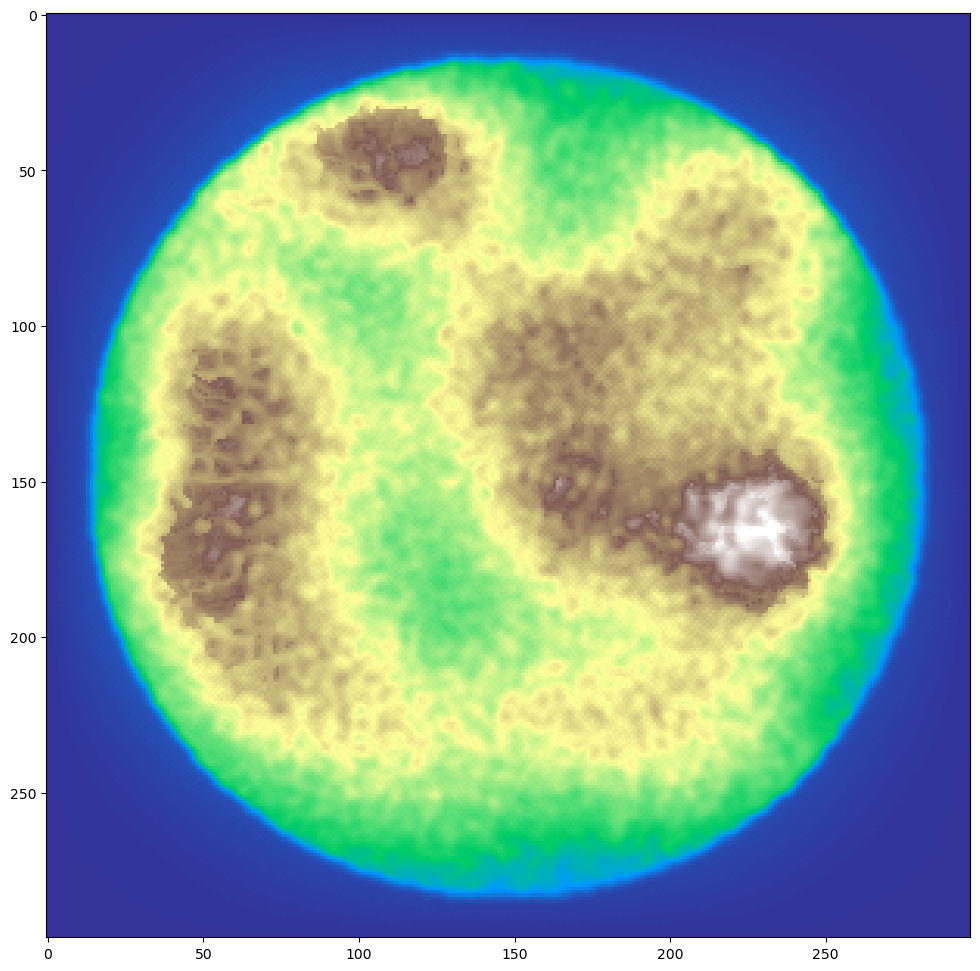

In [647]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
# plt.axis("off")

anim = True
ims = []
i = 200
# for i in np.arange(131):
tmp = all_rock[i] + all_gravel[i]
# tmp = all_gravel[i]
# tmp = all_gravel[i]
im1 = ax.imshow(tmp, cmap=plt.cm.terrain, vmin=0, vmax=3500, animated=anim)    
# im1 = ax.imshow(tmp, cmap=plt.cm.terrain, vmin=0, vmax=10, animated=anim)    
# 
alphas = all_ice[i] / 1
alphas[alphas > 1] = 1
# im2 = ax.imshow(all_ice[i], cmap=plt.cm.bone, vmin=0, vmax=20, alpha=alphas, animated=anim)

alphas = all_waters[i] / 1
alphas[alphas > 1] = 1
alphas[alphas < 0.] = 0
# alphas = alphas **1.2
# im3 = ax.imshow(all_waters[i], cmap=plt.cm.Blues, vmin=-100, vmax=100, alpha=alphas, animated=anim)

#     ims.append((im1, im2, im3))

In [569]:
def run_further(results, rules, tag, steps=20000, savestep=77):
    initial_maps = {
        "rock": null_edges(copy.deepcopy(results["rock"][-1])),
        "gravel": null_edges(copy.deepcopy(results["gravel"][-1])),
        "water": null_edges(copy.deepcopy(results["waters"][-1])),
        "ice": null_edges(copy.deepcopy(results["ice"][-1])),
        "temperature": null_edges(copy.deepcopy(results["temperature"][-1])),
    }
    
    cs = CellSpace(initial_maps, rules)
    cs.flow(steps, savestep=savestep)
    
    all_rock = copy.deepcopy(cs.maps["rock"])
    all_gravel = copy.deepcopy(cs.maps["gravel"])
    all_waters = copy.deepcopy(cs.maps["water"])
    all_ice = copy.deepcopy(cs.maps["ice"])
    all_temperature = copy.deepcopy(cs.maps["temperature"])
    
    _results = {
        "rock": all_rock,
        "gravel": all_gravel,
        "waters": all_waters,
        "ice": all_ice,
        "temperature": all_temperature,    
    }
    pickle.dump(_results, open("res_" + tag + ".p", "wb"))
    
    return _results

In [570]:
res2 = run_further(results, rules, tag="test_v2", steps=20000, savestep=77)

0 out of 19999
0.8108857671600335
1 out of 19999
0.8107008347327814
2 out of 19999
0.8106442487537332
3 out of 19999
0.8106260512443046
4 out of 19999
0.8106643433975369
5 out of 19999
0.8106481108225998
6 out of 19999
0.8104648017068175
7 out of 19999
0.8104768099340213
8 out of 19999
0.8104705458233157
9 out of 19999
0.8104022962540495
10 out of 19999
0.8102462200226195
11 out of 19999
0.8103856863182923
12 out of 19999
0.8103044177067636


/tmp/ipykernel_5224/3686957401.py:113: RuntimeWarning: invalid value encountered in true_divide
  fractions = np.nan_to_num(diffs / diffs.sum(axis=0))
/tmp/ipykernel_5224/3686957401.py:134: RuntimeWarning: invalid value encountered in true_divide
  oufflow_g = (outflow_g / (gflow_limit * 2))**2
/tmp/ipykernel_5224/3686957401.py:134: RuntimeWarning: divide by zero encountered in true_divide
  oufflow_g = (outflow_g / (gflow_limit * 2))**2


13 out of 19999
0.8103141587178164
14 out of 19999
0.8102920710609335
15 out of 19999
0.8103173566404868
16 out of 19999
0.8102896547415864
17 out of 19999
0.810270617102115
18 out of 19999
0.8100806111825191
19 out of 19999
0.8102065828607987
20 out of 19999
0.810184146015301
21 out of 19999
0.8102356028405522
22 out of 19999
0.8101089766900065
23 out of 19999
0.8102532315905362
24 out of 19999
0.8101218733353193
25 out of 19999
0.8101015613789645
26 out of 19999
0.8100524973735981
27 out of 19999
0.809963664022016
28 out of 19999
0.8099709741035361
29 out of 19999
0.8100295681560437
30 out of 19999
0.8098530856339209
31 out of 19999
0.8099130960040319
32 out of 19999
0.8098849293596877
33 out of 19999
0.8098756416661447
34 out of 19999
0.8097784877594911
35 out of 19999
0.8098959471132683
36 out of 19999
0.8097952163526042
37 out of 19999
0.8097552207681402
38 out of 19999
0.8095659230264949
39 out of 19999
0.8096456179519466
40 out of 19999
0.8096533428677172
41 out of 19999
0.80969

0.8078029895019678
247 out of 19999
0.8077816907191984
248 out of 19999
0.8077482097420395
249 out of 19999
0.8077628572481769
250 out of 19999
0.8074960834780328
251 out of 19999
0.8077014471652884
252 out of 19999
0.8075961388651312
253 out of 19999
0.8075867270844554
254 out of 19999
0.8075504046725
255 out of 19999
0.80757763806412
256 out of 19999
0.8074696010657804
257 out of 19999
0.807452747810643
258 out of 19999
0.8074390212322662
259 out of 19999
0.8073417152499364
260 out of 19999
0.8072740789813958
261 out of 19999
0.8073358110446961
262 out of 19999
0.8072614195882186
263 out of 19999
0.8072433486566871
264 out of 19999
0.8071849537877114
265 out of 19999
0.8070991647527597
266 out of 19999
0.8071461494043395
267 out of 19999
0.8071950968251363
268 out of 19999
0.8070436523970332
269 out of 19999
0.8070962142313508
270 out of 19999
0.8069840327570719
271 out of 19999
0.8069729640033572
272 out of 19999
0.8068836600586632
273 out of 19999
0.8069218701167961
274 out of 1999

483 out of 19999
0.8045831937319381
484 out of 19999
0.8046000435274955
485 out of 19999
0.8045855286547179
486 out of 19999
0.8044512549586542
487 out of 19999
0.8044294099337651
488 out of 19999
0.8043862749018572
489 out of 19999
0.8044465333916507
490 out of 19999
0.804322621210756
491 out of 19999
0.8043261636324727
492 out of 19999
0.804276752892264
493 out of 19999
0.8043371093672209
494 out of 19999
0.8041987930746626
495 out of 19999
0.8042104598930173
496 out of 19999
0.8040971156563017
497 out of 19999
0.8041211165336258
498 out of 19999
0.8039354794513343
499 out of 19999
0.8040371900137401
500 out of 19999
0.8039726448315371
501 out of 19999
0.8039909300124767
502 out of 19999
0.8038676086275044
503 out of 19999
0.8039064851653902
504 out of 19999
0.8037528982623158
505 out of 19999
0.8038555805951908
506 out of 19999
0.8036877774452283
507 out of 19999
0.8035992670053983
508 out of 19999
0.8035470459505577
509 out of 19999
0.8036982515600734
510 out of 19999
0.80348495876

714 out of 19999
0.8046174897814429
715 out of 19999
0.8044154873563453
716 out of 19999
0.8042194831190891
717 out of 19999
0.8040181894680227
718 out of 19999
0.8036893944266307
719 out of 19999
0.8035585119314662
720 out of 19999
0.8034750874489416
721 out of 19999
0.8032748386533254
722 out of 19999
0.8030294793919295
723 out of 19999
0.8028655974434288
724 out of 19999
0.8026891130351659
725 out of 19999
0.8026612237027397
726 out of 19999
0.8023879807688553
727 out of 19999
0.8022390399578807
728 out of 19999
0.802172093307118
729 out of 19999
0.8021691911795326
730 out of 19999
0.8019241652844162
731 out of 19999
0.8018731747021682
732 out of 19999
0.8018662295845366
733 out of 19999
0.8016838365331083
734 out of 19999
0.801490313489881
735 out of 19999
0.8015313375995606
736 out of 19999
0.8014006392289234
737 out of 19999
0.8012807313350555
738 out of 19999
0.8012470565614371
739 out of 19999
0.801219635148683
740 out of 19999
0.8009625187751562
741 out of 19999
0.800997877700

943 out of 19999
0.7938985056302963
944 out of 19999
0.7937918952193374
945 out of 19999
0.7939041080673771
946 out of 19999
0.7937377932107051
947 out of 19999
0.7937665965800875
948 out of 19999
0.7937159965302518
949 out of 19999
0.7937016843346635
950 out of 19999
0.7935775712207591
951 out of 19999
0.7936901537128407
952 out of 19999
0.7935389423329383
953 out of 19999
0.7934931519767173
954 out of 19999
0.7933652596268023
955 out of 19999
0.7933624699248752
956 out of 19999
0.7934389514750821
957 out of 19999
0.7933951200911463
958 out of 19999
0.7933063208028083
959 out of 19999
0.7932650011613407
960 out of 19999
0.7932879212849842
961 out of 19999
0.7933415213801859
962 out of 19999
0.7931784294823775
963 out of 19999
0.7932720853204601
964 out of 19999
0.7931662752586671
965 out of 19999
0.7932329009215918
966 out of 19999
0.7932282208281282
967 out of 19999
0.7931741651973959
968 out of 19999
0.7930509834984987
969 out of 19999
0.7931922040772189
970 out of 19999
0.793026164

0.7908269528520968
1173 out of 19999
0.7906818848051008
1174 out of 19999
0.7906106675050588
1175 out of 19999
0.790723488017256
1176 out of 19999
0.7906766281027366
1177 out of 19999
0.7907156004078731
1178 out of 19999
0.7905714749797585
1179 out of 19999
0.7905544124519354
1180 out of 19999
0.7903377597435703
1181 out of 19999
0.7905456449240131
1182 out of 19999
0.7902466093694948
1183 out of 19999
0.7904544708381146
1184 out of 19999
0.790388855654009
1185 out of 19999
0.7905479528968242
1186 out of 19999
0.7903144130734147
1187 out of 19999
0.7904690824323587
1188 out of 19999
0.7904113694408383
1189 out of 19999
0.7903535887365051
1190 out of 19999
0.790327085260715
1191 out of 19999
0.7902643984972721
1192 out of 19999
0.7902174762077196
1193 out of 19999
0.790330727977651
1194 out of 19999
0.7901341625981139
1195 out of 19999
0.7900376627354488
1196 out of 19999
0.7900868762201294
1197 out of 19999
0.790006957896758
1198 out of 19999
0.78986737630627
1199 out of 19999
0.789993

0.7876146388320932
1405 out of 19999
0.7874840602744069
1406 out of 19999
0.7876462098123375
1407 out of 19999
0.7875969408742669
1408 out of 19999
0.7874061674222892
1409 out of 19999
0.7875376589283163
1410 out of 19999
0.7875111044145366
1411 out of 19999
0.7875868326447798
1412 out of 19999
0.7875149893867243
1413 out of 19999
0.78750971639568
1414 out of 19999
0.7872829296250757
1415 out of 19999
0.7874114259996028
1416 out of 19999
0.787272375584483
1417 out of 19999
0.7872309853779405
1418 out of 19999
0.7872641199024478
1419 out of 19999
0.7872022395754519
1420 out of 19999
0.7870080433246549
1421 out of 19999
0.7872764032590627
1422 out of 19999
0.7871507927242499
1423 out of 19999
0.7870657123215697
1424 out of 19999
0.7869066290700062
1425 out of 19999
0.7870017873896736
1426 out of 19999
0.7868566908053518
1427 out of 19999
0.7869998819921078
1428 out of 19999
0.7868541428701511
1429 out of 19999
0.7867189488557426
1430 out of 19999
0.786788850261863
1431 out of 19999
0.786

1633 out of 19999
0.7864967914065275
1634 out of 19999
0.7864110481034012
1635 out of 19999
0.7863259389758004
1636 out of 19999
0.7862364306624144
1637 out of 19999
0.7861061490030511
1638 out of 19999
0.7861121801965812
1639 out of 19999
0.786023873518064
1640 out of 19999
0.7858669055012415
1641 out of 19999
0.7858342064401955
1642 out of 19999
0.7857140525757678
1643 out of 19999
0.7856200926375497
1644 out of 19999
0.7856755778740956
1645 out of 19999
0.7854686934413145
1646 out of 19999
0.7855747945078951
1647 out of 19999
0.785524426523091
1648 out of 19999
0.7854924984928062
1649 out of 19999
0.7853830822193433
1650 out of 19999
0.785380702683986
1651 out of 19999
0.7852555807830657
1652 out of 19999
0.7852733207065561
1653 out of 19999
0.785075679694234
1654 out of 19999
0.7850102570667832
1655 out of 19999
0.7850053793003364
1656 out of 19999
0.7851315029873998
1657 out of 19999
0.7848888871096802
1658 out of 19999
0.7849650269210506
1659 out of 19999
0.7849331883222729
1660 

0.7787398732241088
1860 out of 19999
0.7788659935638677
1861 out of 19999
0.7787246371090433
1862 out of 19999
0.7788135763918207
1863 out of 19999
0.7786014260181674
1864 out of 19999
0.7786766522804132
1865 out of 19999
0.778622875193356
1866 out of 19999
0.7787775648366986
1867 out of 19999
0.7785717280374576
1868 out of 19999
0.7787224100206639
1869 out of 19999
0.7785956586642576
1870 out of 19999
0.7786192586715903
1871 out of 19999
0.7784600673533084
1872 out of 19999
0.7785438218097777
1873 out of 19999
0.778352990464792
1874 out of 19999
0.7785905604276784
1875 out of 19999
0.7784167493770624
1876 out of 19999
0.778471336274617
1877 out of 19999
0.7783637732591687
1878 out of 19999
0.7785191766171189
1879 out of 19999
0.7782571804226155
1880 out of 19999
0.7784300315806981
1881 out of 19999
0.7783060852254141
1882 out of 19999
0.7783859959683369
1883 out of 19999
0.7782575009961787
1884 out of 19999
0.7783310851357627
1885 out of 19999
0.7781751884305516
1886 out of 19999
0.77

0.7765332535661511
2084 out of 19999
0.7767968197206844
2085 out of 19999
0.7766420943844569
2086 out of 19999
0.7765777228232426
2087 out of 19999
0.7766203581586848
2088 out of 19999
0.7766600070630575
2089 out of 19999
0.7764889614148073
2090 out of 19999
0.7765747181962211
2091 out of 19999
0.7764980485513435
2092 out of 19999
0.7764330794151554
2093 out of 19999
0.7765696557268814
2094 out of 19999
0.7763977786430696
2095 out of 19999
0.7762735872820583
2096 out of 19999
0.776465810278332
2097 out of 19999
0.7764298867820418
2098 out of 19999
0.7762051576397397
2099 out of 19999
0.7763177302201136
2100 out of 19999
0.776354202680975
2101 out of 19999
0.7761927888624417
2102 out of 19999
0.7762692746263987
2103 out of 19999
0.7761927198660243
2104 out of 19999
0.7761256389583143
2105 out of 19999
0.7761972599174661
2106 out of 19999
0.7761798545156783
2107 out of 19999
0.7760375698462924
2108 out of 19999
0.7762455165648423
2109 out of 19999
0.7761252934585143
2110 out of 19999
0.7

0.7747514497940822
2308 out of 19999
0.7747800029797367
2309 out of 19999
0.7747718864964092
2310 out of 19999
0.7746853429090641
2311 out of 19999
0.7747277193719507
2312 out of 19999
0.774857049291805
2313 out of 19999
0.7746604590544796
2314 out of 19999
0.7746780545818698
2315 out of 19999
0.7745866102461128
2316 out of 19999
0.7745565535984132
2317 out of 19999
0.7745338835801105
2318 out of 19999
0.7744305171782943
2319 out of 19999
0.7743387277717277
2320 out of 19999
0.7744736250855261
2321 out of 19999
0.7744176444320686
2322 out of 19999
0.7743417737017867
2323 out of 19999
0.7741748144152497
2324 out of 19999
0.7744174416554287
2325 out of 19999
0.7741170808866441
2326 out of 19999
0.774207598032581
2327 out of 19999
0.7741726353287255
2328 out of 19999
0.7742166214242612
2329 out of 19999
0.7741174500908148
2330 out of 19999
0.7741178236015903
2331 out of 19999
0.7740584462678517
2332 out of 19999
0.7741241985078187
2333 out of 19999
0.7741197124662262
2334 out of 19999
0.7

0.7749652073723515
2532 out of 19999
0.7749469405644976
2533 out of 19999
0.7747253703721618
2534 out of 19999
0.7746360073616051
2535 out of 19999
0.7746471978990453
2536 out of 19999
0.7745699337315456
2537 out of 19999
0.7745419593094889
2538 out of 19999
0.7743671064534932
2539 out of 19999
0.7743254381725959
2540 out of 19999
0.7741839960040406
2541 out of 19999
0.7741842355260868
2542 out of 19999
0.774033932493081
2543 out of 19999
0.773989978882836
2544 out of 19999
0.7739639812728696
2545 out of 19999
0.7739022756444788
2546 out of 19999
0.7738307409041562
2547 out of 19999
0.7736765492340043
2548 out of 19999
0.7736216874775063
2549 out of 19999
0.7736235430860681
2550 out of 19999
0.7735367931230274
2551 out of 19999
0.7735476963853488
2552 out of 19999
0.7736809515414378
2553 out of 19999
0.7733923733599607
2554 out of 19999
0.7734192490485512
2555 out of 19999
0.7733948202137829
2556 out of 19999
0.7733196801657924
2557 out of 19999
0.7732972393227907
2558 out of 19999
0.7

0.7670898172220108
2756 out of 19999
0.7673664810642138
2757 out of 19999
0.7672912740336159
2758 out of 19999
0.767231111632433
2759 out of 19999
0.7671151602912777
2760 out of 19999
0.7670915974894246
2761 out of 19999
0.7670597534326832
2762 out of 19999
0.7670703644210285
2763 out of 19999
0.7669774798709549
2764 out of 19999
0.7668730971525017
2765 out of 19999
0.7670009073532191
2766 out of 19999
0.7669753647761165
2767 out of 19999
0.7669233097550345
2768 out of 19999
0.7669322505419953
2769 out of 19999
0.766937012679596
2770 out of 19999
0.7667401727462935
2771 out of 19999
0.7668836392439277
2772 out of 19999
0.7667444859142488
2773 out of 19999
0.7667825538810168
2774 out of 19999
0.7667639683168811
2775 out of 19999
0.766734085378014
2776 out of 19999
0.7665806194792627
2777 out of 19999
0.7667256557783457
2778 out of 19999
0.7664671209162405
2779 out of 19999
0.7665621942453533
2780 out of 19999
0.7665868717885872
2781 out of 19999
0.7666223687291559
2782 out of 19999
0.76

0.7650568975808156
2980 out of 19999
0.765177823168835
2981 out of 19999
0.765293786115132
2982 out of 19999
0.7651770468378418
2983 out of 19999
0.7651894655822528
2984 out of 19999
0.7652043186914477
2985 out of 19999
0.7650830484847775
2986 out of 19999
0.7650790076309437
2987 out of 19999
0.7650502503444554
2988 out of 19999
0.7650022798152737
2989 out of 19999
0.7651136501713498
2990 out of 19999
0.7649717801696356
2991 out of 19999
0.7648646627287119
2992 out of 19999
0.764950754594365
2993 out of 19999
0.7650116023371564
2994 out of 19999
0.7648251411960922
2995 out of 19999
0.7648278284330873
2996 out of 19999
0.7649548559662283
2997 out of 19999
0.7647845566399799
2998 out of 19999
0.7648071036375053
2999 out of 19999
0.7647278770134008
3000 out of 19999
0.7645893785321886
3001 out of 19999
0.764699613934508
3002 out of 19999
0.7645983999351772
3003 out of 19999
0.7644650190753647
3004 out of 19999
0.7645625274972803
3005 out of 19999
0.764620449802944
3006 out of 19999
0.7645

0.7636588324919898
3204 out of 19999
0.7635122163167783
3205 out of 19999
0.763404161247758
3206 out of 19999
0.7633773571275586
3207 out of 19999
0.7634421162804172
3208 out of 19999
0.7633922253730613
3209 out of 19999
0.7635158828434505
3210 out of 19999
0.7634742437275288
3211 out of 19999
0.7634103518625154
3212 out of 19999
0.7634624439209764
3213 out of 19999
0.7633561516694402
3214 out of 19999
0.7632785011998218
3215 out of 19999
0.7632501455049848
3216 out of 19999
0.7633792298579203
3217 out of 19999
0.7632213127427325
3218 out of 19999
0.7632289815366098
3219 out of 19999
0.7632098473067773
3220 out of 19999
0.7630657968988432
3221 out of 19999
0.7632060138410015
3222 out of 19999
0.7631664749820342
3223 out of 19999
0.7629755424332257
3224 out of 19999
0.7629354059797856
3225 out of 19999
0.7630484382231376
3226 out of 19999
0.7629784535716615
3227 out of 19999
0.762881988243246
3228 out of 19999
0.7628598862576923
3229 out of 19999
0.7626920465300833
3230 out of 19999
0.7

0.7638027429068913
3428 out of 19999
0.7636911218564957
3429 out of 19999
0.763739475431345
3430 out of 19999
0.7635674834557635
3431 out of 19999
0.7632721294645471
3432 out of 19999
0.76331069056578
3433 out of 19999
0.7632201717823056
3434 out of 19999
0.762937921812485
3435 out of 19999
0.7629467512512221
3436 out of 19999
0.7629275453740999
3437 out of 19999
0.76277005654992
3438 out of 19999
0.7626822595291685
3439 out of 19999
0.7628180723729805
3440 out of 19999
0.7626018980192633
3441 out of 19999
0.7626042648314426
3442 out of 19999
0.7625262031826002
3443 out of 19999
0.7624404812659775
3444 out of 19999
0.762286048843537
3445 out of 19999
0.762345633627917
3446 out of 19999
0.7622481903565363
3447 out of 19999
0.7622065175716064
3448 out of 19999
0.7621050363473292
3449 out of 19999
0.7620911865803742
3450 out of 19999
0.7618583149444308
3451 out of 19999
0.7619838127290465
3452 out of 19999
0.761859557771312
3453 out of 19999
0.7618720818510676
3454 out of 19999
0.76187935

3651 out of 19999
0.7556301739025808
3652 out of 19999
0.7556081478815335
3653 out of 19999
0.7556607379592953
3654 out of 19999
0.7555211641735369
3655 out of 19999
0.7555384833939379
3656 out of 19999
0.7554873940772955
3657 out of 19999
0.7555868808158153
3658 out of 19999
0.7554293899287267
3659 out of 19999
0.7553983672481996
3660 out of 19999
0.7553205660694216
3661 out of 19999
0.7554461067353604
3662 out of 19999
0.7553787226058951
3663 out of 19999
0.7553229216971357
3664 out of 19999
0.7552861279638551
3665 out of 19999
0.755326357236255
3666 out of 19999
0.7552408998076265
3667 out of 19999
0.7552674758442738
3668 out of 19999
0.7552126298357487
3669 out of 19999
0.7552268033704712
3670 out of 19999
0.7552379482601947
3671 out of 19999
0.7552158352418198
3672 out of 19999
0.7552265271987754
3673 out of 19999
0.7551600874012322
3674 out of 19999
0.7551030669531643
3675 out of 19999
0.7550791624997888
3676 out of 19999
0.755086116826546
3677 out of 19999
0.7551275373028392
367

0.7538538285073249
3875 out of 19999
0.7537496547761923
3876 out of 19999
0.7539951917563624
3877 out of 19999
0.7538748347788973
3878 out of 19999
0.7539823819730455
3879 out of 19999
0.753828627822903
3880 out of 19999
0.7537322957608699
3881 out of 19999
0.7535497777961754
3882 out of 19999
0.7537298572804838
3883 out of 19999
0.7535634594435928
3884 out of 19999
0.7535968226221155
3885 out of 19999
0.7536616276154866
3886 out of 19999
0.7536655318079888
3887 out of 19999
0.7535988222737071
3888 out of 19999
0.753686255924785
3889 out of 19999
0.7535873176280674
3890 out of 19999
0.7535948294336604
3891 out of 19999
0.7535678506247178
3892 out of 19999
0.7535674510595883
3893 out of 19999
0.7535101745695477
3894 out of 19999
0.7534824241121173
3895 out of 19999
0.7533438154825961
3896 out of 19999
0.753389368979305
3897 out of 19999
0.7534433527356713
3898 out of 19999
0.753337837190389
3899 out of 19999
0.753340071495655
3900 out of 19999
0.753510010016809
3901 out of 19999
0.75340

0.7526560704030051
4099 out of 19999
0.7526311148953362
4100 out of 19999
0.7526588711215556
4101 out of 19999
0.7525293916344906
4102 out of 19999
0.752584910434705
4103 out of 19999
0.7524550576151439
4104 out of 19999
0.7524393424911221
4105 out of 19999
0.7523340189162491
4106 out of 19999
0.7523955942291689
4107 out of 19999
0.7522753930182606
4108 out of 19999
0.7522544208371004
4109 out of 19999
0.7521999605431918
4110 out of 19999
0.7521911780919944
4111 out of 19999
0.7522802267407451
4112 out of 19999
0.7522243445692235
4113 out of 19999
0.7521240616972711
4114 out of 19999
0.7521630013912153
4115 out of 19999
0.7520766281335175
4116 out of 19999
0.7519287334024911
4117 out of 19999
0.7520327227087039
4118 out of 19999
0.7519773497924632
4119 out of 19999
0.7518654714155565
4120 out of 19999
0.751890540535599
4121 out of 19999
0.7517910399969864
4122 out of 19999
0.7519232455469528
4123 out of 19999
0.7517875662273065
4124 out of 19999
0.7517431393993803
4125 out of 19999
0.7

0.7532700647623174
4323 out of 19999
0.7530802508111601
4324 out of 19999
0.7529632423276132
4325 out of 19999
0.7527149744771827
4326 out of 19999
0.7527333207045581
4327 out of 19999
0.7524575437010276
4328 out of 19999
0.752371677848643
4329 out of 19999
0.7522963842024838
4330 out of 19999
0.7523228866719583
4331 out of 19999
0.752108770708232
4332 out of 19999
0.7520420018025608
4333 out of 19999
0.7518728853513545
4334 out of 19999
0.7517594711717003
4335 out of 19999
0.7516974559674303
4336 out of 19999
0.7516272243386902
4337 out of 19999
0.7514592621399587
4338 out of 19999
0.7515341530493912
4339 out of 19999
0.7514714059199621
4340 out of 19999
0.751355079610123
4341 out of 19999
0.7511897045775782
4342 out of 19999
0.751253042777479
4343 out of 19999
0.7512949261448173
4344 out of 19999
0.7512622875379643
4345 out of 19999
0.7510955617913911
4346 out of 19999
0.7509857196386162
4347 out of 19999
0.7509993413294082
4348 out of 19999
0.7508164671311919
4349 out of 19999
0.750

0.7452335649591652
4547 out of 19999
0.7450801546587318
4548 out of 19999
0.7450793174191952
4549 out of 19999
0.744947627492608
4550 out of 19999
0.7450488594633178
4551 out of 19999
0.7448919337364049
4552 out of 19999
0.7450805567886362
4553 out of 19999
0.7449070049733719
4554 out of 19999
0.7449988678909016
4555 out of 19999
0.7447752187827934
4556 out of 19999
0.7449949773517439
4557 out of 19999
0.7446936752524371
4558 out of 19999
0.7447968147539276
4559 out of 19999
0.7447560949173827
4560 out of 19999
0.7448022526989443
4561 out of 19999
0.7446415788297428
4562 out of 19999
0.7447705869752073
4563 out of 19999
0.7446293206537026
4564 out of 19999
0.7447580497478187
4565 out of 19999
0.7446240029239872
4566 out of 19999
0.744743130496666
4567 out of 19999
0.7445047104711271
4568 out of 19999
0.7446423303435107
4569 out of 19999
0.7444572428987805
4570 out of 19999
0.7445630355686508
4571 out of 19999
0.7445305936258656
4572 out of 19999
0.7445816116774179
4573 out of 19999
0.7

0.7437838327105275
4771 out of 19999
0.743725082514938
4772 out of 19999
0.7437052153156593
4773 out of 19999
0.7434919887613491
4774 out of 19999
0.7436850885859725
4775 out of 19999
0.7435308696593789
4776 out of 19999
0.7436136915045376
4777 out of 19999
0.7435291000685962
4778 out of 19999
0.7436251774226711
4779 out of 19999
0.7434199332526378
4780 out of 19999
0.7433299786023786
4781 out of 19999
0.7432968951948424
4782 out of 19999
0.7434825246768544
4783 out of 19999
0.7433884720016983
4784 out of 19999
0.7434355796708559
4785 out of 19999
0.7432817479092
4786 out of 19999
0.7434340352165154
4787 out of 19999
0.7431755444075361
4788 out of 19999
0.7433053146740466
4789 out of 19999
0.7431043878399957
4790 out of 19999
0.7432152650587879
4791 out of 19999
0.7430894423764935
4792 out of 19999
0.743107714392849
4793 out of 19999
0.7429752532428202
4794 out of 19999
0.7430753533792859
4795 out of 19999
0.7429348653334346
4796 out of 19999
0.7430377916655931
4797 out of 19999
0.7428

4994 out of 19999
0.7422476991727084
4995 out of 19999
0.7421574088360399
4996 out of 19999
0.742117980510247
4997 out of 19999
0.7420003583779746
4998 out of 19999
0.7421171243040959
4999 out of 19999
0.7420663154433358
5000 out of 19999
0.7420147301171547
5001 out of 19999
0.7420282382952607
5002 out of 19999
0.7419397500578175
5003 out of 19999
0.7419012229939486
5004 out of 19999
0.7419836964667664
5005 out of 19999
0.7418295038204735
5006 out of 19999
0.7418792485586742
5007 out of 19999
0.7416530107734283
5008 out of 19999
0.7416902129335492
5009 out of 19999
0.7416587396993596
5010 out of 19999
0.7418985621688717
5011 out of 19999
0.7417222171917123
5012 out of 19999
0.7417569002231154
5013 out of 19999
0.7417040366167585
5014 out of 19999
0.7418330168097673
5015 out of 19999
0.7415906395467776
5016 out of 19999
0.7417495084689973
5017 out of 19999
0.7415176901186722
5018 out of 19999
0.7415508565254021
5019 out of 19999
0.7414251527966388
5020 out of 19999
0.7415115896458659
50

0.7440194365361882
5218 out of 19999
0.744037548574498
5219 out of 19999
0.743591688572726
5220 out of 19999
0.743619655004499
5221 out of 19999
0.7433589972517188
5222 out of 19999
0.7433859361656948
5223 out of 19999
0.7429780136876057
5224 out of 19999
0.7430763651797493
5225 out of 19999
0.742760048774715
5226 out of 19999
0.7426759685987407
5227 out of 19999
0.7423969688605416
5228 out of 19999
0.7425785705963185
5229 out of 19999
0.7422496469117708
5230 out of 19999
0.7422300566744943
5231 out of 19999
0.7419263471057971
5232 out of 19999
0.7421868514564038
5233 out of 19999
0.7419689853710117
5234 out of 19999
0.741876612707404
5235 out of 19999
0.7416693647901655
5236 out of 19999
0.7417434219546056
5237 out of 19999
0.7414437391095119
5238 out of 19999
0.7414979547656939
5239 out of 19999
0.7413513667102982
5240 out of 19999
0.7412501733169965
5241 out of 19999
0.7411418380256795
5242 out of 19999
0.7412430111963378
5243 out of 19999
0.7409069208158925
5244 out of 19999
0.7410

0.7349644356859237
5453 out of 19999
0.7347416857952003
5454 out of 19999
0.7348254327163163
5455 out of 19999
0.7346563281890575
5456 out of 19999
0.7348487669297965
5457 out of 19999
0.7346036377500256
5458 out of 19999
0.7347492274263625
5459 out of 19999
0.7344358587706799
5460 out of 19999
0.7346401439829356
5461 out of 19999
0.7345301631307996
5462 out of 19999
0.734637806113234
5463 out of 19999
0.7343656105516884
5464 out of 19999
0.7345913370145769
5465 out of 19999
0.7342907303418408
5466 out of 19999
0.7344573846423867
5467 out of 19999
0.7342765010170774
5468 out of 19999
0.7344956400105993
5469 out of 19999
0.7341910174011543
5470 out of 19999
0.7343626495139979
5471 out of 19999
0.7341525981877741
5472 out of 19999
0.7342643207036795
5473 out of 19999
0.7341890014132779
5474 out of 19999
0.7342631784590999
5475 out of 19999
0.7340396918010093
5476 out of 19999
0.7343343833732068
5477 out of 19999
0.7339944522595219
5478 out of 19999
0.7341121681995405
5479 out of 19999
0.

0.7329940682187468
5681 out of 19999
0.7328615253294456
5682 out of 19999
0.7329556769647491
5683 out of 19999
0.7328244594658072
5684 out of 19999
0.7330017455494758
5685 out of 19999
0.7328419257486982
5686 out of 19999
0.7328867732643931
5687 out of 19999
0.732733857384003
5688 out of 19999
0.7329252244882395
5689 out of 19999
0.7327199265917942
5690 out of 19999
0.7328478982838516
5691 out of 19999
0.7326675564297843
5692 out of 19999
0.7327223897542992
5693 out of 19999
0.7326706215053946
5694 out of 19999
0.7327573105488724
5695 out of 19999
0.7325562970462146
5696 out of 19999
0.7326355554714205
5697 out of 19999
0.73245681019957
5698 out of 19999
0.732471943633929
5699 out of 19999
0.7324751677750598
5700 out of 19999
0.732597163724834
5701 out of 19999
0.7324443370704772
5702 out of 19999
0.7325222502708201
5703 out of 19999
0.7323363248345242
5704 out of 19999
0.7323940867729393
5705 out of 19999
0.7323466302053445
5706 out of 19999
0.7325106732671309
5707 out of 19999
0.7322

5912 out of 19999
0.7313444571460619
5913 out of 19999
0.7311568339602146
5914 out of 19999
0.7312628319725414
5915 out of 19999
0.7310995101217642
5916 out of 19999
0.7313201620587919
5917 out of 19999
0.7311396864095159
5918 out of 19999
0.7312707678656007
5919 out of 19999
0.7311072823634021
5920 out of 19999
0.7313015449801918
5921 out of 19999
0.7310504645792398
5922 out of 19999
0.7313014984905064
5923 out of 19999
0.7310021815751714
5924 out of 19999
0.731243544172999
5925 out of 19999
0.7310437615738405
5926 out of 19999
0.731185948802156
5927 out of 19999
0.7308696722445673
5928 out of 19999
0.7310355196185914
5929 out of 19999
0.7308220058534922
5930 out of 19999
0.730952165707758
5931 out of 19999
0.7307545854785565
5932 out of 19999
0.7310244716867773
5933 out of 19999
0.7305508193160896
5934 out of 19999
0.7309143580506262
5935 out of 19999
0.7306193727702965
5936 out of 19999
0.7306555619240648
5937 out of 19999
0.7305513494226872
5938 out of 19999
0.7308582658175846
5939

0.7303489525367829
6146 out of 19999
0.7302708335413205
6147 out of 19999
0.7301688035965557
6148 out of 19999
0.7302384671830127
6149 out of 19999
0.7299826557324829
6150 out of 19999
0.7301575954388757
6151 out of 19999
0.7300786671509161
6152 out of 19999
0.7301092592042796
6153 out of 19999
0.7299895267451767
6154 out of 19999
0.7300842878705839
6155 out of 19999
0.7299604299689703
6156 out of 19999
0.7299678376653469
6157 out of 19999
0.7298440181360402
6158 out of 19999
0.7298658498030183
6159 out of 19999
0.7297328746558366
6160 out of 19999
0.729741988278461
6161 out of 19999
0.7296460597501877
6162 out of 19999
0.7296084199488019
6163 out of 19999
0.7295384222480561
6164 out of 19999
0.7295236341065685
6165 out of 19999
0.7294792949831991
6166 out of 19999
0.7295346290379198
6167 out of 19999
0.7293707085754247
6168 out of 19999
0.7293567040595728
6169 out of 19999
0.7291468935614195
6170 out of 19999
0.7292364051884154
6171 out of 19999
0.7291448830969883
6172 out of 19999
0.

0.723725297581591
6379 out of 19999
0.7234735476267888
6380 out of 19999
0.7236323527909887
6381 out of 19999
0.7234333856928251
6382 out of 19999
0.7234928453801304
6383 out of 19999
0.7234483725004556
6384 out of 19999
0.7235802729955387
6385 out of 19999
0.723346110906476
6386 out of 19999
0.7235895739470224
6387 out of 19999
0.7233338700270829
6388 out of 19999
0.7233272330635109
6389 out of 19999
0.7232018872981868
6390 out of 19999
0.7233721694738738
6391 out of 19999
0.7231958972518747
6392 out of 19999
0.7233162208555389
6393 out of 19999
0.7232860662240703
6394 out of 19999
0.7232921256453281
6395 out of 19999
0.7232272676997387
6396 out of 19999
0.7233758261013906
6397 out of 19999
0.7231615955078429
6398 out of 19999
0.7232287922804195
6399 out of 19999
0.7230637122179135
6400 out of 19999
20000.0
0.7373480679904003
6401 out of 19999
0.7361587131964311
6402 out of 19999
0.7356184715228354
6403 out of 19999
0.7349378032559445
6404 out of 19999
0.7345618939573018
6405 out of 1

0.7222246636969181
6611 out of 19999
0.7219755408601519
6612 out of 19999
0.7221511199022731
6613 out of 19999
0.7219404495476397
6614 out of 19999
0.7221624029340312
6615 out of 19999
0.7219039229409792
6616 out of 19999
0.7219425364106701
6617 out of 19999
0.7217524897283429
6618 out of 19999
0.7219736720307074
6619 out of 19999
0.7217026181098042
6620 out of 19999
0.7218390058426548
6621 out of 19999
0.7216630551001598
6622 out of 19999
0.721909287908822
6623 out of 19999
0.7215847020373951
6624 out of 19999
0.7217390180073522
6625 out of 19999
0.7215265759623303
6626 out of 19999
0.721662230392185
6627 out of 19999
0.7213938749346637
6628 out of 19999
0.7215332801488061
6629 out of 19999
0.721495690065614
6630 out of 19999
0.7216856274094114
6631 out of 19999
0.7214281463292447
6632 out of 19999
0.7214793668433906
6633 out of 19999
0.7213910218031386
6634 out of 19999
0.7215855147018938
6635 out of 19999
0.7213420662564095
6636 out of 19999
0.7213786212084115
6637 out of 19999
0.72

6843 out of 19999
0.7201897734876802
6844 out of 19999
0.7203952524612658
6845 out of 19999
0.7201193166226466
6846 out of 19999
0.7205006047485876
6847 out of 19999
0.720048841198735
6848 out of 19999
0.7204083630209914
6849 out of 19999
0.7200183275751044
6850 out of 19999
0.7201711039406359
6851 out of 19999
0.7199036392872733
6852 out of 19999
0.7200882170571313
6853 out of 19999
0.7199804100554433
6854 out of 19999
0.7200864732315433
6855 out of 19999
0.7199505347005954
6856 out of 19999
0.7200549612345435
6857 out of 19999
0.7199661939007269
6858 out of 19999
0.7199925854356639
6859 out of 19999
0.7197779369667698
6860 out of 19999
0.7198297551449391
6861 out of 19999
0.7197656802355836
6862 out of 19999
0.7198610428006538
6863 out of 19999
0.7197322016195019
6864 out of 19999
0.7198917332471879
6865 out of 19999
0.7196223047307505
6866 out of 19999
0.7196839323943433
6867 out of 19999
0.7196055121696908
6868 out of 19999
0.7196204109002167
6869 out of 19999
0.7195481822686618
68

0.7190747332778028
7078 out of 19999
0.7191261215766843
7079 out of 19999
0.7189266779199267
7080 out of 19999
0.7189570905816149
7081 out of 19999
0.7189087046471899
7082 out of 19999
0.718981024333375
7083 out of 19999
0.7188632192234478
7084 out of 19999
0.7190308885318939
7085 out of 19999
0.7188451134388881
7086 out of 19999
0.7187857842840586
7087 out of 19999
0.7187542998582923
7088 out of 19999
0.718851781774605
7089 out of 19999
0.7185912644429172
7090 out of 19999
0.7187583564296197
7091 out of 19999
0.7185863356567109
7092 out of 19999
0.7186465970684546
7093 out of 19999
0.7185545913390063
7094 out of 19999
0.7186079947245827
7095 out of 19999
0.718516485760033
7096 out of 19999
0.7186863586281362
7097 out of 19999
0.7184050580350326
7098 out of 19999
0.7183985037578394
7099 out of 19999
0.7183360175414093
7100 out of 19999
0.7185664453549387
7101 out of 19999
0.7181769678081315
7102 out of 19999
0.7183559655414911
7103 out of 19999
0.7181717556625041
7104 out of 19999
0.71

0.7226627816650288
7311 out of 19999
0.72202928157986
7312 out of 19999
0.7220152615339033
7313 out of 19999
0.7217493536784307
7314 out of 19999
0.7215809396371269
7315 out of 19999
0.7210964486734908
7316 out of 19999
0.7211369529849889
7317 out of 19999
0.720581398121426
7318 out of 19999
0.7205387645273096
7319 out of 19999
0.72032342794215
7320 out of 19999
0.7201972854368431
7321 out of 19999
0.7197884199667336
7322 out of 19999
0.7199021942059075
7323 out of 19999
0.7196171401069893
7324 out of 19999
0.7196744978204267
7325 out of 19999
0.7193392399670018
7326 out of 19999
0.7193797821744732
7327 out of 19999
0.7190028873908739
7328 out of 19999
0.7189876213363582
7329 out of 19999
0.718791884338285
7330 out of 19999
0.7188113519544108
7331 out of 19999
0.7185511452584701
7332 out of 19999
0.7186960393405144
7333 out of 19999
0.7184544170811901
7334 out of 19999
0.7184865211251897
7335 out of 19999
0.7182520372242769
7336 out of 19999
0.71831961513176
7337 out of 19999
0.7180061

7542 out of 19999
0.711794966144542
7543 out of 19999
0.7117053472448747
7544 out of 19999
0.7117725067518852
7545 out of 19999
0.7116249661394203
7546 out of 19999
0.711692573036939
7547 out of 19999
0.7116134226171218
7548 out of 19999
0.7116973366720879
7549 out of 19999
0.7114522908655098
7550 out of 19999
0.7115387183578286
7551 out of 19999
0.7115833849006525
7552 out of 19999
0.7114556572636599
7553 out of 19999
0.7113964179924105
7554 out of 19999
0.7114959877188578
7555 out of 19999
0.7113092535107809
7556 out of 19999
0.7115290507891906
7557 out of 19999
0.7113238193996073
7558 out of 19999
0.7113611031597654
7559 out of 19999
0.7113115779833423
7560 out of 19999
0.7114467030546977
7561 out of 19999
0.7112615038448914
7562 out of 19999
0.7114353070209283
7563 out of 19999
0.7112748865877765
7564 out of 19999
0.7112784398516098
7565 out of 19999
0.7111097169805841
7566 out of 19999
0.7112595093139066
7567 out of 19999
0.7111237937125751
7568 out of 19999
0.7112274619382737
756

0.7103273863181744
7776 out of 19999
0.7103410033509563
7777 out of 19999
0.7103702629464677
7778 out of 19999
0.7104138513289531
7779 out of 19999
0.7102083851581631
7780 out of 19999
0.7102402474773718
7781 out of 19999
0.710145921775225
7782 out of 19999
0.7102311545594192
7783 out of 19999
0.7101716567955987
7784 out of 19999
0.7101529311629116
7785 out of 19999
0.7101617886892347
7786 out of 19999
0.7102748067622567
7787 out of 19999
0.7100951630703561
7788 out of 19999
0.7100979317705493
7789 out of 19999
0.7101298017362767
7790 out of 19999
0.709920246104251
7791 out of 19999
0.7099644688903394
7792 out of 19999
0.7098943951375055
7793 out of 19999
0.7099913845935185
7794 out of 19999
0.7099912234125758
7795 out of 19999
0.7099626103335288
7796 out of 19999
0.7098266652680135
7797 out of 19999
0.7098466849365673
7798 out of 19999
0.7098847656225251
7799 out of 19999
0.7097946321597911
7800 out of 19999
0.7097933228192682
7801 out of 19999
0.7098858887101831
7802 out of 19999
0.7

0.7092385530278446
8010 out of 19999
0.7092601134193761
8011 out of 19999
0.70915698686687
8012 out of 19999
0.7092535819370749
8013 out of 19999
0.7091283733714795
8014 out of 19999
0.7092316257275066
8015 out of 19999
0.7091975744638176
8016 out of 19999
0.7092464944370156
8017 out of 19999
0.7090868897867518
8018 out of 19999
0.7091603867798667
8019 out of 19999
0.7090559411780378
8020 out of 19999
0.7090758113417689
8021 out of 19999
0.7090935575251343
8022 out of 19999
0.7090404281961401
8023 out of 19999
0.7087989830850383
8024 out of 19999
0.7087671796332392
8025 out of 19999
0.7087986015759639
8026 out of 19999
0.7087483737905895
8027 out of 19999
0.7087659295098626
8028 out of 19999
0.7088001973914834
8029 out of 19999
0.7087339696962994
8030 out of 19999
0.7087663449006082
8031 out of 19999
0.708731627292408
8032 out of 19999
0.7087094638258934
8033 out of 19999
0.7086267297151216
8034 out of 19999
0.7088046332016964
8035 out of 19999
0.7086115617406938
8036 out of 19999
0.70

0.7088237112676713
8244 out of 19999
0.7087341699285109
8245 out of 19999
0.7086304812710326
8246 out of 19999
0.7085890912925978
8247 out of 19999
0.7085208179342091
8248 out of 19999
0.7085964336568413
8249 out of 19999
0.708397852739286
8250 out of 19999
0.7083418182706613
8251 out of 19999
0.708345923088731
8252 out of 19999
0.7082575957598427
8253 out of 19999
0.7081766667443938
8254 out of 19999
0.7083628267336239
8255 out of 19999
0.7082286326000038
8256 out of 19999
0.7080539358060388
8257 out of 19999
0.7080032481777047
8258 out of 19999
0.7081753198232924
8259 out of 19999
0.7080423262762802
8260 out of 19999
0.7079339136436721
8261 out of 19999
0.7077920517772358
8262 out of 19999
0.7078416615566578
8263 out of 19999
0.707764613430817
8264 out of 19999
0.7076192589788819
8265 out of 19999
0.7075216347306913
8266 out of 19999
0.7076249030623176
8267 out of 19999
0.7077189312184367
8268 out of 19999
0.7075272715924056
8269 out of 19999
0.7075224873723046
8270 out of 19999
0.70

8478 out of 19999
0.7021939555144981
8479 out of 19999
0.7021388242762527
8480 out of 19999
0.7021914571500336
8481 out of 19999
0.7021202106464627
8482 out of 19999
0.7022061800890393
8483 out of 19999
0.7021626926296547
8484 out of 19999
0.7020784274920938
8485 out of 19999
0.7020384337337752
8486 out of 19999
0.7021026470695989
8487 out of 19999
0.7019939476171865
8488 out of 19999
0.7019762221937441
8489 out of 19999
0.7019111903042645
8490 out of 19999
0.7019234051716133
8491 out of 19999
0.7019441226175498
8492 out of 19999
0.7018437378472725
8493 out of 19999
0.7018247549706202
8494 out of 19999
0.7018312793160252
8495 out of 19999
0.7017157506768502
8496 out of 19999
0.7016852257486451
8497 out of 19999
0.7017355509646953
8498 out of 19999
0.7018719668385988
8499 out of 19999
0.7017620937523126
8500 out of 19999
20000.0
0.716000413363473
8501 out of 19999
0.714761877737582
8502 out of 19999
0.714322024177681
8503 out of 19999
0.7136725865743171
8504 out of 19999
0.7130819650909

8710 out of 19999
0.7007210758841066
8711 out of 19999
0.7005779140186016
8712 out of 19999
0.7005743470900613
8713 out of 19999
0.7004932340211827
8714 out of 19999
0.7005525350568029
8715 out of 19999
0.7004993473345829
8716 out of 19999
0.7005197304763483
8717 out of 19999
0.7003914006215236
8718 out of 19999
0.7004404305727588
8719 out of 19999
0.7003165027307316
8720 out of 19999
0.7003176866345822
8721 out of 19999
0.7002878025328626
8722 out of 19999
0.7002228060383134
8723 out of 19999
0.7001609049077203
8724 out of 19999
0.7001772095094573
8725 out of 19999
0.7001331603350244
8726 out of 19999
0.7002829812106044
8727 out of 19999
0.7002145624481599
8728 out of 19999
0.700163027897906
8729 out of 19999
0.7001699618996199
8730 out of 19999
0.700288694732785
8731 out of 19999
0.7002176814661604
8732 out of 19999
0.7001537657895872
8733 out of 19999
0.7000949518040709
8734 out of 19999
0.7001576102602468
8735 out of 19999
0.700033230913175
8736 out of 19999
0.7000844875670416
8737

0.6992229419626562
8942 out of 19999
0.6990664345629605
8943 out of 19999
0.6991036826702673
8944 out of 19999
0.6991050745155776
8945 out of 19999
0.6989792278957975
8946 out of 19999
0.6991072168230709
8947 out of 19999
0.6990299204337449
8948 out of 19999
0.699111743475836
8949 out of 19999
0.6990577891071448
8950 out of 19999
0.6990338531928685
8951 out of 19999
0.6989551804788314
8952 out of 19999
0.6990377387763439
8953 out of 19999
0.6988419537350393
8954 out of 19999
0.6988159759589505
8955 out of 19999
0.6988068008780041
8956 out of 19999
0.6988928804085799
8957 out of 19999
0.6988160570067835
8958 out of 19999
0.6988324012646281
8959 out of 19999
0.6988004065456714
8960 out of 19999
0.6988600216938181
8961 out of 19999
0.6988230532115322
8962 out of 19999
0.6987446278022893
8963 out of 19999
0.6986108276792248
8964 out of 19999
0.6988105788041934
8965 out of 19999
0.6985121263220102
8966 out of 19999
0.698550971417447
8967 out of 19999
0.6984683741741381
8968 out of 19999
0.6

0.6982630501017952
9172 out of 19999
0.6981559271442537
9173 out of 19999
0.6982519284025113
9174 out of 19999
0.6981930847339212
9175 out of 19999
0.6980841158894503
9176 out of 19999
0.6981295267065515
9177 out of 19999
0.6981159414458465
9178 out of 19999
0.6980232867544959
9179 out of 19999
0.6978510810219679
9180 out of 19999
0.6978038553850485
9181 out of 19999
0.6978570229685148
9182 out of 19999
0.6978205819461286
9183 out of 19999
0.6977599058875623
9184 out of 19999
0.697766203705072
9185 out of 19999
0.6976803123787821
9186 out of 19999
0.6977483608775011
9187 out of 19999
0.6974932696491233
9188 out of 19999
0.6976281991147395
9189 out of 19999
0.6974901724036753
9190 out of 19999
0.697467756312875
9191 out of 19999
0.6973712436208095
9192 out of 19999
0.697542339300561
9193 out of 19999
0.6974730672947362
9194 out of 19999
0.697557904770221
9195 out of 19999
0.697342487351495
9196 out of 19999
0.6972228290823874
9197 out of 19999
0.6972209078644067
9198 out of 19999
0.6972

9400 out of 19999
20000.0
0.7063961592265975
9401 out of 19999
0.7054185496915216
9402 out of 19999
0.7048446276188401
9403 out of 19999
0.704187798676757
9404 out of 19999
0.7036793376395948
9405 out of 19999
0.7030962149633727
9406 out of 19999
0.7027770499227213
9407 out of 19999
0.7022761832699007
9408 out of 19999
0.7018786454266642
9409 out of 19999
0.7015562527967208
9410 out of 19999
0.701512325106015
9411 out of 19999
0.7008463258593417
9412 out of 19999
0.7006072424803031
9413 out of 19999
0.700296689397229
9414 out of 19999
0.7001658318331921
9415 out of 19999
0.6999048669420964
9416 out of 19999
0.6995476319769747
9417 out of 19999
0.6993749518665155
9418 out of 19999
0.6992021359879081
9419 out of 19999
0.6989215150946886
9420 out of 19999
0.6986803673283908
9421 out of 19999
0.6985770060089976
9422 out of 19999
0.6984271851706106
9423 out of 19999
0.6983848765239388
9424 out of 19999
0.6981646301850648
9425 out of 19999
0.697933126336632
9426 out of 19999
0.69792691384356

9629 out of 19999
0.6903954567932419
9630 out of 19999
0.6903141833051708
9631 out of 19999
0.690410987897116
9632 out of 19999
0.6901890239081211
9633 out of 19999
0.6903606879167496
9634 out of 19999
0.6903499215812833
9635 out of 19999
0.6902361716612968
9636 out of 19999
0.6902978174782539
9637 out of 19999
0.6902525224887922
9638 out of 19999
0.6901852327918159
9639 out of 19999
0.6901648523081275
9640 out of 19999
0.6901891867935351
9641 out of 19999
0.6900485555813208
9642 out of 19999
0.6901501220454044
9643 out of 19999
0.6900650716944008
9644 out of 19999
0.6899265252404657
9645 out of 19999
0.6901008953916232
9646 out of 19999
0.6900596816171494
9647 out of 19999
0.689925164797325
9648 out of 19999
0.6899773519554939
9649 out of 19999
0.6900196054666478
9650 out of 19999
0.6898344081693404
9651 out of 19999
0.6899833790857193
9652 out of 19999
0.6899924919269019
9653 out of 19999
0.689898088623619
9654 out of 19999
0.6899506862592267
9655 out of 19999
0.6899097164215826
9656

9854 out of 19999
0.6890123935562281
9855 out of 19999
0.6890090009564624
9856 out of 19999
0.6890379154132777
9857 out of 19999
0.688925118958785
9858 out of 19999
0.6888728859750807
9859 out of 19999
0.6889424480302135
9860 out of 19999
0.6888838261094044
9861 out of 19999
0.6888557534073603
9862 out of 19999
0.6889497995729807
9863 out of 19999
0.6889043835555829
9864 out of 19999
0.6888477143971532
9865 out of 19999
0.6888307593520518
9866 out of 19999
0.6888058238055498
9867 out of 19999
0.6886396231702523
9868 out of 19999
0.6887370658155155
9869 out of 19999
0.6887527771630404
9870 out of 19999
0.6885651200155954
9871 out of 19999
0.6887393414500064
9872 out of 19999
0.6887070887589806
9873 out of 19999
0.6885280096005247
9874 out of 19999
0.6885820562002286
9875 out of 19999
0.6884801596743858
9876 out of 19999
0.6884290005891373
9877 out of 19999
0.6885457219127105
9878 out of 19999
0.6884669354952733
9879 out of 19999
0.6883828866902567
9880 out of 19999
0.6883755184222103
98

0.6886750814896339
10078 out of 19999
0.6887362079035815
10079 out of 19999
0.688560628471043
10080 out of 19999
0.6885082653843572
10081 out of 19999
0.6884562025387361
10082 out of 19999
0.6884866790093082
10083 out of 19999
0.6884470473674439
10084 out of 19999
0.688480552005916
10085 out of 19999
0.6884235287064117
10086 out of 19999
0.6884242683812025
10087 out of 19999
0.6884035371487358
10088 out of 19999
0.6883246773567383
10089 out of 19999
0.6882479765634159
10090 out of 19999
0.6883555584801976
10091 out of 19999
0.6881659459187104
10092 out of 19999
0.6881520052893452
10093 out of 19999
0.6880776780587841
10094 out of 19999
0.6881576233007578
10095 out of 19999
0.688084709670616
10096 out of 19999
0.6879924173828141
10097 out of 19999
0.6879453899248443
10098 out of 19999
0.6879789528468923
10099 out of 19999
0.68786654222627
10100 out of 19999
0.687824781302962
10101 out of 19999
0.687842769360385
10102 out of 19999
0.6879082854366431
10103 out of 19999
0.6878230434156409


10307 out of 19999
0.6933475488008156
10308 out of 19999
0.6928959731148416
10309 out of 19999
0.6925030744045462
10310 out of 19999
0.6923007554030529
10311 out of 19999
0.6919236792754732
10312 out of 19999
0.6915705568650907
10313 out of 19999
0.6912821144793869
10314 out of 19999
0.6911019417188569
10315 out of 19999
0.6909034141861922
10316 out of 19999
0.690681303670238
10317 out of 19999
0.6902978888434163
10318 out of 19999
0.6902064013535381
10319 out of 19999
0.6900392372285669
10320 out of 19999
0.6898174241600831
10321 out of 19999
0.6895721933946417
10322 out of 19999
0.6893585031595121
10323 out of 19999
0.6892178500049774
10324 out of 19999
0.6890664010085943
10325 out of 19999
0.6888238092344828
10326 out of 19999
0.6888504690088171
10327 out of 19999
0.6886396162430134
10328 out of 19999
0.6884300177512587
10329 out of 19999
0.6883866200651183
10330 out of 19999
0.688483445336722
10331 out of 19999
0.688195675053943
10332 out of 19999
0.6881507508191209
10333 out of 19

0.6816850009900124
10524 out of 19999
0.6815753703090122
10525 out of 19999
0.6815665761066572
10526 out of 19999
0.6816089233389708
10527 out of 19999
0.6815241236150293
10528 out of 19999
0.6815884689964202
10529 out of 19999
0.6815365271568172
10530 out of 19999
0.6815152271770433
10531 out of 19999
0.6815077770762252
10532 out of 19999
0.6814816618218836
10533 out of 19999
0.6814530078790811
10534 out of 19999
0.6815619536885528
10535 out of 19999
0.6814917264917727
10536 out of 19999
0.6814531277954538
10537 out of 19999
0.6814896505012537
10538 out of 19999
0.6814433493925506
10539 out of 19999
0.6812870074137176
10540 out of 19999
0.6812775221598903
10541 out of 19999
0.681305953939549
10542 out of 19999
0.6812725935337242
10543 out of 19999
0.6812123699323857
10544 out of 19999
0.6811437575201391
10545 out of 19999
0.681139701852419
10546 out of 19999
0.6812189247397344
10547 out of 19999
0.6811767187513804
10548 out of 19999
0.6810439404734983
10549 out of 19999
0.681066121663

0.6808420494821074
10741 out of 19999
0.6808275193681239
10742 out of 19999
0.680661986498488
10743 out of 19999
0.6805906752712343
10744 out of 19999
0.6806128639138223
10745 out of 19999
0.6807658563155352
10746 out of 19999
0.680624192618388
10747 out of 19999
0.6806151911030586
10748 out of 19999
0.6806293506112261
10749 out of 19999
0.6805358670551068
10750 out of 19999
0.6806000420308582
10751 out of 19999
0.6805274244059667
10752 out of 19999
0.6804001117189692
10753 out of 19999
0.6805744227343108
10754 out of 19999
0.6803857246319475
10755 out of 19999
0.6803069030982406
10756 out of 19999
0.6804553000832937
10757 out of 19999
0.6804114583429796
10758 out of 19999
0.6803209320224117
10759 out of 19999
0.680313733505724
10760 out of 19999
0.6802688094449347
10761 out of 19999
0.6802740242639015
10762 out of 19999
0.6802154774330155
10763 out of 19999
0.6802145526743598
10764 out of 19999
0.6801471244716336
10765 out of 19999
0.6801469204573092
10766 out of 19999
0.6800601514604

0.6801958552937207
10965 out of 19999
0.6800581716553773
10966 out of 19999
0.6801003434889071
10967 out of 19999
0.6799802128860025
10968 out of 19999
0.6798584684472092
10969 out of 19999
0.6799072386978386
10970 out of 19999
0.6799019643884672
10971 out of 19999
0.6797666430220874
10972 out of 19999
0.679789985858845
10973 out of 19999
0.6797293927559883
10974 out of 19999
0.6797715637935294
10975 out of 19999
0.6796372124333236
10976 out of 19999
0.6797250552018702
10977 out of 19999
0.6796010040187402
10978 out of 19999
0.6795896650077118
10979 out of 19999
0.6794127078526301
10980 out of 19999
0.6794929626345774
10981 out of 19999
0.6794662667558719
10982 out of 19999
0.6795308984378011
10983 out of 19999
0.6794365632990222
10984 out of 19999
0.6794281244783458
10985 out of 19999
0.6793827932307113
10986 out of 19999
0.6793560660169227
10987 out of 19999
0.6792812293779328
10988 out of 19999
0.6793708941752404
10989 out of 19999
0.6792555209327126
10990 out of 19999
0.67931235574

11182 out of 19999
0.6742315044174099
11183 out of 19999
0.6741368471024023
11184 out of 19999
0.6741192870134293
11185 out of 19999
0.6741638446106716
11186 out of 19999
0.6742688010428896
11187 out of 19999
0.6740865115411143
11188 out of 19999
0.674137208013591
11189 out of 19999
0.674060565422042
11190 out of 19999
0.6740999264869253
11191 out of 19999
0.6740866815887485
11192 out of 19999
0.674137875249954
11193 out of 19999
0.6739768220282358
11194 out of 19999
0.6740813175170972
11195 out of 19999
0.6739351235852643
11196 out of 19999
0.673956518148668
11197 out of 19999
0.6739771230468294
11198 out of 19999
0.6740899001982353
11199 out of 19999
0.6738441251535289
11200 out of 19999
20000.0
0.688423429068916
11201 out of 19999
0.687199556098298
11202 out of 19999
0.6865973203916071
11203 out of 19999
0.6860674005938358
11204 out of 19999
0.6857302939464798
11205 out of 19999
0.685073071537691
11206 out of 19999
0.6846984686347688
11207 out of 19999
0.6841668962409337
11208 out o

11408 out of 19999
0.6732285439728123
11409 out of 19999
0.6730474226540655
11410 out of 19999
0.6732440996943053
11411 out of 19999
0.6731798402434442
11412 out of 19999
0.6731184528956755
11413 out of 19999
0.6729801818631981
11414 out of 19999
0.6730980746434327
11415 out of 19999
0.6729469961173314
11416 out of 19999
0.6730829460205706
11417 out of 19999
0.6729203170850807
11418 out of 19999
0.6728053441736261
11419 out of 19999
0.6728802386148469
11420 out of 19999
0.6728591037433228
11421 out of 19999
0.6727907173811168
11422 out of 19999
0.6728014142981013
11423 out of 19999
0.6728720776537401
11424 out of 19999
0.6727114750557873
11425 out of 19999
0.6726727900135702
11426 out of 19999
0.6726692547221467
11427 out of 19999
0.6726087528142393
11428 out of 19999
0.6727754727615549
11429 out of 19999
0.6726824412363187
11430 out of 19999
0.6727315853018753
11431 out of 19999
0.6727437734999409
11432 out of 19999
0.6727947585626765
11433 out of 19999
0.6725204540737971
11434 out of

11636 out of 19999
0.6721690726628303
11637 out of 19999
0.6721761054125915
11638 out of 19999
0.6722874523010376
11639 out of 19999
0.6721787832542055
11640 out of 19999
0.6721302131246943
11641 out of 19999
0.672089571125725
11642 out of 19999
0.6721974947561495
11643 out of 19999
0.6719947962788815
11644 out of 19999
0.6720389130017689
11645 out of 19999
0.6720566616175584
11646 out of 19999
0.6720453819048714
11647 out of 19999
0.6717825718985544
11648 out of 19999
0.6720342630870073
11649 out of 19999
0.6718915024622124
11650 out of 19999
0.6719022580810246
11651 out of 19999
0.6719275112514608
11652 out of 19999
0.6717967957333192
11653 out of 19999
0.6717883651913628
11654 out of 19999
0.6718111486999271
11655 out of 19999
0.6717526332800566
11656 out of 19999
0.6718686987908646
11657 out of 19999
0.6717220370141299
11658 out of 19999
0.6717847146458746
11659 out of 19999
0.6717443346486827
11660 out of 19999
0.6716780223337715
11661 out of 19999
0.6715601286093393
11662 out of 

0.6719771259006785
11862 out of 19999
0.6717991415552182
11863 out of 19999
0.6718991269125826
11864 out of 19999
0.6717348682248927
11865 out of 19999
0.6717624595848503
11866 out of 19999
0.6717681298177239
11867 out of 19999
0.6717790801451192
11868 out of 19999
0.6715302595586049
11869 out of 19999
0.6716744170759471
11870 out of 19999
0.6717212093729572
11871 out of 19999
0.6715873286137011
11872 out of 19999
0.6714442319343774
11873 out of 19999
0.6715590044986434
11874 out of 19999
0.6716018035041389
11875 out of 19999
0.671579144744835
11876 out of 19999
0.6714308370523387
11877 out of 19999
0.6713386064538029
11878 out of 19999
0.6714380707310228
11879 out of 19999
0.6713484370094379
11880 out of 19999
0.6712429847891729
11881 out of 19999
0.6712281217217163
11882 out of 19999
0.6713175283642456
11883 out of 19999
0.671188316537855
11884 out of 19999
0.6710775215032385
11885 out of 19999
0.6711151025122433
11886 out of 19999
0.6711356723299037
11887 out of 19999
0.671072959299

0.6658658913310236
12090 out of 19999
0.6658903767401707
12091 out of 19999
0.6658790797469649
12092 out of 19999
0.6657456315718163
12093 out of 19999
0.66566603624136
12094 out of 19999
0.665821549819817
12095 out of 19999
0.6657272022725226
12096 out of 19999
0.6657059861796853
12097 out of 19999
0.6656184627056876
12098 out of 19999
0.6658399353751947
12099 out of 19999
0.665734132461686
12100 out of 19999
20000.0
0.6803124615840619
12101 out of 19999
0.6792102485930082
12102 out of 19999
0.6786394693591922
12103 out of 19999
0.6778564529530123
12104 out of 19999
0.6774915337856232
12105 out of 19999
0.6769127708402406
12106 out of 19999
0.6766717406362085
12107 out of 19999
0.6760541910612188
12108 out of 19999
0.6757506286424798
12109 out of 19999
0.6753204795110486
12110 out of 19999
0.6752574862224847
12111 out of 19999
0.6747872715620459
12112 out of 19999
0.6744783831140247
12113 out of 19999
0.6742909588538578
12114 out of 19999
0.6738635949259659
12115 out of 19999
0.673636

0.6649129101440353
12314 out of 19999
0.6649878525992537
12315 out of 19999
0.6647508639145151
12316 out of 19999
0.665024932464325
12317 out of 19999
0.6647856719742198
12318 out of 19999
0.6647135571938049
12319 out of 19999
0.6647216981915531
12320 out of 19999
0.6647884867850447
12321 out of 19999
0.6646899297854959
12322 out of 19999
0.6647155001348197
12323 out of 19999
0.6646023222113578
12324 out of 19999
0.6646850748718506
12325 out of 19999
0.6646456988534741
12326 out of 19999
0.6646249907549482
12327 out of 19999
0.6644067673680054
12328 out of 19999
0.6646031803444712
12329 out of 19999
0.6644925055094552
12330 out of 19999
0.6644140087115235
12331 out of 19999
0.6643609913010955
12332 out of 19999
0.6645809319452736
12333 out of 19999
0.6643698428644867
12334 out of 19999
0.6645661677634228
12335 out of 19999
0.6643105095869941
12336 out of 19999
0.6644234623877258
12337 out of 19999
0.6643716308250807
12338 out of 19999
0.6643788967123563
12339 out of 19999
0.66425928193

0.664078095633992
12534 out of 19999
0.664013478571892
12535 out of 19999
0.664040879856747
12536 out of 19999
0.6641127898882407
12537 out of 19999
0.6638674796858817
12538 out of 19999
0.6640044949376102
12539 out of 19999
0.6638309737285465
12540 out of 19999
0.663846363642018
12541 out of 19999
0.663936023453605
12542 out of 19999
0.6638980172456832
12543 out of 19999
0.6636216906785024
12544 out of 19999
0.6638356862684989
12545 out of 19999
0.6637009183931322
12546 out of 19999
0.6637498028006147
12547 out of 19999
0.663584734874161
12548 out of 19999
0.6638118804228805
12549 out of 19999
0.6635141965025441
12550 out of 19999
0.6636327786559466
12551 out of 19999
0.6635434730218769
12552 out of 19999
0.6635655001701414
12553 out of 19999
0.663433257043973
12554 out of 19999
0.6634687970576191
12555 out of 19999
0.6633334907578731
12556 out of 19999
0.6635574835322653
12557 out of 19999
0.6634096454220396
12558 out of 19999
0.6634040321874167
12559 out of 19999
0.6633584202928176


12755 out of 19999
0.6639369383488947
12756 out of 19999
0.6637118147833385
12757 out of 19999
0.66369392473483
12758 out of 19999
0.6637890223682379
12759 out of 19999
0.6635748186568277
12760 out of 19999
0.6635670901224597
12761 out of 19999
0.6634598558277177
12762 out of 19999
0.6633848262659587
12763 out of 19999
0.6635053826182391
12764 out of 19999
0.6634817566616366
12765 out of 19999
0.6633037140473272
12766 out of 19999
0.6632940873829466
12767 out of 19999
0.6632812065285492
12768 out of 19999
0.6631056481513053
12769 out of 19999
0.6631380835157037
12770 out of 19999
0.6632614723376445
12771 out of 19999
0.6630162291202168
12772 out of 19999
0.6631164091369189
12773 out of 19999
0.6630906358803416
12774 out of 19999
0.6629865668217936
12775 out of 19999
0.6630365304318576
12776 out of 19999
0.6629770027029128
12777 out of 19999
0.6628120170493288
12778 out of 19999
0.6629506772229892
12779 out of 19999
0.6628449975011866
12780 out of 19999
0.6627766429270736
12781 out of 1

12974 out of 19999
0.6578296386134729
12975 out of 19999
0.6576920107189445
12976 out of 19999
0.6576775757353776
12977 out of 19999
0.6577203296985803
12978 out of 19999
0.6576809500338558
12979 out of 19999
0.6577260297502584
12980 out of 19999
0.6576706082034838
12981 out of 19999
0.6576333592587893
12982 out of 19999
0.6576317566783426
12983 out of 19999
0.6576118333742164
12984 out of 19999
0.6574791668328258
12985 out of 19999
0.6574612070278535
12986 out of 19999
0.6575146285337703
12987 out of 19999
0.6575066935918902
12988 out of 19999
0.6574847779659971
12989 out of 19999
0.6574276421691586
12990 out of 19999
0.657402125315936
12991 out of 19999
0.6574596839419646
12992 out of 19999
0.6574706216979015
12993 out of 19999
0.6572972520893603
12994 out of 19999
0.6573442075556741
12995 out of 19999
0.6573979456101097
12996 out of 19999
0.6573113042010243
12997 out of 19999
0.6572873167064627
12998 out of 19999
0.6573611585903293
12999 out of 19999
0.6571821685672757
13000 out of 

13197 out of 19999
0.6567788240031535
13198 out of 19999
0.6568789823024299
13199 out of 19999
0.6568387027516268
13200 out of 19999
0.6568084778359222
13201 out of 19999
0.6566694306627041
13202 out of 19999
0.6566991153960396
13203 out of 19999
0.6566676008734156
13204 out of 19999
0.6566978384502453
13205 out of 19999
0.6566378195123486
13206 out of 19999
0.6566238252617155
13207 out of 19999
0.6567349133614122
13208 out of 19999
0.6566438716635913
13209 out of 19999
0.6564950343789664
13210 out of 19999
0.6565420245312478
13211 out of 19999
0.6565880626191708
13212 out of 19999
0.656461151210647
13213 out of 19999
0.6564227142256402
13214 out of 19999
0.6564434565724708
13215 out of 19999
0.6564882274129028
13216 out of 19999
0.6565004772688249
13217 out of 19999
0.6563039275924372
13218 out of 19999
0.6562203986363246
13219 out of 19999
0.6563396539228793
13220 out of 19999
0.6563443087808809
13221 out of 19999
0.6562084723901528
13222 out of 19999
0.6562392168919765
13223 out of 

13419 out of 19999
0.6561763114910304
13420 out of 19999
0.6562404936180344
13421 out of 19999
0.6562241069340796
13422 out of 19999
0.656132755111052
13423 out of 19999
0.6561613682274593
13424 out of 19999
0.6562177961294192
13425 out of 19999
0.656021995156601
13426 out of 19999
0.6559150045614192
13427 out of 19999
0.6560967398841059
13428 out of 19999
0.6560113536866861
13429 out of 19999
0.6559876671856187
13430 out of 19999
0.6559019820509423
13431 out of 19999
0.6559793480827162
13432 out of 19999
0.6560251672772874
13433 out of 19999
0.6559912069061355
13434 out of 19999
0.6559284698097911
13435 out of 19999
0.6558098476081783
13436 out of 19999
0.655817267562312
13437 out of 19999
0.6557024621999635
13438 out of 19999
0.6557259500881519
13439 out of 19999
0.6556796397334989
13440 out of 19999
0.6557098040746823
13441 out of 19999
0.6556114605219888
13442 out of 19999
0.6555634033799389
13443 out of 19999
0.6556044923761051
13444 out of 19999
0.6556209419055172
13445 out of 19

0.6565114155463033
13647 out of 19999
0.6565310680501896
13648 out of 19999
0.6563635333507688
13649 out of 19999
0.6563528926217311
13650 out of 19999
0.6562775394229591
13651 out of 19999
0.6563876453691357
13652 out of 19999
0.6563324152620542
13653 out of 19999
0.6562122083165693
13654 out of 19999
0.6560717141171686
13655 out of 19999
0.6561540477927056
13656 out of 19999
0.6560599857428419
13657 out of 19999
0.6558875380802545
13658 out of 19999
0.6559464908419848
13659 out of 19999
0.6559087553832219
13660 out of 19999
0.6557519790617382
13661 out of 19999
0.655908955444576
13662 out of 19999
0.6556803813461505
13663 out of 19999
0.6557666928710755
13664 out of 19999
0.6556971337169618
13665 out of 19999
0.6556207239282109
13666 out of 19999
0.655669267260286
13667 out of 19999
0.6556876516376037
13668 out of 19999
0.6555369144030948
13669 out of 19999
0.6554107458127623
13670 out of 19999
0.6555029193148554
13671 out of 19999
0.6555538014012169
13672 out of 19999
0.655494005822

13864 out of 19999
0.6504691628152697
13865 out of 19999
0.6504189392697554
13866 out of 19999
0.650541393829344
13867 out of 19999
0.6503987875945971
13868 out of 19999
0.6505454044628786
13869 out of 19999
0.6503351656839297
13870 out of 19999
0.650358152339292
13871 out of 19999
0.650479049682244
13872 out of 19999
0.6503723753827984
13873 out of 19999
0.6501702506288619
13874 out of 19999
0.6503631699207811
13875 out of 19999
0.650310826150778
13876 out of 19999
0.6503581066833699
13877 out of 19999
0.6502294812030273
13878 out of 19999
0.6501542401198599
13879 out of 19999
0.6501794767000831
13880 out of 19999
0.6502513267176666
13881 out of 19999
0.6500763023206905
13882 out of 19999
0.650186236370425
13883 out of 19999
0.65016753914813
13884 out of 19999
0.6500552080413848
13885 out of 19999
0.6498967920161882
13886 out of 19999
0.6500397982347725
13887 out of 19999
0.649999704883884
13888 out of 19999
0.6500419779598537
13889 out of 19999
0.6500577179864712
13890 out of 19999
0

0.6504916037031834
14081 out of 19999
0.650353392899807
14082 out of 19999
0.6502543258782965
14083 out of 19999
0.6501867292246153
14084 out of 19999
0.650430057041745
14085 out of 19999
0.6502172480039823
14086 out of 19999
0.650267290199147
14087 out of 19999
0.6502286264467866
14088 out of 19999
0.6503205352870232
14089 out of 19999
0.6502273381903333
14090 out of 19999
0.6501524248265269
14091 out of 19999
0.650052235443974
14092 out of 19999
0.6502356238876167
14093 out of 19999
0.6501087614778657
14094 out of 19999
0.6500051068177025
14095 out of 19999
0.6499400478294702
14096 out of 19999
0.6500715879531562
14097 out of 19999
0.6499854038679491
14098 out of 19999
0.6499594167303037
14099 out of 19999
0.6499428818583827
14100 out of 19999
0.6500810710352041
14101 out of 19999
0.6499131262797103
14102 out of 19999
0.649822131149997
14103 out of 19999
0.6497698236891872
14104 out of 19999
0.649986410577765
14105 out of 19999
0.6497540336031732
14106 out of 19999
0.6498077929351574

14297 out of 19999
0.6498005146995308
14298 out of 19999
0.649689311472531
14299 out of 19999
0.6496093822480236
14300 out of 19999
0.6497135677820594
14301 out of 19999
0.6495611061307527
14302 out of 19999
0.6496614977906808
14303 out of 19999
0.6494997063846604
14304 out of 19999
0.6495022390530799
14305 out of 19999
0.649475260713392
14306 out of 19999
0.6495457487053106
14307 out of 19999
0.6493290168839597
14308 out of 19999
0.6492863983421333
14309 out of 19999
0.6493645146666795
14310 out of 19999
0.6493644050934885
14311 out of 19999
0.6492681427796982
14312 out of 19999
0.6493012838674532
14313 out of 19999
0.6491023065469891
14314 out of 19999
0.649413935118218
14315 out of 19999
0.6491102905279663
14316 out of 19999
0.649076651898447
14317 out of 19999
0.649172369844205
14318 out of 19999
0.6491990306813055
14319 out of 19999
0.649035885607921
14320 out of 19999
0.6490271344383625
14321 out of 19999
0.6490288493297327
14322 out of 19999
0.6490513486679136
14323 out of 19999

0.6533273942727841
14515 out of 19999
0.653313686846248
14516 out of 19999
0.6530780993577379
14517 out of 19999
0.6525738701039008
14518 out of 19999
0.6525862736463531
14519 out of 19999
0.6524325925291181
14520 out of 19999
0.6520786992577392
14521 out of 19999
0.6520813287448414
14522 out of 19999
0.6518115033961098
14523 out of 19999
0.6514327956552424
14524 out of 19999
0.6516118476392727
14525 out of 19999
0.6513215228694222
14526 out of 19999
0.6510847551885145
14527 out of 19999
0.6510021636329004
14528 out of 19999
0.6510409145928551
14529 out of 19999
0.650741481867284
14530 out of 19999
0.6509221898086898
14531 out of 19999
0.6506669684922196
14532 out of 19999
0.6504175800823755
14533 out of 19999
0.6504357700809845
14534 out of 19999
0.650347592523033
14535 out of 19999
0.6500195664694388
14536 out of 19999
0.6501562366637282
14537 out of 19999
0.6500671871683593
14538 out of 19999
0.6498053718669149
14539 out of 19999
0.6499883672946801
14540 out of 19999
0.6499920267670

0.6439307565167837
14734 out of 19999
0.6441469914694994
14735 out of 19999
0.6439402060035988
14736 out of 19999
0.6439013981001814
14737 out of 19999
0.6438860924523119
14738 out of 19999
0.6440126746609439
14739 out of 19999
0.6437667825047833
14740 out of 19999
0.6440065949302662
14741 out of 19999
0.6438477210289786
14742 out of 19999
0.6437531833805573
14743 out of 19999
0.6438504812268189
14744 out of 19999
0.6438712464491354
14745 out of 19999
0.6436180455621067
14746 out of 19999
0.6438924779164101
14747 out of 19999
0.6437017100028377
14748 out of 19999
0.6435890746604417
14749 out of 19999
0.6437902975318944
14750 out of 19999
0.643651638518284
14751 out of 19999
0.6434654537303369
14752 out of 19999
0.6437106935930001
14753 out of 19999
0.6436219973348313
14754 out of 19999
0.643494343157325
14755 out of 19999
0.6435293349528852
14756 out of 19999
0.6435723935487749
14757 out of 19999
0.6433320228541233
14758 out of 19999
0.6435600521677103
14759 out of 19999
0.643504949068

14952 out of 19999
0.6433175427258083
14953 out of 19999
0.6434126911106222
14954 out of 19999
0.6434588822446808
14955 out of 19999
0.6432519360961537
14956 out of 19999
0.6433779747393832
14957 out of 19999
0.6431412563095505
14958 out of 19999
0.6432313888416962
14959 out of 19999
0.6431979715001604
14960 out of 19999
0.6431722879506593
14961 out of 19999
0.6430405019772498
14962 out of 19999
0.6432220322304268
14963 out of 19999
0.6431089083016496
14964 out of 19999
0.6429509165395689
14965 out of 19999
0.6430402534485588
14966 out of 19999
0.6430480557877413
14967 out of 19999
0.642938416720234
14968 out of 19999
0.6430747154579007
14969 out of 19999
0.6429610324578678
14970 out of 19999
0.6428557100701777
14971 out of 19999
0.6429807398446522
14972 out of 19999
0.6429315305031706
14973 out of 19999
0.6427775095697749
14974 out of 19999
0.6428469915092045
14975 out of 19999
0.6427527992968112
14976 out of 19999
0.6427455534877762
14977 out of 19999
0.6427028628644931
14978 out of 

15171 out of 19999
0.6432353028870033
15172 out of 19999
0.643236164440156
15173 out of 19999
0.643216423112101
15174 out of 19999
0.6431195274646033
15175 out of 19999
0.6431492845266359
15176 out of 19999
0.6430475009776683
15177 out of 19999
0.6429155011738308
15178 out of 19999
0.6431035940369483
15179 out of 19999
0.6429867140440898
15180 out of 19999
0.6428226626520762
15181 out of 19999
0.6429674258176817
15182 out of 19999
0.6429094730665373
15183 out of 19999
0.6428150076961174
15184 out of 19999
0.6428634830928606
15185 out of 19999
0.6427776662837763
15186 out of 19999
0.6426609254190401
15187 out of 19999
0.6427252382228299
15188 out of 19999
0.6427361975733075
15189 out of 19999
0.6426055190729911
15190 out of 19999
0.6425633279230519
15191 out of 19999
0.6426835413204675
15192 out of 19999
0.6424962332035586
15193 out of 19999
0.642490539410692
15194 out of 19999
0.642383317530915
15195 out of 19999
0.6424307551691967
15196 out of 19999
0.6424847991899656
15197 out of 199

0.6377142185071752
15388 out of 19999
0.6377670092778625
15389 out of 19999
0.6378302851112929
15390 out of 19999
0.6376980850215063
15391 out of 19999
0.6376245750838154
15392 out of 19999
0.6375860235917175
15393 out of 19999
0.6376321650255024
15394 out of 19999
0.6377774395892959
15395 out of 19999
0.6376434414473627
15396 out of 19999
0.6375991716685967
15397 out of 19999
0.637718789098427
15398 out of 19999
0.6375851515001454
15399 out of 19999
0.6374078304377047
15400 out of 19999
20000.0
0.65259478808134
15401 out of 19999
0.6513367658073728
15402 out of 19999
0.6506009033465602
15403 out of 19999
0.6499451164841082
15404 out of 19999
0.6495699670896891
15405 out of 19999
0.6489821127826876
15406 out of 19999
0.6486325314475274
15407 out of 19999
0.6480895615504082
15408 out of 19999
0.6477745025989761
15409 out of 19999
0.6475763941759757
15410 out of 19999
0.6472714424361802
15411 out of 19999
0.6467458188268574
15412 out of 19999
0.6465598114323415
15413 out of 19999
0.64631

15617 out of 19999
0.6366563500976445
15618 out of 19999
0.636582244474763
15619 out of 19999
0.6365282668909696
15620 out of 19999
0.6366011083159188
15621 out of 19999
0.6364432319197587
15622 out of 19999
0.6364872879111153
15623 out of 19999
0.6364345544058138
15624 out of 19999
0.6363328830639452
15625 out of 19999
0.6363483954738921
15626 out of 19999
0.6365277296204991
15627 out of 19999
0.6362960577605515
15628 out of 19999
0.6363625908193999
15629 out of 19999
0.63621522684294
15630 out of 19999
0.6362548023808094
15631 out of 19999
0.6362677187308439
15632 out of 19999
0.6363304132296144
15633 out of 19999
0.6361430957574011
15634 out of 19999
0.6362553985460214
15635 out of 19999
0.6361634295616109
15636 out of 19999
0.6361516852734704
15637 out of 19999
0.6361089563929216
15638 out of 19999
0.6361209961948311
15639 out of 19999
0.6359571138806868
15640 out of 19999
0.6361002839877391
15641 out of 19999
0.6360154489983764
15642 out of 19999
0.6359757199941117
15643 out of 19

15845 out of 19999
0.6357227840041086
15846 out of 19999
0.6356692251984802
15847 out of 19999
0.6356308796563879
15848 out of 19999
0.6356703727238681
15849 out of 19999
0.6355170425297089
15850 out of 19999
0.6356283111043687
15851 out of 19999
0.6355817591852213
15852 out of 19999
0.6354695113467617
15853 out of 19999
0.6354852249682043
15854 out of 19999
0.6354528588493059
15855 out of 19999
0.6353759556486764
15856 out of 19999
0.6354834746502542
15857 out of 19999
0.6353344553794368
15858 out of 19999
0.6353870730286114
15859 out of 19999
0.6353896597669682
15860 out of 19999
0.6353330880471132
15861 out of 19999
0.6351626571880383
15862 out of 19999
0.635297568455296
15863 out of 19999
0.6352949501770883
15864 out of 19999
0.6351266328255063
15865 out of 19999
0.6351212267581184
15866 out of 19999
0.6352919053883525
15867 out of 19999
0.6352455454337043
15868 out of 19999
0.6352697587285078
15869 out of 19999
0.6351840845466384
15870 out of 19999
0.6350180790795774
15871 out of 

16061 out of 19999
0.6359442197293818
16062 out of 19999
0.6358237907371856
16063 out of 19999
0.6357298356160388
16064 out of 19999
0.635715594744785
16065 out of 19999
0.635593023818856
16066 out of 19999
0.6357193744895805
16067 out of 19999
0.635528776644989
16068 out of 19999
0.6355323319308132
16069 out of 19999
0.6355171732150173
16070 out of 19999
0.6356441853193984
16071 out of 19999
0.6353499644249816
16072 out of 19999
0.6355856211503025
16073 out of 19999
0.6353791976642692
16074 out of 19999
0.6354410220681523
16075 out of 19999
0.6353945156750055
16076 out of 19999
0.6354055209342955
16077 out of 19999
0.6351976518164165
16078 out of 19999
0.6353629701739277
16079 out of 19999
0.6351230216721554
16080 out of 19999
0.6351716982192631
16081 out of 19999
0.6350916189438098
16082 out of 19999
0.6351499050511622
16083 out of 19999
0.634938613676165
16084 out of 19999
0.6351009094021913
16085 out of 19999
0.6349148809586165
16086 out of 19999
0.6347955385553559
16087 out of 199

0.6298809571858017
16291 out of 19999
0.6297766333797318
16292 out of 19999
0.6299034288999399
16293 out of 19999
0.6297500374863856
16294 out of 19999
0.6298970602205382
16295 out of 19999
0.6296408465885565
16296 out of 19999
0.629819841189708
16297 out of 19999
0.6297020699014962
16298 out of 19999
0.6297775254133469
16299 out of 19999
0.629547786538895
16300 out of 19999
20000.0
0.6447192456806126
16301 out of 19999
0.6435670272029292
16302 out of 19999
0.6428644723368769
16303 out of 19999
0.64216533845725
16304 out of 19999
0.6416764706658832
16305 out of 19999
0.6413075086508541
16306 out of 19999
0.6409839446897279
16307 out of 19999
0.6402803425389927
16308 out of 19999
0.6400053143073285
16309 out of 19999
0.6396789204158353
16310 out of 19999
0.6394862428657362
16311 out of 19999
0.638962109469274
16312 out of 19999
0.6387894645588009
16313 out of 19999
0.6385685709165876
16314 out of 19999
0.6382695052669835
16315 out of 19999
0.6378672060774404
16316 out of 19999
0.6379199

16513 out of 19999
0.6290509055307313
16514 out of 19999
0.629062699279503
16515 out of 19999
0.6288290754216453
16516 out of 19999
0.6289568532522397
16517 out of 19999
0.6289267154443102
16518 out of 19999
0.6289058967239214
16519 out of 19999
0.6287909300303508
16520 out of 19999
0.6288880153445556
16521 out of 19999
0.6286841083261432
16522 out of 19999
0.6289265624808269
16523 out of 19999
0.6288046347269388
16524 out of 19999
0.6286515408353379
16525 out of 19999
0.6286880789236552
16526 out of 19999
0.6287942345224923
16527 out of 19999
0.6285638592127247
16528 out of 19999
0.628766643121988
16529 out of 19999
0.6285547015906814
16530 out of 19999
0.6286238058871352
16531 out of 19999
0.6284763440876792
16532 out of 19999
0.6285491347892884
16533 out of 19999
0.6283931658795661
16534 out of 19999
0.6284750604942235
16535 out of 19999
0.628290196567096
16536 out of 19999
0.62830240848665
16537 out of 19999
0.628360254134824
16538 out of 19999
0.6284335707929756
16539 out of 19999

16736 out of 19999
0.6279146327578065
16737 out of 19999
0.6276305240969214
16738 out of 19999
0.6278874457608998
16739 out of 19999
0.6276786964860785
16740 out of 19999
0.6276724713003817
16741 out of 19999
0.627671272829849
16742 out of 19999
0.6277240123963646
16743 out of 19999
0.6275575593765103
16744 out of 19999
0.6276727148903721
16745 out of 19999
0.627472413363852
16746 out of 19999
0.6274846201349529
16747 out of 19999
0.6274925183395155
16748 out of 19999
0.6275804200044096
16749 out of 19999
0.6273575204434589
16750 out of 19999
0.6274911629698297
16751 out of 19999
0.627387274549951
16752 out of 19999
0.6272026817689862
16753 out of 19999
0.6272524496401142
16754 out of 19999
0.6273648213169588
16755 out of 19999
0.6271284036439985
16756 out of 19999
0.6272358161858292
16757 out of 19999
0.6270002723585342
16758 out of 19999
0.6271291205616649
16759 out of 19999
0.6270747971345648
16760 out of 19999
0.6271075826869099
16761 out of 19999
0.6269276517282635
16762 out of 19

0.6271915908054512
16966 out of 19999
0.6274497713208981
16967 out of 19999
0.6273305894875788
16968 out of 19999
0.6272742457634536
16969 out of 19999
0.627190858534085
16970 out of 19999
0.6272571484470122
16971 out of 19999
0.6269943657703625
16972 out of 19999
0.6271259214070412
16973 out of 19999
0.6270196517015935
16974 out of 19999
0.6271201891525273
16975 out of 19999
0.6269972631807588
16976 out of 19999
0.6271362813194521
16977 out of 19999
0.6267750481367237
16978 out of 19999
0.6269305808292931
16979 out of 19999
0.6268017202311447
16980 out of 19999
0.6267596052441488
16981 out of 19999
0.6267197076273672
16982 out of 19999
0.6268200987973653
16983 out of 19999
0.6265323449009199
16984 out of 19999
0.6267775833400845
16985 out of 19999
0.6266035256864178
16986 out of 19999
0.6265970023738316
16987 out of 19999
0.626432052554335
16988 out of 19999
0.626558061832133
16989 out of 19999
0.6263902864925858
16990 out of 19999
0.6265370526596623
16991 out of 19999
0.6264738269549

17195 out of 19999
0.6212397007394713
17196 out of 19999
0.6214278532088924
17197 out of 19999
0.6212069145155983
17198 out of 19999
0.6212526625468793
17199 out of 19999
0.6209887907245895
17200 out of 19999
20000.0
0.6363987442904407
17201 out of 19999
0.634965495145971
17202 out of 19999
0.6346112186876773
17203 out of 19999
0.633911922760136
17204 out of 19999
0.6334400856642319
17205 out of 19999
0.6325888550837574
17206 out of 19999
0.6324853548678548
17207 out of 19999
0.6318783561932952
17208 out of 19999
0.6316701280324708
17209 out of 19999
0.6312999053441736
17210 out of 19999
0.6312063325482211
17211 out of 19999
0.6305636073507428
17212 out of 19999
0.630346419747996
17213 out of 19999
0.6300668845245075
17214 out of 19999
0.6299071875381496
17215 out of 19999
0.6294932492284839
17216 out of 19999
0.6294582284987347
17217 out of 19999
0.6287775044861662
17218 out of 19999
0.6289850345977697
17219 out of 19999
0.6285899894172746
17220 out of 19999
0.6284262578532286
17221 o

0.6202356234629312
17425 out of 19999
0.620247586169147
17426 out of 19999
0.6204347685925952
17427 out of 19999
0.6201199256443604
17428 out of 19999
0.6202782934610497
17429 out of 19999
0.6200458601427661
17430 out of 19999
0.6202504232430793
17431 out of 19999
0.6201482765599978
17432 out of 19999
0.6201551772494436
17433 out of 19999
0.6200080464316653
17434 out of 19999
0.6202867463702589
17435 out of 19999
0.6200156368841453
17436 out of 19999
0.62014930465091
17437 out of 19999
0.619879062305313
17438 out of 19999
0.6201104876116398
17439 out of 19999
0.6198974257268021
17440 out of 19999
0.6201135267150585
17441 out of 19999
0.619800888748961
17442 out of 19999
0.619954273048778
17443 out of 19999
0.6198439145994976
17444 out of 19999
0.6199139144731585
17445 out of 19999
0.6196302102872336
17446 out of 19999
0.6199769261049342
17447 out of 19999
0.6197485969077439
17448 out of 19999
0.6198853906249121
17449 out of 19999
0.6196832271491528
17450 out of 19999
0.619697066329005


17653 out of 19999
0.6197614499555371
17654 out of 19999
0.6198056115802983
17655 out of 19999
0.6196516220264496
17656 out of 19999
0.6197916359562826
17657 out of 19999
0.6194726261100689
17658 out of 19999
0.6196241977365924
17659 out of 19999
0.6194495651512766
17660 out of 19999
0.619574196600055
17661 out of 19999
0.6193930418082276
17662 out of 19999
0.619738170102226
17663 out of 19999
0.6194803943765562
17664 out of 19999
0.6194628485203035
17665 out of 19999
0.6192023309736857
17666 out of 19999
0.6194151715643443
17667 out of 19999
0.6192086764978388
17668 out of 19999
0.6194318179253737
17669 out of 19999
0.6192606637014766
17670 out of 19999
0.6193837438987082
17671 out of 19999
0.6191943984178813
17672 out of 19999
0.6193639474182184
17673 out of 19999
0.6190912195881556
17674 out of 19999
0.61942261866222
17675 out of 19999
0.6191012815286684
17676 out of 19999
0.6192181404359294
17677 out of 19999
0.6190335410455097
17678 out of 19999
0.6193211442782811
17679 out of 199

0.619419199404859
17883 out of 19999
0.61907808176472
17884 out of 19999
0.6193678286430653
17885 out of 19999
0.6190556595749952
17886 out of 19999
0.6192289637424807
17887 out of 19999
0.6190386937748337
17888 out of 19999
0.6192193889808053
17889 out of 19999
0.6189194876592061
17890 out of 19999
0.6189870166803026
17891 out of 19999
0.6188801199875927
17892 out of 19999
0.6189323795838059
17893 out of 19999
0.6188027813795556
17894 out of 19999
0.6189479656903625
17895 out of 19999
0.6187896854998378
17896 out of 19999
0.6189327982465462
17897 out of 19999
0.6188237645105779
17898 out of 19999
0.6187896475361069
17899 out of 19999
0.618728775589561
17900 out of 19999
0.6189302074854044
17901 out of 19999
0.6186445197449045
17902 out of 19999
0.6187913454817374
17903 out of 19999
0.618631992579884
17904 out of 19999
0.6187415691629279
17905 out of 19999
0.61851456894252
17906 out of 19999
0.6186235170627045
17907 out of 19999
0.6183759490636638
17908 out of 19999
0.6185318052023802


18112 out of 19999
0.6235197083798365
18113 out of 19999
0.6229744322069827
18114 out of 19999
0.6227431396995362
18115 out of 19999
0.6224557693987711
18116 out of 19999
0.622492087951707
18117 out of 19999
0.6218466246826829
18118 out of 19999
0.6220563098644486
18119 out of 19999
0.6215853719347701
18120 out of 19999
0.6214575239940255
18121 out of 19999
0.6212474454472627
18122 out of 19999
0.6210626939623912
18123 out of 19999
0.6206864773139456
18124 out of 19999
0.6209839210139664
18125 out of 19999
0.6205711481010405
18126 out of 19999
0.6203431255013073
18127 out of 19999
0.6201889784023626
18128 out of 19999
0.6203864272910351
18129 out of 19999
0.6198694071739681
18130 out of 19999
0.6200632174481855
18131 out of 19999
0.6196422199898246
18132 out of 19999
0.6196916686884228
18133 out of 19999
0.6195121592004946
18134 out of 19999
0.6195876720832387
18135 out of 19999
0.6191690912357016
18136 out of 19999
0.6195860623505063
18137 out of 19999
0.6191177462923775
18138 out of 

0.6130691979171751
18342 out of 19999
0.6130926927825696
18343 out of 19999
0.6130026833151495
18344 out of 19999
0.6131481421703565
18345 out of 19999
0.6128875376334318
18346 out of 19999
0.6131363947536909
18347 out of 19999
0.6129194410268579
18348 out of 19999
0.6130160719028003
18349 out of 19999
0.6128756395082138
18350 out of 19999
0.6130192852655418
18351 out of 19999
0.612820374980865
18352 out of 19999
0.6130812340760461
18353 out of 19999
0.612862332497426
18354 out of 19999
0.6129452722751398
18355 out of 19999
0.6126982406557133
18356 out of 19999
0.6129004705611845
18357 out of 19999
0.6125813382283268
18358 out of 19999
0.6128429341522913
18359 out of 19999
0.6126614502494477
18360 out of 19999
0.6127671689990727
18361 out of 19999
0.6126631524479386
18362 out of 19999
0.6128729890313641
18363 out of 19999
0.6124558889862853
18364 out of 19999
0.6127414937014262
18365 out of 19999
0.6125756452962177
18366 out of 19999
0.612669808388807
18367 out of 19999
0.6125603878123

0.6121138565090772
18571 out of 19999
0.6122009715498604
18572 out of 19999
0.6122372785844067
18573 out of 19999
0.6119384915717113
18574 out of 19999
0.6122156975928762
18575 out of 19999
0.6119527887961775
18576 out of 19999
0.6121235012209323
18577 out of 19999
0.6119908773006992
18578 out of 19999
0.6121055953469566
18579 out of 19999
0.6118560301309726
18580 out of 19999
0.6121599394641846
18581 out of 19999
0.6119221652600745
18582 out of 19999
0.61202691668987
18583 out of 19999
0.611818280156388
18584 out of 19999
0.6120144468988028
18585 out of 19999
0.6116957016140092
18586 out of 19999
0.6120003921255535
18587 out of 19999
0.6118034969355425
18588 out of 19999
0.6119361431375103
18589 out of 19999
0.6117128621362469
18590 out of 19999
0.6119149885358972
18591 out of 19999
0.6115861705235759
18592 out of 19999
0.6118827635767811
18593 out of 19999
0.611589241222854
18594 out of 19999
0.6117131467948642
18595 out of 19999
0.611571798050054
18596 out of 19999
0.611717167526834

18800 out of 19999
0.6118489550785118
18801 out of 19999
0.6116125323264715
18802 out of 19999
0.6117919962848395
18803 out of 19999
0.6115900937437445
18804 out of 19999
0.611742706510609
18805 out of 19999
0.6115738237448445
18806 out of 19999
0.6116837230722385
18807 out of 19999
0.6114188787381855
18808 out of 19999
0.6116024968849864
18809 out of 19999
0.6114648809924605
18810 out of 19999
0.6114540891813065
18811 out of 19999
0.6114740733477593
18812 out of 19999
0.6115671288616032
18813 out of 19999
0.6111719406867224
18814 out of 19999
0.6115418253374652
18815 out of 19999
0.6113496237101779
18816 out of 19999
0.6113800515343127
18817 out of 19999
0.6112926884107276
18818 out of 19999
0.6113779523995053
18819 out of 19999
0.6112675641649806
18820 out of 19999
0.6114362696513781
18821 out of 19999
0.6110918734675809
18822 out of 19999
0.6110596248483304
18823 out of 19999
0.6111082858494683
18824 out of 19999
0.6112030768880343
18825 out of 19999
0.6108770642776757
18826 out of 

0.6142059874733533
19022 out of 19999
0.6141906295372607
19023 out of 19999
0.6136165024373893
19024 out of 19999
0.6138394758603701
19025 out of 19999
0.6134577892898612
19026 out of 19999
0.6133931453063283
19027 out of 19999
0.6133063180595528
19028 out of 19999
0.6132418075157011
19029 out of 19999
0.6128545146076034
19030 out of 19999
0.6130699895010974
19031 out of 19999
0.6126822628332423
19032 out of 19999
0.6126150077411491
19033 out of 19999
0.6125563040274458
19034 out of 19999
0.6124498928875083
19035 out of 19999
0.6122425458227595
19036 out of 19999
0.6126248599920537
19037 out of 19999
0.6122783495378552
19038 out of 19999
0.6122101954477474
19039 out of 19999
0.6121038998568431
19040 out of 19999
0.6121734807523542
19041 out of 19999
0.6119361280172247
19042 out of 19999
0.6121601460137226
19043 out of 19999
0.6118902105364178
19044 out of 19999
0.6119095216402364
19045 out of 19999
0.6117837167114856
19046 out of 19999
0.6117630558322318
19047 out of 19999
0.6113423464

0.6057954529992039
19246 out of 19999
0.606117343367434
19247 out of 19999
0.6059703540277168
19248 out of 19999
0.6059433701956205
19249 out of 19999
0.6059091168464603
19250 out of 19999
0.6060330959088974
19251 out of 19999
0.6058639385384885
19252 out of 19999
0.6060732595831689
19253 out of 19999
0.6058215550435706
19254 out of 19999
0.6059169063543772
19255 out of 19999
0.6058664429160796
19256 out of 19999
0.6059535173254031
19257 out of 19999
0.6056333143851569
19258 out of 19999
0.6058655683847363
19259 out of 19999
0.6057073484258366
19260 out of 19999
0.6057496393187326
19261 out of 19999
0.6055896622663883
19262 out of 19999
0.6058497287658475
19263 out of 19999
0.605559827406856
19264 out of 19999
0.6058363881005263
19265 out of 19999
0.6055577244163155
19266 out of 19999
0.605726852470684
19267 out of 19999
0.6055935902092009
19268 out of 19999
0.6056177952224432
19269 out of 19999
0.605216883158699
19270 out of 19999
0.60558151295592
19271 out of 19999
0.605354760824886


0.605272929450552
19470 out of 19999
0.6052572416386396
19471 out of 19999
0.6051669905177084
19472 out of 19999
0.6052581392788835
19473 out of 19999
0.604989698286161
19474 out of 19999
0.6052953293531639
19475 out of 19999
0.6050627050040057
19476 out of 19999
0.6051281088530048
19477 out of 19999
0.6050446308530316
19478 out of 19999
0.6051707196659053
19479 out of 19999
0.6048527513311921
19480 out of 19999
0.605067851729426
19481 out of 19999
0.6049615497526144
19482 out of 19999
0.6049489201674013
19483 out of 19999
0.6048274592370497
19484 out of 19999
0.6049161225902049
19485 out of 19999
0.6047604560247634
19486 out of 19999
0.604914710489472
19487 out of 19999
0.6048058601947323
19488 out of 19999
0.6048559443396547
19489 out of 19999
0.6048524460104285
19490 out of 19999
0.6049468913663764
19491 out of 19999
0.6046434520576239
19492 out of 19999
0.6047339642275223
19493 out of 19999
0.6047577582300872
19494 out of 19999
0.6047351414431025
19495 out of 19999
0.60463327590407

19697 out of 19999
0.6048849466520697
19698 out of 19999
0.6048838198514428
19699 out of 19999
0.6048582420085541
19700 out of 19999
0.6049828625388912
19701 out of 19999
0.6047074331156339
19702 out of 19999
0.6048532821280014
19703 out of 19999
0.6046906609949322
19704 out of 19999
0.6047793419689257
19705 out of 19999
0.6046448402023833
19706 out of 19999
0.6047093847726459
19707 out of 19999
0.6044979005084027
19708 out of 19999
0.604755962890455
19709 out of 19999
0.6045130311386094
19710 out of 19999
0.6044832366054368
19711 out of 19999
0.6043957256316868
19712 out of 19999
0.6045756209748538
19713 out of 19999
0.6042557966561959
19714 out of 19999
0.6045561873546488
19715 out of 19999
0.6043303074803745
19716 out of 19999
0.6044297272480758
19717 out of 19999
0.6043621596802617
19718 out of 19999
0.6044332884796453
19719 out of 19999
0.6041815612620057
19720 out of 19999
0.6044537030564563
19721 out of 19999
0.6042282997016672
19722 out of 19999
0.60419093563024
19723 out of 19

19919 out of 19999
0.6079654935254527
19920 out of 19999
0.6076292141226943
19921 out of 19999
0.6074459806650637
19922 out of 19999
0.6073482781313119
19923 out of 19999
0.6069759193416273
19924 out of 19999
0.6071641480007235
19925 out of 19999
0.6066995472994291
19926 out of 19999
0.6065392821698264
19927 out of 19999
0.6065252988740767
19928 out of 19999
0.6064806640794578
19929 out of 19999
0.6060307753137947
19930 out of 19999
0.6063143317377799
19931 out of 19999
0.6060255424115603
19932 out of 19999
0.6059084964402883
19933 out of 19999
0.6058073323842157
19934 out of 19999
0.605844599632188
19935 out of 19999
0.6054013605891223
19936 out of 19999
0.6056477962049034
19937 out of 19999
0.605376077338724
19938 out of 19999
0.6052812088098678
19939 out of 19999
0.6052530229635557
19940 out of 19999
0.605265006341317
19941 out of 19999
0.6049698002313991
19942 out of 19999
0.6050231791588326
19943 out of 19999
0.6048994134355853
19944 out of 19999
0.6049626954043092
19945 out of 19

In [571]:
res3 = run_further(res2, rules, tag="test_v3", steps=20000, savestep=77)

0 out of 19999
0.6051094246881069
1 out of 19999
0.604879162173396
2 out of 19999
0.6048261138574376
3 out of 19999
0.604512749332616
4 out of 19999
0.6047948733786768
5 out of 19999
0.6044759998465669
6 out of 19999
0.6044592186324041
7 out of 19999
0.6044246941460747
8 out of 19999
0.6045885360580295
9 out of 19999
0.6042099863050271
10 out of 19999
0.6045010738647988
11 out of 19999
0.6042918033050441
12 out of 19999
0.6043037391348159


/tmp/ipykernel_5224/3686957401.py:113: RuntimeWarning: invalid value encountered in true_divide
  fractions = np.nan_to_num(diffs / diffs.sum(axis=0))
/tmp/ipykernel_5224/3686957401.py:134: RuntimeWarning: invalid value encountered in true_divide
  oufflow_g = (outflow_g / (gflow_limit * 2))**2
/tmp/ipykernel_5224/3686957401.py:134: RuntimeWarning: divide by zero encountered in true_divide
  oufflow_g = (outflow_g / (gflow_limit * 2))**2


13 out of 19999
0.6043422154430543
14 out of 19999
0.6043930811433889
15 out of 19999
0.6040522357723546
16 out of 19999
0.6042441367761935
17 out of 19999
0.6040492193263132
18 out of 19999
0.6039475766042859
19 out of 19999
0.6039610234900981
20 out of 19999
0.6040823304476328
21 out of 19999
0.6036609783265812
22 out of 19999
0.6037830728592912
23 out of 19999
0.6037261475054292
24 out of 19999
0.6036503858421985
25 out of 19999
0.6036440336802934
26 out of 19999
0.6036974961542038
27 out of 19999
0.6034932895985056
28 out of 19999
0.6036575537557861
29 out of 19999
0.6035153887757083
30 out of 19999
0.603502918843002
31 out of 19999
0.6034234617005563
32 out of 19999
0.6034854278087325
33 out of 19999
0.603117167409407
34 out of 19999
0.6034030744215542
35 out of 19999
0.6031989516073132
36 out of 19999
0.6032180263292003
37 out of 19999
0.6031133214490594
38 out of 19999
0.6032793654898121
39 out of 19999
0.602926637483521
40 out of 19999
0.6031375730930264
41 out of 19999
0.60298

0.602335156293453
258 out of 19999
0.6023238536788386
259 out of 19999
0.6020649608827838
260 out of 19999
0.6021865377225767
261 out of 19999
0.6018992249431315
262 out of 19999
0.6021015212757432
263 out of 19999
0.6018982296745072
264 out of 19999
0.6019748310862278
265 out of 19999
0.6017143679025971
266 out of 19999
0.6018746776265067
267 out of 19999
0.6016588424707062
268 out of 19999
0.6016927026734424
269 out of 19999
0.601561262299754
270 out of 19999
0.6015873662216443
271 out of 19999
0.6013549055223638
272 out of 19999
0.6016535171091183
273 out of 19999
0.6013733822208582
274 out of 19999
0.6015840565412829
275 out of 19999
0.6014428435200004
276 out of 19999
0.6014938924115217
277 out of 19999
0.6012660986999292
278 out of 19999
0.6012863234677956
279 out of 19999
0.6010821497533132
280 out of 19999
0.6011335669449989
281 out of 19999
0.6011213480086101
282 out of 19999
0.6010558342230934
283 out of 19999
0.6009560014233638
284 out of 19999
0.6010719941495021
285 out of 

0.5941686457577139
496 out of 19999
0.5943392964621845
497 out of 19999
0.5940534777977309
498 out of 19999
0.5941475285812625
499 out of 19999
0.5939626743709167
500 out of 19999
20000.0
0.6097681209663837
501 out of 19999
0.6083655100759724
502 out of 19999
0.6080151538723044
503 out of 19999
0.6071023171775454
504 out of 19999
0.6066218178455661
505 out of 19999
0.6061242014944074
506 out of 19999
0.6057448965660837
507 out of 19999
0.6050505522951776
508 out of 19999
0.605032609828477
509 out of 19999
0.6042545396390254
510 out of 19999
0.6042037206889246
511 out of 19999
0.6036550981073147
512 out of 19999
0.6036494617821198
513 out of 19999
0.6030302626269758
514 out of 19999
0.6030484163619827
515 out of 19999
0.6025750722976213
516 out of 19999
0.6023365656724041
517 out of 19999
0.6020527565268948
518 out of 19999
0.6020159571764647
519 out of 19999
0.6016053694898306
520 out of 19999
0.6016618184587412
521 out of 19999
0.6012124182438248
522 out of 19999
0.6009965087693182
52

0.5917093569266852
734 out of 19999
0.5918196555104026
735 out of 19999
0.5917423763853867
736 out of 19999
0.5918706913387894
737 out of 19999
0.5915361574196549
738 out of 19999
0.5917122329432656
739 out of 19999
0.5915520342384291
740 out of 19999
0.5916793721547502
741 out of 19999
0.5914511165866838
742 out of 19999
0.5916481739341468
743 out of 19999
0.5913688719814703
744 out of 19999
0.5915458358508233
745 out of 19999
0.5913055910118946
746 out of 19999
0.5914585062706371
747 out of 19999
0.5912395620895001
748 out of 19999
0.5914030346385865
749 out of 19999
0.5910484293474749
750 out of 19999
0.5913026938173281
751 out of 19999
0.5911124340584244
752 out of 19999
0.5912831426546702
753 out of 19999
0.5909270132756588
754 out of 19999
0.5911477605792355
755 out of 19999
0.5909297605926334
756 out of 19999
0.5911734224635368
757 out of 19999
0.590979310041883
758 out of 19999
0.5910608488588827
759 out of 19999
0.5909698472179385
760 out of 19999
0.591102621923574
761 out of 

0.5903882513245537
972 out of 19999
0.5903169607437615
973 out of 19999
0.5903926832938807
974 out of 19999
0.5903901355743221
975 out of 19999
0.590115539449232
976 out of 19999
0.5903279672466089
977 out of 19999
0.5903216649715827
978 out of 19999
0.590200130216697
979 out of 19999
0.5901665576295643
980 out of 19999
0.5902320971684669
981 out of 19999
0.5900017730612155
982 out of 19999
0.5901741360156545
983 out of 19999
0.5901447387521878
984 out of 19999
0.5900387816421954
985 out of 19999
0.5900460426465156
986 out of 19999
0.5900774481989062
987 out of 19999
0.589732142921313
988 out of 19999
0.5900159365508496
989 out of 19999
0.5899516571064704
990 out of 19999
0.5897700808221178
991 out of 19999
0.5897941432193371
992 out of 19999
0.5898663808027345
993 out of 19999
0.5896108356519794
994 out of 19999
0.5897817899603528
995 out of 19999
0.5895930491932917
996 out of 19999
0.5896513157157858
997 out of 19999
0.5896041913671902
998 out of 19999
0.5897234776649726
999 out of 1

1195 out of 19999
0.5897295026810068
1196 out of 19999
0.5897788685910489
1197 out of 19999
0.5894503634799974
1198 out of 19999
0.5894807768614391
1199 out of 19999
0.5895013459412403
1200 out of 19999
0.5894724086208024
1201 out of 19999
0.5895041247009719
1202 out of 19999
0.5895834160534217
1203 out of 19999
0.5892676515142878
1204 out of 19999
0.5894122935834363
1205 out of 19999
0.5892558224171703
1206 out of 19999
0.5893042559647886
1207 out of 19999
0.5892901521010745
1208 out of 19999
0.5893895821659015
1209 out of 19999
0.588998893274474
1210 out of 19999
0.5892846725651428
1211 out of 19999
0.5891650519793653
1212 out of 19999
0.5890820503688904
1213 out of 19999
0.5891062401060602
1214 out of 19999
0.5891754468983126
1215 out of 19999
0.5888027613624145
1216 out of 19999
0.5890036028804279
1217 out of 19999
0.5888632187203321
1218 out of 19999
0.5887659107431514
1219 out of 19999
0.5889065936960065
1220 out of 19999
0.5889337146923247
1221 out of 19999
0.5886478866271119
12

1417 out of 19999
0.5925697517678874
1418 out of 19999
0.592582375579343
1419 out of 19999
0.5921813645281729
1420 out of 19999
0.5921197933280011
1421 out of 19999
0.5920223799196409
1422 out of 19999
0.5916704454607241
1423 out of 19999
0.5913496926370679
1424 out of 19999
0.5915806386155734
1425 out of 19999
0.591134322972196
1426 out of 19999
0.5910063526620165
1427 out of 19999
0.5909192111866256
1428 out of 19999
0.5906387579390475
1429 out of 19999
0.590473199684182
1430 out of 19999
0.5905641544140873
1431 out of 19999
0.5902063533643707
1432 out of 19999
0.5901182752060068
1433 out of 19999
0.590092506094247
1434 out of 19999
0.5899110192917922
1435 out of 19999
0.5897257060492763
1436 out of 19999
0.5897862435575507
1437 out of 19999
0.5895152397721131
1438 out of 19999
0.5894744857759597
1439 out of 19999
0.589425275182011
1440 out of 19999
0.5892024875819066
1441 out of 19999
0.5891984963500504
1442 out of 19999
0.5892803315097932
1443 out of 19999
0.5889417174941327
1444 o

1649 out of 19999
0.5829773345557819
1650 out of 19999
0.5828362989613244
1651 out of 19999
0.5829485613733261
1652 out of 19999
0.5829280419721078
1653 out of 19999
0.5827147628402515
1654 out of 19999
0.5828304198964153
1655 out of 19999
0.5828203278143884
1656 out of 19999
0.5826856190339217
1657 out of 19999
0.5827627912109287
1658 out of 19999
0.5826928239717615
1659 out of 19999
0.5825268616536179
1660 out of 19999
0.5826665909926352
1661 out of 19999
0.5826457854582434
1662 out of 19999
0.582549484386299
1663 out of 19999
0.582646030721281
1664 out of 19999
0.5827477530359698
1665 out of 19999
0.5823646178865771
1666 out of 19999
0.5826133602249397
1667 out of 19999
0.5825619469339937
1668 out of 19999
0.5825263251189379
1669 out of 19999
0.5824879612682359
1670 out of 19999
0.5824731456008188
1671 out of 19999
0.5822965347633022
1672 out of 19999
0.5824245847594406
1673 out of 19999
0.5823128996155463
1674 out of 19999
0.5822489566892574
1675 out of 19999
0.5823438182301707
167

0.5819618418235876
1873 out of 19999
0.5818271083495605
1874 out of 19999
0.5819454671966033
1875 out of 19999
0.5817268024209442
1876 out of 19999
0.5819340016521083
1877 out of 19999
0.5817533673273391
1878 out of 19999
0.5817343084774573
1879 out of 19999
0.5817022307652863
1880 out of 19999
0.5816976691846515
1881 out of 19999
0.5814865352238365
1882 out of 19999
0.5817260730791369
1883 out of 19999
0.5816232871747583
1884 out of 19999
0.5816523682206868
1885 out of 19999
0.5815080720674034
1886 out of 19999
0.5816435955525658
1887 out of 19999
0.5814679748359032
1888 out of 19999
0.5816569333107214
1889 out of 19999
0.5814429391781673
1890 out of 19999
0.5815052430893148
1891 out of 19999
0.5814068026008891
1892 out of 19999
0.5814709837733801
1893 out of 19999
0.5811751286734735
1894 out of 19999
0.5814345991769896
1895 out of 19999
0.5812588706421553
1896 out of 19999
0.5812723442715284
1897 out of 19999
0.5811203109477147
1898 out of 19999
0.5812156058841575
1899 out of 19999
0

0.5818525666086249
2097 out of 19999
0.5817375033347745
2098 out of 19999
0.5817024246908278
2099 out of 19999
0.5817499459160859
2100 out of 19999
0.581775801060204
2101 out of 19999
0.5816302344083123
2102 out of 19999
0.5816835686103161
2103 out of 19999
0.5815984921007489
2104 out of 19999
0.5815476208101878
2105 out of 19999
0.5815482308098537
2106 out of 19999
0.5813802899532946
2107 out of 19999
0.5813156571236203
2108 out of 19999
0.5812922034935074
2109 out of 19999
0.5811386003658091
2110 out of 19999
0.5812914339201272
2111 out of 19999
0.5813854004062765
2112 out of 19999
0.5812938892880151
2113 out of 19999
0.5810824907366539
2114 out of 19999
0.5812044701601905
2115 out of 19999
0.5810758421831088
2116 out of 19999
0.5811701684555041
2117 out of 19999
0.5810564601404166
2118 out of 19999
0.5810912979018427
2119 out of 19999
0.581027571147006
2120 out of 19999
0.5811089042092045
2121 out of 19999
0.5808318164585153
2122 out of 19999
0.5809475592245514
2123 out of 19999
0.5

0.5831498475425184
2326 out of 19999
0.5830761938451583
2327 out of 19999
0.5829251044777979
2328 out of 19999
0.5827875279955131
2329 out of 19999
0.5826158148010113
2330 out of 19999
0.5825321057067789
2331 out of 19999
0.5821422420009892
2332 out of 19999
0.5823949298563644
2333 out of 19999
0.5822237684254298
2334 out of 19999
0.5819630950661874
2335 out of 19999
0.581961525237806
2336 out of 19999
0.5819410460970403
2337 out of 19999
0.5816713519134349
2338 out of 19999
0.5817650325517973
2339 out of 19999
0.581775160872412
2340 out of 19999
0.581380537317692
2341 out of 19999
0.5814236839194233
2342 out of 19999
0.5814315251089567
2343 out of 19999
0.5811626878828718
2344 out of 19999
0.5811689373157644
2345 out of 19999
0.5811874098555057
2346 out of 19999
0.5809442908454082
2347 out of 19999
0.5809716293377875
2348 out of 19999
0.5810167972819233
2349 out of 19999
0.580846856479409
2350 out of 19999
0.5808042658167191
2351 out of 19999
0.5807719826190534
2352 out of 19999
0.580

0.5745375432981614
2555 out of 19999
0.5744033377171416
2556 out of 19999
0.5743909881890353
2557 out of 19999
0.5744099451559035
2558 out of 19999
0.5743613340984509
2559 out of 19999
0.5742788869603116
2560 out of 19999
0.5743964040971077
2561 out of 19999
0.5744447433444916
2562 out of 19999
0.5742417570897744
2563 out of 19999
0.5742508765376346
2564 out of 19999
0.5742949085095441
2565 out of 19999
0.5740990831809357
2566 out of 19999
0.5742126160216638
2567 out of 19999
0.5741685576516639
2568 out of 19999
0.5741725802338488
2569 out of 19999
0.5741423081728828
2570 out of 19999
0.5741620025684133
2571 out of 19999
0.5739256386563011
2572 out of 19999
0.5741078106663307
2573 out of 19999
0.5740790244561651
2574 out of 19999
0.5739739806206817
2575 out of 19999
0.5739784425735031
2576 out of 19999
0.5740842782557105
2577 out of 19999
0.5738770008587488
2578 out of 19999
0.573916673266519
2579 out of 19999
0.5738741322102793
2580 out of 19999
0.57374581645508
2581 out of 19999
0.57

2784 out of 19999
0.5736908125792151
2785 out of 19999
0.573581912786381
2786 out of 19999
0.5736201215102651
2787 out of 19999
0.5734626406529544
2788 out of 19999
0.5736008057193247
2789 out of 19999
0.5735222463083847
2790 out of 19999
0.5734202162538463
2791 out of 19999
0.5734071792762083
2792 out of 19999
0.5733635932887311
2793 out of 19999
0.573267665818842
2794 out of 19999
0.5733633509697624
2795 out of 19999
0.5733346435888313
2796 out of 19999
0.5732962728933839
2797 out of 19999
0.5732489703094282
2798 out of 19999
0.5732964132673957
2799 out of 19999
0.5732210740865016
2800 out of 19999
0.5731970444895752
2801 out of 19999
0.5731683611462882
2802 out of 19999
0.5730532816082764
2803 out of 19999
0.5730441109722468
2804 out of 19999
0.5731553778421287
2805 out of 19999
0.5729619511051696
2806 out of 19999
0.5730747227877487
2807 out of 19999
0.5730775273135363
2808 out of 19999
0.572998892234031
2809 out of 19999
0.5729373545199603
2810 out of 19999
0.5728643656329405
2811

3009 out of 19999
0.5729264381104836
3010 out of 19999
0.5731183726307328
3011 out of 19999
0.5731177784794275
3012 out of 19999
0.5729788412903001
3013 out of 19999
0.5727987662742976
3014 out of 19999
0.5730614217724851
3015 out of 19999
0.5727361826598039
3016 out of 19999
0.5728534143796093
3017 out of 19999
0.5727408137849083
3018 out of 19999
0.5726262363871647
3019 out of 19999
0.5727023816847983
3020 out of 19999
0.5728082041195326
3021 out of 19999
0.5725536518543811
3022 out of 19999
0.5727332071844886
3023 out of 19999
0.5726524774674361
3024 out of 19999
0.5725974152807921
3025 out of 19999
0.5725632630346469
3026 out of 19999
0.5725687564441069
3027 out of 19999
0.5723844676148369
3028 out of 19999
0.5725191689605686
3029 out of 19999
0.5724487307679271
3030 out of 19999
0.5724167748598844
3031 out of 19999
0.5724508431167027
3032 out of 19999
0.5724751757370629
3033 out of 19999
0.572169642554655
3034 out of 19999
0.5723534968837134
3035 out of 19999
0.5724415393109398
30

0.5735551721541944
3242 out of 19999
0.5736150250970112
3243 out of 19999
0.5734713345958686
3244 out of 19999
0.5734404934812126
3245 out of 19999
0.5734026214845958
3246 out of 19999
0.5733291193483162
3247 out of 19999
0.5732389692842833
3248 out of 19999
0.5731918629505464
3249 out of 19999
0.5730197787974536
3250 out of 19999
0.5730896954474547
3251 out of 19999
0.5730322297578205
3252 out of 19999
0.5729334221663126
3253 out of 19999
0.5727284426899049
3254 out of 19999
0.5729619960262702
3255 out of 19999
0.5727048927447211
3256 out of 19999
0.5727500648985663
3257 out of 19999
0.5726658110714403
3258 out of 19999
0.5725614148564993
3259 out of 19999
0.5724275584516675
3260 out of 19999
0.5725151841139281
3261 out of 19999
0.572299341319571
3262 out of 19999
0.5723995091698432
3263 out of 19999
0.5722783209535823
3264 out of 19999
0.5722202344671374
3265 out of 19999
0.5720691803392896
3266 out of 19999
0.5722641584363757
3267 out of 19999
0.5720606073271155
3268 out of 19999
0.

0.5665507537527321
3465 out of 19999
0.5663699625957674
3466 out of 19999
0.5665301491702072
3467 out of 19999
0.5664780440737456
3468 out of 19999
0.5664653838055491
3469 out of 19999
0.5662576241208217
3470 out of 19999
0.5664693179900467
3471 out of 19999
0.566261623175337
3472 out of 19999
0.5663707883957841
3473 out of 19999
0.566294066025263
3474 out of 19999
0.5663200361610633
3475 out of 19999
0.5662355805098236
3476 out of 19999
0.5664085537661357
3477 out of 19999
0.5661501279757476
3478 out of 19999
0.5663203284449001
3479 out of 19999
0.5661474586616698
3480 out of 19999
0.5661567787943539
3481 out of 19999
0.5660366756761223
3482 out of 19999
0.5662341787608441
3483 out of 19999
0.5660013113184189
3484 out of 19999
0.5661138260610834
3485 out of 19999
0.5659788942682733
3486 out of 19999
0.5660298132053064
3487 out of 19999
0.5658580722396882
3488 out of 19999
0.5660167734331015
3489 out of 19999
0.5658536489469699
3490 out of 19999
0.5660009620852489
3491 out of 19999
0.5

0.5655665076154994
3694 out of 19999
0.5657574318269641
3695 out of 19999
0.5656350319504021
3696 out of 19999
0.5656813130562522
3697 out of 19999
0.5655457561029515
3698 out of 19999
0.5655605985025889
3699 out of 19999
0.5655320210759791
3700 out of 19999
0.5657505360844579
3701 out of 19999
0.5656293171931648
3702 out of 19999
0.5654936818847506
3703 out of 19999
0.5655574816617959
3704 out of 19999
0.5655173474100688
3705 out of 19999
0.5653659194760717
3706 out of 19999
0.5653912684415091
3707 out of 19999
0.5654659685562905
3708 out of 19999
0.5653744150310075
3709 out of 19999
0.5653143425610442
3710 out of 19999
0.5651750010099825
3711 out of 19999
0.5651109204773215
3712 out of 19999
0.5652203907646017
3713 out of 19999
0.5650896392859012
3714 out of 19999
0.5651718040653272
3715 out of 19999
0.5651449523015261
3716 out of 19999
0.5652039720509475
3717 out of 19999
0.5649173521192029
3718 out of 19999
0.5651143949404035
3719 out of 19999
0.5649411288351496
3720 out of 19999
0

0.5654404692572017
3918 out of 19999
0.5654873018696104
3919 out of 19999
0.5655462791003452
3920 out of 19999
0.565520857308145
3921 out of 19999
0.5653885126995205
3922 out of 19999
0.5654270036950251
3923 out of 19999
0.5653559309344018
3924 out of 19999
0.5652100600489068
3925 out of 19999
0.5652805706377135
3926 out of 19999
0.565365720922886
3927 out of 19999
0.5650588121670849
3928 out of 19999
0.5651391028762213
3929 out of 19999
0.5650294904258325
3930 out of 19999
0.565038804419341
3931 out of 19999
0.5649844340976313
3932 out of 19999
0.5651154134412085
3933 out of 19999
0.5647921807820208
3934 out of 19999
0.5648771765521383
3935 out of 19999
0.5648415695824696
3936 out of 19999
0.5648009671358115
3937 out of 19999
0.5648139424767081
3938 out of 19999
0.5648287531384752
3939 out of 19999
0.5645215046632285
3940 out of 19999
0.5645810456612999
3941 out of 19999
0.5645904669371654
3942 out of 19999
0.5646027281344481
3943 out of 19999
0.5645058513549809
3944 out of 19999
0.56

0.5662393383805138
4141 out of 19999
0.5662824528630351
4142 out of 19999
0.5662301820153969
4143 out of 19999
0.5659197549988139
4144 out of 19999
0.5660457907051061
4145 out of 19999
0.5659116564767882
4146 out of 19999
0.5657589734682329
4147 out of 19999
0.5657181495106056
4148 out of 19999
0.565810671222684
4149 out of 19999
0.5654326803553607
4150 out of 19999
0.5657234127163525
4151 out of 19999
0.5655940925852742
4152 out of 19999
0.5653512233092994
4153 out of 19999
0.5653859417821695
4154 out of 19999
0.56542903785535
4155 out of 19999
0.5651406565006413
4156 out of 19999
0.5653052894076759
4157 out of 19999
0.5651680657405941
4158 out of 19999
0.5650782890380812
4159 out of 19999
0.5650778777856571
4160 out of 19999
0.5651774013139867
4161 out of 19999
0.5648356405792051
4162 out of 19999
0.5650324711558052
4163 out of 19999
0.5649480332739989
4164 out of 19999
0.5648387576388859
4165 out of 19999
0.5648364862626173
4166 out of 19999
0.5648917698708261
4167 out of 19999
0.56

4371 out of 19999
0.5589179221733529
4372 out of 19999
0.5591721234746004
4373 out of 19999
0.5590468048756403
4374 out of 19999
0.5589264827438102
4375 out of 19999
0.5590035365346321
4376 out of 19999
0.5590304693897136
4377 out of 19999
0.5587985685553168
4378 out of 19999
0.5589797617217752
4379 out of 19999
0.5589573446536278
4380 out of 19999
0.5589049806425347
4381 out of 19999
0.5589452526415495
4382 out of 19999
0.5589142265912732
4383 out of 19999
0.5587197553521995
4384 out of 19999
0.5588978475718887
4385 out of 19999
0.5587761557133277
4386 out of 19999
0.5587026958639928
4387 out of 19999
0.5588586010726349
4388 out of 19999
0.5588260163252513
4389 out of 19999
0.5586131170694351
4390 out of 19999
0.5588147843498521
4391 out of 19999
0.558736822068981
4392 out of 19999
0.5586120028132839
4393 out of 19999
0.5585778952621621
4394 out of 19999
0.5585559151754604
4395 out of 19999
0.5583797834582844
4396 out of 19999
0.5585784375204785
4397 out of 19999
0.5583839780280845
43

0.558671343219821
4595 out of 19999
0.5586818489081917
4596 out of 19999
0.5586237212969709
4597 out of 19999
0.5585404729624455
4598 out of 19999
0.5585939544147098
4599 out of 19999
0.5585196961598036
4600 out of 19999
0.5587080820262962
4601 out of 19999
0.5584328009744594
4602 out of 19999
0.558486658280548
4603 out of 19999
0.558445286095403
4604 out of 19999
0.55852563380109
4605 out of 19999
0.5581539963919213
4606 out of 19999
0.5582697832165789
4607 out of 19999
0.5583545376967265
4608 out of 19999
0.5582667252376696
4609 out of 19999
0.5581867715395059
4610 out of 19999
0.5581816030572168
4611 out of 19999
0.5582250180454471
4612 out of 19999
0.5583681984159986
4613 out of 19999
0.5582254488199908
4614 out of 19999
0.5581329950758942
4615 out of 19999
0.5582357382580491
4616 out of 19999
0.558276788247542
4617 out of 19999
0.558050795937766
4618 out of 19999
0.5581144816585178
4619 out of 19999
0.5581930134408962
4620 out of 19999
0.5580951145823949
4621 out of 19999
0.557993

4826 out of 19999
0.5583271112364525
4827 out of 19999
0.5581475816629814
4828 out of 19999
0.5582619384242601
4829 out of 19999
0.558079473057241
4830 out of 19999
0.5580150523562216
4831 out of 19999
0.5580924462526744
4832 out of 19999
0.5581576437524765
4833 out of 19999
0.5577922129573986
4834 out of 19999
0.5580366155136984
4835 out of 19999
0.5579668539730482
4836 out of 19999
0.5577062379184928
4837 out of 19999
0.5577344131896427
4838 out of 19999
0.557886782155154
4839 out of 19999
0.5576292207794034
4840 out of 19999
0.5577990128167153
4841 out of 19999
0.5576920214527976
4842 out of 19999
0.5576087451113215
4843 out of 19999
0.5575760643903125
4844 out of 19999
0.5577923455294916
4845 out of 19999
0.557444364461413
4846 out of 19999
0.5576004684107243
4847 out of 19999
0.5575066570317466
4848 out of 19999
0.5575409138447114
4849 out of 19999
0.5574130969232232
4850 out of 19999
0.5575414482826995
4851 out of 19999
0.5572561398708791
4852 out of 19999
0.5574353968909393
4853

5058 out of 19999
0.5583275103771288
5059 out of 19999
0.5583633901093435
5060 out of 19999
0.5583055316376989
5061 out of 19999
0.558121279578344
5062 out of 19999
0.5583002273035946
5063 out of 19999
0.5581983799497964
5064 out of 19999
0.5580783792986784
5065 out of 19999
0.557978284596303
5066 out of 19999
0.5581178657421393
5067 out of 19999
0.5579128818208418
5068 out of 19999
0.5579557132518822
5069 out of 19999
0.5577568230069604
5070 out of 19999
0.5578387988053626
5071 out of 19999
0.557783169982063
5072 out of 19999
0.55783972214511
5073 out of 19999
0.5575822191024219
5074 out of 19999
0.5578477140628547
5075 out of 19999
0.5577185240099372
5076 out of 19999
0.5576433839005929
5077 out of 19999
0.5574957371222984
5078 out of 19999
0.5575729003600353
5079 out of 19999
0.5574105300311523
5080 out of 19999
0.5575541417532766
5081 out of 19999
0.5574014323970221
5082 out of 19999
0.5573723020826893
5083 out of 19999
0.5573809567673235
5084 out of 19999
0.5572981465994279
5085 o

5291 out of 19999
0.5518860922621224
5292 out of 19999
0.5518222416756402
5293 out of 19999
0.5518017953011886
5294 out of 19999
0.5518885730333248
5295 out of 19999
0.5517674747117988
5296 out of 19999
0.5518944297235244
5297 out of 19999
0.5517679868633718
5298 out of 19999
0.551762506862467
5299 out of 19999
0.551756148572754
5300 out of 19999
20000.0
0.5677175908966593
5301 out of 19999
0.5666759322851547
5302 out of 19999
0.5659308436639151
5303 out of 19999
0.5652914746509801
5304 out of 19999
0.5646495346529362
5305 out of 19999
0.5644442966100549
5306 out of 19999
0.5639703726895469
5307 out of 19999
0.5633065051181981
5308 out of 19999
0.5631794218221406
5309 out of 19999
0.5626986856495277
5310 out of 19999
0.5623974857787583
5311 out of 19999
0.5620342950131391
5312 out of 19999
0.561898941495567
5313 out of 19999
0.5612584711650656
5314 out of 19999
0.5612019678717376
5315 out of 19999
0.5610360429650475
5316 out of 19999
0.5607413291698207
5317 out of 19999
0.5602618395373

5523 out of 19999
0.5508398912187883
5524 out of 19999
0.5509721060243586
5525 out of 19999
0.5508921723887579
5526 out of 19999
0.5508163216631905
5527 out of 19999
0.5508723689227167
5528 out of 19999
0.550935455881085
5529 out of 19999
0.5506828652482697
5530 out of 19999
0.5508596909333529
5531 out of 19999
0.5507884439431712
5532 out of 19999
0.5506531039262718
5533 out of 19999
0.5506934253232235
5534 out of 19999
0.5507675263049537
5535 out of 19999
0.5504891810300674
5536 out of 19999
0.5507679597702358
5537 out of 19999
0.5506385493733695
5538 out of 19999
0.5505458503679402
5539 out of 19999
0.5506342103637872
5540 out of 19999
0.5506729509463192
5541 out of 19999
0.5504670377083304
5542 out of 19999
0.5506017771442412
5543 out of 19999
0.5504703689948
5544 out of 19999
0.5504673980685098
5545 out of 19999
0.5504538012653011
5546 out of 19999
0.5505444733622136
5547 out of 19999
0.5502131834681292
5548 out of 19999
0.5504911253508867
5549 out of 19999
0.5503594291574031
5550 

0.5505491185350204
5758 out of 19999
0.5505988581834356
5759 out of 19999
0.5505522358640773
5760 out of 19999
0.5505488217098102
5761 out of 19999
0.5504516160497072
5762 out of 19999
0.550602832462265
5763 out of 19999
0.5504024206489438
5764 out of 19999
0.5505099160615747
5765 out of 19999
0.5502952558578383
5766 out of 19999
0.5503195593860506
5767 out of 19999
0.5502073157289916
5768 out of 19999
0.5503566747794415
5769 out of 19999
0.5501294451567016
5770 out of 19999
0.5502392253776439
5771 out of 19999
0.5501714559845543
5772 out of 19999
0.5501633267955531
5773 out of 19999
0.5500617337733957
5774 out of 19999
0.550205545107012
5775 out of 19999
0.5500248368860147
5776 out of 19999
0.5501811302659014
5777 out of 19999
0.5500801912110446
5778 out of 19999
0.5500342996725769
5779 out of 19999
0.5500072717188429
5780 out of 19999
0.5500454649332899
5781 out of 19999
0.5499168587005645
5782 out of 19999
0.5499002164696601
5783 out of 19999
0.5499839771189768
5784 out of 19999
0.5

5990 out of 19999
0.5505636712098287
5991 out of 19999
0.5504884148167268
5992 out of 19999
0.5504779902110983
5993 out of 19999
0.5503363700011134
5994 out of 19999
0.5502661370407752
5995 out of 19999
0.5504004155312147
5996 out of 19999
0.5503555226722543
5997 out of 19999
0.5501455231217554
5998 out of 19999
0.5501101740208275
5999 out of 19999
0.5502175832376084
6000 out of 19999
0.550057476963611
6001 out of 19999
0.5501028389415314
6002 out of 19999
0.550079228124458
6003 out of 19999
0.5499749640056857
6004 out of 19999
0.5500773867822218
6005 out of 19999
0.5499134137121919
6006 out of 19999
0.5498559714665964
6007 out of 19999
0.5499665899941243
6008 out of 19999
0.5498739169950031
6009 out of 19999
0.5496841941234645
6010 out of 19999
0.549881724232732
6011 out of 19999
0.5497800720918651
6012 out of 19999
0.549755284142625
6013 out of 19999
0.549713270118356
6014 out of 19999
0.549748595432051
6015 out of 19999
0.5495748707899858
6016 out of 19999
0.549703190053679
6017 out

0.5528668451986373
6223 out of 19999
0.5526369775101303
6224 out of 19999
0.5527430769996302
6225 out of 19999
0.5523006863849397
6226 out of 19999
0.552191649710946
6227 out of 19999
0.5520786421515466
6228 out of 19999
0.5519190602578479
6229 out of 19999
0.5517566004774609
6230 out of 19999
0.5516104895958583
6231 out of 19999
0.5513493064642658
6232 out of 19999
0.5515454251333904
6233 out of 19999
0.5513026741705375
6234 out of 19999
0.5511561465263539
6235 out of 19999
0.5511039117803788
6236 out of 19999
0.5512206305813161
6237 out of 19999
0.5507829233490648
6238 out of 19999
0.5508510507583148
6239 out of 19999
0.5507086134370649
6240 out of 19999
0.5505761267745432
6241 out of 19999
0.5505518704793664
6242 out of 19999
0.5505168206022312
6243 out of 19999
0.5502653229429654
6244 out of 19999
0.5504753795949101
6245 out of 19999
0.5502990105351687
6246 out of 19999
0.550206356416501
6247 out of 19999
0.5502302294458635
6248 out of 19999
0.5502912021325329
6249 out of 19999
0.5

0.5440893708443189
6456 out of 19999
0.5441648140015406
6457 out of 19999
0.5440354299324089
6458 out of 19999
0.5441311201419335
6459 out of 19999
0.5438837562391299
6460 out of 19999
0.5441048391007862
6461 out of 19999
0.5439794240983581
6462 out of 19999
0.5438817729852894
6463 out of 19999
0.5439641219730991
6464 out of 19999
0.5439164591163826
6465 out of 19999
0.5437028079645857
6466 out of 19999
0.5438491117546683
6467 out of 19999
0.5438425870763282
6468 out of 19999
0.5437484285754295
6469 out of 19999
0.5437337634599447
6470 out of 19999
0.5437253016798156
6471 out of 19999
0.5436041596093347
6472 out of 19999
0.5438087487953437
6473 out of 19999
0.5435714750525054
6474 out of 19999
0.5435967123943951
6475 out of 19999
0.5437304455547635
6476 out of 19999
0.5437602349756846
6477 out of 19999
0.543428355876737
6478 out of 19999
0.543641919166738
6479 out of 19999
0.5435104268948789
6480 out of 19999
0.5434600056350828
6481 out of 19999
0.5433881754211476
6482 out of 19999
0.5

6688 out of 19999
0.5436305755792648
6689 out of 19999
0.5434206223579925
6690 out of 19999
0.5434745828590125
6691 out of 19999
0.5434251008043741
6692 out of 19999
0.5434458797352427
6693 out of 19999
0.5431845287908263
6694 out of 19999
0.5434451951440303
6695 out of 19999
0.5432198452216666
6696 out of 19999
0.5432542337604354
6697 out of 19999
0.5431707044526822
6698 out of 19999
0.5432561169111708
6699 out of 19999
0.542965522982759
6700 out of 19999
0.5433519488363842
6701 out of 19999
0.543101902265304
6702 out of 19999
0.5432007053999287
6703 out of 19999
0.5431290607812035
6704 out of 19999
0.543176319747534
6705 out of 19999
0.5429755669214634
6706 out of 19999
0.5431900530251424
6707 out of 19999
0.5430246312314414
6708 out of 19999
0.5430619246293872
6709 out of 19999
0.5429673243595978
6710 out of 19999
0.5430397276690997
6711 out of 19999
0.5428218546479546
6712 out of 19999
0.5429978235059785
6713 out of 19999
0.5428481470863428
6714 out of 19999
0.5429179314267686
6715

0.5430600839000289
6921 out of 19999
0.5428922996447938
6922 out of 19999
0.5430011617097744
6923 out of 19999
0.5428797532318698
6924 out of 19999
0.5429157091453379
6925 out of 19999
0.5428868759339253
6926 out of 19999
0.5429573317327865
6927 out of 19999
0.5426506937258221
6928 out of 19999
0.5429186756978914
6929 out of 19999
0.5427517945391851
6930 out of 19999
0.5427831944169063
6931 out of 19999
0.54269702774819
6932 out of 19999
0.5428065348098836
6933 out of 19999
0.542566051574156
6934 out of 19999
0.5427511193062603
6935 out of 19999
0.5426343711794048
6936 out of 19999
0.542606287367315
6937 out of 19999
0.5425676341542159
6938 out of 19999
0.5426392913134889
6939 out of 19999
0.5423786588149297
6940 out of 19999
0.5426517699890651
6941 out of 19999
0.5425705673815863
6942 out of 19999
0.5425532358528086
6943 out of 19999
0.5424008368464408
6944 out of 19999
0.5425860005305497
6945 out of 19999
0.5422684544182852
6946 out of 19999
0.5424807649124136
6947 out of 19999
0.542

7155 out of 19999
0.5433284549723897
7156 out of 19999
0.5434568190527357
7157 out of 19999
0.5432529800283353
7158 out of 19999
0.543387724033659
7159 out of 19999
0.5431616078739818
7160 out of 19999
0.5433085329762407
7161 out of 19999
0.543135063931673
7162 out of 19999
0.5432167063867864
7163 out of 19999
0.5430147353749433
7164 out of 19999
0.5431418337075339
7165 out of 19999
0.542878861952802
7166 out of 19999
0.543042805248218
7167 out of 19999
0.5428471378564798
7168 out of 19999
0.5428832183430874
7169 out of 19999
0.5427773524122429
7170 out of 19999
0.5427636671949205
7171 out of 19999
0.5427897620067139
7172 out of 19999
0.5428309492238241
7173 out of 19999
0.5426954718780331
7174 out of 19999
0.5427276381735773
7175 out of 19999
0.5425674836176617
7176 out of 19999
0.5425454896447122
7177 out of 19999
0.5423775418332182
7178 out of 19999
0.5424718659120278
7179 out of 19999
0.5422985701492349
7180 out of 19999
0.5423998795408236
7181 out of 19999
0.5423575559301272
7182 

0.5371012969875613
7385 out of 19999
0.5368536528194703
7386 out of 19999
0.537003626644534
7387 out of 19999
0.5368027551521565
7388 out of 19999
0.5369976187205764
7389 out of 19999
0.5367283715552918
7390 out of 19999
0.5368510741028067
7391 out of 19999
0.53675532171707
7392 out of 19999
0.5368182496073557
7393 out of 19999
0.5365676309474465
7394 out of 19999
0.5368225654661516
7395 out of 19999
0.5365526136327984
7396 out of 19999
0.5368488477145229
7397 out of 19999
0.5365387160522264
7398 out of 19999
0.5367192980244839
7399 out of 19999
0.5364958448743629
7400 out of 19999
20000.0
0.5530406554664629
7401 out of 19999
0.551577247859098
7402 out of 19999
0.5509522119949813
7403 out of 19999
0.5504316389201833
7404 out of 19999
0.5500074743505469
7405 out of 19999
0.5494014972639827
7406 out of 19999
0.5490425665813303
7407 out of 19999
0.548277885870049
7408 out of 19999
0.5483441504139408
7409 out of 19999
0.5478561763078614
7410 out of 19999
0.547737909323457
7411 out of 19999

0.5361572943808987
7614 out of 19999
0.5362665148785047
7615 out of 19999
0.5361896235775713
7616 out of 19999
0.5362319759924129
7617 out of 19999
0.5359669851010611
7618 out of 19999
0.5360821612977087
7619 out of 19999
0.5360776862872964
7620 out of 19999
0.53614437366197
7621 out of 19999
0.5359654970871918
7622 out of 19999
0.5361162125790698
7623 out of 19999
0.5359574126949275
7624 out of 19999
0.5361137036762956
7625 out of 19999
0.5357981821297868
7626 out of 19999
0.5358761131355753
7627 out of 19999
0.5358426417385965
7628 out of 19999
0.5359708368547595
7629 out of 19999
0.5356620499366864
7630 out of 19999
0.5359257110519482
7631 out of 19999
0.5358625080587484
7632 out of 19999
0.5358655776061698
7633 out of 19999
0.5356530380158103
7634 out of 19999
0.5357330922084438
7635 out of 19999
0.535649749110848
7636 out of 19999
0.5357586550011315
7637 out of 19999
0.5355716528720325
7638 out of 19999
0.5356347501019507
7639 out of 19999
0.5356224931573457
7640 out of 19999
0.53

7843 out of 19999
0.535902439709732
7844 out of 19999
0.5360128111085027
7845 out of 19999
0.5357063685139094
7846 out of 19999
0.5359548526816693
7847 out of 19999
0.5357958441944483
7848 out of 19999
0.5358805449685482
7849 out of 19999
0.5356329060078892
7850 out of 19999
0.5357480136498031
7851 out of 19999
0.5355994372842219
7852 out of 19999
0.5358218364540214
7853 out of 19999
0.5356021359949487
7854 out of 19999
0.5355930760897955
7855 out of 19999
0.5356074494181527
7856 out of 19999
0.5358238773253813
7857 out of 19999
0.5354880509481981
7858 out of 19999
0.5356939728260076
7859 out of 19999
0.5355737076340519
7860 out of 19999
0.5355359477240799
7861 out of 19999
0.5353533382439668
7862 out of 19999
0.5356100967059945
7863 out of 19999
0.5352928785769134
7864 out of 19999
0.5354952525223503
7865 out of 19999
0.535248651575505
7866 out of 19999
0.5353378088009371
7867 out of 19999
0.5352234322768399
7868 out of 19999
0.5353502788894922
7869 out of 19999
0.5351562940450456
787

0.5362282474379099
8073 out of 19999
0.5359362306577958
8074 out of 19999
0.5361187329051211
8075 out of 19999
0.5360095304002445
8076 out of 19999
0.535970951997221
8077 out of 19999
0.535929613684519
8078 out of 19999
0.5359456352773149
8079 out of 19999
0.5357883174271655
8080 out of 19999
0.5358807055868364
8081 out of 19999
0.5356610542052597
8082 out of 19999
0.5357069648842524
8083 out of 19999
0.5356429808521309
8084 out of 19999
0.5356866149008603
8085 out of 19999
0.5353873283558473
8086 out of 19999
0.5356373650247004
8087 out of 19999
0.5355320451078164
8088 out of 19999
0.5354871586264435
8089 out of 19999
0.5353688648508973
8090 out of 19999
0.5354719740787102
8091 out of 19999
0.5353015610679205
8092 out of 19999
0.5354277764955101
8093 out of 19999
0.5352725126449526
8094 out of 19999
0.5352501269912626
8095 out of 19999
0.5352366919154741
8096 out of 19999
0.5353533967287515
8097 out of 19999
0.5350575568042457
8098 out of 19999
0.5352013016733871
8099 out of 19999
0.5

0.5439479463190879
8304 out of 19999
0.5435045310420992
8305 out of 19999
0.5431034186256175
8306 out of 19999
0.5426526183975756
8307 out of 19999
0.5421137827590453
8308 out of 19999
0.5419260553612811
8309 out of 19999
0.541315587563398
8310 out of 19999
0.5411677630204758
8311 out of 19999
0.540724611467889
8312 out of 19999
0.5405495497162364
8313 out of 19999
0.5401485912516848
8314 out of 19999
0.5400776522258868
8315 out of 19999
0.5396594971646296
8316 out of 19999
0.5394204879782946
8317 out of 19999
0.538855167219955
8318 out of 19999
0.5390786233189451
8319 out of 19999
0.5386831064290908
8320 out of 19999
0.5386931516182986
8321 out of 19999
0.538384393630387
8322 out of 19999
0.5381311212258616
8323 out of 19999
0.5377932313713126
8324 out of 19999
0.5379769414758044
8325 out of 19999
0.5375721123848484
8326 out of 19999
0.5374077286046939
8327 out of 19999
0.537202839572268
8328 out of 19999
0.5372743549804204
8329 out of 19999
0.5369266783746625
8330 out of 19999
0.5369

0.529750403133045
8527 out of 19999
0.5296780810379812
8528 out of 19999
0.5297800275071578
8529 out of 19999
0.5296496632690472
8530 out of 19999
0.5296626969361761
8531 out of 19999
0.529657786475999
8532 out of 19999
0.5295982757304613
8533 out of 19999
0.5295506866712103
8534 out of 19999
0.5296356957930555
8535 out of 19999
0.5294366742206736
8536 out of 19999
0.5295496613644813
8537 out of 19999
0.5294568831983586
8538 out of 19999
0.5294292841301258
8539 out of 19999
0.5293196728982394
8540 out of 19999
0.5294324085972824
8541 out of 19999
0.5292567430614403
8542 out of 19999
0.5293925577449681
8543 out of 19999
0.5292797745113486
8544 out of 19999
0.5293883489124459
8545 out of 19999
0.5292430150345038
8546 out of 19999
0.5292942768723055
8547 out of 19999
0.529110714770754
8548 out of 19999
0.5291266321159535
8549 out of 19999
0.5291302769923201
8550 out of 19999
0.5290739788609057
8551 out of 19999
0.5290296363281007
8552 out of 19999
0.5291197680370826
8553 out of 19999
0.52

8750 out of 19999
0.5293589392867474
8751 out of 19999
0.5291554640316367
8752 out of 19999
0.5292643853109902
8753 out of 19999
0.529133796455883
8754 out of 19999
0.5291265829223252
8755 out of 19999
0.5290100928606316
8756 out of 19999
0.529294473329029
8757 out of 19999
0.5289859727110983
8758 out of 19999
0.5291698651098409
8759 out of 19999
0.529143791767129
8760 out of 19999
0.5291023268132469
8761 out of 19999
0.5289762398096085
8762 out of 19999
0.5290729368079541
8763 out of 19999
0.5288565197741941
8764 out of 19999
0.5290251562716913
8765 out of 19999
0.5287811524270173
8766 out of 19999
0.5288817348223911
8767 out of 19999
0.5287137209372021
8768 out of 19999
0.5289699102427474
8769 out of 19999
0.5286253812370295
8770 out of 19999
0.5288217642273143
8771 out of 19999
0.5286201962430916
8772 out of 19999
0.5287980731451831
8773 out of 19999
0.5285604658522283
8774 out of 19999
0.52875472750552
8775 out of 19999
0.5284720024874736
8776 out of 19999
0.5287082295119092
8777 o

0.5294728639359143
8985 out of 19999
0.5292083310583305
8986 out of 19999
0.5293148291576291
8987 out of 19999
0.5292168237897685
8988 out of 19999
0.5291808978931357
8989 out of 19999
0.5291141340148706
8990 out of 19999
0.5291889058276392
8991 out of 19999
0.5290987445610437
8992 out of 19999
0.5290678485114518
8993 out of 19999
0.5289688501574952
8994 out of 19999
0.5289267353910025
8995 out of 19999
0.5289296598315422
8996 out of 19999
0.5289413045550188
8997 out of 19999
0.5287987456690141
8998 out of 19999
0.5287492426791702
8999 out of 19999
0.5287622359969677
9000 out of 19999
0.5287375053700515
9001 out of 19999
0.5285979176714506
9002 out of 19999
0.5287245640494558
9003 out of 19999
0.5285845451314028
9004 out of 19999
0.5286410211032664
9005 out of 19999
0.52851625264646
9006 out of 19999
0.5286394158103491
9007 out of 19999
0.5284974329870593
9008 out of 19999
0.5285611043712639
9009 out of 19999
0.5282774488004196
9010 out of 19999
0.5285140755455201
9011 out of 19999
0.5

9217 out of 19999
0.5329004159071989
9218 out of 19999
0.5328569997112254
9219 out of 19999
0.5325720210975754
9220 out of 19999
0.5324849797454148
9221 out of 19999
0.5321657322420923
9222 out of 19999
0.5320390297974456
9223 out of 19999
0.5316495637960672
9224 out of 19999
0.5317826083489685
9225 out of 19999
0.5314344031996736
9226 out of 19999
0.5313262063612813
9227 out of 19999
0.5311491438215122
9228 out of 19999
0.5309826666258886
9229 out of 19999
0.530782668681949
9230 out of 19999
0.5308536242813628
9231 out of 19999
0.530538054295131
9232 out of 19999
0.5304548272911034
9233 out of 19999
0.5303417636273027
9234 out of 19999
0.5302797698170202
9235 out of 19999
0.5301878708618818
9236 out of 19999
0.53024403323134
9237 out of 19999
0.5299578703119728
9238 out of 19999
0.5298727027887259
9239 out of 19999
0.5297768398058615
9240 out of 19999
0.5296029000562823
9241 out of 19999
0.5295420206930659
9242 out of 19999
0.5296871584277695
9243 out of 19999
0.5294384104919377
9244 

9451 out of 19999
0.5229070059012392
9452 out of 19999
0.5230368714300905
9453 out of 19999
0.5228011797558817
9454 out of 19999
0.5230190099701569
9455 out of 19999
0.5228296873454226
9456 out of 19999
0.5229032123635297
9457 out of 19999
0.5227685350589565
9458 out of 19999
0.5227845293604128
9459 out of 19999
0.5225568920015905
9460 out of 19999
0.5227456130465352
9461 out of 19999
0.5226251502807201
9462 out of 19999
0.5227290622734259
9463 out of 19999
0.522619905326755
9464 out of 19999
0.5226998016443246
9465 out of 19999
0.5225363031681266
9466 out of 19999
0.5226196716254284
9467 out of 19999
0.5225690733209871
9468 out of 19999
0.5225713408111132
9469 out of 19999
0.5224200434958245
9470 out of 19999
0.5225764061034229
9471 out of 19999
0.5223901971020075
9472 out of 19999
0.5224960902038952
9473 out of 19999
0.522366928995341
9474 out of 19999
0.5224191958917868
9475 out of 19999
0.5223043626746103
9476 out of 19999
0.5224172845081255
9477 out of 19999
0.5222559140901716
947

9684 out of 19999
0.5224078372513024
9685 out of 19999
0.5221987307375536
9686 out of 19999
0.5223537790215705
9687 out of 19999
0.5221948869232542
9688 out of 19999
0.5224417311450005
9689 out of 19999
0.5222925483338973
9690 out of 19999
0.5223333708493886
9691 out of 19999
0.5222868559720496
9692 out of 19999
0.522383403183872
9693 out of 19999
0.5221344299502776
9694 out of 19999
0.5222399839593636
9695 out of 19999
0.5222010790580817
9696 out of 19999
0.5222596628328005
9697 out of 19999
0.5220568370255304
9698 out of 19999
0.5221624742169654
9699 out of 19999
0.5220310003819172
9700 out of 19999
0.5221951269023246
9701 out of 19999
0.5220319568098827
9702 out of 19999
0.5219958416825703
9703 out of 19999
0.5219777437710235
9704 out of 19999
0.5220587505205173
9705 out of 19999
0.5217537248283314
9706 out of 19999
0.5218737892692467
9707 out of 19999
0.521761479186766
9708 out of 19999
0.5219337467489499
9709 out of 19999
0.5216527450396741
9710 out of 19999
0.5217894722280493
971

9918 out of 19999
0.52221708971185
9919 out of 19999
0.5220834247010495
9920 out of 19999
0.5222139649733666
9921 out of 19999
0.5219216544669566
9922 out of 19999
0.5221120688621945
9923 out of 19999
0.5219025494206624
9924 out of 19999
0.5219574138101915
9925 out of 19999
0.5218756388480751
9926 out of 19999
0.5220290793299828
9927 out of 19999
0.5217716787426272
9928 out of 19999
0.5219777077087149
9929 out of 19999
0.5217444003741141
9930 out of 19999
0.5218382051703777
9931 out of 19999
0.5217635415484313
9932 out of 19999
0.5218688897484361
9933 out of 19999
0.5216368506294841
9934 out of 19999
0.5217992069382478
9935 out of 19999
0.5215777826042323
9936 out of 19999
0.521614075885051
9937 out of 19999
0.5214909315499195
9938 out of 19999
0.5216246407328845
9939 out of 19999
0.5213882321470844
9940 out of 19999
0.521615008941342
9941 out of 19999
0.5214608458176027
9942 out of 19999
0.5215193855141663
9943 out of 19999
0.5214240572231055
9944 out of 19999
0.5215736592924923
9945 

0.5239595681644944
10140 out of 19999
0.5239343959074332
10141 out of 19999
0.5237864889856916
10142 out of 19999
0.5237943163020857
10143 out of 19999
0.5234649592320636
10144 out of 19999
0.523581176696224
10145 out of 19999
0.5233799941757824
10146 out of 19999
0.5234326155416746
10147 out of 19999
0.5232298647474802
10148 out of 19999
0.523329288761936
10149 out of 19999
0.5230356090149125
10150 out of 19999
0.5232259881997694
10151 out of 19999
0.5229758244789772
10152 out of 19999
0.5229565216033052
10153 out of 19999
0.5227886063424693
10154 out of 19999
0.5229430506990566
10155 out of 19999
0.522592171914974
10156 out of 19999
0.5228071693310954
10157 out of 19999
0.5226691369291282
10158 out of 19999
0.5227959901152934
10159 out of 19999
0.5225798433688746
10160 out of 19999
0.5226054094623691
10161 out of 19999
0.5223807985258427
10162 out of 19999
0.5224324530363524
10163 out of 19999
0.5223145890377484
10164 out of 19999
0.5223779146398918
10165 out of 19999
0.5222123288587

0.5169866490541225
10364 out of 19999
0.5172265444015227
10365 out of 19999
0.5168663722752536
10366 out of 19999
0.5171010938922631
10367 out of 19999
0.5169351553650308
10368 out of 19999
0.51702548641955
10369 out of 19999
0.5167947994712538
10370 out of 19999
0.516953469357907
10371 out of 19999
0.5166141396916937
10372 out of 19999
0.516899808007169
10373 out of 19999
0.5166469242566532
10374 out of 19999
0.5167405727966027
10375 out of 19999
0.5166471890786951
10376 out of 19999
0.5168947223971407
10377 out of 19999
0.5165025834347987
10378 out of 19999
0.5167768967656542
10379 out of 19999
0.5166851203568787
10380 out of 19999
0.5166278015723464
10381 out of 19999
0.5166519261567513
10382 out of 19999
0.5167682662561819
10383 out of 19999
0.516565412033955
10384 out of 19999
0.5166853977775487
10385 out of 19999
0.5165237896190397
10386 out of 19999
0.51652170845383
10387 out of 19999
0.5164721812509669
10388 out of 19999
0.516602325730454
10389 out of 19999
0.5163184391729716
1

0.5169017016793019
10588 out of 19999
0.5170161448180653
10589 out of 19999
0.516867200772689
10590 out of 19999
0.5169295754056645
10591 out of 19999
0.5169599435836603
10592 out of 19999
0.5171377817432927
10593 out of 19999
0.5167553507453738
10594 out of 19999
0.5169425636245991
10595 out of 19999
0.5168764304921654
10596 out of 19999
0.5168420470492204
10597 out of 19999
0.5167007314767457
10598 out of 19999
0.5169273652364262
10599 out of 19999
0.5167225096140186
10600 out of 19999
0.5169124461434754
10601 out of 19999
0.5167279925929369
10602 out of 19999
0.5166433431183921
10603 out of 19999
0.516670882997937
10604 out of 19999
0.5167886041333284
10605 out of 19999
0.5165332173369959
10606 out of 19999
0.516633014585587
10607 out of 19999
0.5167315674332849
10608 out of 19999
0.5166450443345654
10609 out of 19999
0.5165550569997258
10610 out of 19999
0.5166294457135896
10611 out of 19999
0.5165476920368949
10612 out of 19999
0.5165279593626447
10613 out of 19999
0.5164463803568

0.517146782577867
10812 out of 19999
0.5172916306914885
10813 out of 19999
0.5169747676831112
10814 out of 19999
0.5171733888656074
10815 out of 19999
0.5168900592174842
10816 out of 19999
0.5170460499342892
10817 out of 19999
0.5168894078736274
10818 out of 19999
0.5171158099048875
10819 out of 19999
0.5168716987406268
10820 out of 19999
0.5169820966148746
10821 out of 19999
0.5167579016558611
10822 out of 19999
0.5170027998641819
10823 out of 19999
0.5168034591230701
10824 out of 19999
0.5169100139696874
10825 out of 19999
0.516724143220847
10826 out of 19999
0.516926304069789
10827 out of 19999
0.516750089302412
10828 out of 19999
0.5168832116165256
10829 out of 19999
0.5166685186122801
10830 out of 19999
0.5168247470767121
10831 out of 19999
0.5166556353946565
10832 out of 19999
0.5167840294504725
10833 out of 19999
0.5165299150427584
10834 out of 19999
0.5167320046860435
10835 out of 19999
0.5165213189457515
10836 out of 19999
0.5165983859422503
10837 out of 19999
0.51637679503869

0.5192204467672528
11036 out of 19999
0.5194150870701244
11037 out of 19999
0.5190810854879385
11038 out of 19999
0.5189147759674888
11039 out of 19999
0.5188981300802845
11040 out of 19999
0.5187736906352218
11041 out of 19999
0.5186187693335487
11042 out of 19999
0.518687656599835
11043 out of 19999
0.5183939541286696
11044 out of 19999
0.5184049909854022
11045 out of 19999
0.5183516664954201
11046 out of 19999
0.5182801673295365
11047 out of 19999
0.5181127093381968
11048 out of 19999
0.5182577158905202
11049 out of 19999
0.5178938773490314
11050 out of 19999
0.5179940460202994
11051 out of 19999
0.5177871866513777
11052 out of 19999
0.5179165393454291
11053 out of 19999
0.5175822530449401
11054 out of 19999
0.5177576705982684
11055 out of 19999
0.5175033590699177
11056 out of 19999
0.517777289906267
11057 out of 19999
0.5174360897565944
11058 out of 19999
0.5175517027051171
11059 out of 19999
0.5173878052711585
11060 out of 19999
0.5175277862436598
11061 out of 19999
0.517142860666

0.5118341611681939
11260 out of 19999
0.5119580057461182
11261 out of 19999
0.5118462471028998
11262 out of 19999
0.5119339069939557
11263 out of 19999
0.5119128151983234
11264 out of 19999
0.5120623438080807
11265 out of 19999
0.5118136854629162
11266 out of 19999
0.5118433170605228
11267 out of 19999
0.5117914269683339
11268 out of 19999
0.511932376785672
11269 out of 19999
0.5116712977401547
11270 out of 19999
0.511818339856025
11271 out of 19999
0.511581319977663
11272 out of 19999
0.5117633272695713
11273 out of 19999
0.5115593488081153
11274 out of 19999
0.5116845779595645
11275 out of 19999
0.5115605465041773
11276 out of 19999
0.5117013421513968
11277 out of 19999
0.511376343976712
11278 out of 19999
0.5114979056392708
11279 out of 19999
0.5114486843080017
11280 out of 19999
0.5115799356366356
11281 out of 19999
0.5114407786893065
11282 out of 19999
0.511562978704548
11283 out of 19999
0.5114437676091035
11284 out of 19999
0.5114936432268458
11285 out of 19999
0.511368005522301

0.5119301583956727
11484 out of 19999
0.5119700521377027
11485 out of 19999
0.5118267184939579
11486 out of 19999
0.5119874813915587
11487 out of 19999
0.5117929115494816
11488 out of 19999
0.5118836818932508
11489 out of 19999
0.5118122432296726
11490 out of 19999
0.5117203004623989
11491 out of 19999
0.5117143841850585
11492 out of 19999
0.5118074211997009
11493 out of 19999
0.5116051982616769
11494 out of 19999
0.5116577337562602
11495 out of 19999
0.5116408149068528
11496 out of 19999
0.5116047410426019
11497 out of 19999
0.5114163911500129
11498 out of 19999
0.5115849911392902
11499 out of 19999
0.5113960499121981
11500 out of 19999
0.511433878855657
11501 out of 19999
0.5113670549691244
11502 out of 19999
0.5113272494015698
11503 out of 19999
0.511299982412257
11504 out of 19999
0.511456931213689
11505 out of 19999
0.5112459665046991
11506 out of 19999
0.5113603895260574
11507 out of 19999
0.5113808536573682
11508 out of 19999
0.5113169396439218
11509 out of 19999
0.5111638674266

11707 out of 19999
0.5118245069466981
11708 out of 19999
0.5118620555068102
11709 out of 19999
0.5114998800083366
11710 out of 19999
0.5117217292125708
11711 out of 19999
0.5116538987797836
11712 out of 19999
0.5117167126201821
11713 out of 19999
0.5115428210060321
11714 out of 19999
0.5116862827339449
11715 out of 19999
0.5114988997487935
11716 out of 19999
0.5115198681469878
11717 out of 19999
0.5114373232409397
11718 out of 19999
0.5115186408560733
11719 out of 19999
0.5114690499946293
11720 out of 19999
0.5115660013781225
11721 out of 19999
0.511318734404436
11722 out of 19999
0.5114146629309185
11723 out of 19999
0.5113968991427205
11724 out of 19999
0.5113963350318227
11725 out of 19999
0.5113539144716438
11726 out of 19999
0.5113187720904225
11727 out of 19999
0.5111525405563319
11728 out of 19999
0.5112860017808181
11729 out of 19999
0.5111709859989746
11730 out of 19999
0.5111581588624957
11731 out of 19999
0.5111446874007378
11732 out of 19999
0.5112017589329467
11733 out of 

11925 out of 19999
0.5146727810829728
11926 out of 19999
0.5147403143561614
11927 out of 19999
0.5144140802488185
11928 out of 19999
0.5143383509317343
11929 out of 19999
0.5141528554684623
11930 out of 19999
0.5142514468830014
11931 out of 19999
0.5138638344247094
11932 out of 19999
0.5139047621027594
11933 out of 19999
0.5135486742201142
11934 out of 19999
0.5135250392076772
11935 out of 19999
0.5134135667101344
11936 out of 19999
0.5133866786978456
11937 out of 19999
0.5131305181752438
11938 out of 19999
0.5132410775888377
11939 out of 19999
0.5130790280311895
11940 out of 19999
0.5128362928239589
11941 out of 19999
0.5128906939097068
11942 out of 19999
0.5129474387385741
11943 out of 19999
0.5126873113586223
11944 out of 19999
0.5127653325698149
11945 out of 19999
0.5126196481249221
11946 out of 19999
0.5126045939645709
11947 out of 19999
0.512453351125979
11948 out of 19999
0.5124557299687816
11949 out of 19999
0.5121086600462436
11950 out of 19999
0.5122177775666469
11951 out of 

0.5065881196833582
12146 out of 19999
0.5067013312829906
12147 out of 19999
0.506650561479076
12148 out of 19999
0.5066654712771975
12149 out of 19999
0.5065965245113858
12150 out of 19999
0.5066127399496694
12151 out of 19999
0.5066429027778593
12152 out of 19999
0.5066206992068281
12153 out of 19999
0.5064289274669924
12154 out of 19999
0.506532337920203
12155 out of 19999
0.5066169060204782
12156 out of 19999
0.5065196169284815
12157 out of 19999
0.5063822911349541
12158 out of 19999
0.5064298763303936
12159 out of 19999
0.5065154804119024
12160 out of 19999
0.5065723296972703
12161 out of 19999
0.5064010797795835
12162 out of 19999
0.5064507816052018
12163 out of 19999
0.5063691833205654
12164 out of 19999
0.506504881157922
12165 out of 19999
0.506184193254731
12166 out of 19999
0.5063776939702018
12167 out of 19999
0.5063285604261188
12168 out of 19999
0.5063162944062589
12169 out of 19999
0.5060294336740125
12170 out of 19999
0.5062027354227782
12171 out of 19999
0.50612924260305

0.5065093194001608
12370 out of 19999
0.5066552767518241
12371 out of 19999
0.5066116664359032
12372 out of 19999
0.506566372703514
12373 out of 19999
0.5063412500164599
12374 out of 19999
0.5065945131336038
12375 out of 19999
0.506374862181343
12376 out of 19999
0.5064954266467319
12377 out of 19999
0.5064558434620753
12378 out of 19999
0.5064073646469593
12379 out of 19999
0.5063379631696171
12380 out of 19999
0.5064544122287548
12381 out of 19999
0.5062246665188774
12382 out of 19999
0.5064060698456455
12383 out of 19999
0.5063436913010466
12384 out of 19999
0.506276945944973
12385 out of 19999
0.5062112445406033
12386 out of 19999
0.5062886603812691
12387 out of 19999
0.5062559307184015
12388 out of 19999
0.5063251287113671
12389 out of 19999
0.5062513764769276
12390 out of 19999
0.5062342790860198
12391 out of 19999
0.5061889383211319
12392 out of 19999
0.5063096970483377
12393 out of 19999
0.5059899923755342
12394 out of 19999
0.5061839676380497
12395 out of 19999
0.5060729460928

0.5070613272077843
12594 out of 19999
0.506932164329451
12595 out of 19999
0.5070095926120122
12596 out of 19999
0.5071170562547188
12597 out of 19999
0.5069235637437323
12598 out of 19999
0.5069380376476982
12599 out of 19999
0.506971083523108
12600 out of 19999
0.5070211802991935
12601 out of 19999
0.5068338110814863
12602 out of 19999
0.5069499742511421
12603 out of 19999
0.5068326097027509
12604 out of 19999
0.5068365902446739
12605 out of 19999
0.5067493474129875
12606 out of 19999
0.5067332671352032
12607 out of 19999
0.5066424836495844
12608 out of 19999
0.5067982524983144
12609 out of 19999
0.5065187812518708
12610 out of 19999
0.5067182022341606
12611 out of 19999
0.5066599729261391
12612 out of 19999
0.5067842178201029
12613 out of 19999
0.5065219542650571
12614 out of 19999
0.5066982775952206
12615 out of 19999
0.5064062914166155
12616 out of 19999
0.5064590519236607
12617 out of 19999
0.5063488167275079
12618 out of 19999
0.5064643837742353
12619 out of 19999
0.506268407446

0.5125090037104274
12815 out of 19999
0.5121210988431999
12816 out of 19999
0.5118768316523884
12817 out of 19999
0.5114060295325712
12818 out of 19999
0.5113713120508617
12819 out of 19999
0.5110706805819739
12820 out of 19999
0.5110043784347293
12821 out of 19999
0.5106279152188652
12822 out of 19999
0.5105409139833164
12823 out of 19999
0.5103199950857352
12824 out of 19999
0.5102264103736606
12825 out of 19999
0.5099586324204577
12826 out of 19999
0.5098477253670268
12827 out of 19999
0.5096654119155437
12828 out of 19999
0.5096444134173663
12829 out of 19999
0.5093122217052849
12830 out of 19999
0.5093325880641383
12831 out of 19999
0.5091735855647126
12832 out of 19999
0.509107010606216
12833 out of 19999
0.5088655607633508
12834 out of 19999
0.5088481138815826
12835 out of 19999
0.5087428809029156
12836 out of 19999
0.5086624185127009
12837 out of 19999
0.5085367825598966
12838 out of 19999
0.5084847434542964
12839 out of 19999
0.5083268731718327
12840 out of 19999
0.50824351630

0.5021907023607494
13037 out of 19999
0.5020698375651715
13038 out of 19999
0.5020728507568454
13039 out of 19999
0.5019465720893082
13040 out of 19999
0.502040966129654
13041 out of 19999
0.5019151431702733
13042 out of 19999
0.5019526717160765
13043 out of 19999
0.5019834447062145
13044 out of 19999
0.5019831697882016
13045 out of 19999
0.5018507378860678
13046 out of 19999
0.5019690706283804
13047 out of 19999
0.5018926643869244
13048 out of 19999
0.5018975544424739
13049 out of 19999
0.5018417969478388
13050 out of 19999
0.5018573408703505
13051 out of 19999
0.5017134813569107
13052 out of 19999
0.5018989044726948
13053 out of 19999
0.5017831929003903
13054 out of 19999
0.5017692358832538
13055 out of 19999
0.5016469525001043
13056 out of 19999
0.5017175722234185
13057 out of 19999
0.5014383355007188
13058 out of 19999
0.5016423186602231
13059 out of 19999
0.5015607934053995
13060 out of 19999
0.5015635368804408
13061 out of 19999
0.5014889862702956
13062 out of 19999
0.50153579824

13259 out of 19999
0.5020730164701283
13260 out of 19999
0.5021314342708062
13261 out of 19999
0.502130229164566
13262 out of 19999
0.5022277035374371
13263 out of 19999
0.5019563672674778
13264 out of 19999
0.5021063093407202
13265 out of 19999
0.5018572595165721
13266 out of 19999
0.502010226115551
13267 out of 19999
0.5017892037942628
13268 out of 19999
0.5019550722224667
13269 out of 19999
0.5017175892182084
13270 out of 19999
0.5018808503506565
13271 out of 19999
0.501758463292178
13272 out of 19999
0.5017520602903524
13273 out of 19999
0.5016622023145786
13274 out of 19999
0.5018515088129656
13275 out of 19999
0.5016406208262993
13276 out of 19999
0.5017739820333221
13277 out of 19999
0.501651998656642
13278 out of 19999
0.5016854366525587
13279 out of 19999
0.5015246488896076
13280 out of 19999
0.5016248967391636
13281 out of 19999
0.501521650660169
13282 out of 19999
0.5015144663046528
13283 out of 19999
0.5014621120162436
13284 out of 19999
0.5014838125808281
13285 out of 1999

13487 out of 19999
0.5022036920685677
13488 out of 19999
0.5023489996515015
13489 out of 19999
0.5021758159440524
13490 out of 19999
0.5021288000183772
13491 out of 19999
0.5021627672257334
13492 out of 19999
0.5022236494616433
13493 out of 19999
0.5019822436298372
13494 out of 19999
0.5021098097462976
13495 out of 19999
0.5020846912598377
13496 out of 19999
0.5020820827875968
13497 out of 19999
0.5019031748759561
13498 out of 19999
0.5019572587283148
13499 out of 19999
0.5019107093042985
13500 out of 19999
0.5021153867798309
13501 out of 19999
0.5019280789823408
13502 out of 19999
0.5019046189381372
13503 out of 19999
0.5018613083597137
13504 out of 19999
0.5020023818204699
13505 out of 19999
0.5017846799342682
13506 out of 19999
0.5017947812525618
13507 out of 19999
0.5016556217622299
13508 out of 19999
0.5017307093028184
13509 out of 19999
0.5015091737956797
13510 out of 19999
0.5016126161289748
13511 out of 19999
0.501540392485477
13512 out of 19999
0.5016871719922601
13513 out of 

0.5096300268974944
13708 out of 19999
0.5094278242153588
13709 out of 19999
0.5089260460100506
13710 out of 19999
0.5087614485963444
13711 out of 19999
0.5083095047992092
13712 out of 19999
0.5081345415057468
13713 out of 19999
0.5076328808779778
13714 out of 19999
0.5075534887188898
13715 out of 19999
0.5072026473757572
13716 out of 19999
0.5069166465752266
13717 out of 19999
0.5064723339353725
13718 out of 19999
0.5065747801949717
13719 out of 19999
0.5061484342989245
13720 out of 19999
0.5060877625462785
13721 out of 19999
0.5057351420922974
13722 out of 19999
0.5054878326548876
13723 out of 19999
0.5051351978045401
13724 out of 19999
0.505344303231254
13725 out of 19999
0.5047770831396865
13726 out of 19999
0.5048696207455252
13727 out of 19999
0.5046206683629201
13728 out of 19999
0.5045856576697697
13729 out of 19999
0.5044286140795653
13730 out of 19999
0.504406725723486
13731 out of 19999
0.503960433299625
13732 out of 19999
0.504013691231348
13733 out of 19999
0.50384884060326

0.49719736340860987
13927 out of 19999
0.4971835772048028
13928 out of 19999
0.49717471854766304
13929 out of 19999
0.497032030012333
13930 out of 19999
0.4970418515632552
13931 out of 19999
0.49709755178457865
13932 out of 19999
0.49703294093677247
13933 out of 19999
0.496967004157581
13934 out of 19999
0.49708789737617665
13935 out of 19999
0.49692465823155096
13936 out of 19999
0.4968635558092031
13937 out of 19999
0.4967884290962073
13938 out of 19999
0.4968832941754779
13939 out of 19999
0.4968818688360425
13940 out of 19999
0.4969123284854536
13941 out of 19999
0.49673224054408954
13942 out of 19999
0.4968001030612131
13943 out of 19999
0.49680763517211235
13944 out of 19999
0.49675160511142535
13945 out of 19999
0.49667637295957284
13946 out of 19999
0.4968376023771273
13947 out of 19999
0.49667508452605885
13948 out of 19999
0.4966629434508308
13949 out of 19999
0.49660015454281536
13950 out of 19999
0.49658100105212255
13951 out of 19999
0.49663075357306236
13952 out of 19999


0.49709209987912917
14153 out of 19999
0.4969042440707235
14154 out of 19999
0.4968485404145377
14155 out of 19999
0.4968672785919731
14156 out of 19999
0.4969465142015104
14157 out of 19999
0.4968033525674116
14158 out of 19999
0.4968256261011772
14159 out of 19999
0.49681414192169043
14160 out of 19999
0.4967511424695146
14161 out of 19999
0.4967430716544717
14162 out of 19999
0.49671905780986336
14163 out of 19999
0.49672796089918864
14164 out of 19999
0.49675131546926565
14165 out of 19999
0.49667924969437904
14166 out of 19999
0.4966533142785006
14167 out of 19999
0.4966595056070228
14168 out of 19999
0.49656373236415247
14169 out of 19999
0.4965459346578044
14170 out of 19999
0.4965570034766115
14171 out of 19999
0.4965138092625731
14172 out of 19999
0.4965256999757705
14173 out of 19999
0.49642102969652163
14174 out of 19999
0.4963782207277144
14175 out of 19999
0.49638203959450955
14176 out of 19999
0.496408889963207
14177 out of 19999
0.49633282951312246
14178 out of 19999
0.4

0.49788303925179644
14369 out of 19999
0.49786277288551767
14370 out of 19999
0.4980123446062271
14371 out of 19999
0.4977643054912251
14372 out of 19999
0.4977842953855094
14373 out of 19999
0.49758233444319044
14374 out of 19999
0.4977543232479399
14375 out of 19999
0.49756254713926656
14376 out of 19999
0.4976707388925422
14377 out of 19999
0.49737281242313053
14378 out of 19999
0.49754916443365366
14379 out of 19999
0.4974339862841098
14380 out of 19999
0.4974857870358373
14381 out of 19999
0.49735083550123144
14382 out of 19999
0.4973544524804921
14383 out of 19999
0.4972156247892718
14384 out of 19999
0.49736460704886915
14385 out of 19999
0.49719061836004763
14386 out of 19999
0.49734500196668274
14387 out of 19999
0.4972477248400383
14388 out of 19999
0.4973091088114161
14389 out of 19999
0.4970954672839716
14390 out of 19999
0.49719576213027805
14391 out of 19999
0.49710622199969245
14392 out of 19999
0.49713124753662247
14393 out of 19999
0.4970701028106275
14394 out of 19999

0.4924541472272177
14585 out of 19999
0.4924234168649377
14586 out of 19999
0.4924218420219722
14587 out of 19999
0.4922550697912997
14588 out of 19999
0.49243663084428774
14589 out of 19999
0.49222595636736965
14590 out of 19999
0.4923304247078786
14591 out of 19999
0.49228626861730573
14592 out of 19999
0.4922418698417821
14593 out of 19999
0.492150949477066
14594 out of 19999
0.49232031749067284
14595 out of 19999
0.491986733305868
14596 out of 19999
0.4921478077180215
14597 out of 19999
0.492144454346056
14598 out of 19999
0.49209372692981274
14599 out of 19999
0.4919730832171205
14600 out of 19999
20000.0
0.5090046146851409
14601 out of 19999
0.507504165310783
14602 out of 19999
0.5069197982990996
14603 out of 19999
0.5063002316395349
14604 out of 19999
0.5056608270855616
14605 out of 19999
0.5051982723138431
14606 out of 19999
0.5049385864087056
14607 out of 19999
0.504236140721277
14608 out of 19999
0.5039854251554308
14609 out of 19999
0.5035193043015223
14610 out of 19999
0.50

14798 out of 19999
0.49265362315256295
14799 out of 19999
0.4926507671462235
14800 out of 19999
0.4927307608222627
14801 out of 19999
0.49253513881588434
14802 out of 19999
0.4924533624303155
14803 out of 19999
0.49247015100336694
14804 out of 19999
0.49268932875702753
14805 out of 19999
0.4925107264950916
14806 out of 19999
0.4924998534952167
14807 out of 19999
0.4926209057569078
14808 out of 19999
0.49258816909966696
14809 out of 19999
0.49243614004115144
14810 out of 19999
0.49237307582391404
14811 out of 19999
0.4923521139497474
14812 out of 19999
0.4923010478953695
14813 out of 19999
0.4922026828287915
14814 out of 19999
0.4922696321326052
14815 out of 19999
0.4922799644793685
14816 out of 19999
0.492363815039831
14817 out of 19999
0.4921480666891577
14818 out of 19999
0.49207086117615756
14819 out of 19999
0.4921339287420306
14820 out of 19999
0.49217445061702597
14821 out of 19999
0.49201146799726847
14822 out of 19999
0.49205355925586153
14823 out of 19999
0.49203822763850485
1

0.4929666165455317
15014 out of 19999
0.4931857589797223
15015 out of 19999
0.4930368961422821
15016 out of 19999
0.4930930306541682
15017 out of 19999
0.4930016032124034
15018 out of 19999
0.49305031036624236
15019 out of 19999
0.4929206756774692
15020 out of 19999
0.4930186901839345
15021 out of 19999
0.49272204426211524
15022 out of 19999
0.4929295389761319
15023 out of 19999
0.4928721581551132
15024 out of 19999
0.4928721799349246
15025 out of 19999
0.49262797721039936
15026 out of 19999
0.4930134455591834
15027 out of 19999
0.4927903293306731
15028 out of 19999
0.4927488405342434
15029 out of 19999
0.4926223312752072
15030 out of 19999
0.49277331436660154
15031 out of 19999
0.4926654092033461
15032 out of 19999
0.492784628247146
15033 out of 19999
0.4924553873199303
15034 out of 19999
0.4925994709663039
15035 out of 19999
0.4925883130956261
15036 out of 19999
0.49258464300682375
15037 out of 19999
0.49237739662550417
15038 out of 19999
0.49253560237727556
15039 out of 19999
0.4923

0.4957861391369932
15230 out of 19999
0.4958389998098915
15231 out of 19999
0.49551787288390875
15232 out of 19999
0.49544269007736086
15233 out of 19999
0.4953255656732618
15234 out of 19999
0.4952220358763288
15235 out of 19999
0.4949968559947085
15236 out of 19999
0.49515522408436957
15237 out of 19999
0.4948732946457535
15238 out of 19999
0.4948030562814237
15239 out of 19999
0.494790020626136
15240 out of 19999
0.4945561327383697
15241 out of 19999
0.49438301374663357
15242 out of 19999
0.494656176721627
15243 out of 19999
0.4943520759069029
15244 out of 19999
0.4942703130357875
15245 out of 19999
0.494172055389632
15246 out of 19999
0.49416762118014307
15247 out of 19999
0.4939702002810193
15248 out of 19999
0.494121753643159
15249 out of 19999
0.49369845885048474
15250 out of 19999
0.4938208012276448
15251 out of 19999
0.4937938686698291
15252 out of 19999
0.4937613991955189
15253 out of 19999
0.49346058384628494
15254 out of 19999
0.4936798469199776
15255 out of 19999
0.4935681

15449 out of 19999
0.4880941526450216
15450 out of 19999
0.4881016645512035
15451 out of 19999
0.4879838575313604
15452 out of 19999
0.4881992971761304
15453 out of 19999
0.4879546535223916
15454 out of 19999
0.4879933750704336
15455 out of 19999
0.4879754325708474
15456 out of 19999
0.4879899975106492
15457 out of 19999
0.48779207923420037
15458 out of 19999
0.4879831043173972
15459 out of 19999
0.4878055271777826
15460 out of 19999
0.48791904951263276
15461 out of 19999
0.48781436864344696
15462 out of 19999
0.4878715464426908
15463 out of 19999
0.4877807260488222
15464 out of 19999
0.48795036512608025
15465 out of 19999
0.487717859926237
15466 out of 19999
0.4878297956972331
15467 out of 19999
0.48788109158851356
15468 out of 19999
0.48785247150302735
15469 out of 19999
0.48762363772041634
15470 out of 19999
0.48782063124781966
15471 out of 19999
0.48766859915529964
15472 out of 19999
0.48771895391040276
15473 out of 19999
0.4876214442780405
15474 out of 19999
0.48768672252526973
15

0.48818803062291755
15668 out of 19999
0.48830038729887565
15669 out of 19999
0.4881211611288635
15670 out of 19999
0.4882599685914623
15671 out of 19999
0.48823311599517255
15672 out of 19999
0.48827080363685693
15673 out of 19999
0.48811742858922014
15674 out of 19999
0.4881122433528676
15675 out of 19999
0.48808071312949525
15676 out of 19999
0.48814337626527665
15677 out of 19999
0.48808934614334126
15678 out of 19999
0.48801943476946663
15679 out of 19999
0.48798928132956493
15680 out of 19999
0.48795452622540225
15681 out of 19999
0.4879064771735112
15682 out of 19999
0.4879277432157136
15683 out of 19999
0.488019860930113
15684 out of 19999
0.48803978814312016
15685 out of 19999
0.48790767183698097
15686 out of 19999
0.48794823626331435
15687 out of 19999
0.48792333226231727
15688 out of 19999
0.4880094069894138
15689 out of 19999
0.48778073282354784
15690 out of 19999
0.48788874394938314
15691 out of 19999
0.48791024909344277
15692 out of 19999
0.48790325025154613
15693 out of 

15884 out of 19999
0.4887879032727623
15885 out of 19999
0.488643236210942
15886 out of 19999
0.4886928556563653
15887 out of 19999
0.48866128594327374
15888 out of 19999
0.4885751782984316
15889 out of 19999
0.48851210085462543
15890 out of 19999
0.4886600575236716
15891 out of 19999
0.488505973738053
15892 out of 19999
0.48853204839798886
15893 out of 19999
0.4884932080687483
15894 out of 19999
0.4884530489655937
15895 out of 19999
0.4886109437418067
15896 out of 19999
0.48859695865226754
15897 out of 19999
0.4883520426031896
15898 out of 19999
0.48838600877655686
15899 out of 19999
0.4884002538278128
15900 out of 19999
0.4883205909479842
15901 out of 19999
0.48827215489813264
15902 out of 19999
0.48830005065277093
15903 out of 19999
0.4881660284576413
15904 out of 19999
0.48826498040632454
15905 out of 19999
0.4882219831290222
15906 out of 19999
0.48816216799761486
15907 out of 19999
0.48801747940451773
15908 out of 19999
0.4882131840748709
15909 out of 19999
0.4879691479746572
1591

0.5003261530057681
16101 out of 19999
0.4990549921135876
16102 out of 19999
0.49851125994276385
16103 out of 19999
0.497829332066543
16104 out of 19999
0.49715084275227445
16105 out of 19999
0.4967007361267127
16106 out of 19999
0.4962911673828164
16107 out of 19999
0.4957023313382414
16108 out of 19999
0.49536285557202586
16109 out of 19999
0.49491277643839604
16110 out of 19999
0.4948754951386477
16111 out of 19999
0.49432611900269163
16112 out of 19999
0.49427187608583945
16113 out of 19999
0.49366465336530935
16114 out of 19999
0.4936319777975123
16115 out of 19999
0.493228696219457
16116 out of 19999
0.4930368206177464
16117 out of 19999
0.49253842491014194
16118 out of 19999
0.49268207747776227
16119 out of 19999
0.49219214888734836
16120 out of 19999
0.4921617583535626
16121 out of 19999
0.491857440219219
16122 out of 19999
0.4916178195790597
16123 out of 19999
0.4914660517603933
16124 out of 19999
0.4914809831697392
16125 out of 19999
0.49107392607104394
16126 out of 19999
0.49

16318 out of 19999
0.483378143459469
16319 out of 19999
0.4832315915825202
16320 out of 19999
0.4833419861626297
16321 out of 19999
0.4832347217176183
16322 out of 19999
0.4833404417145143
16323 out of 19999
0.4832096211030398
16324 out of 19999
0.4833507986185168
16325 out of 19999
0.48316372724975476
16326 out of 19999
0.48319933585279373
16327 out of 19999
0.48305882133145756
16328 out of 19999
0.48315983836808846
16329 out of 19999
0.48310693203933036
16330 out of 19999
0.48305507106540335
16331 out of 19999
0.4830505767997722
16332 out of 19999
0.48311496773502377
16333 out of 19999
0.4829464947570832
16334 out of 19999
0.48315711499238384
16335 out of 19999
0.48295177255116295
16336 out of 19999
0.483074928124181
16337 out of 19999
0.48291742777105223
16338 out of 19999
0.482973335361765
16339 out of 19999
0.4828046464290758
16340 out of 19999
0.48293864142165105
16341 out of 19999
0.48284168876071265
16342 out of 19999
0.48284746566368314
16343 out of 19999
0.482654672292953
163

16537 out of 19999
0.483800865512905
16538 out of 19999
0.4838941033742998
16539 out of 19999
0.4836937475462168
16540 out of 19999
0.48370896308294375
16541 out of 19999
0.4836373104154494
16542 out of 19999
0.4835557725187262
16543 out of 19999
0.48355691357806063
16544 out of 19999
0.4836332937546266
16545 out of 19999
0.48341003877149724
16546 out of 19999
0.4834648567416189
16547 out of 19999
0.48335429114589834
16548 out of 19999
0.48342743792758686
16549 out of 19999
0.4833691046606078
16550 out of 19999
0.4833094828224973
16551 out of 19999
0.4832145843385244
16552 out of 19999
0.48329692620622033
16553 out of 19999
0.48322784034889577
16554 out of 19999
0.4832841159098418
16555 out of 19999
0.4832618579914855
16556 out of 19999
0.4833587111409015
16557 out of 19999
0.48313633359269104
16558 out of 19999
0.48317793022745414
16559 out of 19999
0.4831173801385134
16560 out of 19999
0.4831181726358576
16561 out of 19999
0.48301625485834293
16562 out of 19999
0.48306725267354733
16

0.48502244521845217
16756 out of 19999
0.4852302933933661
16757 out of 19999
0.4851293587195935
16758 out of 19999
0.48511749110317987
16759 out of 19999
0.4850683663758602
16760 out of 19999
0.4850239071495025
16761 out of 19999
0.48479937588868555
16762 out of 19999
0.4848244433469975
16763 out of 19999
0.48462704666056067
16764 out of 19999
0.4846763394618936
16765 out of 19999
0.4845571632736033
16766 out of 19999
0.48464941067214756
16767 out of 19999
0.484453866681978
16768 out of 19999
0.4844087377584952
16769 out of 19999
0.4843562767680166
16770 out of 19999
0.48439256802350494
16771 out of 19999
0.4842550556613518
16772 out of 19999
0.48431822201268204
16773 out of 19999
0.48410794637328397
16774 out of 19999
0.4842691636358446
16775 out of 19999
0.4840878925163641
16776 out of 19999
0.48420835821300895
16777 out of 19999
0.48405112562050967
16778 out of 19999
0.4840679529375851
16779 out of 19999
0.48386915325993074
16780 out of 19999
0.48392879269690053
16781 out of 19999
0

16977 out of 19999
0.47901830546890717
16978 out of 19999
0.4789447625998905
16979 out of 19999
0.4789661644074094
16980 out of 19999
0.4788823459346348
16981 out of 19999
0.4788397894908185
16982 out of 19999
0.4788990294185997
16983 out of 19999
0.4788961966552248
16984 out of 19999
0.47884026368614163
16985 out of 19999
0.4787825191235177
16986 out of 19999
0.478680233975839
16987 out of 19999
0.4786642249231318
16988 out of 19999
0.47874094742450524
16989 out of 19999
0.47862215235923855
16990 out of 19999
0.4786507053190846
16991 out of 19999
0.4786494685870297
16992 out of 19999
0.4786329486285489
16993 out of 19999
0.4785374781126717
16994 out of 19999
0.47861432464068704
16995 out of 19999
0.4785430471683849
16996 out of 19999
0.47857817375610145
16997 out of 19999
0.47855465140943393
16998 out of 19999
0.47850146281580386
16999 out of 19999
0.47843705838158374
17000 out of 19999
20000.0
0.4955411435442365
17001 out of 19999
0.4941576290408551
17002 out of 19999
0.4936204694712

17194 out of 19999
0.47920204929704513
17195 out of 19999
0.47924703268485874
17196 out of 19999
0.4790868092361348
17197 out of 19999
0.47905228000482103
17198 out of 19999
0.4791860176288775
17199 out of 19999
0.4790237827587438
17200 out of 19999
0.4790925556721009
17201 out of 19999
0.4790397627984546
17202 out of 19999
0.4790045663536314
17203 out of 19999
0.47904721749988183
17204 out of 19999
0.47902756850731887
17205 out of 19999
0.47887306782263966
17206 out of 19999
0.4789692104294653
17207 out of 19999
0.47899677863825174
17208 out of 19999
0.47886743322089437
17209 out of 19999
0.4787223395111006
17210 out of 19999
0.47886005290003875
17211 out of 19999
0.47873614620329985
17212 out of 19999
0.4786157351256539
17213 out of 19999
0.4786402992780294
17214 out of 19999
0.4786602609335035
17215 out of 19999
0.47864602847900833
17216 out of 19999
0.47871244743542435
17217 out of 19999
0.47851075079820554
17218 out of 19999
0.47856664829701556
17219 out of 19999
0.478584648644935

0.4798164081115042
17414 out of 19999
0.47976268322492144
17415 out of 19999
0.47955927559756706
17416 out of 19999
0.47967274321429154
17417 out of 19999
0.47962112890351194
17418 out of 19999
0.4795350519060706
17419 out of 19999
0.47957955836378957
17420 out of 19999
0.4795555433384215
17421 out of 19999
0.47949699380898003
17422 out of 19999
0.479520235898326
17423 out of 19999
0.4794094964639496
17424 out of 19999
0.4793605840464062
17425 out of 19999
0.47940478599785236
17426 out of 19999
0.4794347622646474
17427 out of 19999
0.47925533401554127
17428 out of 19999
0.4793006824387348
17429 out of 19999
0.47927031732372816
17430 out of 19999
0.4792604515293255
17431 out of 19999
0.4792391839087966
17432 out of 19999
0.4792977607364669
17433 out of 19999
0.4790274466279931
17434 out of 19999
0.4791389480587822
17435 out of 19999
0.47919422926990846
17436 out of 19999
0.4790521546718042
17437 out of 19999
0.47910273007566795
17438 out of 19999
0.47915498845302884
17439 out of 19999
0

0.48235501644800816
17633 out of 19999
0.4824573977503223
17634 out of 19999
0.4820941513432788
17635 out of 19999
0.4820924467610729
17636 out of 19999
0.48208878726554044
17637 out of 19999
0.48185317676077244
17638 out of 19999
0.4817659989904268
17639 out of 19999
0.48176308935648116
17640 out of 19999
0.48138797762917823
17641 out of 19999
0.48152262477909674
17642 out of 19999
0.4815648297143964
17643 out of 19999
0.4812392443256833
17644 out of 19999
0.4811826086358702
17645 out of 19999
0.48126841590255004
17646 out of 19999
0.48115684259246655
17647 out of 19999
0.4809667765503872
17648 out of 19999
0.48101018342880486
17649 out of 19999
0.480749335159753
17650 out of 19999
0.4807633267217135
17651 out of 19999
0.48076690973614705
17652 out of 19999
0.4806689888246625
17653 out of 19999
0.4806259473648721
17654 out of 19999
0.4805885653104222
17655 out of 19999
0.4804680016413585
17656 out of 19999
0.4804071309393386
17657 out of 19999
0.48044487104855954
17658 out of 19999
0.

0.475182313954209
17854 out of 19999
0.47528267004796915
17855 out of 19999
0.47531133302836387
17856 out of 19999
0.4751642837965115
17857 out of 19999
0.47513560947307604
17858 out of 19999
0.47512681596095657
17859 out of 19999
0.47494994688081266
17860 out of 19999
0.47510456869399487
17861 out of 19999
0.4751418445659034
17862 out of 19999
0.47501674812145556
17863 out of 19999
0.4750475388656098
17864 out of 19999
0.47516837292408354
17865 out of 19999
0.4749964853061813
17866 out of 19999
0.4751285035615146
17867 out of 19999
0.475133062149196
17868 out of 19999
0.4750139733129454
17869 out of 19999
0.47496343697047977
17870 out of 19999
0.4750301988786542
17871 out of 19999
0.47493896937774177
17872 out of 19999
0.47490940625242034
17873 out of 19999
0.47500373059019324
17874 out of 19999
0.4749480540679418
17875 out of 19999
0.4749218109699808
17876 out of 19999
0.47494236891575314
17877 out of 19999
0.47480458761120053
17878 out of 19999
0.4747491919723487
17879 out of 19999


0.4756863596776254
18073 out of 19999
0.4756010889565501
18074 out of 19999
0.47561779673985555
18075 out of 19999
0.47567578379220227
18076 out of 19999
0.47554932501892416
18077 out of 19999
0.47545263815300753
18078 out of 19999
0.4753387163341892
18079 out of 19999
0.47558116439124826
18080 out of 19999
0.4755211597807319
18081 out of 19999
0.47539700912229654
18082 out of 19999
0.4753431503481788
18083 out of 19999
0.4754125469845161
18084 out of 19999
0.4753739265321127
18085 out of 19999
0.475303834295668
18086 out of 19999
0.4752805091517227
18087 out of 19999
0.4752887990631406
18088 out of 19999
0.47533067707176224
18089 out of 19999
0.4751565725556809
18090 out of 19999
0.47510752923298905
18091 out of 19999
0.4752937611011415
18092 out of 19999
0.47525678322033343
18093 out of 19999
0.47511184855964006
18094 out of 19999
0.47516358252763086
18095 out of 19999
0.4751972820282358
18096 out of 19999
0.47505392509647354
18097 out of 19999
0.4749508557285848
18098 out of 19999
0

18296 out of 19999
0.4764461806988876
18297 out of 19999
0.4763557908891157
18298 out of 19999
0.4763439617086782
18299 out of 19999
0.47633713448366344
18300 out of 19999
0.47626883472583487
18301 out of 19999
0.4762881593878854
18302 out of 19999
0.4763033857819852
18303 out of 19999
0.4761404740280254
18304 out of 19999
0.4761642195670633
18305 out of 19999
0.4760785575172441
18306 out of 19999
0.47604134991248476
18307 out of 19999
0.4760107400652242
18308 out of 19999
0.4759874985180212
18309 out of 19999
0.47585583675753806
18310 out of 19999
0.47581306942833085
18311 out of 19999
0.47592353684932276
18312 out of 19999
0.47584890176196626
18313 out of 19999
0.4757747213568039
18314 out of 19999
0.4758819395700179
18315 out of 19999
0.47565940445207994
18316 out of 19999
0.4756499171750835
18317 out of 19999
0.4756619314367749
18318 out of 19999
0.47572390002131854
18319 out of 19999
0.47569030835856724
18320 out of 19999
0.47561126581018454
18321 out of 19999
0.4755137947246839
1

0.4809380463644784
18519 out of 19999
0.4806704362075697
18520 out of 19999
0.4806024661681798
18521 out of 19999
0.4803859142565256
18522 out of 19999
0.479982376759329
18523 out of 19999
0.47982441033341494
18524 out of 19999
0.4798100300900482
18525 out of 19999
0.47954526818517057
18526 out of 19999
0.4792523436486151
18527 out of 19999
0.47913852267859747
18528 out of 19999
0.4789219054533297
18529 out of 19999
0.47897333574480333
18530 out of 19999
0.4788545452624428
18531 out of 19999
0.47855096846277245
18532 out of 19999
0.4785738986788717
18533 out of 19999
0.4785208340500746
18534 out of 19999
0.4782019393082262
18535 out of 19999
0.4782849016009673
18536 out of 19999
0.47817374190700274
18537 out of 19999
0.47796961110360187
18538 out of 19999
0.47786151889477857
18539 out of 19999
0.47778906810248595
18540 out of 19999
0.4776159865837903
18541 out of 19999
0.4776840044708049
18542 out of 19999
0.4775384993895188
18543 out of 19999
0.4772541609787666
18544 out of 19999
0.47

0.4717156955314968
18740 out of 19999
0.4716402201382979
18741 out of 19999
0.4716054636305564
18742 out of 19999
0.47152034276926974
18743 out of 19999
0.4716193815516265
18744 out of 19999
0.4715415364989517
18745 out of 19999
0.47157481854878286
18746 out of 19999
0.4715087810176678
18747 out of 19999
0.4714955031463284
18748 out of 19999
0.47150545466365734
18749 out of 19999
0.47150965995306493
18750 out of 19999
0.4714316621576474
18751 out of 19999
0.4714955862809466
18752 out of 19999
0.4714384616105624
18753 out of 19999
0.4713793501842243
18754 out of 19999
0.47135326374672715
18755 out of 19999
0.4714116837248142
18756 out of 19999
0.47137005322308734
18757 out of 19999
0.4712710649871115
18758 out of 19999
0.4711970560202721
18759 out of 19999
0.47122840280698025
18760 out of 19999
0.4713170087293546
18761 out of 19999
0.47130895924590777
18762 out of 19999
0.4710914041665535
18763 out of 19999
0.4711811964264399
18764 out of 19999
0.47112225623680504
18765 out of 19999
0.4

0.47225334111539313
18954 out of 19999
0.47203891425839833
18955 out of 19999
0.47210927763129035
18956 out of 19999
0.47212735945819934
18957 out of 19999
0.47204237888362083
18958 out of 19999
0.4719597095762292
18959 out of 19999
0.4720259638769993
18960 out of 19999
0.4718579403185944
18961 out of 19999
0.4720318012087981
18962 out of 19999
0.47187653126504836
18963 out of 19999
0.4719154175534172
18964 out of 19999
0.47183854135425796
18965 out of 19999
0.4718374791548673
18966 out of 19999
0.4717269639620404
18967 out of 19999
0.4717586418582258
18968 out of 19999
0.47170670035399076
18969 out of 19999
0.47183268690709507
18970 out of 19999
0.47175392589113746
18971 out of 19999
0.47176195595949494
18972 out of 19999
0.4716896547647145
18973 out of 19999
0.47177014677321905
18974 out of 19999
0.4715617069509701
18975 out of 19999
0.47159218578617634
18976 out of 19999
0.4715579874089235
18977 out of 19999
0.47169400387561045
18978 out of 19999
0.4715339527456066
18979 out of 1999

0.47327627071919126
19170 out of 19999
0.4730361103567247
19171 out of 19999
0.47313792989299086
19172 out of 19999
0.4729547361875357
19173 out of 19999
0.47303267663830745
19174 out of 19999
0.4728954406300469
19175 out of 19999
0.47291929704907776
19176 out of 19999
0.4727567048360368
19177 out of 19999
0.4728464462273417
19178 out of 19999
0.47281698828325
19179 out of 19999
0.47272961276850795
19180 out of 19999
0.4727620252498697
19181 out of 19999
0.4729108978860586
19182 out of 19999
0.47263592783309155
19183 out of 19999
0.4726204357933026
19184 out of 19999
0.47257003973525064
19185 out of 19999
0.4725548031253138
19186 out of 19999
0.47265489999504584
19187 out of 19999
0.47252578799734607
19188 out of 19999
0.47235220720182813
19189 out of 19999
0.47239379632692785
19190 out of 19999
0.47234331754023423
19191 out of 19999
0.47247497069701316
19192 out of 19999
0.4723413126024748
19193 out of 19999
0.4723973076635466
19194 out of 19999
0.4722407033472182
19195 out of 19999
0

0.4678906800095578
19387 out of 19999
0.46805256924637734
19388 out of 19999
0.4679066944836719
19389 out of 19999
0.4679604256565474
19390 out of 19999
0.46778354729700217
19391 out of 19999
0.4679849898846065
19392 out of 19999
0.4676951489353859
19393 out of 19999
0.4679383525132597
19394 out of 19999
0.4678324121123926
19395 out of 19999
0.46792100148026644
19396 out of 19999
0.4678011391516572
19397 out of 19999
0.46793319213303075
19398 out of 19999
0.4677057921773354
19399 out of 19999
0.4678789497726458
19400 out of 19999
20000.0
0.48470526834321337
19401 out of 19999
0.4835737612082794
19402 out of 19999
0.4826578598668715
19403 out of 19999
0.4824742324270648
19404 out of 19999
0.4816608216645991
19405 out of 19999
0.48122843332661935
19406 out of 19999
0.480613656270611
19407 out of 19999
0.4803771241167734
19408 out of 19999
0.4797134348785141
19409 out of 19999
0.4795845790617945
19410 out of 19999
0.47902809119762685
19411 out of 19999
0.47891033564153085
19412 out of 199

19610 out of 19999
0.4682242980894444
19611 out of 19999
0.46837098841592195
19612 out of 19999
0.4680746780267618
19613 out of 19999
0.4682124602952106
19614 out of 19999
0.46812190337784265
19615 out of 19999
0.46819043118598747
19616 out of 19999
0.46814227069644315
19617 out of 19999
0.46824820374580706
19618 out of 19999
0.46800189917673907
19619 out of 19999
0.4682554311457443
19620 out of 19999
0.46800031771784756
19621 out of 19999
0.4680588666775078
19622 out of 19999
0.46805529654203093
19623 out of 19999
0.4680503865822316
19624 out of 19999
0.46788701290122314
19625 out of 19999
0.4680032622670046
19626 out of 19999
0.467878326165233
19627 out of 19999
0.46797399162526776
19628 out of 19999
0.4678660238152145
19629 out of 19999
0.467909679647013
19630 out of 19999
0.46766464182514367
19631 out of 19999
0.46787214982706826
19632 out of 19999
0.46769591815479333
19633 out of 19999
0.46776025889677075
19634 out of 19999
0.46778466133521646
19635 out of 19999
0.4678878795348670

19835 out of 19999
0.46871596673356236
19836 out of 19999
0.4684280931575537
19837 out of 19999
0.46850445052678125
19838 out of 19999
0.46845210320019687
19839 out of 19999
0.46846291127332385
19840 out of 19999
0.4683554197190927
19841 out of 19999
0.46848428768306505
19842 out of 19999
0.46819881435438976
19843 out of 19999
0.46832523223471173
19844 out of 19999
0.468273403568844
19845 out of 19999
0.4682234995058246
19846 out of 19999
0.46823950623847715
19847 out of 19999
0.4683758507734336
19848 out of 19999
0.46813917995016285
19849 out of 19999
0.46829662402589334
19850 out of 19999
0.4680613797406206
19851 out of 19999
0.4681307901292912
19852 out of 19999
0.4679557675775278
19853 out of 19999
0.46810148172520444
19854 out of 19999
0.4678365602828064
19855 out of 19999
0.46816513234284096
19856 out of 19999
0.4680162278320733
19857 out of 19999
0.4679271834169006
19858 out of 19999
0.46784873527384235
19859 out of 19999
0.46800031425213395
19860 out of 19999
0.4677129567749477

In [572]:
all_rock = copy.deepcopy(res3["rock"])
all_gravel = copy.deepcopy(res3["gravel"])
all_waters = copy.deepcopy(res3["waters"])
all_ice = copy.deepcopy(res3["ice"])
all_temperature = copy.deepcopy(res3["temperature"])

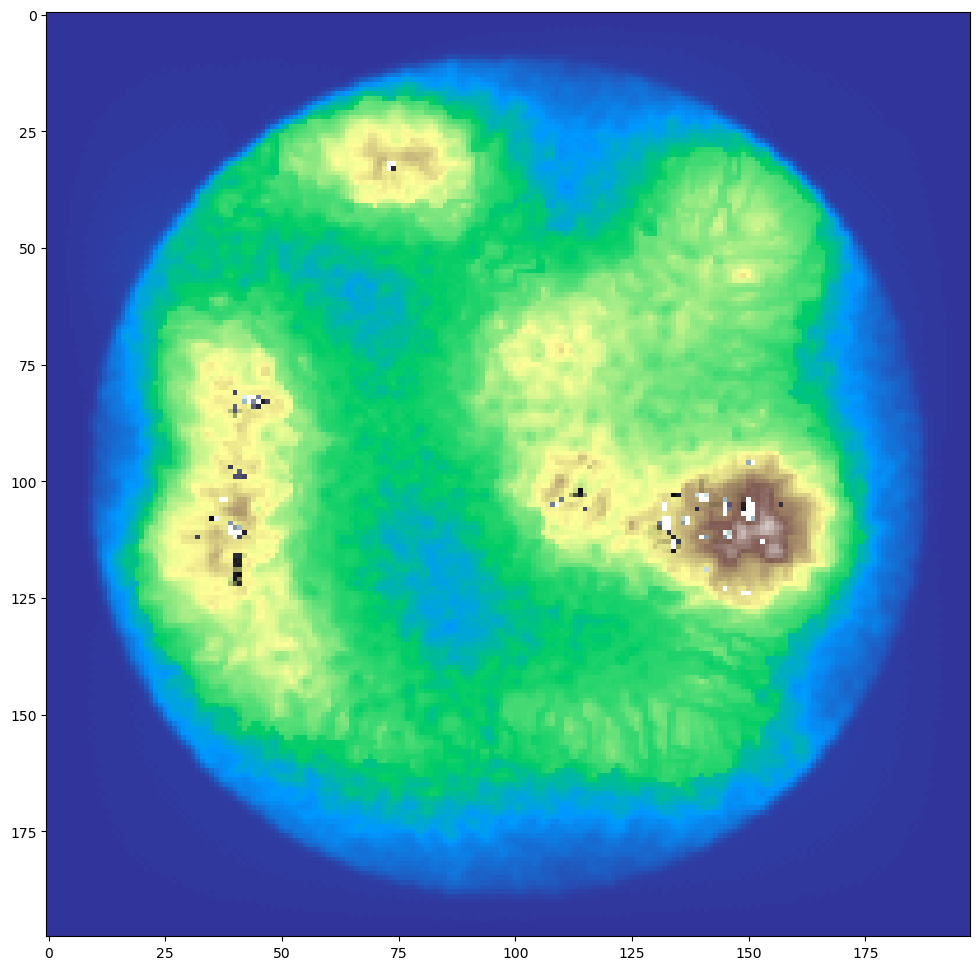

In [576]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
# plt.axis("off")

anim = True
ims = []
i = 200
# for i in np.arange(131):
tmp = all_rock[i] + all_gravel[i]
# tmp = all_gravel[i]
# tmp = all_gravel[i]
im1 = ax.imshow(tmp, cmap=plt.cm.terrain, vmin=0, vmax=4000, animated=anim)    
# im1 = ax.imshow(tmp, cmap=plt.cm.terrain, vmin=0, vmax=10, animated=anim)    
# 
alphas = all_ice[i] / 1
alphas[alphas > 1] = 1
im2 = ax.imshow(all_ice[i], cmap=plt.cm.bone, vmin=0, vmax=20, alpha=alphas, animated=anim)

alphas = all_waters[i] / 1
alphas[alphas > 1] = 1
# alphas[alphas < 0.] = 0
# alphas = alphas **1.2
# im3 = ax.imshow(all_waters[i], cmap=plt.cm.Blues, vmin=-100, vmax=100, alpha=alphas, animated=anim)

#     ims.append((im1, im2, im3))

In [64]:
mpl.rcParams['animation.embed_limit'] = 2**128

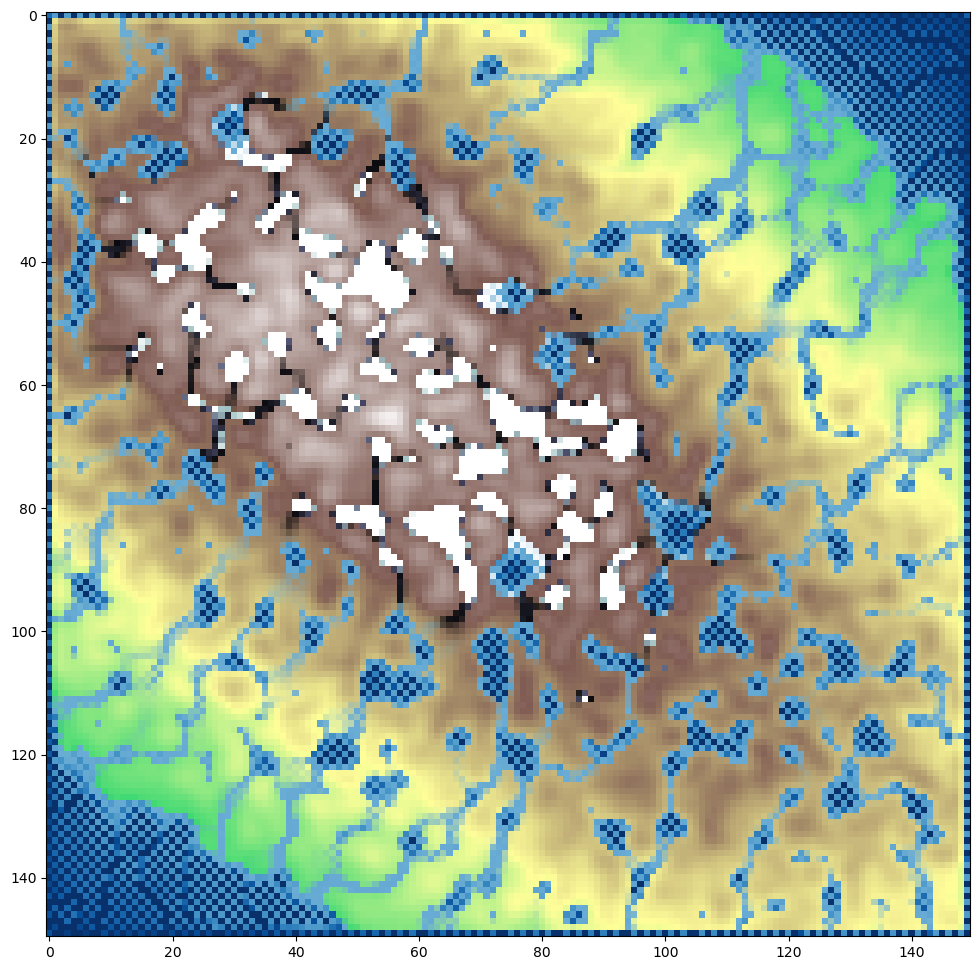

In [69]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
# plt.axis("off")
anim = True
ims = []
# for i in np.arange(len(all_rock)):
for i in np.arange(30):
    tmp = all_rock[i] + all_gravel[i]
    im1 = ax.imshow(tmp, cmap=plt.cm.terrain, vmin=-1000, vmax=4000, animated=anim)    

    alphas = all_ice[i] / 1
    alphas[alphas > 1] = 1
    alphas[alphas < 0.] = 0
    im2 = ax.imshow(all_ice[i], cmap=plt.cm.bone, vmin=0, vmax=20, alpha=alphas, animated=anim)

    alphas = all_waters[i] / 1
    alphas[alphas > 1] = 1
    alphas[alphas < 0.] = 0
    # alphas = alphas **1.2
    im3 = ax.imshow(all_waters[i], cmap=plt.cm.Blues, vmin=-100, vmax=100, alpha=alphas, animated=anim)

    ims.append((im1, im2, im3))

ani = animation.ArtistAnimation(fig, ims, interval=200, repeat_delay=200, blit=True)

HTML(ani.to_jshtml())

ani.save('animation_v7.gif', writer='imagemagick', fps=10)

In [119]:
def run_further(results, rules, tag, steps=20000, savestep=77):
    initial_maps = {
        "rock": null_edges(copy.deepcopy(results["rock"][-1])),
        "gravel": null_edges(copy.deepcopy(results["rock"][-1])),
        "water": null_edges(copy.deepcopy(results["waters"][-1])),
        "ice": null_edges(copy.deepcopy(results["ice"][-1])),
        "temperature": null_edges(copy.deepcopy(results["temperature"][-1])),
    }
    
    cs = CellSpace(initial_maps, rules)
    cs.flow(steps, savestep=savestep)
    
    all_rock = copy.deepcopy(cs.maps["rock"])
    all_gravel = copy.deepcopy(cs.maps["gravel"])
    all_waters = copy.deepcopy(cs.maps["water"])
    all_ice = copy.deepcopy(cs.maps["ice"])
    all_temperature = copy.deepcopy(cs.maps["temperature"])
    
    _results = {
        "rock": all_rock,
        "gravel": all_gravel,
        "waters": all_waters,
        "ice": all_ice,
        "temperature": all_temperature,    
    }
    pickle.dump(_results, open("res_" + tag + ".p", "wb"))
    
    return _results

In [120]:
res2 = run_further(results, rules, tag="test_v2", steps=10000, savestep=77)

0 out of 9999
276.05436927173287
0.06164679974804218
1 out of 9999
26581.95456579962
5.865391563503888
2 out of 9999
27216.86123607884
6.0347807618800084
3 out of 9999
26609.438468542416
5.910581623399026
4 out of 9999
26434.785029122955
5.739206476144801
5 out of 9999
25688.4574441539
5.692102247762885
6 out of 9999
25470.07340005983
5.722326084039504
7 out of 9999
24912.654879136593
5.597091637640214
8 out of 9999
24577.47366205987
5.450759295200681
9 out of 9999
23757.01423042867
5.249008888738107
10 out of 9999
23502.963718202547
5.01129290366792
11 out of 9999
22769.051765215234
5.034059642983691
12 out of 9999
22374.5288368201
5.108339917082215
13 out of 9999
21687.812885295425
4.7791566516737385
14 out of 9999
21368.72555757803
4.768740360985947
15 out of 9999
20846.161089734756
4.610962417548055
16 out of 9999
20469.17741216952
4.518582210191947
17 out of 9999
19788.46978917811
4.388660410108253
18 out of 9999
19486.73766372481
4.321742662170061
19 out of 9999
19004.5112327768


/tmp/ipykernel_4587/3869835583.py:113: RuntimeWarning: invalid value encountered in true_divide
  fractions = np.nan_to_num(diffs / diffs.sum(axis=0))


25 out of 9999
16456.2303846461
3.6732657108585043
26 out of 9999
16110.841392219416
3.6632199618507086
27 out of 9999
15688.9803420151
3.461058976839863
28 out of 9999
15463.827884822618
3.4417600455870505
29 out of 9999
14927.65603256505
3.285135570546886
30 out of 9999
14640.858889526571
3.3426618469238747
31 out of 9999
14258.377064855653
3.153113017438225
32 out of 9999
14060.574810810911
3.110746639559936
33 out of 9999
13657.961559506366
3.050695009941114
34 out of 9999
13518.603745962027
2.995480555276319
35 out of 9999
12998.033440839848
2.871224528570764
36 out of 9999
12866.957295811968
2.9396749590614504
37 out of 9999
12539.790376365418
2.81793042165515
38 out of 9999
12341.365956542664
2.72797655980165
39 out of 9999
11995.26848496712
2.6597047638508027
40 out of 9999
11802.862822907395
2.651732829231048
41 out of 9999
11389.983432687295
2.514900294256413
42 out of 9999
11316.899563420564
2.5650270995966826
43 out of 9999
10871.504581745306
2.4255922761591493
44 out of 99

188 out of 9999
3145.2195026437403
0.7112662828230982
189 out of 9999
3332.836611062812
0.7427761557973729
190 out of 9999
3070.541322737001
0.6831015178502783
191 out of 9999
3295.6436772303423
0.7195728552904678
192 out of 9999
3130.254829067737
0.7037443410673869
193 out of 9999
3277.5946522885934
0.723850409074336
194 out of 9999
3054.76753438171
0.6925340136888937
195 out of 9999
3281.6088869389496
0.7399343600764261
196 out of 9999
3045.515311358962
0.6702278414082223
197 out of 9999
3271.754819329013
0.725283710780096
198 out of 9999
3095.049821717257
0.6871780243599594
199 out of 9999
3365.8279197755037
0.7596090994754015
200 out of 9999
3056.1930892637465
0.6773477591453338
201 out of 9999
3363.2293229808565
0.7482156447120927
202 out of 9999
3037.7497812458314
0.691183112911452
203 out of 9999
3302.3171978038736
0.7372889479356717
204 out of 9999
2994.126103751536
0.6758749669868027
205 out of 9999
3333.476261972857
0.7270395336909176
206 out of 9999
2986.8954680162715
0.6679

361 out of 9999
3032.6998035095166
0.6745328744460669
362 out of 9999
3169.1462420590688
0.7016042156429197
363 out of 9999
3100.988308371103
0.6822856564072833
364 out of 9999
3146.0947204349795
0.7035095528700759
365 out of 9999
3164.865106563433
0.69679989136139
366 out of 9999
3131.217347718368
0.6938217034607507
367 out of 9999
3141.1209225425264
0.7142157622879778
368 out of 9999
3068.922775951156
0.6744885221870672
369 out of 9999
3062.4918377838912
0.691775883845469
370 out of 9999
3122.7887965542614
0.6907296608171337
371 out of 9999
2997.079242757929
0.677765545625945
372 out of 9999
3078.317800401768
0.6677478959656764
373 out of 9999
3033.1724350354634
0.6884186189367825
374 out of 9999
3126.9941268576076
0.7111653688554941
375 out of 9999
3111.9378988052486
0.7186923553822745
376 out of 9999
3091.9912294803653
0.6710050411198709
377 out of 9999
3117.001493937103
0.6977840819201037
378 out of 9999
3142.559113240335
0.7006820765307324
379 out of 9999
3031.502362899133
0.6850

536 out of 9999
3014.5964985935716
0.6721508358068164
537 out of 9999
2962.237416181364
0.661952495236059
538 out of 9999
3042.6505370187806
0.680987138992565
539 out of 9999
2937.73201522592
0.636010395156077
540 out of 9999
2983.2245954383397
0.6720487937459653
541 out of 9999
2881.374674699153
0.6413030658132991
542 out of 9999
3096.8018444249174
0.6880252931403948
543 out of 9999
2875.0631029421347
0.6300817670265472
544 out of 9999
3032.5460750620114
0.6675205976363662
545 out of 9999
2866.5668069205713
0.6297378749825508
546 out of 9999
3081.4247965919785
0.6630998055932814
547 out of 9999
2866.0415737746516
0.625090855785093
548 out of 9999
2975.1125119354692
0.6441031634413227
549 out of 9999
2853.485029377567
0.6328421001059142
550 out of 9999
3034.6981570021017
0.6802730681466267
551 out of 9999
2848.923390815733
0.6294572228934452
552 out of 9999
2968.220756776631
0.651640122234167
553 out of 9999
2852.406961127068
0.6414227481733906
554 out of 9999
3013.7095972938696
0.6680

711 out of 9999
2637.6628070059232
0.5967562911778107
712 out of 9999
2839.451941932086
0.6490175867273339
713 out of 9999
2635.700233262498
0.5758575995766874
714 out of 9999
2905.5617379635805
0.6500138116249621
715 out of 9999
2673.901117871341
0.6053658858662759
716 out of 9999
2772.191297258367
0.6252122907664337
717 out of 9999
2654.6550575898727
0.5957484420084993
718 out of 9999
2666.036043971777
0.5906149853725691
719 out of 9999
2656.2197648073197
0.5794545734745462
720 out of 9999
2694.835398750729
0.5956753754975086
721 out of 9999
2666.092388343881
0.5813546420287573
722 out of 9999
2658.9723575847456
0.5992725619979142
723 out of 9999
2651.9342586944113
0.5895807600476681
724 out of 9999
2700.2129763991106
0.6052932025104485
725 out of 9999
2636.606030577619
0.5999103596308576
726 out of 9999
2670.40260096814
0.5966046919053039
727 out of 9999
2659.1753083294025
0.5826413909573626
728 out of 9999
2628.3362661656574
0.5747509875717598
729 out of 9999
2745.629219481838
0.63

882 out of 9999
2839.088277805189
0.6347168070210573
883 out of 9999
2747.689227470197
0.6057515933576272
884 out of 9999
2783.1020381322596
0.6116707776114856
885 out of 9999
2672.153901487007
0.5971293634607836
886 out of 9999
2804.7715385481133
0.6119946625677751
887 out of 9999
2734.724348345888
0.6052953404926711
888 out of 9999
2855.713598655653
0.6319348525460617
889 out of 9999
2725.604111150489
0.6016786117329999
890 out of 9999
2769.388531929173
0.6170651809111348
891 out of 9999
2735.999852963956
0.5947825767312948
892 out of 9999
2785.6063789983746
0.6285212949003552
893 out of 9999
2735.637758821307
0.5856642600773512
894 out of 9999
2819.4088717834093
0.6298947434726115
895 out of 9999
2730.94245182944
0.6002071322702066
896 out of 9999
2787.475921018631
0.6102180212387547
897 out of 9999
2732.4543158062734
0.6288732602546083
898 out of 9999
2776.9822974476265
0.6151932426778083
899 out of 9999
2698.254161982506
0.5984152055849425
900 out of 9999
2790.8086092755548
0.6144

2961.8635093090124
0.6636485568695972
1055 out of 9999
2554.1986751623917
0.5606230630294977
1056 out of 9999
2943.5421786553925
0.6671673115719384
1057 out of 9999
2609.565184650186
0.5737830221306478
1058 out of 9999
2929.0760421033483
0.6412162964324317
1059 out of 9999
2666.022960269358
0.5985682443352847
1060 out of 9999
2862.3195089772344
0.6475835993161164
1061 out of 9999
2555.240502245608
0.5556078500207888
1062 out of 9999
2811.7601293810294
0.6315723561053526
1063 out of 9999
2728.54479617381
0.6135697765176096
1064 out of 9999
2925.788814240601
0.6579241768024738
1065 out of 9999
2599.6490708300844
0.5800198730098358
1066 out of 9999
2942.9182359875995
0.644246549034063
1067 out of 9999
2697.013450872735
0.5856706733708437
1068 out of 9999
2943.089034505305
0.6597375105369435
1069 out of 9999
2512.3877692662645
0.5497566234718303
1070 out of 9999
2774.9997282130644
0.6173525535512935
1071 out of 9999
2627.0732797129313
0.5963843994808017
1072 out of 9999
2831.395429214812
0

1227 out of 9999
2643.2657086763065
0.5894883382418168
1228 out of 9999
2843.6784473390435
0.6340420172439339
1229 out of 9999
2526.7661059444654
0.5555774199526089
1230 out of 9999
2856.378768133931
0.6384395994935026
1231 out of 9999
2662.9503550598165
0.5960050033705946
1232 out of 9999
2881.0616916454746
0.6316732496482076
1233 out of 9999
2668.7533558010473
0.5963694649834742
1234 out of 9999
2853.370948638767
0.6360612903786819
1235 out of 9999
2592.7992260198807
0.5678491515593256
1236 out of 9999
2856.023573232349
0.6390744178188295
1237 out of 9999
2637.524232261465
0.5848169029404579
1238 out of 9999
2782.117413856322
0.6210083513072148
1239 out of 9999
2641.603114293248
0.580827421788313
1240 out of 9999
2792.5162703017704
0.6178133341375598
1241 out of 9999
2647.665401049657
0.5931150091957117
1242 out of 9999
2784.959815484064
0.6070095500183226
1243 out of 9999
2644.9949808206875
0.5930482019777327
1244 out of 9999
2817.23100210703
0.6398435162632364
1245 out of 9999
2480

1402 out of 9999
2641.7095968618523
0.5841905344674596
1403 out of 9999
2929.758289377496
0.6514917254564145
1404 out of 9999
2642.6678851078614
0.5927922577630914
1405 out of 9999
2909.0962991500273
0.6476171636576196
1406 out of 9999
2611.097023697046
0.5769105222485741
1407 out of 9999
2865.6813514302485
0.6402326522408955
1408 out of 9999
2650.678250100289
0.5806524096605233
1409 out of 9999
2974.5485244684387
0.6620406241861648
1410 out of 9999
2601.349976759171
0.5699715111216413
1411 out of 9999
2965.2665303015965
0.6507058438230408
1412 out of 9999
2617.244652493915
0.5777582014335353
1413 out of 9999
2924.407606281631
0.6542298895484634
1414 out of 9999
2634.814275816083
0.5924925288545273
1415 out of 9999
2881.39934537292
0.6475054708703191
1416 out of 9999
2650.6919538773363
0.5998397723189265
1417 out of 9999
2943.3077679566923
0.6581636332640188
1418 out of 9999
2620.550906612305
0.5709261234449466
1419 out of 9999
2858.5959056258434
0.634961329548166
1420 out of 9999
2656

1575 out of 9999
2960.959481205675
0.6609284556262667
1576 out of 9999
2492.9910408835276
0.5543675874768796
1577 out of 9999
2857.9709824931924
0.6461611988453974
1578 out of 9999
2547.494464204705
0.5762258457825616
1579 out of 9999
2925.004537756904
0.6570091055159263
1580 out of 9999
2497.499815355637
0.5571045762559975
1581 out of 9999
2863.262629376317
0.6396922764468983
1582 out of 9999
2545.4467296912335
0.5735571720800436
1583 out of 9999
2792.760815015412
0.6044936829037688
1584 out of 9999
2503.469372022664
0.5705262926213911
1585 out of 9999
2865.472223472665
0.6522814075740189
1586 out of 9999
2507.0870363262366
0.5593679242137967
1587 out of 9999
2870.590491876239
0.6498959682762596
1588 out of 9999
2463.136358551623
0.5479724935598715
1589 out of 9999
2935.035473253578
0.6611929428370305
1590 out of 9999
2584.2144107432105
0.5752926114744458
1591 out of 9999
2935.344359778159
0.668491086262391
1592 out of 9999
2582.198731640645
0.5726765871902073
1593 out of 9999
2838.66

1750 out of 9999
2569.400977568119
0.5713589009491036
1751 out of 9999
2658.596314586117
0.5963652567487925
1752 out of 9999
2558.8822954913485
0.5789326460387666
1753 out of 9999
2656.4324023667723
0.5978916053042477
1754 out of 9999
2567.4372890971135
0.5710492191052299
1755 out of 9999
2706.0497398482985
0.6057868233374297
1756 out of 9999
2562.8275705013657
0.5737245512651367
1757 out of 9999
2642.198960884416
0.5810862020858624
1758 out of 9999
2573.6627252893522
0.5711634987326569
1759 out of 9999
2702.9927628178266
0.5885026698928427
1760 out of 9999
2615.4050322928233
0.5745617382014111
1761 out of 9999
2655.5196113986894
0.6093436464889145
1762 out of 9999
2620.8648792360327
0.5772830130475843
1763 out of 9999
2614.002530777303
0.5748850958384216
1764 out of 9999
2610.379698481178
0.5793119614916062
1765 out of 9999
2547.842933408974
0.5656844878794348
1766 out of 9999
2640.174628390814
0.601406521273534
1767 out of 9999
2660.3824510721024
0.5877999229058998
1768 out of 9999
2

1917 out of 9999
2522.93179627636
0.569253564141778
1918 out of 9999
2668.8293765347917
0.5887556533277722
1919 out of 9999
2569.298478115583
0.5723543056617472
1920 out of 9999
2663.602453029889
0.5999104623941192
1921 out of 9999
2636.526719379006
0.5829154807382282
1922 out of 9999
2759.6720776555594
0.6161357619235454
1923 out of 9999
2538.289809611393
0.5700179226614401
1924 out of 9999
2740.406633366947
0.6087087146528092
1925 out of 9999
2501.7424151548184
0.5654933126480151
1926 out of 9999
2750.8431297013303
0.6232086836659109
1927 out of 9999
2609.94287724077
0.5708536476904571
1928 out of 9999
2694.2387994815945
0.6001868566454878
1929 out of 9999
2625.8112969403155
0.5724463259080697
1930 out of 9999
2661.5212906590896
0.5993067531319725
1931 out of 9999
2635.5632826882065
0.591862403478151
1932 out of 9999
2740.277195990726
0.6098992201181228
1933 out of 9999
2548.047878144891
0.5685068893674455
1934 out of 9999
2648.0396330033545
0.5875393017535733
1935 out of 9999
2603.0

2084 out of 9999
2593.816976283153
0.5830112331497309
2085 out of 9999
2647.373556367238
0.5867405931664978
2086 out of 9999
2536.8708331167
0.5608823420554278
2087 out of 9999
2719.0360728979576
0.6117066530704066
2088 out of 9999
2553.4808621611446
0.5616983858691476
2089 out of 9999
2648.4403112318832
0.5884115332663593
2090 out of 9999
2604.0180596855935
0.5754736043504074
2091 out of 9999
2679.3378530140617
0.5940882157459116
2092 out of 9999
2563.052197314624
0.5731333178252738
2093 out of 9999
2660.205245842866
0.5948580603405336
2094 out of 9999
2553.1493910767604
0.5607620011150363
2095 out of 9999
2584.429292883724
0.5927590121292945
2096 out of 9999
2539.445453958004
0.5714323703775886
2097 out of 9999
2618.594732644502
0.5711220790936755
2098 out of 9999
2681.7280393873807
0.5929091398159144
2099 out of 9999
2588.076407775283
0.5769229620542315
2100 out of 9999
2662.923975396203
0.600027934969852
2101 out of 9999
2544.2237147099804
0.5546596282341357
2102 out of 9999
2731.2

2252 out of 9999
2657.4818452734035
0.5853484240690316
2253 out of 9999
2694.8107467227383
0.6095477825656499
2254 out of 9999
2667.79335171805
0.584401610453023
2255 out of 9999
2797.4003096718807
0.6395519683749156
2256 out of 9999
2654.0202944356715
0.5874325574226807
2257 out of 9999
2746.3495660738554
0.607062238301029
2258 out of 9999
2662.9473726212746
0.591109294699506
2259 out of 9999
2625.4462379810284
0.5868230303936138
2260 out of 9999
2665.041395534179
0.6025415771047206
2261 out of 9999
2688.5479480514186
0.6096480607826346
2262 out of 9999
2674.4385066006216
0.5960415659907782
2263 out of 9999
2705.384273690637
0.5939372719408643
2264 out of 9999
2725.077641539625
0.6172316288877973
2265 out of 9999
2709.392078428995
0.6124303974749085
2266 out of 9999
2696.236412594444
0.5895990405848336
2267 out of 9999
2614.523496466456
0.5742419276227665
2268 out of 9999
2775.414002805657
0.6253749443005087
2269 out of 9999
2667.108445289836
0.5988119544880637
2270 out of 9999
2760.4

2418 out of 9999
2576.530322095903
0.5842472385704995
2419 out of 9999
2607.4043411283637
0.5787800979197256
2420 out of 9999
2602.0757249211892
0.5809501506856863
2421 out of 9999
2631.8620294537395
0.5756478629601355
2422 out of 9999
2605.1370102704386
0.5812443128671215
2423 out of 9999
2642.784204543452
0.5786696309488618
2424 out of 9999
2626.8246064118575
0.5888420996215775
2425 out of 9999
2595.494543517125
0.5796102151668434
2426 out of 9999
2625.8090794646996
0.5883506787955859
2427 out of 9999
2368.6324501822237
0.5412779822171444
2428 out of 9999
2683.448313264351
0.5992515214971753
2429 out of 9999
2493.184254642809
0.5423502838030909
2430 out of 9999
2664.910179478582
0.596310176656653
2431 out of 9999
2555.5491239533294
0.567143613837845
2432 out of 9999
2735.9037299759802
0.6113751351901632
2433 out of 9999
2402.0958528560586
0.5445694520190566
2434 out of 9999
2707.659814116778
0.5989072802735629
2435 out of 9999
2508.317818484269
0.5640471820292937
2436 out of 9999
270

2586 out of 9999
2669.5144858184503
0.5851631928580557
2587 out of 9999
2461.923893437488
0.5329993274382957
2588 out of 9999
2718.6391943980707
0.6088777591037112
2589 out of 9999
2554.7052845144644
0.5716503209922722
2590 out of 9999
2586.8775810537045
0.5682947234300757
2591 out of 9999
2507.01951204089
0.5578592594661526
2592 out of 9999
2580.5541018029908
0.5646726699787726
2593 out of 9999
2555.8687756662257
0.5576846553930233
2594 out of 9999
2632.441148168582
0.5883864881914578
2595 out of 9999
2575.640217580076
0.560165336576789
2596 out of 9999
2622.281633581966
0.5820824935809026
2597 out of 9999
2518.613558945013
0.5442120913882915
2598 out of 9999
2594.556429198361
0.5920941189407487
2599 out of 9999
2451.0370798319927
0.5409483733904199
2600 out of 9999
2727.0405417133006
0.6037282580724598
2601 out of 9999
2404.764178729267
0.5271293684193922
2602 out of 9999
2641.6873248764314
0.5767876255188715
2603 out of 9999
2436.6670753314975
0.5401611783044774
2604 out of 9999
270

2755 out of 9999
2447.144514774671
0.5509105166084356
2756 out of 9999
2842.720197280636
0.6409741143812032
2757 out of 9999
2443.1203265156364
0.5392011314313918
2758 out of 9999
2702.085476909764
0.6176195375793746
2759 out of 9999
2439.9856832919177
0.5352019485176394
2760 out of 9999
2723.6652952219592
0.5894103646877211
2761 out of 9999
2493.2036778847105
0.5557743374687273
2762 out of 9999
2805.433146231575
0.6348570143090235
2763 out of 9999
2406.4622660570894
0.5454356904027855
2764 out of 9999
2725.4359159062733
0.6060564633992158
2765 out of 9999
2498.948646226083
0.5437225078820894
2766 out of 9999
2708.3440629777033
0.6093012515135441
2767 out of 9999
2450.153939918382
0.5464214852627971
2768 out of 9999
2873.279791240464
0.6465526082899334
2769 out of 9999
2452.486975197564
0.5500082922622929
2770 out of 9999
2718.7360965998378
0.6052395584594474
2771 out of 9999
2402.3705915032187
0.524535063646991
2772 out of 9999
2692.374066097953
0.5965818892306565
2773 out of 9999
239

2912 out of 9999
2746.1468799713184
0.6066151711887162
2913 out of 9999
2434.937672195141
0.5265868668242087
2914 out of 9999
2747.369005402201
0.6212955688381278
2915 out of 9999
2448.9484883217374
0.5445738243988743
2916 out of 9999
2597.222934068821
0.5706928002788004
2917 out of 9999
2551.814809857402
0.5528194995358323
2918 out of 9999
2798.963749971066
0.6196510405072096
2919 out of 9999
2439.1549535300583
0.5404730674784086
2920 out of 9999
2906.2315360493376
0.6352418658031339
2921 out of 9999
2390.0324696010794
0.5169873393037161
2922 out of 9999
2785.5635056161555
0.6055572838295991
2923 out of 9999
2309.8742994345957
0.5146778742055694
2924 out of 9999
2770.0836756490753
0.6198441878829885
2925 out of 9999
2482.24894596549
0.559191021843994
2926 out of 9999
2805.826860188041
0.638704042838161
2927 out of 9999
2451.714736520895
0.5427750136198571
2928 out of 9999
2710.3243803175865
0.6115352843676864
2929 out of 9999
2500.141352753679
0.5559576056823835
2930 out of 9999
2644.

3076 out of 9999
2777.899355308444
0.6211760633516198
3077 out of 9999
2255.148105473141
0.5023720439904524
3078 out of 9999
2734.9848610742483
0.5984649586595729
3079 out of 9999
2367.034464372555
0.5352859485238703
3080 out of 9999
2689.6590625563986
0.6015788554140905
3081 out of 9999
2383.324006906303
0.5430221022798595
3082 out of 9999
2822.452905262471
0.6131768206088358
3083 out of 9999
2463.0348928949097
0.537076950042501
3084 out of 9999
2757.646830968093
0.614997063106176
3085 out of 9999
2364.5173849343555
0.5345958365214459
3086 out of 9999
2858.48907690309
0.6523252115251232
3087 out of 9999
2377.3741480291355
0.5319700487870073
3088 out of 9999
2772.010636936233
0.6069653244878986
3089 out of 9999
2350.172669202788
0.5245921136613365
3090 out of 9999
2777.1172057349468
0.6144064614457847
3091 out of 9999
2337.046458396828
0.5180772463748233
3092 out of 9999
2806.576249621692
0.6288541899219565
3093 out of 9999
2365.6391323535354
0.5289890725298604
3094 out of 9999
2721.41

3237 out of 9999
2348.590774805285
0.5275361129391926
3238 out of 9999
2802.998887654976
0.6226119252898659
3239 out of 9999
2368.010833319626
0.5249414394412826
3240 out of 9999
2806.612397329882
0.6238302728005961
3241 out of 9999
2266.217799193051
0.48819857802521566
3242 out of 9999
2817.3008234518347
0.6386988944574552
3243 out of 9999
2335.938651511038
0.5163436453384258
3244 out of 9999
2856.9089836946223
0.633320546152654
3245 out of 9999
2321.501842385973
0.5116821340943295
3246 out of 9999
2849.3775851508835
0.6290016744262436
3247 out of 9999
2178.787262137281
0.4776994654981979
3248 out of 9999
2886.1493248219485
0.650766476848241
3249 out of 9999
2260.273325808579
0.49307882325667085
3250 out of 9999
2918.069305224344
0.6402082723177587
3251 out of 9999
2233.0708014476113
0.4978976145925555
3252 out of 9999
2889.2901730758604
0.6419218336093891
3253 out of 9999
2191.5391626515193
0.48399716489653694
3254 out of 9999
2922.3971021660836
0.6401746116464586
3255 out of 9999
23

3399 out of 9999
2378.849302810733
0.526061323045275
3400 out of 9999
2926.28588436509
0.6437056498823339
3401 out of 9999
2298.7284495673375
0.5177316327854363
3402 out of 9999
2947.877933143056
0.6402862582847646
3403 out of 9999
2283.978217819473
0.500652831613212
3404 out of 9999
2922.6991952619283
0.6556077154019578
3405 out of 9999
2403.3157288696966
0.5380156097760682
3406 out of 9999
2904.0317506529973
0.653619570257258
3407 out of 9999
2338.7336055825
0.5075376748225912
3408 out of 9999
2936.5177605512436
0.6645208781514468
3409 out of 9999
2368.856820431305
0.5236199868327377
3410 out of 9999
2879.1615425180644
0.639103561047295
3411 out of 9999
2299.166044293146
0.5057558390438069
3412 out of 9999
2931.4708750102436
0.6464103362756877
3413 out of 9999
2317.339184631768
0.5270273333253964
3414 out of 9999
2871.356652168557
0.6426492059464094
3415 out of 9999
2342.9910962632857
0.5229890839873406
3416 out of 9999
2924.7978595060995
0.6608219293958653
3417 out of 9999
2418.7371

3572 out of 9999
2832.2021583198803
0.6383146626819654
3573 out of 9999
2306.1462691495544
0.5016633171959005
3574 out of 9999
2818.2565147133428
0.652072307892953
3575 out of 9999
2353.4486418364104
0.5246207404896145
3576 out of 9999
2822.476465778891
0.6284739402758608
3577 out of 9999
2310.729469007405
0.512016279416664
3578 out of 9999
2871.1128105452517
0.6370341270346687
3579 out of 9999
2395.362870696117
0.5319482280026909
3580 out of 9999
2812.598518131417
0.6289352679184743
3581 out of 9999
2280.106026492431
0.5155111974886798
3582 out of 9999
2827.0211767087458
0.6132366977676238
3583 out of 9999
2336.145959618734
0.5202997682892504
3584 out of 9999
2745.1264130438212
0.604653394943573
3585 out of 9999
2307.092679267458
0.5283015065874647
3586 out of 9999
2824.491692973941
0.628363001773958
3587 out of 9999
2402.8181218802347
0.5337223726966315
3588 out of 9999
2793.670693942753
0.6353583565937578
3589 out of 9999
2364.6353172892705
0.5131587060089563
3590 out of 9999
2822.1

3745 out of 9999
2324.1017410168424
0.5145232988746608
3746 out of 9999
2768.753047638922
0.6185775352187046
3747 out of 9999
2440.9021360719344
0.5541208027405072
3748 out of 9999
2724.155835548532
0.6086139042780456
3749 out of 9999
2427.283373127517
0.5378425378080028
3750 out of 9999
2666.3259670501575
0.595162046216553
3751 out of 9999
2429.326283122413
0.5379376180519072
3752 out of 9999
2729.8758934672223
0.591266167092749
3753 out of 9999
2368.216199349379
0.5400721093157079
3754 out of 9999
2795.3609791349154
0.6130177585822183
3755 out of 9999
2377.819233511167
0.5304080378119935
3756 out of 9999
2834.256752088084
0.6349141469731371
3757 out of 9999
2387.4089583534515
0.5326659880306674
3758 out of 9999
2772.1241035298444
0.6173995776235733
3759 out of 9999
2384.594108064659
0.5192931420001435
3760 out of 9999
2733.284440278716
0.6020450308983956
3761 out of 9999
2343.7205751142465
0.5272712204981432
3762 out of 9999
2780.507628501684
0.6078941033016362
3763 out of 9999
2385.

3912 out of 9999
2543.405096219445
0.5689944286844396
3913 out of 9999
2464.0400240491144
0.5558402941685348
3914 out of 9999
2539.119577524136
0.5632474661766051
3915 out of 9999
2418.9610921153217
0.5548075899347068
3916 out of 9999
2614.8411778007867
0.5607637095862721
3917 out of 9999
2575.6916027639527
0.5769918464973012
3918 out of 9999
2598.4104862426175
0.5630358583407622
3919 out of 9999
2527.7112843518844
0.5602196995460736
3920 out of 9999
2526.7503059544833
0.5619996232105168
3921 out of 9999
2534.4590951460414
0.5532545503484045
3922 out of 9999
2551.231742883858
0.5798253961099676
3923 out of 9999
2427.3687961032847
0.5272304074941974
3924 out of 9999
2619.2101155931596
0.5870036117420797
3925 out of 9999
2537.0859796170844
0.5583375835424922
3926 out of 9999
2605.2428058087244
0.5887554363409546
3927 out of 9999
2553.7859549206332
0.5663752395033562
3928 out of 9999
2525.3543442960363
0.5600697148582915
3929 out of 9999
2591.7686020411784
0.5825508208678756
3930 out of 9

4066 out of 9999
2544.28690666717
0.5773285470086612
4067 out of 9999
2420.500085948617
0.5345627398296416
4068 out of 9999
2461.70261744858
0.5517038586841282
4069 out of 9999
2339.770077869529
0.5244945254134787
4070 out of 9999
2388.6639493982075
0.5285824185435289
4071 out of 9999
2480.7081744784955
0.5532355429256235
4072 out of 9999
2451.8651621179306
0.5465593317249066
4073 out of 9999
2445.317363373004
0.5377869723714546
4074 out of 9999
2545.5869792263256
0.5639315416983441
4075 out of 9999
2500.8491700268933
0.5429546613171717
4076 out of 9999
2558.3272698376095
0.549586953778219
4077 out of 9999
2487.437067048857
0.5521502923526874
4078 out of 9999
2561.0846629667794
0.578122948750966
4079 out of 9999
2397.493889136589
0.5312417215015708
4080 out of 9999
2655.997190539434
0.5931213020409634
4081 out of 9999
2295.7896804891643
0.5170697478579199
4082 out of 9999
2749.1352610866306
0.6311146145745249
4083 out of 9999
2245.6812243699096
0.4972721931731421
4084 out of 9999
2783.

4232 out of 9999
2655.7444060997805
0.5878141669100886
4233 out of 9999
2543.723420449125
0.564519178972287
4234 out of 9999
2665.959253289504
0.5930943833792
4235 out of 9999
2502.267728621606
0.5599166991769089
4236 out of 9999
2579.810301926511
0.5720200226001133
4237 out of 9999
2589.076027864241
0.5717924089806186
4238 out of 9999
2535.014004547673
0.5688990135878979
4239 out of 9999
2687.141794859199
0.5934500430342754
4240 out of 9999
2638.561392505362
0.5818216962525605
4241 out of 9999
2603.6551332589006
0.5798786488327173
4242 out of 9999
2642.3454013076844
0.5960625764285324
4243 out of 9999
2634.5976017984212
0.5987721822269139
4244 out of 9999
2595.7517322719214
0.5776038567583269
4245 out of 9999
2659.957830308005
0.5994946653838191
4246 out of 9999
2518.448702005262
0.551444865777373
4247 out of 9999
2696.075459451182
0.6042302688146979
4248 out of 9999
2536.8133369677234
0.5569293824297966
4249 out of 9999
2611.7050750225317
0.5711141646670745
4250 out of 9999
2541.4223

4408 out of 9999
2486.922763587325
0.5568568660070141
4409 out of 9999
2673.9141352790175
0.587286214645073
4410 out of 9999
2467.679980161367
0.5459468982657891
4411 out of 9999
2713.721163258946
0.5969470222742952
4412 out of 9999
2615.997812021291
0.5792732090392584
4413 out of 9999
2713.3197138740215
0.5989668242547509
4414 out of 9999
2553.394752905937
0.5595868404352261
4415 out of 9999
2719.7041648058803
0.5957730919618577
4416 out of 9999
2524.0190669369185
0.5617669857415799
4417 out of 9999
2609.3989605314564
0.5948025895900289
4418 out of 9999
2601.678984020371
0.5822916257879076
4419 out of 9999
2616.126075833803
0.5733346648770115
4420 out of 9999
2530.5221709895413
0.5627134024882235
4421 out of 9999
2683.991716550372
0.5992390525899469
4422 out of 9999
2637.1777902918984
0.5741732615484212
4423 out of 9999
2538.928170169238
0.5634549867219791
4424 out of 9999
2568.7986417767825
0.5688216655838757
4425 out of 9999
2580.8690379327745
0.5736539315254
4426 out of 9999
2643.8

4583 out of 9999
2410.3365681363503
0.5429908916729782
4584 out of 9999
2541.2337698028423
0.5744199298831018
4585 out of 9999
2553.6292426009313
0.5738492680002093
4586 out of 9999
2524.3880827837274
0.5567684346677828
4587 out of 9999
2522.9339673839277
0.5634064241589835
4588 out of 9999
2504.6463585214224
0.553024146284262
4589 out of 9999
2581.985591790057
0.5778839730953573
4590 out of 9999
2560.8203886401607
0.5693242304669099
4591 out of 9999
2505.5599785916856
0.5585287513579326
4592 out of 9999
2591.04427184246
0.5733667341983758
4593 out of 9999
2459.141180850216
0.5396403732390205
4594 out of 9999
2600.2849173180293
0.5694885933679433
4595 out of 9999
2449.5860308604315
0.5358971846117767
4596 out of 9999
2684.918416611792
0.5936145073207588
4597 out of 9999
2370.30753436574
0.5293228080316525
4598 out of 9999
2670.345300910878
0.5841928026495029
4599 out of 9999
2402.414176918217
0.5415721769427901
4600 out of 9999
2548.0762931655045
0.5732455102734543
4601 out of 9999
240

0.5714572237553486
4736 out of 9999
2656.9679031275446
0.5943999783283097
4737 out of 9999
2499.8061604361283
0.5621331595313983
4738 out of 9999
2629.8441365222097
0.5864951241128924
4739 out of 9999
2523.9859789274633
0.56150967273136
4740 out of 9999
2529.7429633606225
0.5748109437311116
4741 out of 9999
2525.2607123179478
0.5807867323638334
4742 out of 9999
2456.40043909871
0.5447772098245088
4743 out of 9999
2511.9584847200313
0.564738867967633
4744 out of 9999
2641.158411805576
0.5860125164867043
4745 out of 9999
2489.6860107104294
0.5556094645638093
4746 out of 9999
2657.855683881673
0.5902411023499163
4747 out of 9999
2506.2264091073303
0.5611792228184797
4748 out of 9999
2646.8175177520607
0.5730282567118555
4749 out of 9999
2477.2283440054744
0.5545619753761976
4750 out of 9999
2759.2882579817087
0.6163252754035534
4751 out of 9999
2409.0345202739118
0.5384520608569315
4752 out of 9999
2796.974530325213
0.6101602378545403
4753 out of 9999
2400.027096718899
0.5299242871978138


0.5945510809713344
4907 out of 9999
2537.4301592118572
0.570722033111079
4908 out of 9999
2663.4559942095657
0.59372625818314
4909 out of 9999
2377.760344468523
0.5322946819942965
4910 out of 9999
2662.458830878488
0.6064826494028446
4911 out of 9999
2346.68884580757
0.5213705500572251
4912 out of 9999
2699.8805586167146
0.6002402309063394
4913 out of 9999
2337.105488261732
0.5234278809096824
4914 out of 9999
2565.091626986279
0.5661204208753651
4915 out of 9999
2410.807657651021
0.5251160221413681
4916 out of 9999
2655.241085854941
0.5762241939789369
4917 out of 9999
2420.51535098115
0.5436916781179582
4918 out of 9999
2688.802828461572
0.5938168790772023
4919 out of 9999
2475.6904590354534
0.5463894193413051
4920 out of 9999
2806.2593565226416
0.635187722164473
4921 out of 9999
2496.456541482825
0.5630258325401049
4922 out of 9999
2642.6950433370657
0.5880496313611628
4923 out of 9999
2452.7469916765695
0.5263405561537703
4924 out of 9999
2702.02233647299
0.6069232561709321
4925 out 

5070 out of 9999
2708.551524789247
0.5934600185778368
5071 out of 9999
2409.9438899402157
0.5608433534885305
5072 out of 9999
2701.7363633730565
0.6003858585273459
5073 out of 9999
2383.296679827734
0.5392073936261842
5074 out of 9999
2640.688508468389
0.5744373522880986
5075 out of 9999
2404.3836322356947
0.5167383692748108
5076 out of 9999
2648.5360343407374
0.5978636646367353
5077 out of 9999
2465.9435753193684
0.5567720874507492
5078 out of 9999
2512.7600602870225
0.5526193226934292
5079 out of 9999
2453.382777671388
0.5366104063148267
5080 out of 9999
2634.1363342463737
0.585493739552428
5081 out of 9999
2418.7206881177844
0.5467270994841285
5082 out of 9999
2661.285663130344
0.5870914765343799
5083 out of 9999
2471.636828841525
0.5404847646712279
5084 out of 9999
2626.491007784207
0.5890313989199836
5085 out of 9999
2434.93564082199
0.5356215663928707
5086 out of 9999
2551.064640667697
0.5717312058869782
5087 out of 9999
2423.034915895667
0.5383325740714656
5088 out of 9999
2718.

5243 out of 9999
2366.2005474487087
0.5297068608571096
5244 out of 9999
2713.1712548796786
0.6045390496612475
5245 out of 9999
2356.19214436115
0.5084575192838044
5246 out of 9999
2837.236811976356
0.6502949374229557
5247 out of 9999
2334.1266132556484
0.5248766838892845
5248 out of 9999
2731.7863078631926
0.6119592983564499
5249 out of 9999
2353.194517259486
0.5244471845909262
5250 out of 9999
2823.9551046856213
0.6153748321389456
5251 out of 9999
2281.593508083315
0.52234283609966
5252 out of 9999
2819.8507599636214
0.6335319613488253
5253 out of 9999
2331.8893218463054
0.5112671172651404
5254 out of 9999
2782.8523294983315
0.6208952096158705
5255 out of 9999
2327.1398192772176
0.520263764649501
5256 out of 9999
2731.9709063448245
0.608321288431268
5257 out of 9999
2289.173719133716
0.5137283929833295
5258 out of 9999
2739.0121507734875
0.6023778646961706
5259 out of 9999
2289.8929738979787
0.5125096181508457
5260 out of 9999
2718.0148155520437
0.6150746357891025
5261 out of 9999
236

5417 out of 9999
2485.6953045675764
0.5584577183930749
5418 out of 9999
2576.0070816115476
0.5881294706875679
5419 out of 9999
2427.383994691074
0.5408609613839291
5420 out of 9999
2645.438179491088
0.5954171009433014
5421 out of 9999
2604.158996409853
0.5842851685909475
5422 out of 9999
2581.757829083246
0.5553361645694227
5423 out of 9999
2578.7959571689717
0.5860899902656754
5424 out of 9999
2556.573390507605
0.556866345133436
5425 out of 9999
2569.8434132117545
0.5763272960779894
5426 out of 9999
2475.8792615351267
0.5467931231305492
5427 out of 9999
2587.947505111457
0.5761236654299771
5428 out of 9999
2656.8681271084934
0.5963789286438818
5429 out of 9999
2586.6889194897376
0.5612256280081878
5430 out of 9999
2628.0210413872264
0.5926975736101097
5431 out of 9999
2558.9269442756777
0.580387149983143
5432 out of 9999
2635.1856761670206
0.5998601584718918
5433 out of 9999
2530.2806121502654
0.5677093587952132
5434 out of 9999
2529.2472071336815
0.5634322136631057
5435 out of 9999
2

5586 out of 9999
2715.466390317073
0.6064016056983191
5587 out of 9999
2272.484857644944
0.5125134996943942
5588 out of 9999
2658.357250670786
0.6041721024251786
5589 out of 9999
2311.7253550101304
0.5148608808485814
5590 out of 9999
2729.7253072523745
0.6080920711188181
5591 out of 9999
2448.85739436897
0.5417826093736658
5592 out of 9999
2708.904506619321
0.6001117648691452
5593 out of 9999
2358.10973205301
0.5282503880047065
5594 out of 9999
2722.35961561522
0.6191402355276825
5595 out of 9999
2361.573550847592
0.524560984195378
5596 out of 9999
2661.2606879418017
0.5915227134789512
5597 out of 9999
2435.0137732063304
0.5405136011556783
5598 out of 9999
2660.974893295148
0.5947641692657908
5599 out of 9999
2384.0468497433467
0.5266284183219233
5600 out of 9999
2622.019197405665
0.596455686398013
5601 out of 9999
2372.323800924816
0.5219634325467142
5602 out of 9999
2700.8172619994148
0.5983201732386829
5603 out of 9999
2397.7669542951044
0.5262877423825953
5604 out of 9999
2688.8759

5759 out of 9999
2291.6298286588863
0.5087988074287048
5760 out of 9999
2751.6672108886996
0.6173810210654476
5761 out of 9999
2296.2346411357867
0.5188058384852658
5762 out of 9999
2710.6370896144654
0.6091319302504417
5763 out of 9999
2384.2965849752654
0.5204751331532996
5764 out of 9999
2713.3555405027
0.6098798697466172
5765 out of 9999
2352.847832952393
0.5218114510872462
5766 out of 9999
2705.3106045707827
0.6057569647493916
5767 out of 9999
2328.7004505478544
0.517374017006855
5768 out of 9999
2829.908569965046
0.6182889600098418
5769 out of 9999
2292.4302277027746
0.5123894116456805
5770 out of 9999
2804.3197897187783
0.6220762621381496
5771 out of 9999
2297.788724251499
0.5113014517693589
5772 out of 9999
2696.0028603164246
0.600446071339961
5773 out of 9999
2280.896246500779
0.5057419615301062
5774 out of 9999
2847.9620818570256
0.6238690212173112
5775 out of 9999
2295.8178941010847
0.5185945096230143
5776 out of 9999
2727.814292461495
0.6029651398013914
5777 out of 9999
227

5915 out of 9999
2474.1876428663963
0.5543776927775927
5916 out of 9999
2734.038241025526
0.6244948015133682
5917 out of 9999
2523.2880031390814
0.5669036178699352
5918 out of 9999
2727.6843811867875
0.6168440482104902
5919 out of 9999
2479.323548192915
0.5570261847209425
5920 out of 9999
2733.7429651418934
0.5957164883726069
5921 out of 9999
2414.4382949178107
0.5395392837805164
5922 out of 9999
2674.7828824877506
0.5922902751301485
5923 out of 9999
2429.613910666667
0.5440246105388865
5924 out of 9999
2792.348726056982
0.6132986439835234
5925 out of 9999
2396.5416918743867
0.5220086455836173
5926 out of 9999
2759.098132818006
0.6042702875203693
5927 out of 9999
2449.8283515855437
0.5457403322756836
5928 out of 9999
2774.512794045615
0.620557547315056
5929 out of 9999
2440.1137199297664
0.5388943727760085
5930 out of 9999
2717.2158193882788
0.6089681352282112
5931 out of 9999
2443.657201543101
0.5227074227899682
5932 out of 9999
2714.013305784669
0.6100277153932724
5933 out of 9999
24

6068 out of 9999
2834.16564652574
0.6188134599401179
6069 out of 9999
2447.879640042782
0.5385873795473667
6070 out of 9999
2736.024643633049
0.6093596088269597
6071 out of 9999
2433.9168246312765
0.5506599150749495
6072 out of 9999
2771.4430588536197
0.6197323476864087
6073 out of 9999
2372.5996866094647
0.5408250938248153
6074 out of 9999
2688.956030954374
0.5958245138387711
6075 out of 9999
2376.1156778966542
0.5268549174937149
6076 out of 9999
2716.345828757854
0.593347712703769
6077 out of 9999
2389.6196978056105
0.5269282685348645
6078 out of 9999
2819.3156620521913
0.6236044375253685
6079 out of 9999
2341.455643516034
0.5130270910420758
6080 out of 9999
2801.524527468311
0.6257593315765716
6081 out of 9999
2328.100683076016
0.5140429858856296
6082 out of 9999
2728.145552662201
0.6103233898573157
6083 out of 9999
2295.966849430639
0.5134094028243825
6084 out of 9999
2727.835470361635
0.6084843788448885
6085 out of 9999
2402.839695311035
0.5323083064490551
6086 out of 9999
2775.40

0.5640072953536973
6242 out of 9999
2716.747333608102
0.6041243792768739
6243 out of 9999
2499.4694643049734
0.5596662481650186
6244 out of 9999
2643.3698693489423
0.5704294064197113
6245 out of 9999
2401.5238321055076
0.5406402143416271
6246 out of 9999
2715.7567653007573
0.6048456047440439
6247 out of 9999
2338.5922995778965
0.5301728178594188
6248 out of 9999
2592.530951150693
0.5756063390654291
6249 out of 9999
2467.7439443869516
0.5371667271194932
6250 out of 9999
2636.779632923659
0.5916041357244018
6251 out of 9999
2436.125255857245
0.5447507280539456
6252 out of 9999
2601.6230250567896
0.5640986611137878
6253 out of 9999
2423.2103860973148
0.5353977874717885
6254 out of 9999
2660.0493800353142
0.5838563169524394
6255 out of 9999
2485.7312120849965
0.545355684968187
6256 out of 9999
2595.335374675924
0.5794452723098736
6257 out of 9999
2421.4358469196013
0.5419507267053718
6258 out of 9999
2568.0817756598117
0.5740012909387152
6259 out of 9999
2552.4516463924665
0.58542468953955

6413 out of 9999
2316.1984679971356
0.5217838405039729
6414 out of 9999
2641.6480503365165
0.5892589895910142
6415 out of 9999
2356.7872738799197
0.5195739139946913
6416 out of 9999
2653.0084147258895
0.5875987629514705
6417 out of 9999
2319.6815540304524
0.5037310649360375
6418 out of 9999
2580.996259673848
0.5681259651494273
6419 out of 9999
2448.877667865425
0.5399950756042833
6420 out of 9999
2600.3024218519568
0.5808135854036088
6421 out of 9999
2349.9189224155853
0.5237171656821006
6422 out of 9999
2694.67786112288
0.5930188954935915
6423 out of 9999
2330.5788813371328
0.5152728015337459
6424 out of 9999
2689.3486458533444
0.5922370944402873
6425 out of 9999
2276.8822066296125
0.49081315081474725
6426 out of 9999
2640.158574435569
0.5782213259823847
6427 out of 9999
2420.354454726272
0.530082009357484
6428 out of 9999
2667.4203133117408
0.5906599453746104
6429 out of 9999
2361.2672108219704
0.5294321100497691
6430 out of 9999
2746.8720316287363
0.6069094192728096
6431 out of 9999

6575 out of 9999
2524.8626448337454
0.557118853670288
6576 out of 9999
2659.7805196923437
0.5954288156911448
6577 out of 9999
2560.5181025686907
0.56213350221047
6578 out of 9999
2736.3272080551833
0.6060525377752344
6579 out of 9999
2599.947817311855
0.5825560872309781
6580 out of 9999
2719.4707218532567
0.6044611517788968
6581 out of 9999
2554.143774219905
0.5791709238593888
6582 out of 9999
2716.6079425743083
0.6115731523129915
6583 out of 9999
2565.463609134429
0.5601448928241112
6584 out of 9999
2656.274183302128
0.5965134029423149
6585 out of 9999
2595.1171845457284
0.5773341901102844
6586 out of 9999
2700.848250998708
0.6125761512811767
6587 out of 9999
2597.3141078652116
0.5872290544574297
6588 out of 9999
2568.9857412077254
0.5713936257134621
6589 out of 9999
2594.7201785156503
0.5894412036609837
6590 out of 9999
2610.572768222657
0.5877021090100534
6591 out of 9999
2738.882062655757
0.603012343165072
6592 out of 9999
2539.905583231768
0.5647999962712404
6593 out of 9999
2656.

6736 out of 9999
2767.6439999465365
0.6155791814827706
6737 out of 9999
2480.3152725531836
0.5580011861761943
6738 out of 9999
2789.1531440439285
0.6211922369808304
6739 out of 9999
2577.920682830503
0.5713476690670442
6740 out of 9999
2792.714842513087
0.6169018870141567
6741 out of 9999
2449.666773240431
0.5441285591382566
6742 out of 9999
2806.4322798717767
0.6281182363186608
6743 out of 9999
2551.316514380451
0.5678425360294794
6744 out of 9999
2818.2583999361377
0.6350289319369395
6745 out of 9999
2656.2722178145777
0.593447769842399
6746 out of 9999
2770.5377813413506
0.599164745099773
6747 out of 9999
2656.3208187158452
0.5981357394091072
6748 out of 9999
2722.218935087323
0.6019944571179396
6749 out of 9999
2648.2292684125714
0.5789744793206322
6750 out of 9999
2829.9392354446463
0.6336630621237452
6751 out of 9999
2626.903422178235
0.6030540454954626
6752 out of 9999
2788.053897894162
0.6074191498680092
6753 out of 9999
2638.3947929698043
0.6027861076010519
6754 out of 9999
27

6887 out of 9999
2468.1882442883216
0.5476344007739786
6888 out of 9999
2708.576245831442
0.5943770563597635
6889 out of 9999
2354.3208640860394
0.5257527610732557
6890 out of 9999
2774.8964273814345
0.6268119329978393
6891 out of 9999
2309.908078381093
0.5171050097114603
6892 out of 9999
2670.58157844597
0.5825876043730301
6893 out of 9999
2501.3121149026556
0.5556002032213806
6894 out of 9999
2658.3906257672934
0.5737946526585999
6895 out of 9999
2277.364340673026
0.5054070884760378
6896 out of 9999
2611.5069630371872
0.5813684245407807
6897 out of 9999
2358.070437942981
0.5383722461057033
6898 out of 9999
2705.6877227778314
0.5917952149557811
6899 out of 9999
2217.2178088615183
0.49293415048055095
6900 out of 9999
2613.115568846115
0.571172801933577
6901 out of 9999
2366.966832337959
0.5297598102815486
6902 out of 9999
2669.8274407262215
0.5917170746290384
6903 out of 9999
2435.614033953985
0.5456124628033121
6904 out of 9999
2637.935025829822
0.5969529363724422
6905 out of 9999
248

7043 out of 9999
2420.5091645797947
0.54065426950632
7044 out of 9999
2652.5290720299818
0.5832297871657831
7045 out of 9999
2537.000000034226
0.563027075018692
7046 out of 9999
2565.4720197186107
0.5655802512607166
7047 out of 9999
2487.273185463506
0.5476162891817494
7048 out of 9999
2579.467983149516
0.5817474026047623
7049 out of 9999
2526.8263129349216
0.5524325126661394
7050 out of 9999
2628.6790038966574
0.5753291757269988
7051 out of 9999
2568.790570694604
0.5674377227070033
7052 out of 9999
2581.7801988794236
0.5733467019496832
7053 out of 9999
2472.6797782939393
0.5436850875756243
7054 out of 9999
2637.209259043564
0.5915678014902567
7055 out of 9999
2524.794912783196
0.5460196610690303
7056 out of 9999
2703.9828928895295
0.5925888434997874
7057 out of 9999
2499.156687815441
0.5606004234669001
7058 out of 9999
2637.8261856845347
0.5938375024053433
7059 out of 9999
2352.33447696676
0.5307613892073014
7060 out of 9999
2673.798326639808
0.5966967923766587
7061 out of 9999
2446.2

7199 out of 9999
2540.2535301704193
0.5590346677311662
7200 out of 9999
2595.736526354216
0.5740239996360496
7201 out of 9999
2494.050260173739
0.5495923887557821
7202 out of 9999
2633.0663672260125
0.5754078599707195
7203 out of 9999
2503.5964402861428
0.5598382022106759
7204 out of 9999
2642.9705660069594
0.5735613207480381
7205 out of 9999
2473.6515466346173
0.5411620097647379
7206 out of 9999
2660.0954234459787
0.5912637082564967
7207 out of 9999
2368.1415199443
0.5220770546614418
7208 out of 9999
2580.449227302277
0.5750945458663421
7209 out of 9999
2573.9183277777047
0.5742789664832005
7210 out of 9999
2516.2688113946933
0.5674940936839633
7211 out of 9999
2475.0903920515557
0.552845743143077
7212 out of 9999
2486.9903194701183
0.5572463185010348
7213 out of 9999
2545.320848560659
0.5705718109304324
7214 out of 9999
2479.893325337325
0.5468342503500165
7215 out of 9999
2561.4572894344456
0.5453390013699054
7216 out of 9999
2455.738902576675
0.5433050669417423
7217 out of 9999
259

7353 out of 9999
2321.8283541176934
0.5273287199903914
7354 out of 9999
2659.4829672977794
0.5864350534283967
7355 out of 9999
2290.9884546376998
0.4982576021395606
7356 out of 9999
2561.5134681428317
0.5813693754296032
7357 out of 9999
2328.009034537361
0.5134558964572918
7358 out of 9999
2622.618658727559
0.5743799077370912
7359 out of 9999
2410.13971659448
0.5312188046273926
7360 out of 9999
2575.5727360724704
0.5715873803977963
7361 out of 9999
2436.0347341359593
0.5541480286933483
7362 out of 9999
2543.93138395634
0.5746400234823448
7363 out of 9999
2380.3131916944403
0.5266179627642567
7364 out of 9999
2611.274118693662
0.5850939096333546
7365 out of 9999
2401.857971784193
0.5240798541968564
7366 out of 9999
2605.701715835836
0.5911301533202894
7367 out of 9999
2397.684419018682
0.5303438219461805
7368 out of 9999
2627.9304708485724
0.5984810910609366
7369 out of 9999
2458.9114357826766
0.5459394839659584
7370 out of 9999
2625.206233157427
0.5948801797320251
7371 out of 9999
2428

7509 out of 9999
2177.040043118235
0.4969276519329457
7510 out of 9999
2699.554213825322
0.603927117186873
7511 out of 9999
2209.999746383168
0.4928634581586012
7512 out of 9999
2747.75149921095
0.6075064114992151
7513 out of 9999
2150.256827305653
0.4733120905361332
7514 out of 9999
2758.44483926706
0.5944924222558319
7515 out of 9999
2236.9502647303743
0.48618784280164623
7516 out of 9999
2647.7157820004504
0.5878587437834037
7517 out of 9999
2304.364107419038
0.5066763648678624
7518 out of 9999
2712.574091361894
0.6114910034630058
7519 out of 9999
2312.5949304715614
0.5229748825127909
7520 out of 9999
2659.050698287261
0.582741770389494
7521 out of 9999
2335.395635939669
0.5295681714148909
7522 out of 9999
2705.874704869464
0.6035857026253545
7523 out of 9999
2329.9797164456686
0.5087291957304954
7524 out of 9999
2718.832826136728
0.6140092199947443
7525 out of 9999
2298.4286966047366
0.5162687997764458
7526 out of 9999
2667.4133709795424
0.6088594775118791
7527 out of 9999
2207.413

7665 out of 9999
2504.336877290276
0.5616364380556798
7666 out of 9999
2430.789757683291
0.5418612923948487
7667 out of 9999
2540.4967729130294
0.5783056619424151
7668 out of 9999
2584.048550692154
0.5815999438874981
7669 out of 9999
2493.721008656954
0.5583790883692239
7670 out of 9999
2576.539575497096
0.5814803826443458
7671 out of 9999
2432.8893565058243
0.5416049324367374
7672 out of 9999
2552.954221436521
0.577983749476233
7673 out of 9999
2441.8405701303273
0.5507082927673268
7674 out of 9999
2531.2635408014175
0.5773867565696664
7675 out of 9999
2523.0274680419825
0.5625479304441433
7676 out of 9999
2659.0737919094972
0.5946050518581165
7677 out of 9999
2409.817212950147
0.5399545626148661
7678 out of 9999
2619.2859179093502
0.5710237449115654
7679 out of 9999
2446.0374050547834
0.5488080334428502
7680 out of 9999
2608.0987478904426
0.5765028178360837
7681 out of 9999
2438.7860104688443
0.543280465686978
7682 out of 9999
2546.695952642942
0.564302227485695
7683 out of 9999
2404

7837 out of 9999
2536.499285710801
0.5660565243719707
7838 out of 9999
2569.242447452154
0.5646686697697042
7839 out of 9999
2470.962704256177
0.5525408551556746
7840 out of 9999
2603.4392821613
0.5797014656337787
7841 out of 9999
2530.1998691176996
0.5528074872444176
7842 out of 9999
2591.7784026806476
0.5802055971973691
7843 out of 9999
2523.9874331044266
0.5613851052278529
7844 out of 9999
2684.6534647421795
0.6014008657576567
7845 out of 9999
2431.10244580172
0.542777951730681
7846 out of 9999
2709.93258481269
0.5913010222152935
7847 out of 9999
2533.6519993509864
0.5570914686347815
7848 out of 9999
2666.196976014704
0.5991453878684728
7849 out of 9999
2465.0931510978844
0.5471904885899854
7850 out of 9999
2570.714020340587
0.58029661858704
7851 out of 9999
2392.638481359114
0.529931003623281
7852 out of 9999
2616.004622914479
0.5724298956049189
7853 out of 9999
2364.453247295285
0.5103503663490795
7854 out of 9999
2601.9752936768346
0.5688621105546205
7855 out of 9999
2478.8601819

0.5394802955167335
8008 out of 9999
2678.2179937145556
0.5908268241152781
8009 out of 9999
2523.5993212885223
0.5681223145629272
8010 out of 9999
2571.4129758313065
0.5625493274625479
8011 out of 9999
2541.6456872506533
0.5556724283451363
8012 out of 9999
2759.959815940005
0.6014294652298986
8013 out of 9999
2549.872893105843
0.573005144518167
8014 out of 9999
2702.2959769497393
0.6014457994546493
8015 out of 9999
2495.3194615645334
0.569577599078871
8016 out of 9999
2605.021972757124
0.5891049237352157
8017 out of 9999
2500.579509759438
0.5616755412757048
8018 out of 9999
2648.806966390228
0.5936367024630721
8019 out of 9999
2450.6617429720936
0.5411043813142181
8020 out of 9999
2692.518545815139
0.5902057312176981
8021 out of 9999
2540.147623592813
0.5678845570294686
8022 out of 9999
2683.152532757318
0.6030911514401704
8023 out of 9999
2429.3514240126824
0.5472744816428661
8024 out of 9999
2741.6607180850697
0.604023070739165
8025 out of 9999
2404.842474994017
0.5355996603550148
802

0.5661515753093209
8171 out of 9999
2455.723139839247
0.5517239136911362
8172 out of 9999
2533.784244688577
0.56331352705393
8173 out of 9999
2434.9514612591593
0.5384678154045023
8174 out of 9999
2612.4724937565625
0.57581496446034
8175 out of 9999
2268.513370772067
0.5046748322073564
8176 out of 9999
2625.2634765697876
0.5854735674776511
8177 out of 9999
2205.3511771500343
0.4938090410098599
8178 out of 9999
2621.133333436679
0.5704316286042828
8179 out of 9999
2260.2435409341124
0.5031708684181015
8180 out of 9999
2641.3376745827845
0.5924938704761742
8181 out of 9999
2355.173704232555
0.5179621078145051
8182 out of 9999
2624.716383303283
0.5877107889169912
8183 out of 9999
2399.9891568337334
0.5295651272801707
8184 out of 9999
2646.809082532418
0.6084618580534294
8185 out of 9999
2371.647064826684
0.5295036983314767
8186 out of 9999
2627.717730907956
0.5770131161414045
8187 out of 9999
2385.4215254886076
0.533531989597094
8188 out of 9999
2623.318110088818
0.5863473647941032
8189 o

8331 out of 9999
2529.397452568228
0.5615891324529814
8332 out of 9999
2557.83528281108
0.5727351730432333
8333 out of 9999
2494.953431401518
0.5550508189992254
8334 out of 9999
2575.2698824157123
0.5663668094162552
8335 out of 9999
2481.684011673671
0.5635068146397982
8336 out of 9999
2640.9116157294484
0.5844017737839009
8337 out of 9999
2551.0849289823673
0.5598167498315487
8338 out of 9999
2531.8338305512443
0.5564469957255482
8339 out of 9999
2531.076318284613
0.5734200992942032
8340 out of 9999
2583.3862192887464
0.5690278016054507
8341 out of 9999
2503.5991434279713
0.5600892938317609
8342 out of 9999
2625.432651874551
0.5771450103043638
8343 out of 9999
2469.0351943765418
0.54940703034636
8344 out of 9999
2583.828065560374
0.5811579094827651
8345 out of 9999
2475.29637821269
0.5349678794494683
8346 out of 9999
2574.3815543274395
0.5774745523390398
8347 out of 9999
2535.6057927842485
0.5710823857622181
8348 out of 9999
2610.7753682896728
0.5749340163597606
8349 out of 9999
2552.

0.5719945634638576
8503 out of 9999
2473.926962278143
0.546241325298773
8504 out of 9999
2600.1412656878238
0.5811670240696969
8505 out of 9999
2361.8343046347727
0.5338685137058709
8506 out of 9999
2619.93692677113
0.5814329619998069
8507 out of 9999
2283.745166213368
0.5059249371318937
8508 out of 9999
2693.477124380064
0.6028373152148756
8509 out of 9999
2252.2713915796485
0.5038638459909728
8510 out of 9999
2641.081553368247
0.5764036563440086
8511 out of 9999
2260.8825395472813
0.4983210358270402
8512 out of 9999
2637.516395174549
0.5787834968563855
8513 out of 9999
2338.5436184197897
0.5194454949844046
8514 out of 9999
2473.3583802914945
0.5343180774014894
8515 out of 9999
2402.294021685957
0.5315985885563083
8516 out of 9999
2505.592802175961
0.5545800801628953
8517 out of 9999
2460.3761649251683
0.5375521444013913
8518 out of 9999
2493.3792102948064
0.5482364138730885
8519 out of 9999
2442.936126279761
0.5513283968133065
8520 out of 9999
2474.714544038463
0.5526383528446769
852

0.5629118323595869
8669 out of 9999
2578.5425304934033
0.5731368149574135
8670 out of 9999
2467.879004143877
0.5409642709653391
8671 out of 9999
2650.2303503826843
0.5836226272589042
8672 out of 9999
2442.6051649831934
0.5441312463762962
8673 out of 9999
2615.333861815394
0.5826094590811749
8674 out of 9999
2459.4367806049413
0.5497176532420521
8675 out of 9999
2610.0529983652523
0.5785974281456999
8676 out of 9999
2458.220151616435
0.5499373940976364
8677 out of 9999
2541.9317597703775
0.5586663208286544
8678 out of 9999
2612.0878868054715
0.5822754986191421
8679 out of 9999
2460.2033840976073
0.5578692480946955
8680 out of 9999
2602.815238769632
0.5802084794403994
8681 out of 9999
2530.1198409959907
0.5664024716803203
8682 out of 9999
2643.289325732854
0.597353519939628
8683 out of 9999
2575.1819514146773
0.5736649479649537
8684 out of 9999
2540.0182108547306
0.5687456808899979
8685 out of 9999
2439.203451855574
0.537624741427281
8686 out of 9999
2487.788082848303
0.5480916683957486


8835 out of 9999
2548.427517464792
0.5571551196905973
8836 out of 9999
2487.017862990964
0.5577523801280476
8837 out of 9999
2617.937587829423
0.5765112503478139
8838 out of 9999
2538.275691496907
0.5663265710613358
8839 out of 9999
2622.0335574618657
0.5802242879977574
8840 out of 9999
2562.9393086566124
0.5681532495359372
8841 out of 9999
2609.4638194648433
0.5856067817470474
8842 out of 9999
2496.01566393103
0.5763139376428146
8843 out of 9999
2584.57378151553
0.5729491867691265
8844 out of 9999
2572.470793655957
0.5672482455691196
8845 out of 9999
2584.38369499275
0.5721460471535864
8846 out of 9999
2575.486283613718
0.5736049629429216
8847 out of 9999
2493.443408091087
0.5411118507142115
8848 out of 9999
2436.132558205165
0.5290190137253344
8849 out of 9999
2527.833328488574
0.5775264629857377
8850 out of 9999
2496.011875117838
0.5737958333604225
8851 out of 9999
2570.937415500288
0.5734859280616301
8852 out of 9999
2519.076778852206
0.5631738830431938
8853 out of 9999
2606.187240

2507.346859959187
0.5472166870273215
9003 out of 9999
2496.788966826978
0.5651401011378402
9004 out of 9999
2573.6516562110046
0.5725587666765305
9005 out of 9999
2550.237858631066
0.5730871592429362
9006 out of 9999
2513.811876953405
0.5617456708275765
9007 out of 9999
2564.6723599875113
0.5677822359945786
9008 out of 9999
2453.1168686569436
0.5289169617630323
9009 out of 9999
2648.0917313762475
0.5823821709646465
9010 out of 9999
2585.74954678677
0.5724484274489197
9011 out of 9999
2499.2546175445314
0.5589923098958915
9012 out of 9999
2618.8922021161416
0.5809432569024271
9013 out of 9999
2395.589879485662
0.5365262887985806
9014 out of 9999
2558.7562479315675
0.5668489694132848
9015 out of 9999
2464.546217459603
0.5507365849071739
9016 out of 9999
2564.934895252285
0.5743248757842108
9017 out of 9999
2491.472887420852
0.5545232333453933
9018 out of 9999
2546.370268916944
0.5643551127918759
9019 out of 9999
2462.718539067777
0.5450904247604641
9020 out of 9999
2557.612708916713
0.56

9170 out of 9999
2444.671217145631
0.5636779380091379
9171 out of 9999
2489.572177662747
0.5635066042695217
9172 out of 9999
2535.3214182633674
0.5583178635241945
9173 out of 9999
2513.9753178601386
0.562662336137005
9174 out of 9999
2503.576414434996
0.5557328333928959
9175 out of 9999
2510.691434618435
0.5634406271585356
9176 out of 9999
2406.7890722585726
0.5457571592423067
9177 out of 9999
2504.0123210019665
0.5544757132422423
9178 out of 9999
2411.347154138144
0.5372876903159858
9179 out of 9999
2541.0043243200053
0.5682031136672642
9180 out of 9999
2456.058100615628
0.5536650362073102
9181 out of 9999
2454.130445981922
0.5608159154437665
9182 out of 9999
2419.385036150692
0.5364490102329694
9183 out of 9999
2476.3848980403272
0.5422344861047356
9184 out of 9999
2548.9691215624334
0.5764290188969773
9185 out of 9999
2516.647872367641
0.5591308314524863
9186 out of 9999
2551.4092307445244
0.5711683973012144
9187 out of 9999
2462.8516129230266
0.5465715962989407
9188 out of 9999
252

0.5718786787229765
9338 out of 9999
2435.8441867664224
0.5489844910449453
9339 out of 9999
2458.983121400641
0.5447459285335935
9340 out of 9999
2512.7481163615594
0.568495048950579
9341 out of 9999
2484.767483139178
0.5527847570943666
9342 out of 9999
2468.5779992375756
0.5493052957805019
9343 out of 9999
2476.5606057479745
0.5396732634011712
9344 out of 9999
2514.1301082849386
0.5595660156432092
9345 out of 9999
2437.915137817152
0.5348651026364967
9346 out of 9999
2493.1827266360633
0.5428222788234407
9347 out of 9999
2510.4989410360577
0.5600042250805393
9348 out of 9999
2473.493896057771
0.5489333990363451
9349 out of 9999
2398.174203762319
0.5288145984040394
9350 out of 9999
2452.373849807773
0.5504767339635853
9351 out of 9999
2382.3128725356073
0.5263616598620432
9352 out of 9999
2468.780892264738
0.5530423145754342
9353 out of 9999
2516.0302044573473
0.5611128912705948
9354 out of 9999
2445.918895275099
0.5361505688897631
9355 out of 9999
2418.8177132855635
0.5538854392685055


9504 out of 9999
2550.2365338305244
0.5758041394966188
9505 out of 9999
2369.090039207018
0.5214814085861805
9506 out of 9999
2493.6276036392665
0.5551263587798901
9507 out of 9999
2515.3057138256845
0.5598276683342276
9508 out of 9999
2383.1953409816488
0.5194410071886767
9509 out of 9999
2545.066239792679
0.5608343410737503
9510 out of 9999
2346.672365662176
0.5095922618158906
9511 out of 9999
2507.4512245552614
0.5594491799543199
9512 out of 9999
2448.964469666942
0.5443352899904295
9513 out of 9999
2555.4374755945755
0.5716862361509117
9514 out of 9999
2301.4245617450215
0.5071451215833014
9515 out of 9999
2511.252659883816
0.5576843570694683
9516 out of 9999
2349.908104402304
0.5257065110519696
9517 out of 9999
2539.528247335751
0.5685086741293376
9518 out of 9999
2365.357807873166
0.525518286574798
9519 out of 9999
2465.3592417936306
0.556514501533551
9520 out of 9999
2452.699776239402
0.5466235293602412
9521 out of 9999
2541.5261482439237
0.5676850900701192
9522 out of 9999
2520

9672 out of 9999
2534.4540516891284
0.5668651424041888
9673 out of 9999
2543.4719272691873
0.5724672354871004
9674 out of 9999
2501.8987961127423
0.5637446588807441
9675 out of 9999
2581.895500945102
0.5704585728999342
9676 out of 9999
2406.464272620913
0.5315803562228657
9677 out of 9999
2580.904346866824
0.5903257883958885
9678 out of 9999
2377.1761627129745
0.5329991396217432
9679 out of 9999
2574.8408898472553
0.5692772252591765
9680 out of 9999
2395.0146117562545
0.5237294143355028
9681 out of 9999
2560.039608147694
0.5714374125329673
9682 out of 9999
2409.9453692639945
0.5372147501703064
9683 out of 9999
2596.205493330315
0.5718514302489681
9684 out of 9999
2448.2618057657965
0.5421306035796715
9685 out of 9999
2587.8801131026703
0.5811543034140288
9686 out of 9999
2498.9801605541725
0.5407877430327143
9687 out of 9999
2541.4731479483307
0.5700926756277099
9688 out of 9999
2485.613900525903
0.5631205030643187
9689 out of 9999
2551.3144175731577
0.5844935664543317
9690 out of 9999

9840 out of 9999
2423.196060983464
0.5245013119011828
9841 out of 9999
2534.3210345013067
0.5674700032470459
9842 out of 9999
2478.1527441025246
0.5497233238914208
9843 out of 9999
2579.53912797838
0.564697707525915
9844 out of 9999
2494.44614089909
0.5575427225970251
9845 out of 9999
2582.2060561056132
0.5784511774430137
9846 out of 9999
2371.5024639720796
0.5348449400027243
9847 out of 9999
2509.0096804396017
0.5643296627169594
9848 out of 9999
2364.3923236831324
0.528001858794804
9849 out of 9999
2602.1729336803546
0.5751929561627662
9850 out of 9999
2323.85341895849
0.4988951092654551
9851 out of 9999
2537.2231258627726
0.5640780626640224
9852 out of 9999
2379.1471716339
0.5130789673568903
9853 out of 9999
2570.027399213868
0.5721343275186705
9854 out of 9999
2360.1698501508217
0.5282385519585545
9855 out of 9999
2514.6009378494928
0.571500213147612
9856 out of 9999
2484.2651284409803
0.5449144830973854
9857 out of 9999
2539.4006545876036
0.5729694617751814
9858 out of 9999
2510.50

In [121]:
res3 = run_further(res2, rules, tag="test_v3", steps=30000, savestep=77)

0 out of 29999
2378.858471158077
0.5388127907492813
1 out of 29999
11658.56040665065
2.569096607900099
2 out of 29999
12321.218922480592
2.724727758177928
3 out of 29999
11180.317924652365
2.46534022594319
4 out of 29999
11563.11551080289
2.623806560200338
5 out of 29999
10649.505141562375
2.318133465729729
6 out of 29999
10793.15105052141
2.377346046370355
7 out of 29999
9935.924719160423
2.1552982037224346
8 out of 29999
10062.375958195189
2.226682000043193
9 out of 29999
9426.629260281683
2.1269470352621127
10 out of 29999
9640.278951141052
2.15473378434087
11 out of 29999
9095.675782588543
2.01053841348111
12 out of 29999
9155.685179829015
2.0171150429233347
13 out of 29999
8658.133720588346
1.9133997172570931
14 out of 29999
8673.400269417441
1.949955096541691
15 out of 29999
8278.738363296958
1.8696337767156634
16 out of 29999
8232.77391109278
1.8125878271890752
17 out of 29999
7810.133763928432
1.7614194325503907
18 out of 29999
7805.587173735665
1.7481718194256808
19 out of 299

/tmp/ipykernel_4587/3869835583.py:113: RuntimeWarning: invalid value encountered in true_divide
  fractions = np.nan_to_num(diffs / diffs.sum(axis=0))


6701.244464185904
1.5021843676722493
25 out of 29999
6306.033585983445
1.3750618373273975
26 out of 29999
6404.391572845809
1.4175280152381162
27 out of 29999
5978.448857414769
1.3264807759961768
28 out of 29999
5986.280871748168
1.3476544060666744
29 out of 29999
5670.862948104215
1.2554489590666849
30 out of 29999
5762.736805658671
1.2789029750685021
31 out of 29999
5471.0746375028975
1.214175463271837
32 out of 29999
5424.310228367336
1.2126783430286914
33 out of 29999
5142.119395382702
1.1454932936918472
34 out of 29999
5234.838043805619
1.1469846721747632
35 out of 29999
4951.611105149728
1.1124716030441986
36 out of 29999
4995.094247928995
1.0958960614148738
37 out of 29999
4682.9898831142345
1.0474144225261093
38 out of 29999
4734.986407207616
1.0496533822229253
39 out of 29999
4394.445173632761
0.980902940543027
40 out of 29999
4566.56093636289
0.9916527549105082
41 out of 29999
4204.37582456728
0.9301716426033805
42 out of 29999
4364.246642896847
0.988728283393033
43 out of 29

184 out of 29999
2073.252196045243
0.4484646757614629
185 out of 29999
1926.9008832291001
0.42753514160840916
186 out of 29999
2131.61837608309
0.4818305551724887
187 out of 29999
1927.0420001646853
0.43178176118411055
188 out of 29999
2129.584886524244
0.46865864580199035
189 out of 29999
1947.665462200297
0.43329598714133416
190 out of 29999
2078.6920551505755
0.46326990308682314
191 out of 29999
1984.3393158557592
0.4421433413225845
192 out of 29999
2104.5822338276776
0.4638708912999069
193 out of 29999
1988.148662473308
0.4314558729325755
194 out of 29999
2059.830000619986
0.4458506494848455
195 out of 29999
1949.7823991189362
0.4286178059175503
196 out of 29999
2081.8728522879537
0.46191986960016723
197 out of 29999
2025.9073004616657
0.4547491134594087
198 out of 29999
2100.344016960764
0.4670544845365274
199 out of 29999
2005.9133021513699
0.45096971721029
200 out of 29999
2059.889765742875
0.4657223074254748
201 out of 29999
1971.3565242199693
0.43739882942533154
202 out of 299

347 out of 29999
2110.578099827224
0.47858913828281724
348 out of 29999
2487.9376517519704
0.5458397656322884
349 out of 29999
2175.9087859893916
0.48418086025576135
350 out of 29999
2489.1947736362927
0.5373909269508403
351 out of 29999
2182.337369160843
0.4895328329207813
352 out of 29999
2509.1844398651156
0.5632288304972201
353 out of 29999
2175.691780907917
0.4830576778214735
354 out of 29999
2503.6004662318155
0.5717288116537601
355 out of 29999
2181.693932692986
0.47604057008356665
356 out of 29999
2519.180656594166
0.5601913846106662
357 out of 29999
2169.044866954093
0.4783954272064607
358 out of 29999
2556.6746767061995
0.5636408017429894
359 out of 29999
2166.85015726625
0.47156695479134925
360 out of 29999
2531.8765273460886
0.5570685428704265
361 out of 29999
2178.631067455979
0.4865187734381374
362 out of 29999
2527.7146514840424
0.5627147487720486
363 out of 29999
2197.175753792166
0.48130903697528277
364 out of 29999
2576.66476532002
0.5553156821810388
365 out of 29999


509 out of 29999
2179.8741758492542
0.47450460945782635
510 out of 29999
2558.1894460295443
0.5791689938939426
511 out of 29999
2214.0346088012448
0.4965316458401536
512 out of 29999
2622.885176231328
0.5950283975116443
513 out of 29999
2204.4876524347346
0.49196332346233757
514 out of 29999
2626.077071225154
0.590129678927001
515 out of 29999
2262.9768528663553
0.507052846261787
516 out of 29999
2622.9346442656242
0.5721934215239145
517 out of 29999
2213.428572549892
0.48433885613783195
518 out of 29999
2696.319494746276
0.6075528379329148
519 out of 29999
2158.364920517779
0.48059784469333755
520 out of 29999
2677.8313918786007
0.595470623055059
521 out of 29999
2197.199938159436
0.48859238117843806
522 out of 29999
2703.9742990028462
0.5978276141947483
523 out of 29999
2209.1764722146327
0.4935604272150654
524 out of 29999
2685.781975035672
0.5895043843361879
525 out of 29999
2228.9647563935723
0.49864983364509446
526 out of 29999
2680.539396403532
0.5838683067748927
527 out of 2999

2736.932186955295
0.6059181286152967
683 out of 29999
2129.53896374139
0.47040843024992046
684 out of 29999
2701.861272425449
0.5982863756477965
685 out of 29999
2111.043175427767
0.469851585895341
686 out of 29999
2713.166173426318
0.5946013967622875
687 out of 29999
2136.887273849454
0.47698376648425306
688 out of 29999
2705.175974049489
0.5940219530192115
689 out of 29999
2039.2853771363152
0.4502727703988331
690 out of 29999
2723.0718989293673
0.606609912882461
691 out of 29999
2106.254090650298
0.4641370847620754
692 out of 29999
2697.8155494287494
0.5927962094987363
693 out of 29999
2134.0454028871027
0.46707056311821027
694 out of 29999
2724.9794151582755
0.6166506936316533
695 out of 29999
2116.328446839587
0.4759002578906199
696 out of 29999
2627.0959730207105
0.5781461208232197
697 out of 29999
2097.040336334263
0.4740145425710359
698 out of 29999
2673.0439753031824
0.6001445835885008
699 out of 29999
2073.6966169676743
0.46164216762414834
700 out of 29999
2651.479380083154
0

852 out of 29999
2600.1857251037727
0.5827399652854712
853 out of 29999
2047.223628483538
0.4487557274185748
854 out of 29999
2691.086076510721
0.5981520507914472
855 out of 29999
2087.516296056565
0.4665883540582398
856 out of 29999
2704.04768182768
0.6035820718365358
857 out of 29999
2042.5999780864222
0.4542139155184394
858 out of 29999
2691.626870190492
0.5940469808409825
859 out of 29999
2037.6230370037956
0.4603757426578842
860 out of 29999
2606.910780617036
0.5705648458343261
861 out of 29999
2098.427996338578
0.4566763865807569
862 out of 29999
2639.1651676218607
0.5996739758286437
863 out of 29999
1997.253515726421
0.4356060012489468
864 out of 29999
2632.3021968473913
0.5869124184721051
865 out of 29999
2030.7223221259774
0.4559322681019258
866 out of 29999
2623.9823677807
0.5882049692402376
867 out of 29999
2117.5628733976046
0.4705695274216899
868 out of 29999
2547.9211607404286
0.5729528132989495
869 out of 29999
2071.1482236701413
0.46169153447840866
870 out of 29999
2622

1018 out of 29999
2690.555935017066
0.6089986272107438
1019 out of 29999
2079.8394512560917
0.4616735740857029
1020 out of 29999
2655.088231425616
0.5937138263474097
1021 out of 29999
2041.0624705496593
0.45610334537422553
1022 out of 29999
2659.5953625802067
0.5933947707675606
1023 out of 29999
2039.2913791421452
0.453579043403502
1024 out of 29999
2596.2972628535354
0.57136823566319
1025 out of 29999
2128.7368487198837
0.47347349838075703
1026 out of 29999
2664.69873102766
0.5866795973200484
1027 out of 29999
2124.850308445166
0.4656695832665277
1028 out of 29999
2672.8835414313944
0.5784210217336928
1029 out of 29999
2124.2870557809947
0.47237870931309645
1030 out of 29999
2697.7525953663862
0.6096616034726297
1031 out of 29999
2166.6257576987846
0.4768102459724438
1032 out of 29999
2733.761260532192
0.6060211173868747
1033 out of 29999
2198.5806946553057
0.48587418666415594
1034 out of 29999
2679.523378371552
0.6092595221399618
1035 out of 29999
2153.475473766972
0.4737077592976181

1186 out of 29999
2593.6123266480863
0.5745707413930187
1187 out of 29999
2194.089269385382
0.48306677000999165
1188 out of 29999
2609.4439678824274
0.5750207068934393
1189 out of 29999
2123.134911198984
0.4675478773836124
1190 out of 29999
2599.8968305699527
0.5639689437245017
1191 out of 29999
2169.2442687243456
0.4740481356478028
1192 out of 29999
2621.3416233676835
0.5907914409212719
1193 out of 29999
2217.3678721017786
0.5007605853888389
1194 out of 29999
2634.425328921061
0.5748255136201311
1195 out of 29999
2255.5985907139257
0.5083611879003664
1196 out of 29999
2622.0785518011544
0.580619697033028
1197 out of 29999
2190.2053541020723
0.48455870665975054
1198 out of 29999
2623.4913684653
0.5759585880275083
1199 out of 29999
2201.296485625673
0.48636687707151416
1200 out of 29999
2654.625205346674
0.5840759527715454
1201 out of 29999
2148.0482532542665
0.4693135794743864
1202 out of 29999
2652.7957164277905
0.6045569089397882
1203 out of 29999
2194.7162890709005
0.482461263809826

1353 out of 29999
2498.586522882397
0.5513209450314203
1354 out of 29999
2587.112214058696
0.5604662508792668
1355 out of 29999
2557.7944609979168
0.5733679580806808
1356 out of 29999
2681.453378784703
0.586622922508139
1357 out of 29999
2500.0218064608634
0.5428929004258118
1358 out of 29999
2630.032389357395
0.5791747168811704
1359 out of 29999
2586.6892908101436
0.5811478972837887
1360 out of 29999
2664.783853839326
0.5961485131631602
1361 out of 29999
2414.1904971743934
0.5362484445078617
1362 out of 29999
2672.241077413026
0.5847354655170734
1363 out of 29999
2524.798158928228
0.5601948433388569
1364 out of 29999
2726.870408357936
0.605702000968
1365 out of 29999
2601.0358069824288
0.5691544435410129
1366 out of 29999
2671.9818106587627
0.593378150268435
1367 out of 29999
2465.6277853035135
0.5520886218771862
1368 out of 29999
2662.2790215641726
0.5908297872978634
1369 out of 29999
2431.5284387422726
0.5385445047048223
1370 out of 29999
2663.1014400352724
0.5932504878670689
1371 o

1524 out of 29999
2579.165523701464
0.5784179241312993
1525 out of 29999
2330.16621930775
0.5344417934192087
1526 out of 29999
2527.7491106214
0.5465403482424649
1527 out of 29999
2373.8746539124404
0.5315438096534797
1528 out of 29999
2584.337450832536
0.5722625001843525
1529 out of 29999
2369.293735924526
0.5282706211648888
1530 out of 29999
2513.464353477815
0.5544814369022315
1531 out of 29999
2368.1121371116024
0.5239186144052218
1532 out of 29999
2548.1967028462095
0.571600875470213
1533 out of 29999
2311.3236211123876
0.5139701181037108
1534 out of 29999
2543.537210300041
0.5595110449406161
1535 out of 29999
2362.0505311463494
0.5290146766285218
1536 out of 29999
2540.2164230309427
0.5710918217245824
1537 out of 29999
2324.985445005237
0.5047732186290137
1538 out of 29999
2515.7863388624974
0.5589394220978665
1539 out of 29999
2346.786033020471
0.5231355401293962
1540 out of 29999
2584.982663499657
0.5695048829036478
1541 out of 29999
2360.6739579565474
0.5251777437055722
1542 o

1674 out of 29999
2531.7019661917584
0.5738218418385672
1675 out of 29999
2247.1751859117066
0.490542498561822
1676 out of 29999
2453.9814599186648
0.5484983146890176
1677 out of 29999
2254.6111247392837
0.5035986430063175
1678 out of 29999
2545.2693252546014
0.5554930871354433
1679 out of 29999
2259.4721487598727
0.501213875057647
1680 out of 29999
2585.438673206896
0.5846763168717539
1681 out of 29999
2218.5114933230216
0.4890898353886732
1682 out of 29999
2511.7552020182484
0.558416007562972
1683 out of 29999
2197.3625371486414
0.48539044337279463
1684 out of 29999
2521.2008755712304
0.5675823673055449
1685 out of 29999
2310.648124213447
0.5151946765247373
1686 out of 29999
2602.7958549901377
0.5663176359856696
1687 out of 29999
2280.9172055738745
0.500201141573218
1688 out of 29999
2534.026845789631
0.5718859954388695
1689 out of 29999
2303.857166553149
0.5124237470091524
1690 out of 29999
2401.7286425720667
0.5215480222740645
1691 out of 29999
2282.9181812208844
0.5152151165021179

1838 out of 29999
2569.7908915270236
0.5754122014167092
1839 out of 29999
2301.1443281271495
0.5226310079780035
1840 out of 29999
2583.3480613859138
0.5747159202193356
1841 out of 29999
2264.568016706151
0.4965069100430061
1842 out of 29999
2617.0261938803596
0.5845490716730757
1843 out of 29999
2301.0608876883052
0.516976159894025
1844 out of 29999
2575.0693365068873
0.5848442735650436
1845 out of 29999
2340.297002220177
0.5137863890713891
1846 out of 29999
2522.8006631489843
0.5497495452492883
1847 out of 29999
2351.1880102878786
0.5195995602846141
1848 out of 29999
2509.550345095515
0.5565647250156387
1849 out of 29999
2303.1601095678634
0.5149027743277137
1850 out of 29999
2475.0508569430094
0.5568168407070887
1851 out of 29999
2341.552995103062
0.5234860261799826
1852 out of 29999
2495.464665374835
0.548333259805501
1853 out of 29999
2349.9534529963275
0.5252466367895233
1854 out of 29999
2557.8502658322104
0.5796171008004103
1855 out of 29999
2320.49738188379
0.5255939709816059
1

1998 out of 29999
2313.008227386861
0.5116142949318427
1999 out of 29999
2411.505607922096
0.5354142113503765
2000 out of 29999
2288.647897689254
0.5038854904643888
2001 out of 29999
2408.411894352117
0.542068848605023
2002 out of 29999
2330.233128413034
0.525300524890224
2003 out of 29999
2370.174082982936
0.5320256078525109
2004 out of 29999
2385.794338476262
0.5291182830952011
2005 out of 29999
2510.652502761339
0.5606638014205759
2006 out of 29999
2317.394084967207
0.5231137889316495
2007 out of 29999
2453.4788343788823
0.5319771973935131
2008 out of 29999
2352.8425033279927
0.5327994799202882
2009 out of 29999
2495.8942477571545
0.5563741078370831
2010 out of 29999
2338.7383330378216
0.5174199851853588
2011 out of 29999
2488.6821022107033
0.5615257450836424
2012 out of 29999
2301.8468662726227
0.5184339788902304
2013 out of 29999
2385.017999383039
0.5330840409886095
2014 out of 29999
2293.0206050492707
0.5114924392258021
2015 out of 29999
2543.33560817712
0.5641826992407099
2016 o

2146 out of 29999
2334.5587687611114
0.5068516649503064
2147 out of 29999
2419.1367214180063
0.5396245196114223
2148 out of 29999
2415.427292813547
0.5257786880308113
2149 out of 29999
2365.09087900084
0.5332786649381825
2150 out of 29999
2436.267805734067
0.5378074626344519
2151 out of 29999
2341.5401066293707
0.5261887880066002
2152 out of 29999
2393.837090666406
0.5284408588667563
2153 out of 29999
2421.4903146248544
0.5297506704495415
2154 out of 29999
2433.761645056249
0.5368986642524265
2155 out of 29999
2506.600137515692
0.5478907404405884
2156 out of 29999
2272.358844600385
0.513759630251048
2157 out of 29999
2414.1992510164855
0.5481832995041974
2158 out of 29999
2299.030075425573
0.5167520960722799
2159 out of 29999
2418.936907026451
0.5546748238996677
2160 out of 29999
2435.5322985367966
0.548296330152363
2161 out of 29999
2366.7226141329156
0.5201588162929485
2162 out of 29999
2447.9138848566217
0.5369409705761399
2163 out of 29999
2452.2709790468216
0.5414596995024998
2164

2296 out of 29999
2494.1729021354113
0.5515641092736425
2297 out of 29999
2349.253159773827
0.5259129527140871
2298 out of 29999
2437.84036551998
0.535200958401752
2299 out of 29999
2397.6724167533685
0.5235092612998621
2300 out of 29999
2431.6248700843425
0.5445968354052279
2301 out of 29999
2327.1528113496024
0.5172600158589914
2302 out of 29999
2352.3066534782993
0.5218071547201196
2303 out of 29999
2336.83533960348
0.5203374169680427
2304 out of 29999
2433.1034155278467
0.5427399990024195
2305 out of 29999
2335.1057555924053
0.5204158135931369
2306 out of 29999
2388.5745211979374
0.5198203528178319
2307 out of 29999
2383.914545146865
0.52451365129744
2308 out of 29999
2370.7638046079664
0.5248536206792045
2309 out of 29999
2385.722062446235
0.5231846628171568
2310 out of 29999
2355.574349859031
0.5331766296647874
2311 out of 29999
2355.523763138801
0.5239154277443953
2312 out of 29999
2403.0347964579123
0.5349587703601764
2313 out of 29999
2358.422586088709
0.5142657187284582
2314 

2462 out of 29999
2367.3314242656925
0.5347484581580512
2463 out of 29999
2365.369049549452
0.5152186995315731
2464 out of 29999
2502.7114439569996
0.5708739607566149
2465 out of 29999
2387.6226736293174
0.5292889988094253
2466 out of 29999
2453.7751912991516
0.5538995917153842
2467 out of 29999
2334.9148513757973
0.511818248876764
2468 out of 29999
2434.541950556275
0.5410093223458389
2469 out of 29999
2259.3177423010347
0.5124331463599534
2470 out of 29999
2370.30495673907
0.53699704502471
2471 out of 29999
2360.407962310128
0.5192274444148983
2472 out of 29999
2423.573390511214
0.5483197716088719
2473 out of 29999
2258.935539903119
0.5078542131077156
2474 out of 29999
2415.03840821248
0.5312447004426925
2475 out of 29999
2358.5301362700993
0.5163157040871496
2476 out of 29999
2445.795230146963
0.5503589626793346
2477 out of 29999
2397.737763450248
0.5378505525909035
2478 out of 29999
2381.247379394481
0.5298725810846642
2479 out of 29999
2360.620376711013
0.5283393860141031
2480 out

2633 out of 29999
2254.606287941453
0.515810177977912
2634 out of 29999
2286.331570854876
0.5064979111331139
2635 out of 29999
2271.8105218938435
0.5110934807410221
2636 out of 29999
2399.585264248308
0.5461049759327055
2637 out of 29999
2382.8548392386874
0.5304663488955226
2638 out of 29999
2421.8359948997386
0.5277480921550967
2639 out of 29999
2415.2232063412666
0.5261924196821932
2640 out of 29999
2333.6255711945123
0.5139012488867016
2641 out of 29999
2353.8020423491835
0.5303745025572744
2642 out of 29999
2429.9504380951403
0.543734714275037
2643 out of 29999
2329.337954124785
0.5143161744589942
2644 out of 29999
2480.7811682313913
0.5460667330467514
2645 out of 29999
2325.923388982541
0.5179076795774974
2646 out of 29999
2464.987459693104
0.5496070144243265
2647 out of 29999
2303.148120268015
0.5128363661251425
2648 out of 29999
2415.3929568281164
0.5487035340363736
2649 out of 29999
2280.2208807317656
0.5044736461795941
2650 out of 29999
2491.8261380220065
0.5458545756893771
2

2781 out of 29999
2325.9098322566133
0.5244441560894281
2782 out of 29999
2468.1042213945184
0.5433959095980886
2783 out of 29999
2325.5864570866106
0.5004489901197785
2784 out of 29999
2378.8332554956432
0.535773255742262
2785 out of 29999
2315.129156425246
0.5174629316998762
2786 out of 29999
2457.071869650623
0.5389497410946749
2787 out of 29999
2348.7401825555135
0.5231047177183772
2788 out of 29999
2460.765021149069
0.5440559410013418
2789 out of 29999
2427.107109757315
0.5307472358970731
2790 out of 29999
2505.2617467762902
0.5562304055897624
2791 out of 29999
2420.6891484674416
0.5533003767925581
2792 out of 29999
2410.0555509643746
0.534854760533594
2793 out of 29999
2341.124796066433
0.5289482142038936
2794 out of 29999
2433.0208923178143
0.5403111020026237
2795 out of 29999
2295.0791132245213
0.5136703476330621
2796 out of 29999
2365.9931341402116
0.5293049517092197
2797 out of 29999
2264.790858792898
0.5059854465578413
2798 out of 29999
2364.30791256926
0.5173540290085908
27

0.46505240660690245
2952 out of 29999
2567.6817002432654
0.5551744216742195
2953 out of 29999
2206.032173714135
0.4949589799672728
2954 out of 29999
2619.9729954967042
0.5772137024667777
2955 out of 29999
2117.2600943411235
0.47039771036239136
2956 out of 29999
2571.0260303408722
0.5760757406096509
2957 out of 29999
2149.296457520337
0.4774092531142463
2958 out of 29999
2699.794600414636
0.5797282800976242
2959 out of 29999
2153.3529452873627
0.47545880885126135
2960 out of 29999
2637.1966403888073
0.6036156192238057
2961 out of 29999
2198.0901099708863
0.49439723571095057
2962 out of 29999
2585.4482715288177
0.5661152335294105
2963 out of 29999
2124.7302751517855
0.4759700437167978
2964 out of 29999
2727.000771944353
0.6053275853372593
2965 out of 29999
2122.161539060995
0.4725365261770196
2966 out of 29999
2601.180025799549
0.5948273555452891
2967 out of 29999
2181.3913605300477
0.47670265745848944
2968 out of 29999
2651.097049443808
0.5925563364872168
2969 out of 29999
2130.82542178

3101 out of 29999
2187.5125072429073
0.4929050264179602
3102 out of 29999
2511.3261036233744
0.5478460086438426
3103 out of 29999
2395.7491058530286
0.5306199569995633
3104 out of 29999
2587.8732598086353
0.5831170031114545
3105 out of 29999
2305.431873219786
0.5066883237845684
3106 out of 29999
2609.269461533637
0.5800954783311776
3107 out of 29999
2282.101983420551
0.4981667721939644
3108 out of 29999
2632.2505454731872
0.5886070092739685
3109 out of 29999
2295.468838162953
0.5010846623363792
3110 out of 29999
2575.2560988363693
0.5717708922816095
3111 out of 29999
2207.400194029906
0.482597331445104
3112 out of 29999
2639.554560003453
0.5775830547053508
3113 out of 29999
2184.4671635145205
0.4811601681750045
3114 out of 29999
2642.9952935300535
0.5784625286780594
3115 out of 29999
2269.7941283890978
0.5067635919600575
3116 out of 29999
2605.686436214368
0.5796855252979684
3117 out of 29999
2243.6898802253418
0.49595267025317014
3118 out of 29999
2534.0564883452607
0.5642521684135517

3249 out of 29999
2203.861845387728
0.4942502456577098
3250 out of 29999
2589.6182641765336
0.566160529990497
3251 out of 29999
2150.5117639414966
0.47212113368638786
3252 out of 29999
2538.165085514891
0.5668077457603597
3253 out of 29999
2141.439809181087
0.47555847416857366
3254 out of 29999
2616.716091661714
0.5822688232447072
3255 out of 29999
2112.4128959394293
0.48053068606447435
3256 out of 29999
2644.473657001392
0.6029351703149548
3257 out of 29999
2158.1976406929316
0.48281826413712114
3258 out of 29999
2583.519761674339
0.5569130764549125
3259 out of 29999
2199.310242814012
0.4963462520455906
3260 out of 29999
2598.3412140100263
0.5765123616618651
3261 out of 29999
2281.6143715315848
0.4988225560847365
3262 out of 29999
2530.072378039593
0.5623632758478757
3263 out of 29999
2230.271417094511
0.49749529714354473
3264 out of 29999
2450.332052196376
0.5494018054251965
3265 out of 29999
2217.0532398676733
0.48651596222683197
3266 out of 29999
2505.5357892423635
0.56354831067079

0.4572317788235664
3414 out of 29999
2602.9488675598404
0.5732104971503723
3415 out of 29999
2080.4394868933596
0.47261233232470684
3416 out of 29999
2610.574746120954
0.5723689423637259
3417 out of 29999
2129.853108783951
0.47277538485770276
3418 out of 29999
2637.7947849615593
0.5868286507144738
3419 out of 29999
2161.052306769707
0.4756883792141111
3420 out of 29999
2627.3731120516313
0.5932203910705873
3421 out of 29999
2200.6659459578805
0.4861201559438658
3422 out of 29999
2702.7689400028903
0.5991507293289493
3423 out of 29999
2138.237004223338
0.4618222471324704
3424 out of 29999
2584.1850740575464
0.5760555225273175
3425 out of 29999
2176.496557140199
0.4758409613336683
3426 out of 29999
2606.6054957748274
0.581442225245333
3427 out of 29999
2163.63224514632
0.47354612500466625
3428 out of 29999
2608.447143411264
0.5839371263513015
3429 out of 29999
2200.895431710989
0.4850992796365416
3430 out of 29999
2661.7655520163244
0.5853893890513139
3431 out of 29999
2225.069565490703


3579 out of 29999
2150.016608052654
0.47430324466195767
3580 out of 29999
2621.997083207185
0.5691332935114358
3581 out of 29999
2139.656422193453
0.4795285571926161
3582 out of 29999
2674.0144645514665
0.5940934158079242
3583 out of 29999
2113.6971845462685
0.45790666909581207
3584 out of 29999
2665.431451570883
0.5849092498509728
3585 out of 29999
2063.672606087057
0.45818663545449756
3586 out of 29999
2645.4857396879233
0.5797689545667156
3587 out of 29999
2037.297021812643
0.45475379951175066
3588 out of 29999
2702.477145838784
0.6090775627313013
3589 out of 29999
2060.676332311763
0.4486558528873858
3590 out of 29999
2775.2861743956455
0.6154992624519063
3591 out of 29999
2014.534073324583
0.4415901081377867
3592 out of 29999
2737.353272783628
0.603339932286451
3593 out of 29999
2002.797389524174
0.4430967675938438
3594 out of 29999
2748.6719505559304
0.6014599454170526
3595 out of 29999
2049.187945175916
0.44586334751434203
3596 out of 29999
2784.087167664664
0.6211707201393717
3

3751 out of 29999
2135.8349414783297
0.4761112219077864
3752 out of 29999
2697.437009688234
0.5967780994885473
3753 out of 29999
2138.353452582145
0.47955897120030166
3754 out of 29999
2743.1295413498883
0.610398206797928
3755 out of 29999
2081.6067574798362
0.46412636733106716
3756 out of 29999
2740.4747106483555
0.6155603572884896
3757 out of 29999
2074.1208790896926
0.45050410058420776
3758 out of 29999
2724.8377074382734
0.6288570753377044
3759 out of 29999
2071.2375425579376
0.46284637822523744
3760 out of 29999
2817.9542479669326
0.63942687723325
3761 out of 29999
1989.1342860495206
0.44729801800079166
3762 out of 29999
2706.7588380848756
0.6017694170931248
3763 out of 29999
1943.7377993801492
0.4260714159097214
3764 out of 29999
2800.57361925405
0.6242919347423205
3765 out of 29999
2041.5838030285668
0.4538870171250704
3766 out of 29999
2740.187192104582
0.624188426447513
3767 out of 29999
2039.9456833372824
0.4488329336275649
3768 out of 29999
2730.9410823637154
0.6123186283326

3901 out of 29999
2170.0509134765016
0.4901854333581436
3902 out of 29999
2661.723952731467
0.5729065761367772
3903 out of 29999
2165.5017225944903
0.48499478669529456
3904 out of 29999
2638.5164051731117
0.5886917459110022
3905 out of 29999
2155.647429278295
0.48936377509155393
3906 out of 29999
2638.2332550344872
0.5873181778794495
3907 out of 29999
2224.270972805971
0.49253121629893065
3908 out of 29999
2648.81424158928
0.580880316138
3909 out of 29999
2254.463814512186
0.5113322328219974
3910 out of 29999
2703.3032124314923
0.5929596868680614
3911 out of 29999
2223.7128799936036
0.48829883179481853
3912 out of 29999
2638.707154987147
0.590314799773411
3913 out of 29999
2237.9835202340037
0.5007794853958388
3914 out of 29999
2633.054216465738
0.5829210131648745
3915 out of 29999
2146.580841744668
0.4715687262180729
3916 out of 29999
2627.385397185455
0.5826980255456764
3917 out of 29999
2313.825643329241
0.5165942494595314
3918 out of 29999
2631.7686341421213
0.5637893389336164
3919

4049 out of 29999
1956.6904758790042
0.4307044851153432
4050 out of 29999
2606.5999499094905
0.5784731357988216
4051 out of 29999
1995.0369859194616
0.433044711508457
4052 out of 29999
2601.0132000873564
0.5716512527664519
4053 out of 29999
2068.3373363006394
0.46615671316219054
4054 out of 29999
2647.662262653699
0.5773358618957042
4055 out of 29999
2100.4592533967225
0.4662506666807375
4056 out of 29999
2604.844429994235
0.5697385017485203
4057 out of 29999
2052.212571596785
0.449258443869699
4058 out of 29999
2565.9136097846786
0.5649303412119504
4059 out of 29999
2000.0961260097101
0.44855261852651046
4060 out of 29999
2607.016549678403
0.5914284368598918
4061 out of 29999
2078.2783940369845
0.45416922946612426
4062 out of 29999
2565.926170420251
0.5690676802883678
4063 out of 29999
1988.681175225298
0.4432095331458208
4064 out of 29999
2612.4812253948767
0.5834035786947023
4065 out of 29999
1986.796228097519
0.43627497323177844
4066 out of 29999
2650.661458671384
0.593520254964483

4216 out of 29999
2747.925562759163
0.6082172560334579
4217 out of 29999
1884.3271726909443
0.4298191543546862
4218 out of 29999
2752.4153807720286
0.6043951209424744
4219 out of 29999
1921.6261114139925
0.4297017243770108
4220 out of 29999
2790.1353300786577
0.6285504235365302
4221 out of 29999
1895.8778452936676
0.4217748265391919
4222 out of 29999
2741.1469657561975
0.6035110008269919
4223 out of 29999
1986.9150105970912
0.4374537671944278
4224 out of 29999
2770.574682120001
0.6185699223308776
4225 out of 29999
1816.943773281353
0.40775219328576146
4226 out of 29999
2770.6367199267843
0.6196906105852794
4227 out of 29999
2002.0893606659956
0.451429393611273
4228 out of 29999
2734.6296398999984
0.608777747083704
4229 out of 29999
2105.774699797621
0.46951498323246843
4230 out of 29999
2736.7475667395047
0.621423153210605
4231 out of 29999
2131.3680352629162
0.4800378457799361
4232 out of 29999
2749.531220430159
0.6171787251246148
4233 out of 29999
1959.8340640807874
0.425495888858182

4372 out of 29999
2610.6710491470294
0.5831295620163122
4373 out of 29999
2045.3878441330744
0.4592249313275874
4374 out of 29999
2531.2729242574424
0.5610090700925182
4375 out of 29999
2227.4697609915747
0.49988100560852217
4376 out of 29999
2577.8731929236674
0.5892281583825525
4377 out of 29999
2135.8924131769454
0.47697463447453003
4378 out of 29999
2490.6216654196614
0.553348514867732
4379 out of 29999
2079.9017503836076
0.4723828640435175
4380 out of 29999
2544.313343810034
0.5699626666241115
4381 out of 29999
2154.3049049131223
0.4726425855447833
4382 out of 29999
2545.185578866978
0.5718233158541852
4383 out of 29999
2247.8598340112367
0.4869713678533875
4384 out of 29999
2392.3274027870502
0.5304495349860422
4385 out of 29999
2086.3989952697884
0.4666515310377518
4386 out of 29999
2508.9462246000767
0.5658426307172026
4387 out of 29999
2155.4345253533684
0.4785600633555436
4388 out of 29999
2485.7306551665533
0.5623825011689034
4389 out of 29999
2021.1864003883675
0.4486540289

4525 out of 29999
1981.3611906849546
0.44514967213771167
4526 out of 29999
2675.2350054525305
0.5904292662662834
4527 out of 29999
2077.568539502565
0.44988491544013964
4528 out of 29999
2625.9667529079015
0.5883860078216225
4529 out of 29999
2073.3128500087187
0.4621740637558446
4530 out of 29999
2679.1438114657067
0.599226976395819
4531 out of 29999
2095.425088356191
0.46930013177070345
4532 out of 29999
2616.7905442438787
0.5892345292150143
4533 out of 29999
2146.368601053371
0.480494426024932
4534 out of 29999
2654.4111224944354
0.5859627201974471
4535 out of 29999
2163.014923017123
0.47886095262721334
4536 out of 29999
2477.02075947891
0.5514293765536309
4537 out of 29999
2134.701509972685
0.48949816784514677
4538 out of 29999
2590.838050252758
0.5752304729690848
4539 out of 29999
2168.705919332453
0.4713553399983597
4540 out of 29999
2584.752153492882
0.575668631067457
4541 out of 29999
2251.3464161305455
0.5034316672921614
4542 out of 29999
2648.5280531819444
0.595308620629792
4

4679 out of 29999
2080.097868024837
0.46545040680797434
4680 out of 29999
2619.8324209324783
0.5775644666958726
4681 out of 29999
2066.866372014978
0.4557588471918364
4682 out of 29999
2740.390872826916
0.6062811665546275
4683 out of 29999
2003.5621165874181
0.44336404438756766
4684 out of 29999
2589.8849902682705
0.5667144398836478
4685 out of 29999
2059.3272720031673
0.4571203711438773
4686 out of 29999
2752.1772393585416
0.5982993998605525
4687 out of 29999
2064.778048381442
0.45359798953898117
4688 out of 29999
2547.2896916334284
0.557271864282089
4689 out of 29999
2045.0023177166586
0.4494510588388261
4690 out of 29999
2664.3459359976696
0.5983260579379451
4691 out of 29999
2088.802553399815
0.458875780623861
4692 out of 29999
2549.005366362806
0.5587473402811938
4693 out of 29999
2068.8612551430706
0.4651216850591436
4694 out of 29999
2557.1553730738815
0.5791971399940842
4695 out of 29999
2131.528362525627
0.4728323785549306
4696 out of 29999
2578.170475785155
0.5778060232597837

4828 out of 29999
2565.0043048152
0.5697477354098623
4829 out of 29999
1951.118637124193
0.44243052996013443
4830 out of 29999
2629.8314728862606
0.5861001722501138
4831 out of 29999
1957.5037493631244
0.44117731561035034
4832 out of 29999
2602.820271989447
0.5945226751917422
4833 out of 29999
1980.631145810301
0.4413171002251116
4834 out of 29999
2587.107837851392
0.5645009465091407
4835 out of 29999
2005.153195774532
0.4507988299852815
4836 out of 29999
2670.654960131389
0.6008222632466567
4837 out of 29999
2014.8683296598028
0.44557017462622794
4838 out of 29999
2606.833458431647
0.5740659454815342
4839 out of 29999
1958.4604417224182
0.44349194785380847
4840 out of 29999
2758.9269510373124
0.6169335758133525
4841 out of 29999
1979.1992101703654
0.44129302344935684
4842 out of 29999
2670.419239043549
0.5935583994317736
4843 out of 29999
1895.454262479674
0.414306942618508
4844 out of 29999
2624.040369743947
0.5900697930613777
4845 out of 29999
1958.049648095097
0.42949103928385546
4

4977 out of 29999
2149.323093965417
0.47394114530659687
4978 out of 29999
2622.4515955774114
0.5818619027240762
4979 out of 29999
2093.9531756874057
0.4661516419606869
4980 out of 29999
2594.5177882214775
0.5786168127166542
4981 out of 29999
2102.676531912177
0.4672614515360393
4982 out of 29999
2458.616764344333
0.5411879296377577
4983 out of 29999
2173.6686416777084
0.47038923213107736
4984 out of 29999
2439.5342364102835
0.5407967715385243
4985 out of 29999
2165.3764771700953
0.47938376736110144
4986 out of 29999
2476.7776908545056
0.5521127264499567
4987 out of 29999
2062.251283841091
0.4480233073736892
4988 out of 29999
2502.2483033252647
0.5535947573728461
4989 out of 29999
2250.859177942446
0.5044507346352411
4990 out of 29999
2474.5005205323687
0.54879142171931
4991 out of 29999
2327.975054575305
0.5249098206483213
4992 out of 29999
2432.4320820826106
0.5295954892407164
4993 out of 29999
2229.2155965243583
0.4888630694132365
4994 out of 29999
2567.1743140349863
0.5549447284987


5144 out of 29999
2453.1242478926433
0.5652360018185814
5145 out of 29999
2113.2554844517144
0.46712101778331444
5146 out of 29999
2680.5710296324687
0.5891364900291141
5147 out of 29999
2164.3943088432425
0.48802577426003213
5148 out of 29999
2627.0551771470346
0.5954340836688655
5149 out of 29999
2185.683431294863
0.47889645733892705
5150 out of 29999
2484.7304031387903
0.5472974456252842
5151 out of 29999
2128.103103255562
0.47092345723734497
5152 out of 29999
2679.6039700243855
0.6052866433305591
5153 out of 29999
2111.8352630364825
0.4773587845923333
5154 out of 29999
2694.56113807403
0.6001249750721671
5155 out of 29999
2152.100620412559
0.47930971501393294
5156 out of 29999
2563.8971780270804
0.5724262509549186
5157 out of 29999
2149.9657159938943
0.4869684520937473
5158 out of 29999
2599.4840125243645
0.5819306049976191
5159 out of 29999
2243.7453394053737
0.4966235810990203
5160 out of 29999
2658.903668086161
0.589426661069865
5161 out of 29999
2171.989150759997
0.474647978749

5294 out of 29999
2594.802942276874
0.5677905781787471
5295 out of 29999
2143.7099841303425
0.47332964984110015
5296 out of 29999
2568.2233240836067
0.579211394696348
5297 out of 29999
2058.4113671541563
0.46444299800409666
5298 out of 29999
2693.205716649536
0.6039932084883463
5299 out of 29999
2012.4423095369712
0.43597103759466443
5300 out of 29999
2612.0304257977987
0.5820032143043223
5301 out of 29999
2097.5176699457224
0.4638473396607082
5302 out of 29999
2605.010539212264
0.5715249098754419
5303 out of 29999
2073.13072474458
0.4668161956191354
5304 out of 29999
2513.9441758852918
0.573044033709891
5305 out of 29999
2110.186873436207
0.48276981776165795
5306 out of 29999
2698.0524788573384
0.6022438568877988
5307 out of 29999
2085.486574963783
0.455744443829498
5308 out of 29999
2704.316779510351
0.6009592843356335
5309 out of 29999
2119.854637083481
0.46972183405350787
5310 out of 29999
2540.811752073758
0.5741947462313577
5311 out of 29999
2048.915187803679
0.45673544088356643


5443 out of 29999
2127.2068445254117
0.4797489500508371
5444 out of 29999
2773.5524537375895
0.6202040370611783
5445 out of 29999
2073.2281554347137
0.4541573177294006
5446 out of 29999
2704.1654779743403
0.5952378335844905
5447 out of 29999
2156.5257154174033
0.4843948147837833
5448 out of 29999
2683.9083613609546
0.6032610387415047
5449 out of 29999
2191.1462840039167
0.48964162771037245
5450 out of 29999
2577.2170381674077
0.5723333418093288
5451 out of 29999
2164.8631100288476
0.4924620359483275
5452 out of 29999
2791.564788901538
0.6202099064433544
5453 out of 29999
2081.080502484925
0.47545819110919013
5454 out of 29999
2661.9767395743984
0.5867261934261403
5455 out of 29999
2108.338462832733
0.4721922649121463
5456 out of 29999
2699.8570057878387
0.5965216539522401
5457 out of 29999
2067.882592159207
0.4572938063156141
5458 out of 29999
2689.952373152366
0.5955174614018963
5459 out of 29999
2044.1117067970918
0.4495517279078715
5460 out of 29999
2690.1046206330066
0.608483288991

5592 out of 29999
2739.2018659340683
0.6243906692350281
5593 out of 29999
2158.2523871375015
0.4823988348541577
5594 out of 29999
2705.225794067257
0.6112123348547802
5595 out of 29999
2150.6368681702297
0.49134952437062596
5596 out of 29999
2644.3025014367886
0.5985293122310522
5597 out of 29999
2198.932736162562
0.48984912812710224
5598 out of 29999
2627.108965783147
0.5856239335227702
5599 out of 29999
2123.5812080322066
0.4739078794983724
5600 out of 29999
2633.735189925472
0.5822982953626955
5601 out of 29999
2116.09043527639
0.46374982145000876
5602 out of 29999
2637.044442073733
0.5834169119632153
5603 out of 29999
2110.717779549188
0.46842383034824414
5604 out of 29999
2590.871295717836
0.5633553589297317
5605 out of 29999
2085.621271304961
0.4669998368349666
5606 out of 29999
2585.079889548011
0.5600259726057216
5607 out of 29999
2158.0328141216887
0.4622045007756883
5608 out of 29999
2643.685408829944
0.5877468672365371
5609 out of 29999
2128.8368425680674
0.46756794258029155

5761 out of 29999
2090.581951134489
0.4602778404082979
5762 out of 29999
2729.1077772828285
0.6101291699715691
5763 out of 29999
2093.1439322375227
0.4639060133505148
5764 out of 29999
2755.555930408067
0.605084745368482
5765 out of 29999
2079.4693637756864
0.4445210268866367
5766 out of 29999
2651.8866270242725
0.5846310906138167
5767 out of 29999
2086.7173288408085
0.47072351203266605
5768 out of 29999
2660.6198049020604
0.5945519117099576
5769 out of 29999
2103.391674976214
0.4672127221182172
5770 out of 29999
2856.0785625311546
0.6376598710719256
5771 out of 29999
2130.5878373474116
0.47272860824215923
5772 out of 29999
2739.7694638572866
0.6206999238462362
5773 out of 29999
2086.841591798293
0.46664615201214066
5774 out of 29999
2800.6819109308417
0.6113691139338226
5775 out of 29999
2047.4383351749275
0.4500853671521054
5776 out of 29999
2803.064340929268
0.6217977686178501
5777 out of 29999
2060.1875989269465
0.4680117217008057
5778 out of 29999
2789.1696904741693
0.612734993513

0.5915323245970328
5909 out of 29999
2160.39653047343
0.46975354000292024
5910 out of 29999
2657.6211541985394
0.5858953161813358
5911 out of 29999
2163.787571668159
0.47069557791345645
5912 out of 29999
2653.4473081243923
0.6005992096252586
5913 out of 29999
2161.0637162349885
0.4898149855473682
5914 out of 29999
2697.074768504128
0.5922430321704277
5915 out of 29999
2151.455751494039
0.48532726178525576
5916 out of 29999
2661.8081639329903
0.5784024693465863
5917 out of 29999
2116.5805049642804
0.4593273665287067
5918 out of 29999
2629.796406278969
0.5824576758092954
5919 out of 29999
2148.8374172293115
0.48310193732673373
5920 out of 29999
2568.701818531088
0.5620791725450959
5921 out of 29999
2133.8654841778334
0.47662843068524313
5922 out of 29999
2605.7776324971346
0.5762445007733602
5923 out of 29999
2127.8387847014237
0.48250312578263577
5924 out of 29999
2738.166513506265
0.6023243540488924
5925 out of 29999
2132.8750454810215
0.47492207648208007
5926 out of 29999
2584.6727820

6079 out of 29999
1943.1727613547118
0.4334536607973928
6080 out of 29999
2708.4205421267543
0.6048281693003025
6081 out of 29999
1968.634907370375
0.42852305341105246
6082 out of 29999
2639.297209898359
0.574134698694444
6083 out of 29999
1910.5253950962215
0.42712394256566544
6084 out of 29999
2696.625682749902
0.6044890568818431
6085 out of 29999
1943.6711041630479
0.43346813206133983
6086 out of 29999
2693.5805974432733
0.604077281328386
6087 out of 29999
1930.2087998532224
0.4375898435396106
6088 out of 29999
2668.620857289876
0.5747621919642205
6089 out of 29999
1951.1443644504761
0.4317646303276114
6090 out of 29999
2740.7982425363734
0.5998682955868622
6091 out of 29999
1946.7057329828385
0.42448882097314405
6092 out of 29999
2767.385346962663
0.616893746536483
6093 out of 29999
1942.7984796996461
0.429252867808141
6094 out of 29999
2667.496170372935
0.5875542225491046
6095 out of 29999
2054.4725166067365
0.4643925218369657
6096 out of 29999
2684.8185308877146
0.598621746017327

0.46395261645186864
6250 out of 29999
2649.496007996495
0.5868208212616821
6251 out of 29999
2030.3866800518008
0.44487000001134985
6252 out of 29999
2662.5880928797997
0.5967252561362169
6253 out of 29999
2131.9823198282393
0.46784777700861074
6254 out of 29999
2666.451599718188
0.5855185770132165
6255 out of 29999
2132.497238002834
0.4708538834185988
6256 out of 29999
2682.9674048562883
0.5978091365544315
6257 out of 29999
2143.9868533818517
0.4725560620193634
6258 out of 29999
2569.120097888459
0.5692710165939417
6259 out of 29999
2111.025620151835
0.4663188911313972
6260 out of 29999
2627.343670343631
0.5825595721382774
6261 out of 29999
2155.9451084412867
0.48932026973247544
6262 out of 29999
2552.471660820651
0.5739760874343717
6263 out of 29999
2145.9902902942267
0.47955090285904506
6264 out of 29999
2589.2318915899377
0.5775667837586299
6265 out of 29999
2177.782210015226
0.4886206439343115
6266 out of 29999
2464.545851370902
0.5432104587548825
6267 out of 29999
2207.4342742240

6418 out of 29999
2682.368881126633
0.5857979648671398
6419 out of 29999
2041.7661761633353
0.45052210418431937
6420 out of 29999
2692.5143238070887
0.5995355875767288
6421 out of 29999
2058.490695958666
0.46279017445113896
6422 out of 29999
2782.959757174598
0.6198128635132735
6423 out of 29999
2081.900819600385
0.47230054891115814
6424 out of 29999
2641.4582560453564
0.5841349526858374
6425 out of 29999
2099.275976525445
0.46239558954304955
6426 out of 29999
2807.384504849091
0.6197316787746339
6427 out of 29999
2134.4750052740565
0.4650272342645003
6428 out of 29999
2662.084325765725
0.5890870382309638
6429 out of 29999
2103.214312687458
0.47115015965220836
6430 out of 29999
2691.8784675791976
0.5989938735156203
6431 out of 29999
2094.6408282347256
0.4704943459646733
6432 out of 29999
2743.4247033171705
0.6130557996239487
6433 out of 29999
2094.5539048855426
0.46493982350400503
6434 out of 29999
2760.1762715911027
0.6072995097010127
6435 out of 29999
2088.788114469149
0.466247346979

6587 out of 29999
2287.115486195544
0.4987168526374932
6588 out of 29999
2575.422006755485
0.5816219527451412
6589 out of 29999
2314.5963938622153
0.5106102788136367
6590 out of 29999
2587.2914448267547
0.5735516392876867
6591 out of 29999
2262.096236961137
0.5031352840216052
6592 out of 29999
2596.064851071569
0.5835164870918339
6593 out of 29999
2241.561799801071
0.4985680159699891
6594 out of 29999
2590.6581143811345
0.592556750773361
6595 out of 29999
2184.478841339471
0.4994236034155169
6596 out of 29999
2584.4651781654684
0.5744532514259765
6597 out of 29999
2164.5203348094365
0.48542730092160497
6598 out of 29999
2641.790170975728
0.5870644824390506
6599 out of 29999
2256.899543106323
0.5050122047675818
6600 out of 29999
2454.7001258174423
0.5459742272725628
6601 out of 29999
2235.5741773543414
0.4936131987976024
6602 out of 29999
2631.408591027197
0.5834608849284251
6603 out of 29999
2228.344376115303
0.49179968574603905
6604 out of 29999
2573.5978437990416
0.5617982632174289
6

6754 out of 29999
2688.6518610864296
0.5858905777046044
6755 out of 29999
2101.341054223245
0.4714698349165908
6756 out of 29999
2574.210099120275
0.5711582203506268
6757 out of 29999
2115.292777754832
0.4727967764315673
6758 out of 29999
2698.6401887400425
0.5923266437094036
6759 out of 29999
2063.8279162602266
0.451011345336588
6760 out of 29999
2646.310755160521
0.5865050432536615
6761 out of 29999
1941.6920667274971
0.4335101734153823
6762 out of 29999
2685.1673132019932
0.5969691670080021
6763 out of 29999
2014.654331437603
0.4407469550290096
6764 out of 29999
2768.192275976122
0.6275656939415375
6765 out of 29999
2016.493025538628
0.4570473765953373
6766 out of 29999
2629.541753591795
0.5767803802570289
6767 out of 29999
1978.694671381032
0.43708740255821343
6768 out of 29999
2753.741854506661
0.5983793686455152
6769 out of 29999
1943.995606613811
0.4306591950850268
6770 out of 29999
2741.848870066169
0.6015464831211429
6771 out of 29999
1968.9387202227954
0.4348362898018541
6772

6921 out of 29999
2174.22509926412
0.47534435926194146
6922 out of 29999
2484.5113100419985
0.5448489715004383
6923 out of 29999
2177.049204408424
0.4851903731688041
6924 out of 29999
2561.2046866022283
0.56588702753032
6925 out of 29999
2182.4897771552205
0.4855372140501047
6926 out of 29999
2542.8536222807597
0.5499250913236937
6927 out of 29999
2125.025331726414
0.4792569534791191
6928 out of 29999
2619.551651887945
0.5852438900553943
6929 out of 29999
2122.196920213406
0.45875419805737266
6930 out of 29999
2666.4820453284774
0.598671316867642
6931 out of 29999
2150.75004781608
0.4840760854864011
6932 out of 29999
2681.2685111531755
0.5803611496002544
6933 out of 29999
2122.0907670559827
0.4744222595698598
6934 out of 29999
2633.0039222093765
0.5875929306425746
6935 out of 29999
2117.848750070436
0.46372865120876633
6936 out of 29999
2657.7511344690574
0.5881281554478994
6937 out of 29999
2153.005501662672
0.47423028670983963
6938 out of 29999
2559.6265393393114
0.5812049362714149
6

7089 out of 29999
2040.9539194004028
0.4718968599769717
7090 out of 29999
2444.6488721679198
0.5469013136840983
7091 out of 29999
2076.3516179053695
0.4729730336914281
7092 out of 29999
2544.301008330309
0.5778562362776082
7093 out of 29999
2111.999299475341
0.4724830647595841
7094 out of 29999
2311.5422822360415
0.5201490284059499
7095 out of 29999
2153.3262488966575
0.4674031362918727
7096 out of 29999
2425.2698256729054
0.5468477622712301
7097 out of 29999
2170.497366512078
0.4727722427601999
7098 out of 29999
2321.401200400316
0.5135843363717514
7099 out of 29999
2209.5485401396872
0.485935460774068
7100 out of 29999
2310.1909952544374
0.5077342846713049
7101 out of 29999
2237.246544965252
0.49816222332782273
7102 out of 29999
2280.777274806518
0.5129953384630045
7103 out of 29999
2232.317873335094
0.5110617841884373
7104 out of 29999
2427.48932243709
0.5311792828089912
7105 out of 29999
2241.9128764803754
0.48337923166890373
7106 out of 29999
2249.8254202512326
0.48994456015924054

7259 out of 29999
2138.9463051542407
0.4716529890086529
7260 out of 29999
2559.2052757648635
0.564074338938696
7261 out of 29999
2156.7264658813365
0.4789532458097572
7262 out of 29999
2620.1490866895183
0.5769982573639106
7263 out of 29999
2169.534529849305
0.48362339051478037
7264 out of 29999
2547.0404589037644
0.5581942710724883
7265 out of 29999
2236.6913947760477
0.4944057017630521
7266 out of 29999
2443.999342014198
0.5413066095269542
7267 out of 29999
2176.13330705493
0.47764119996815846
7268 out of 29999
2581.0590019261
0.5706520013102144
7269 out of 29999
2125.779171345639
0.4817084004862087
7270 out of 29999
2497.915189002175
0.5522695531731538
7271 out of 29999
2137.8105049582664
0.4759150723415553
7272 out of 29999
2566.0391401383094
0.5667047570976832
7273 out of 29999
2115.000279874599
0.47410900692100405
7274 out of 29999
2512.6858429660206
0.5495813304825067
7275 out of 29999
2064.9234802079154
0.45115216958879517
7276 out of 29999
2528.104782923474
0.5573423242776618


7409 out of 29999
2269.225700115843
0.4854997218904243
7410 out of 29999
2420.923082288762
0.5383418017097537
7411 out of 29999
2319.029218708165
0.5053452208995783
7412 out of 29999
2369.0235710825655
0.5286818949079592
7413 out of 29999
2272.168493247824
0.5048141509104251
7414 out of 29999
2430.203129761736
0.5349335526660216
7415 out of 29999
2282.9008348040516
0.49943137930519615
7416 out of 29999
2536.111322323617
0.5676166791234595
7417 out of 29999
2196.138272385928
0.4911962139087291
7418 out of 29999
2387.3817838969408
0.516079071313649
7419 out of 29999
2272.5678492553416
0.49608553792956595
7420 out of 29999
2450.168443272589
0.5350881072881828
7421 out of 29999
2306.5799786965945
0.5311029193406849
7422 out of 29999
2416.3495461186394
0.5334104958319292
7423 out of 29999
2358.834210602101
0.5180835077096642
7424 out of 29999
2537.32206825068
0.5874790618779069
7425 out of 29999
2373.090144509333
0.5252523560224288
7426 out of 29999
2427.338918243302
0.5359547180930232
7427

7577 out of 29999
2220.772142863716
0.4954868681088166
7578 out of 29999
2189.4361212678486
0.49123538731609795
7579 out of 29999
2326.5114672069903
0.5125603584946002
7580 out of 29999
2302.3375858813524
0.51529489388571
7581 out of 29999
2374.3106861303095
0.525638850150611
7582 out of 29999
2409.5262871148298
0.5359266652835476
7583 out of 29999
2301.739089884213
0.5204022360127093
7584 out of 29999
2332.7482775035896
0.5256305267020256
7585 out of 29999
2277.9061257641297
0.502960063096518
7586 out of 29999
2413.1445370619185
0.5349466940948612
7587 out of 29999
2248.1241613498423
0.5044029978348311
7588 out of 29999
2386.5951627722243
0.5271913326203279
7589 out of 29999
2285.3028895393363
0.5206887422053625
7590 out of 29999
2385.2200261029066
0.5195425890008509
7591 out of 29999
2283.133859382826
0.5108824925895784
7592 out of 29999
2389.57152756094
0.5375863954017863
7593 out of 29999
2270.162526795233
0.5001459631626423
7594 out of 29999
2421.8287031847285
0.5481730880907036
7

7747 out of 29999
2087.3012226803694
0.46601947369510366
7748 out of 29999
2630.262747809349
0.5992852011413418
7749 out of 29999
2168.7725943574915
0.47854646830483044
7750 out of 29999
2604.6402400122024
0.5730781606187464
7751 out of 29999
2170.4178408461157
0.4804998540726402
7752 out of 29999
2685.0788674072246
0.6020356204948935
7753 out of 29999
2043.1683973977342
0.4597588653010203
7754 out of 29999
2639.739449597546
0.5945359120715193
7755 out of 29999
2048.8585738679394
0.45590978501734297
7756 out of 29999
2567.8254783790326
0.5795137617646203
7757 out of 29999
2038.4713579406962
0.4598401439072177
7758 out of 29999
2666.975923768943
0.5867933825674242
7759 out of 29999
2109.2564259835053
0.4684113759679115
7760 out of 29999
2617.831387517974
0.5819989745482378
7761 out of 29999
2073.1137943879585
0.47548481522659597
7762 out of 29999
2574.080913469661
0.5780554487917496
7763 out of 29999
2034.5802834145143
0.450427337483842
7764 out of 29999
2558.410214830772
0.566521305321

7909 out of 29999
2186.371860754909
0.48966894977713527
7910 out of 29999
2427.02726057556
0.5427162926152862
7911 out of 29999
2251.8740479668486
0.4859460612789919
7912 out of 29999
2537.4009565674933
0.5657527216426964
7913 out of 29999
2146.821267706575
0.47110407454609937
7914 out of 29999
2520.158672976366
0.5536376698102736
7915 out of 29999
2098.8534295036225
0.4623025175118111
7916 out of 29999
2521.434476505092
0.5663599453066244
7917 out of 29999
2072.6937709443155
0.4687231503718488
7918 out of 29999
2576.252641006722
0.5756989141914463
7919 out of 29999
2041.9159001510125
0.4581368409582707
7920 out of 29999
2567.9104985161684
0.564624120166264
7921 out of 29999
2226.7505395260523
0.4988240455927537
7922 out of 29999
2640.275069515046
0.5842609138116942
7923 out of 29999
2190.8545178548666
0.49034344625220827
7924 out of 29999
2530.9206419217517
0.566201485888535
7925 out of 29999
2281.7983087192406
0.5083088235061797
7926 out of 29999
2447.3458748675766
0.5414482024043311

8071 out of 29999
2191.06087736832
0.48517734219847647
8072 out of 29999
2427.875082065002
0.5473117858577552
8073 out of 29999
2203.324384149688
0.5023539407546028
8074 out of 29999
2342.7864292144077
0.5318470894924876
8075 out of 29999
2190.6440548691317
0.48789399885726764
8076 out of 29999
2495.833020370861
0.5545063364520909
8077 out of 29999
2135.0407552418765
0.4704805542622028
8078 out of 29999
2411.018585882033
0.5324687689668801
8079 out of 29999
2090.124658233952
0.458863810808771
8080 out of 29999
2511.941258121631
0.548339065296143
8081 out of 29999
2081.540716122836
0.4577833112212087
8082 out of 29999
2534.7123712603934
0.552706578992672
8083 out of 29999
2027.8238460926805
0.4507276830612759
8084 out of 29999
2569.270838883356
0.5829976943234301
8085 out of 29999
1977.1468340323772
0.4374218659363666
8086 out of 29999
2643.558580707293
0.5790927887639196
8087 out of 29999
2128.437635481241
0.4885099002711134
8088 out of 29999
2598.679149670992
0.5749290154139363
8089 o

8233 out of 29999
2170.690221376368
0.47738953626047237
8234 out of 29999
2413.3825212316588
0.5484960275526497
8235 out of 29999
2146.3720697588287
0.4727691783609755
8236 out of 29999
2489.693389688444
0.5611208901709361
8237 out of 29999
2199.0935487924144
0.48448855448169514
8238 out of 29999
2443.0819046531687
0.5380052641825961
8239 out of 29999
2227.928700544755
0.4956459845483326
8240 out of 29999
2526.5651274712873
0.558233567713497
8241 out of 29999
2133.583810477052
0.4797804835792786
8242 out of 29999
2447.472330569639
0.5317124333194957
8243 out of 29999
2156.1502664632862
0.48322507092408923
8244 out of 29999
2485.4435178971617
0.5476957950412432
8245 out of 29999
2155.3613996153
0.477589496923399
8246 out of 29999
2503.99891760858
0.5558266187810389
8247 out of 29999
2163.821435794467
0.4807423763151449
8248 out of 29999
2412.082900531532
0.5296624726683206
8249 out of 29999
2163.87926009309
0.48484859065496083
8250 out of 29999
2454.4631480065873
0.5420634160791933
8251

8400 out of 29999
2539.44108497008
0.5559196770950262
8401 out of 29999
2097.8897892014356
0.46702800293887703
8402 out of 29999
2616.5976415853365
0.5723091954473615
8403 out of 29999
2070.865359502379
0.46009005987611173
8404 out of 29999
2444.1442365845433
0.538239206470941
8405 out of 29999
2068.231335879944
0.45797859519042156
8406 out of 29999
2446.5054705815855
0.5558976302162203
8407 out of 29999
2212.5152300948976
0.49797776954645456
8408 out of 29999
2499.3908902194817
0.5683017030967443
8409 out of 29999
2185.060477601248
0.4869758140408397
8410 out of 29999
2509.8142130624037
0.5719722454563363
8411 out of 29999
2068.8204345179256
0.45740005185008303
8412 out of 29999
2455.2076540197013
0.549263457275101
8413 out of 29999
2050.336810640758
0.452513089967062
8414 out of 29999
2503.5452129419427
0.5535143075264078
8415 out of 29999
2146.8448008793057
0.4630812771525681
8416 out of 29999
2428.9407299809973
0.5392852420028857
8417 out of 29999
2194.35003250133
0.486228679924956

8556 out of 29999
2636.5943011923227
0.5721775827240284
8557 out of 29999
2238.2968158400618
0.49795257304561996
8558 out of 29999
2713.164987089578
0.6005234588511682
8559 out of 29999
2233.238261605904
0.4900676457331367
8560 out of 29999
2717.12060663756
0.604341771938959
8561 out of 29999
2098.6664042594493
0.4792570002876112
8562 out of 29999
2643.1130154618295
0.5778559281726781
8563 out of 29999
2023.5198481694679
0.44718670677778294
8564 out of 29999
2668.5879881493747
0.5924928925731294
8565 out of 29999
2111.383165199659
0.46753391612038503
8566 out of 29999
2651.835668444226
0.593650250379276
8567 out of 29999
2146.8273347461363
0.4814593708782544
8568 out of 29999
2684.063867994584
0.5997908084904099
8569 out of 29999
2161.902400651423
0.4856025158695918
8570 out of 29999
2807.360617915052
0.6265031506170614
8571 out of 29999
2182.0621741277864
0.4837202780154703
8572 out of 29999
2713.9924578859354
0.5989831070152142
8573 out of 29999
2148.9398408889538
0.46828063649791973

8712 out of 29999
2705.5633784899255
0.5987084263089014
8713 out of 29999
2213.177116525767
0.4876987916539812
8714 out of 29999
2569.388398178562
0.5790823525306653
8715 out of 29999
2102.524283276056
0.4581661109775672
8716 out of 29999
2660.1666525412584
0.5855528621046133
8717 out of 29999
2073.9279400303494
0.4474493937498057
8718 out of 29999
2663.982806853077
0.5913391358164433
8719 out of 29999
2080.00734856131
0.46028044889606334
8720 out of 29999
2608.4767200985225
0.585516659954775
8721 out of 29999
2057.9710129860323
0.4404903709302295
8722 out of 29999
2649.64994745882
0.5832379369268809
8723 out of 29999
2127.216961787897
0.4631432531652291
8724 out of 29999
2578.1726250512293
0.5701398993921338
8725 out of 29999
2127.7347601492656
0.4679425467669377
8726 out of 29999
2575.1890211350983
0.5723914250133582
8727 out of 29999
2161.041117193585
0.4851910905239301
8728 out of 29999
2803.617682162556
0.6216447188830501
8729 out of 29999
2222.2662694625324
0.48862494931014344
87

8868 out of 29999
2507.793260621431
0.5555589855164889
8869 out of 29999
2099.7619890848873
0.47516677734439633
8870 out of 29999
2445.2761906377855
0.545212082639417
8871 out of 29999
2086.126969050907
0.45869106619413086
8872 out of 29999
2563.362170638633
0.5775939996932477
8873 out of 29999
2024.1542164137354
0.4462421112023226
8874 out of 29999
2606.441312534502
0.576901574266158
8875 out of 29999
1972.3394934607204
0.447343954062309
8876 out of 29999
2661.4215849421453
0.5920848909771179
8877 out of 29999
1991.808118945919
0.4406655130411325
8878 out of 29999
2670.7853342290036
0.587373066687707
8879 out of 29999
2005.3159036134603
0.4492195124582124
8880 out of 29999
2636.3894075821154
0.5849543837546296
8881 out of 29999
2030.9029635894112
0.4615688553612298
8882 out of 29999
2617.46695123479
0.58165932249662
8883 out of 29999
2012.5570553406142
0.4528706245140896
8884 out of 29999
2695.2640955892857
0.5941940246008125
8885 out of 29999
2046.7599858708563
0.44485111625100116
88

9036 out of 29999
2514.2767796849366
0.5742980309924478
9037 out of 29999
1948.4673596284701
0.43012524495109716
9038 out of 29999
2649.603427100461
0.5912973503906407
9039 out of 29999
1844.0765878218808
0.411808081246512
9040 out of 29999
2679.720564020041
0.588303087600448
9041 out of 29999
1938.2846795138903
0.4274056625168446
9042 out of 29999
2620.7275086084846
0.5829020259360509
9043 out of 29999
1923.877939907834
0.42450969547833933
9044 out of 29999
2681.7248289181152
0.5841265146848432
9045 out of 29999
1980.5406709794188
0.44536556577005143
9046 out of 29999
2577.5995180840837
0.5697611666852528
9047 out of 29999
1957.5111733136
0.4416767087801444
9048 out of 29999
2549.69011161034
0.5729640700247955
9049 out of 29999
1946.534980530967
0.42969867119888894
9050 out of 29999
2612.912582903169
0.5861176722528418
9051 out of 29999
1978.3730430908618
0.42924127643542237
9052 out of 29999
2504.093774706358
0.5696300670396629
9053 out of 29999
2014.1679675608175
0.43464997142011597

9204 out of 29999
2679.8971578505007
0.6002009312095187
9205 out of 29999
1923.5338428833056
0.4285948847779201
9206 out of 29999
2715.1122918762267
0.6012206137901299
9207 out of 29999
2024.463154826546
0.44838608080322173
9208 out of 29999
2734.2599907706026
0.6097814430799738
9209 out of 29999
1863.6549921087571
0.40540678531841573
9210 out of 29999
2647.909472722269
0.58247018757639
9211 out of 29999
1942.6729852323188
0.42268776876247144
9212 out of 29999
2737.1497639641166
0.6112438061554526
9213 out of 29999
2015.6595322681824
0.44613978137852645
9214 out of 29999
2795.276522509055
0.6171950811457397
9215 out of 29999
2025.489320018096
0.46318072719371045
9216 out of 29999
2709.9688024737407
0.6222660855278395
9217 out of 29999
2035.4169516924303
0.44783651302363703
9218 out of 29999
2718.195735735644
0.6021700788071874
9219 out of 29999
2033.0285808559856
0.4526895080952985
9220 out of 29999
2667.272995920386
0.6045496364280114
9221 out of 29999
1980.5334107617382
0.43328230382

9372 out of 29999
2534.843248463585
0.5694997188190485
9373 out of 29999
1916.39256152726
0.4292994089442787
9374 out of 29999
2646.4969358822564
0.572958851674011
9375 out of 29999
1948.1179499737918
0.43349309078188514
9376 out of 29999
2672.034472367028
0.5927316930716565
9377 out of 29999
1916.7474583888543
0.42191227347322346
9378 out of 29999
2656.993616709253
0.5849831828950358
9379 out of 29999
1950.0991264922777
0.451307365538597
9380 out of 29999
2663.5505437207175
0.5946752720966103
9381 out of 29999
1887.908623877389
0.41383354315593796
9382 out of 29999
2615.213965571893
0.584144285363389
9383 out of 29999
1878.1675976887927
0.4176490099374678
9384 out of 29999
2787.338775916898
0.619959692152335
9385 out of 29999
1846.639026054996
0.41873900817573606
9386 out of 29999
2709.99173754995
0.6088500870703101
9387 out of 29999
1854.4327833784046
0.41393588914696533
9388 out of 29999
2740.5363362684147
0.6204519665538635
9389 out of 29999
1808.0472785872407
0.3991274345667198
93

2696.047818741412
0.5929289242888524
9521 out of 29999
1904.0473153361818
0.42624744019166816
9522 out of 29999
2631.229668078653
0.5790558248412528
9523 out of 29999
1930.9123419098323
0.4195811260125668
9524 out of 29999
2633.6053477280075
0.584207042530614
9525 out of 29999
1982.9571849694476
0.43514531160180986
9526 out of 29999
2689.416186734452
0.6122049138935698
9527 out of 29999
2000.6039003094775
0.4463641009168848
9528 out of 29999
2588.0216446450213
0.5871192478777272
9529 out of 29999
1976.8827311650384
0.44008965520147786
9530 out of 29999
2578.354218567896
0.5816273897062703
9531 out of 29999
2008.0800170059083
0.45472826472054084
9532 out of 29999
2637.9923006593017
0.5946781561450184
9533 out of 29999
1969.1221535135992
0.4330596334976026
9534 out of 29999
2513.029238871706
0.5543854486811618
9535 out of 29999
1999.323530334339
0.4426219903330394
9536 out of 29999
2597.820909198839
0.5894760402084954
9537 out of 29999
2018.5129533046274
0.44965759708278624
9538 out of 2

0.4376826606458812
9692 out of 29999
2667.3231406071573
0.6030574588756855
9693 out of 29999
2023.334643245209
0.4419691225961575
9694 out of 29999
2628.44641217147
0.585660965278848
9695 out of 29999
1999.2387148230337
0.44625864170157004
9696 out of 29999
2560.3575293738395
0.5677067692624921
9697 out of 29999
1933.256830461789
0.44381469937139323
9698 out of 29999
2585.519080207101
0.5845623061738867
9699 out of 29999
1969.6856736523914
0.43232784759710086
9700 out of 29999
2647.8115930549684
0.5857990250121612
9701 out of 29999
2010.8395845407504
0.4395277780416941
9702 out of 29999
2574.88672246004
0.5756509551665638
9703 out of 29999
1976.5928013142548
0.4456804512546234
9704 out of 29999
2683.32097064174
0.5819390524054956
9705 out of 29999
2013.9473428535275
0.45400075357383396
9706 out of 29999
2737.85793232976
0.6062572923670859
9707 out of 29999
1937.850502496818
0.4284436220421884
9708 out of 29999
2734.565633564722
0.6079514525488487
9709 out of 29999
1976.0862955146004
0.

9840 out of 29999
2472.478890138038
0.561544149474912
9841 out of 29999
2154.459955156548
0.4788752956560453
9842 out of 29999
2425.453109168564
0.5385109034566083
9843 out of 29999
2180.5438395140227
0.48738127838936585
9844 out of 29999
2456.2873060910497
0.5522228655780238
9845 out of 29999
2167.548837915063
0.4730573631416549
9846 out of 29999
2512.2924380283803
0.5568024020452971
9847 out of 29999
2137.3477713789325
0.46323098642803046
9848 out of 29999
2498.102000975865
0.5551337779946367
9849 out of 29999
2167.1241741033737
0.4789224694151102
9850 out of 29999
2509.639266443788
0.5729770014711845
9851 out of 29999
2137.7140999594703
0.4629090731830815
9852 out of 29999
2465.2210471512517
0.5427611288311871
9853 out of 29999
2152.0430923193926
0.47100965032160047
9854 out of 29999
2479.9682402090402
0.5476961661239046
9855 out of 29999
2143.2121799243614
0.4839043079531184
9856 out of 29999
2406.9613819683436
0.5414986236149254
9857 out of 29999
2175.9472249189275
0.4828999611449

9991 out of 29999
2149.061024018447
0.4789527577487067
9992 out of 29999
2447.5442660644185
0.5485307633492645
9993 out of 29999
2155.692344393756
0.4802166060133116
9994 out of 29999
2478.3261731137754
0.5626166113765665
9995 out of 29999
2166.1681535607204
0.47691945256730967
9996 out of 29999
2394.1166544925654
0.5285025727356657
9997 out of 29999
2126.6647707364173
0.4696697815230603
9998 out of 29999
2447.416731814621
0.5544668626675625
9999 out of 29999
2017.0970557639957
0.45822286591640066
10000 out of 29999
2471.275888087228
0.5374675702669047
10001 out of 29999
1953.1361663298449
0.43626003268479896
10002 out of 29999
2576.214258870925
0.5698328376179882
10003 out of 29999
1991.256084661407
0.45483236287377954
10004 out of 29999
2545.881661429419
0.5580626175864575
10005 out of 29999
2070.881518839742
0.45433995586655157
10006 out of 29999
2546.8766387149226
0.5616045509845474
10007 out of 29999
2027.335333485622
0.43872221023276825
10008 out of 29999
2576.527055521379
0.5704

10137 out of 29999
2172.395686779986
0.48125735196721003
10138 out of 29999
2490.078278105415
0.5544596477633967
10139 out of 29999
2185.524706122582
0.4810752159635883
10140 out of 29999
2454.1389047958655
0.5356043004792373
10141 out of 29999
2141.6710181689705
0.48008765258214986
10142 out of 29999
2379.9872602539835
0.532554768461397
10143 out of 29999
2093.888486439362
0.4632496651414518
10144 out of 29999
2544.2550545287086
0.5611502105268436
10145 out of 29999
2060.0546694282675
0.4596284403008183
10146 out of 29999
2535.574214871507
0.5654715019784806
10147 out of 29999
2079.1310714685824
0.4728521881893524
10148 out of 29999
2508.734840460471
0.5599854554599265
10149 out of 29999
2150.7126593745197
0.4782549831831265
10150 out of 29999
2397.3568483862327
0.536201487002065
10151 out of 29999
2242.107681833324
0.5014778979721145
10152 out of 29999
2423.0404304215917
0.5533319092079452
10153 out of 29999
2232.860626425012
0.5031231695414629
10154 out of 29999
2397.5868278017733
0

2202.678835394501
0.49936042516311524
10302 out of 29999
2480.245844094665
0.5652337839778179
10303 out of 29999
2229.1436628868105
0.4988014461595011
10304 out of 29999
2444.363868820248
0.5320774638267846
10305 out of 29999
2213.1011376839597
0.4857552979991132
10306 out of 29999
2380.4527596756816
0.5355349290608957
10307 out of 29999
2163.4318569428287
0.4709255239318304
10308 out of 29999
2576.9896970254485
0.5689975043112052
10309 out of 29999
2157.38279071945
0.47001803719377994
10310 out of 29999
2562.986741317087
0.5669070429809969
10311 out of 29999
2146.6211503699888
0.4654425738009516
10312 out of 29999
2506.5639426170383
0.5620098526047171
10313 out of 29999
2165.9399724371615
0.4818553887513151
10314 out of 29999
2627.323444738635
0.5712814622175766
10315 out of 29999
2142.4079798526363
0.46023801930239233
10316 out of 29999
2543.291448951175
0.5543355381323398
10317 out of 29999
2084.230403777561
0.458576546485712
10318 out of 29999
2475.84330436436
0.5507994003035284
10

10462 out of 29999
2255.358465918456
0.501079419222052
10463 out of 29999
2299.927562696568
0.5113222682740258
10464 out of 29999
2227.9773273002356
0.49128496743114347
10465 out of 29999
2276.8819969596807
0.517120598900677
10466 out of 29999
2260.9255662759533
0.4926837145948907
10467 out of 29999
2316.784961897123
0.518296412057522
10468 out of 29999
2211.730504898005
0.4911682222735965
10469 out of 29999
2181.054995590821
0.4791421343565072
10470 out of 29999
2188.8563824174926
0.48233944081478464
10471 out of 29999
2286.3435831458773
0.5161046463083244
10472 out of 29999
2196.5406580692506
0.4879033003263551
10473 out of 29999
2325.6898503901903
0.5083475082820088
10474 out of 29999
2121.477730744111
0.4676979124215412
10475 out of 29999
2376.0240702218143
0.5282401223258814
10476 out of 29999
2132.283031700994
0.4698728584620965
10477 out of 29999
2345.355684500304
0.5154627878022646
10478 out of 29999
2167.996643598948
0.4686547003024099
10479 out of 29999
2288.5896167692263
0.5

10623 out of 29999
2237.3421345569077
0.5029995806108156
10624 out of 29999
2326.101105253212
0.5097745135334675
10625 out of 29999
2259.846588285407
0.5005197316246749
10626 out of 29999
2184.691643097438
0.4875455574865963
10627 out of 29999
2269.1927097069565
0.5143229169780047
10628 out of 29999
2197.140922263963
0.49076187676210925
10629 out of 29999
2319.425508074579
0.5236905640267733
10630 out of 29999
2221.0661459537223
0.48537284658079594
10631 out of 29999
2335.24042377976
0.5176768840123609
10632 out of 29999
2222.7363778082654
0.4983713851588039
10633 out of 29999
2311.488050393993
0.5030441894219789
10634 out of 29999
2199.6499999325024
0.4867559194362696
10635 out of 29999
2282.121565875481
0.5071381257501069
10636 out of 29999
2266.3725440237904
0.49843249263773703
10637 out of 29999
2321.4516853720997
0.5073102459292176
10638 out of 29999
2221.8298279496375
0.49036191303236315
10639 out of 29999
2339.481102910766
0.5123699305542633
10640 out of 29999
2230.4899013806717

0.49148578187836595
10785 out of 29999
2268.1937662823475
0.49513070645761786
10786 out of 29999
2287.584492116468
0.5125665453991638
10787 out of 29999
2262.776109926577
0.49233596821727094
10788 out of 29999
2347.5260241535725
0.5269418684968737
10789 out of 29999
2264.5839725369588
0.5106164537851091
10790 out of 29999
2426.5293753984733
0.5519857541852761
10791 out of 29999
2158.8767174191307
0.48060479016454377
10792 out of 29999
2404.3005409152247
0.5294649946961517
10793 out of 29999
2141.389919630252
0.46785884195548433
10794 out of 29999
2439.17158437951
0.539162596016691
10795 out of 29999
2241.235897378181
0.5035353622507709
10796 out of 29999
2385.6725159218768
0.5191887956304411
10797 out of 29999
2125.7373785747914
0.4739659706967205
10798 out of 29999
2501.7925905180164
0.5526380805208784
10799 out of 29999
2189.268278238713
0.4858562534928346
10800 out of 29999
2484.9083902880084
0.5577796611196427
10801 out of 29999
2157.909255622304
0.48167617312997857
10802 out of 29

10950 out of 29999
2395.0453883071314
0.5267308969226152
10951 out of 29999
1979.9432756575989
0.4406728857461827
10952 out of 29999
2332.017404829967
0.5147941291015379
10953 out of 29999
2059.737025131355
0.45428694863946956
10954 out of 29999
2318.4191116075963
0.5226373110026141
10955 out of 29999
2008.43839356408
0.4552217573807978
10956 out of 29999
2326.028398168739
0.5238802698578241
10957 out of 29999
1987.8530668672174
0.43737141185197304
10958 out of 29999
2460.3797985629644
0.5469941748694896
10959 out of 29999
2066.1875916018034
0.45560917124626316
10960 out of 29999
2452.8928033994744
0.5480100096960399
10961 out of 29999
1999.270788711321
0.4392071152705011
10962 out of 29999
2348.0023113092175
0.5218942679060274
10963 out of 29999
1880.085272528464
0.41687034867593437
10964 out of 29999
2408.385982539272
0.5459954619223015
10965 out of 29999
1945.1370001634932
0.4312942350695107
10966 out of 29999
2365.3907734932145
0.5181578912361916
10967 out of 29999
2027.57271713821

11114 out of 29999
2446.680239058798
0.5484600401387129
11115 out of 29999
2206.910882789525
0.49118871194959385
11116 out of 29999
2287.5777502185083
0.514177961388741
11117 out of 29999
2220.2073326067766
0.4864608528936846
11118 out of 29999
2330.198420831235
0.521764088856076
11119 out of 29999
2103.766070036101
0.45320251401036216
11120 out of 29999
2331.436993290321
0.5292706000659071
11121 out of 29999
2137.2166954962304
0.47684442112811926
11122 out of 29999
2426.6574343598913
0.5536521638968495
11123 out of 29999
2198.7771492542233
0.4898144685351355
11124 out of 29999
2370.6975156978006
0.5241427184828212
11125 out of 29999
2274.9261686309474
0.4993253223509542
11126 out of 29999
2489.4318523922702
0.5449719466708122
11127 out of 29999
2066.277095231111
0.4680129321021769
11128 out of 29999
2415.17558745353
0.523899259751308
11129 out of 29999
2257.221040655393
0.5091858878085705
11130 out of 29999
2407.0291710598394
0.5271636379894523
11131 out of 29999
2314.7401288184337
0.

11275 out of 29999
2088.988797455502
0.4692247972721254
11276 out of 29999
2475.51620741887
0.5517085374234165
11277 out of 29999
2071.708882297855
0.4443819996348895
11278 out of 29999
2458.2338637560606
0.5519159999452314
11279 out of 29999
1940.4420567720663
0.42367730497206685
11280 out of 29999
2522.0609090722864
0.5661191715089308
11281 out of 29999
1917.1531241624616
0.425466738606849
11282 out of 29999
2361.2985108121065
0.5313452994626703
11283 out of 29999
2017.9015517970547
0.44398273966931895
11284 out of 29999
2381.301371338428
0.5266035761473746
11285 out of 29999
2095.388201362337
0.4626602343480541
11286 out of 29999
2431.769974357041
0.5560873483551432
11287 out of 29999
2005.2653427343466
0.44800387460552876
11288 out of 29999
2359.1369785711286
0.5267106449142953
11289 out of 29999
2050.3279394122073
0.45072058461468617
11290 out of 29999
2392.1934465474915
0.5375715610219082
11291 out of 29999
2108.1052119203378
0.46199982728913824
11292 out of 29999
2379.8360293575

11438 out of 29999
2351.765355996322
0.526357510294611
11439 out of 29999
2318.4709048682125
0.5151012896841174
11440 out of 29999
2340.33174981107
0.5193812138950444
11441 out of 29999
2268.7996763950214
0.5115670070789226
11442 out of 29999
2389.4042467334075
0.5283954548282634
11443 out of 29999
2228.0191035254393
0.5121882996610205
11444 out of 29999
2309.699499682174
0.5176377184406487
11445 out of 29999
2262.2239351684693
0.49686447071567524
11446 out of 29999
2359.680503709882
0.5236752116533249
11447 out of 29999
2241.7519813326653
0.4958531257095035
11448 out of 29999
2275.3951156451367
0.5024056338364179
11449 out of 29999
2342.2716134357615
0.5184310786710407
11450 out of 29999
2225.773569884768
0.4960493804066789
11451 out of 29999
2322.2182311704964
0.5117272435369098
11452 out of 29999
2331.3525866552955
0.5132876676916106
11453 out of 29999
2320.03378697508
0.507443960405748
11454 out of 29999
2313.18223762
0.527040837917521
11455 out of 29999
2270.8300458312733
0.506090

11586 out of 29999
2419.4059505074983
0.5479968177819928
11587 out of 29999
2105.0733305851463
0.45742575632011
11588 out of 29999
2423.572215504246
0.5449903790205185
11589 out of 29999
2083.9648726965534
0.4585181238056223
11590 out of 29999
2458.9014678463573
0.5510760797504163
11591 out of 29999
2167.4226246456383
0.48197078600080906
11592 out of 29999
2439.395757986058
0.5496610540752722
11593 out of 29999
2169.7832898789784
0.47128220892245404
11594 out of 29999
2336.399250806484
0.5182784496021482
11595 out of 29999
2155.4382017875323
0.4885399369418704
11596 out of 29999
2393.6629033283098
0.5386280160504747
11597 out of 29999
2208.779916246771
0.48163539386104903
11598 out of 29999
2277.012432805961
0.5130717514209016
11599 out of 29999
2244.9398296945146
0.4949161882042581
11600 out of 29999
2317.9767587052193
0.5079940299595046
11601 out of 29999
2291.687500446802
0.5206014312691508
11602 out of 29999
2378.4759383971686
0.517509995299645
11603 out of 29999
2262.2810278746765

2248.6832991155097
0.5038501678502151
11749 out of 29999
2352.079300244106
0.5187647331813202
11750 out of 29999
2267.0984007516527
0.5078625449712484
11751 out of 29999
2328.5310851813992
0.5158464964956578
11752 out of 29999
2225.482041226409
0.49105958544272044
11753 out of 29999
2214.5678845419898
0.5045723136345386
11754 out of 29999
2395.2656785497093
0.5221856722366927
11755 out of 29999
2088.7012749518617
0.4733064298553958
11756 out of 29999
2288.87052202865
0.49564108315908406
11757 out of 29999
2093.1426436932525
0.46742801333033773
11758 out of 29999
2357.906743766158
0.5399374270130886
11759 out of 29999
2099.356758948532
0.4490602692938036
11760 out of 29999
2328.787453649449
0.5192391201002117
11761 out of 29999
2169.9868419392733
0.48643506880503773
11762 out of 29999
2374.5543838094454
0.524415720805973
11763 out of 29999
2232.638577629463
0.4924213889787082
11764 out of 29999
2363.435110827675
0.5360478817935302
11765 out of 29999
2191.391164507717
0.49657628926075614

11909 out of 29999
2283.3686304374132
0.49168144496929655
11910 out of 29999
2408.7453831485473
0.5443492391296152
11911 out of 29999
2229.2951754473033
0.4937530842629686
11912 out of 29999
2402.0873876855476
0.5313177145953434
11913 out of 29999
2254.6555343685905
0.4974968081131047
11914 out of 29999
2457.317746779474
0.556331842150662
11915 out of 29999
2149.872712587705
0.4732275396407011
11916 out of 29999
2432.241899583547
0.5489148949635628
11917 out of 29999
2226.6500242820475
0.48797940483937047
11918 out of 29999
2390.798851622967
0.5336604579515551
11919 out of 29999
2277.0134480193956
0.5072429155757174
11920 out of 29999
2361.580818423652
0.518004127752501
11921 out of 29999
2248.325258396333
0.5028685435912175
11922 out of 29999
2366.9865779192187
0.5230909564462362
11923 out of 29999
2224.6555098837707
0.485308793604662
11924 out of 29999
2388.808179552667
0.5222580191413788
11925 out of 29999
2230.1259494701517
0.49525337540976055
11926 out of 29999
2369.840485765948
0

12055 out of 29999
2433.794020413712
0.538330904758618
12056 out of 29999
2257.5360115326475
0.49824233315662053
12057 out of 29999
2389.128795812838
0.5374867932087374
12058 out of 29999
2322.0987838814035
0.5145355160384231
12059 out of 29999
2347.5442711034557
0.5160572150150485
12060 out of 29999
2330.269037715101
0.519337873348585
12061 out of 29999
2394.514747325913
0.5342513938701279
12062 out of 29999
2279.5838946719305
0.5145787572622867
12063 out of 29999
2347.4965765534434
0.5167282801130186
12064 out of 29999
2240.875453002285
0.4908818078865904
12065 out of 29999
2353.138970246073
0.5133374716941694
12066 out of 29999
2235.7190405679867
0.4978220976548623
12067 out of 29999
2434.8594734473154
0.5348988298434348
12068 out of 29999
2254.8814265264664
0.49688881148666075
12069 out of 29999
2329.615862259292
0.5203519906766344
12070 out of 29999
2202.0167465816485
0.4886854741637036
12071 out of 29999
2310.1099752072478
0.5232412174874853
12072 out of 29999
2096.2011272007367


12223 out of 29999
2255.3852421861957
0.5017542251804662
12224 out of 29999
2124.8209973707562
0.4852297322152903
12225 out of 29999
2335.57040093909
0.5148964728701698
12226 out of 29999
2043.9474375325954
0.45370642342565937
12227 out of 29999
2417.759441926086
0.5499907738685363
12228 out of 29999
1947.9827784183435
0.43221273095592266
12229 out of 29999
2424.8127342399675
0.5362257262803998
12230 out of 29999
2025.6850911289803
0.44995226368924485
12231 out of 29999
2368.4407207933837
0.5245715882155888
12232 out of 29999
2141.8267803594936
0.48446658682639526
12233 out of 29999
2437.444888242404
0.5467574895115307
12234 out of 29999
2007.8890443700948
0.44739060703433486
12235 out of 29999
2394.0038791385014
0.5390686510106961
12236 out of 29999
2065.2401298357872
0.4588402865664935
12237 out of 29999
2386.8316725831246
0.5349241758366483
12238 out of 29999
2052.407454203698
0.452670369255337
12239 out of 29999
2429.919558152964
0.5367615547057575
12240 out of 29999
2189.873520709

12391 out of 29999
2313.674927323009
0.5074961454974795
12392 out of 29999
2226.9573875985225
0.4907354313791367
12393 out of 29999
2333.2968753008754
0.5257541404463442
12394 out of 29999
2141.6441180647234
0.4780455620680186
12395 out of 29999
2377.686262801639
0.5265027154122318
12396 out of 29999
2225.4394458485767
0.48943027179427684
12397 out of 29999
2306.1517526679672
0.5196376188976943
12398 out of 29999
2292.3029561309377
0.5062506528557724
12399 out of 29999
2238.392127046769
0.4914142979246474
12400 out of 29999
2269.4875018452294
0.5102265067098087
12401 out of 29999
2280.812010072579
0.5105914506542599
12402 out of 29999
2321.934912951663
0.5194485263873967
12403 out of 29999
2271.2695027642185
0.5068666598447262
12404 out of 29999
2384.760929409298
0.5360217867856368
12405 out of 29999
2328.5198216792196
0.5088548561361931
12406 out of 29999
2356.025999741687
0.5207838195715488
12407 out of 29999
2319.9687338477816
0.5148621246888109
12408 out of 29999
2380.0730219071265

12536 out of 29999
2189.9992215552484
0.4865583695968115
12537 out of 29999
2303.1407151509775
0.5163992634867662
12538 out of 29999
2278.140088077693
0.5127481629704462
12539 out of 29999
2293.0912161798333
0.5103697342933081
12540 out of 29999
2230.541033622343
0.4853222440431556
12541 out of 29999
2274.660293969442
0.49981548977575085
12542 out of 29999
2327.477944459999
0.5159560949811569
12543 out of 29999
2241.5950557996985
0.49527067074672965
12544 out of 29999
2362.681738017651
0.5183593106664438
12545 out of 29999
2288.7054232304217
0.5113282893723016
12546 out of 29999
2347.127480992698
0.5134822754304743
12547 out of 29999
2291.9859553544084
0.5057338824700813
12548 out of 29999
2411.2038717953837
0.526923923032208
12549 out of 29999
2173.7752751675434
0.47204674813627434
12550 out of 29999
2293.8152647490497
0.50714465282977
12551 out of 29999
2288.62802001182
0.5071189940199025
12552 out of 29999
2249.4529026206583
0.4947114366880709
12553 out of 29999
2262.414831195434
0.

12703 out of 29999
2371.342009109445
0.5400460052629116
12704 out of 29999
2388.197033914621
0.5336753148412561
12705 out of 29999
2395.0597405508743
0.5304672736546787
12706 out of 29999
2391.350378606003
0.5381076459509457
12707 out of 29999
2299.1640969906002
0.5135501668507036
12708 out of 29999
2468.123302527936
0.5605549176761154
12709 out of 29999
2233.5517857345985
0.49513451246610474
12710 out of 29999
2459.367094057845
0.5476212634286005
12711 out of 29999
2267.253482070286
0.4958997117389077
12712 out of 29999
2405.854768361198
0.5205224509652094
12713 out of 29999
2231.1279365457594
0.5096226442543992
12714 out of 29999
2499.788962766994
0.5637773934972923
12715 out of 29999
2256.0599272914696
0.5032478088983872
12716 out of 29999
2566.6253216281184
0.5717588152435105
12717 out of 29999
2191.267690074572
0.48127996707106785
12718 out of 29999
2543.1258163719904
0.5577030299061383
12719 out of 29999
2158.478000558447
0.47669567150142383
12720 out of 29999
2402.716702485108
0

12851 out of 29999
2230.503814907279
0.4902206186609404
12852 out of 29999
2107.0305763238575
0.47042433050320553
12853 out of 29999
2233.7036119145923
0.4887754074211362
12854 out of 29999
2148.9845647196053
0.4748087858417157
12855 out of 29999
2301.9938536828267
0.5139526353388763
12856 out of 29999
2156.802460372215
0.48940378043390403
12857 out of 29999
2190.7788247494027
0.4801180856343201
12858 out of 29999
2163.591861400171
0.4860911843181692
12859 out of 29999
2169.9445372709306
0.4786994346505472
12860 out of 29999
2225.0572199376766
0.5004627125365895
12861 out of 29999
2120.265975875722
0.47232478856665666
12862 out of 29999
2237.6773247428937
0.4940775722549997
12863 out of 29999
2097.482789992355
0.4680836398108357
12864 out of 29999
2325.6604600321734
0.511921738946109
12865 out of 29999
2147.55219348846
0.4862015380322527
12866 out of 29999
2241.3440094365506
0.4931449965756987
12867 out of 29999
2122.450204171415
0.4723904304855141
12868 out of 29999
2292.3959651113255

13001 out of 29999
2308.584120262647
0.5165773372706751
13002 out of 29999
2257.14575668436
0.49958958757953964
13003 out of 29999
2333.030161799572
0.5134309334946241
13004 out of 29999
2160.5161509402096
0.4854001687126959
13005 out of 29999
2265.3810874962946
0.5006367044190706
13006 out of 29999
2337.3637761271093
0.5187225424161361
13007 out of 29999
2171.9852793306345
0.47936112984564877
13008 out of 29999
2252.0162027351325
0.4990064708032645
13009 out of 29999
2260.2187364066485
0.49028605995805824
13010 out of 29999
2227.5568531905883
0.5011376497616622
13011 out of 29999
2243.3956266663736
0.4982002279960856
13012 out of 29999
2326.414433774422
0.522320259042304
13013 out of 29999
2225.8129792682594
0.5005201212656306
13014 out of 29999
2314.8059417514596
0.5140586146461158
13015 out of 29999
2163.7549973486457
0.4823350417629616
13016 out of 29999
2368.4694338401314
0.5298589337449958
13017 out of 29999
2181.0501472356264
0.4806192479584897
13018 out of 29999
2309.7790232861

2235.9767838129774
0.49023827752970345
13147 out of 29999
2370.0168808421586
0.5273735827419134
13148 out of 29999
2247.46023037564
0.49536262516544854
13149 out of 29999
2350.1285390941193
0.5245822631906516
13150 out of 29999
2256.163374153606
0.4987098528190995
13151 out of 29999
2242.9097628149902
0.4983136553688048
13152 out of 29999
2372.3049424786586
0.5231102408993734
13153 out of 29999
2236.8969732119003
0.5002005754051655
13154 out of 29999
2367.9071980050066
0.5270214106398857
13155 out of 29999
2322.655991055304
0.5045961310135355
13156 out of 29999
2346.946064928372
0.5241058653256748
13157 out of 29999
2250.4322672536364
0.5025529850946039
13158 out of 29999
2299.9041915092967
0.5157892333503693
13159 out of 29999
2321.278407096048
0.5082720400910987
13160 out of 29999
2249.0952549931244
0.5025911184342178
13161 out of 29999
2310.4720337190083
0.5116191394417645
13162 out of 29999
2287.2345614682417
0.5095198399350059
13163 out of 29999
2290.769287970732
0.514201860375024

13292 out of 29999
2327.3202971269493
0.5269006785435701
13293 out of 29999
2280.406614376232
0.5031788646019929
13294 out of 29999
2361.9297931275796
0.5343732563637058
13295 out of 29999
2160.492110911873
0.4776679440441904
13296 out of 29999
2422.3731981748715
0.5322727308668143
13297 out of 29999
2218.6511000165483
0.5045829201766087
13298 out of 29999
2447.111816624296
0.5332560071092386
13299 out of 29999
2232.016580604599
0.4993325683679192
13300 out of 29999
2516.3512668499025
0.5659809417116289
13301 out of 29999
2261.4953090772033
0.49692272227580825
13302 out of 29999
2431.9774484866066
0.542852109037189
13303 out of 29999
2256.5946271383436
0.48560245903558075
13304 out of 29999
2447.7660298611736
0.5483346841086858
13305 out of 29999
2321.058611030574
0.5258401928025768
13306 out of 29999
2556.5768453889177
0.5672458055000927
13307 out of 29999
2251.4414490599884
0.5043551633198898
13308 out of 29999
2516.4722383071785
0.5541669760641221
13309 out of 29999
2233.75472465483

0.5000808224914725
13437 out of 29999
2335.2969943006174
0.5178042115965892
13438 out of 29999
2242.16704015265
0.4915954922500877
13439 out of 29999
2283.314087288687
0.5080805712702908
13440 out of 29999
2291.4003032380133
0.5106753517356838
13441 out of 29999
2186.8997439231025
0.49567083951112934
13442 out of 29999
2313.7917200628435
0.5132634694016955
13443 out of 29999
2101.6260330361547
0.469637102354448
13444 out of 29999
2314.3492890401976
0.5165958234464727
13445 out of 29999
2189.1162860206678
0.48388954156071345
13446 out of 29999
2337.977755895059
0.5104754925535063
13447 out of 29999
2183.6503749330295
0.4911494320587111
13448 out of 29999
2304.2918210249627
0.5133196304355007
13449 out of 29999
2130.117621939862
0.476856418612013
13450 out of 29999
2295.086987379007
0.521966565244259
13451 out of 29999
2066.7904983394546
0.4502811543223213
13452 out of 29999
2480.6745124247973
0.5602245963018964
13453 out of 29999
1951.5488062184304
0.44132718367671425
13454 out of 29999

13604 out of 29999
2194.3710599214537
0.47538367849251595
13605 out of 29999
2204.117283416679
0.49519597470606136
13606 out of 29999
2267.8306317314273
0.5090528915222059
13607 out of 29999
2218.6575622126693
0.493363923107109
13608 out of 29999
2205.090625339828
0.4867749724811982
13609 out of 29999
2167.586180502316
0.47566078132594164
13610 out of 29999
2375.876738418592
0.5157101667937035
13611 out of 29999
2317.2182709360495
0.5088314165428304
13612 out of 29999
2274.4883762823883
0.5016516048262877
13613 out of 29999
2403.477474818297
0.5309205820230389
13614 out of 29999
2318.808654245804
0.5103012003181787
13615 out of 29999
2356.129859980312
0.5313779566938007
13616 out of 29999
2259.056519315054
0.5015667227608912
13617 out of 29999
2261.6448235565913
0.5077783618223151
13618 out of 29999
2252.4577148325043
0.49745090875276154
13619 out of 29999
2271.365995836328
0.49975049413340544
13620 out of 29999
2212.966817781329
0.49651487946630674
13621 out of 29999
2382.554697824351

13772 out of 29999
2060.720534850494
0.4511209577168332
13773 out of 29999
2385.5697100961697
0.5159104044325626
13774 out of 29999
2008.0841629066272
0.4534968750918309
13775 out of 29999
2365.6222749932203
0.528512572607958
13776 out of 29999
2016.1467570654931
0.4562450230969661
13777 out of 29999
2400.293472980731
0.5318620591581501
13778 out of 29999
1965.77207133529
0.43327574858613405
13779 out of 29999
2429.131523814285
0.5402872606348499
13780 out of 29999
1998.190123750479
0.4420774610067431
13781 out of 29999
2397.537504060485
0.5257757684343168
13782 out of 29999
1896.6125729154446
0.4237293505173022
13783 out of 29999
2363.3817456718534
0.5316944309722955
13784 out of 29999
1936.8259655247675
0.4302145636438844
13785 out of 29999
2330.1502547360724
0.5241003721853514
13786 out of 29999
1995.1625189392944
0.4356250041352171
13787 out of 29999
2267.3534229821526
0.5049784906419048
13788 out of 29999
1963.332767238724
0.4335024877983493
13789 out of 29999
2359.4172013177886
0

13938 out of 29999
2147.1716449458618
0.4930359689887168
13939 out of 29999
2381.031793280621
0.5254980784110839
13940 out of 29999
2081.5198765669484
0.46359017295477695
13941 out of 29999
2367.21195884631
0.5314800087216682
13942 out of 29999
2174.9229621626437
0.48743230886657185
13943 out of 29999
2424.3281102997717
0.5324682869096797
13944 out of 29999
2079.5096409518737
0.4669907120933918
13945 out of 29999
2428.3883979488164
0.5380873915242226
13946 out of 29999
2084.5871239067055
0.4558467360390784
13947 out of 29999
2467.471444424009
0.5468686711932644
13948 out of 29999
2030.8995803428115
0.4437185012765592
13949 out of 29999
2506.6382496074075
0.5510306110370208
13950 out of 29999
2026.897114620544
0.4491241113717137
13951 out of 29999
2505.2913944055326
0.568480007807019
13952 out of 29999
2123.812429700629
0.46893628388179043
13953 out of 29999
2546.2248936123215
0.5633240915071508
13954 out of 29999
2079.8553806440905
0.4703426912356604
13955 out of 29999
2544.95238874631

14084 out of 29999
2217.192482528335
0.5002690619423138
14085 out of 29999
2209.671097219165
0.5011728503559004
14086 out of 29999
2230.835418897099
0.4912652320848049
14087 out of 29999
2244.6533404131187
0.5007033996014095
14088 out of 29999
2186.7748631879804
0.492405958835393
14089 out of 29999
2125.2256193974754
0.46852416653383494
14090 out of 29999
2185.5554916432593
0.49102572267878214
14091 out of 29999
2239.311763862497
0.49129262041739735
14092 out of 29999
2215.9772500353865
0.5091859489971017
14093 out of 29999
2117.8487307491014
0.468758019200775
14094 out of 29999
2077.1889100530534
0.46262559243943285
14095 out of 29999
2201.4669485059567
0.4731285081680543
14096 out of 29999
2103.4313824960263
0.4692017360017904
14097 out of 29999
2323.726036958047
0.5192683881470497
14098 out of 29999
2101.403462774004
0.4710610766137646
14099 out of 29999
2298.102431097417
0.5104625568852548
14100 out of 29999
2023.6536734964466
0.4510037159564178
14101 out of 29999
2354.450543209503

14231 out of 29999
2422.1603553975
0.5241636778613936
14232 out of 29999
2119.234084391035
0.4656633892311657
14233 out of 29999
2407.389084279537
0.5382045795393555
14234 out of 29999
2104.748148694227
0.4743628912991271
14235 out of 29999
2402.192717308295
0.5376438489946945
14236 out of 29999
2190.246269912808
0.4821145212222778
14237 out of 29999
2402.8284586135997
0.5178509609081033
14238 out of 29999
2219.1614642427303
0.4889097740124984
14239 out of 29999
2347.40979302302
0.5186499763639019
14240 out of 29999
2242.745375032304
0.49750341061053766
14241 out of 29999
2259.447324743378
0.4941923282465831
14242 out of 29999
2260.05768212321
0.5051537063306235
14243 out of 29999
2276.6875439144787
0.4979631548369376
14244 out of 29999
2240.886035684729
0.49742198350382444
14245 out of 29999
2186.1046591657214
0.49048791993846114
14246 out of 29999
2263.3312709820457
0.5028507600493325
14247 out of 29999
2374.1964191123843
0.5281860776668263
14248 out of 29999
2177.359800101898
0.4874

14377 out of 29999
2432.199933112075
0.5343145723005437
14378 out of 29999
2175.8008696524776
0.493714742376328
14379 out of 29999
2345.4617311179754
0.5213295690415594
14380 out of 29999
2206.347692725598
0.49425351539551926
14381 out of 29999
2377.0090174805955
0.5263527496635508
14382 out of 29999
2172.920368594816
0.48884597718668527
14383 out of 29999
2270.3584110589
0.5070027715629521
14384 out of 29999
2214.9988419959554
0.4989859972957773
14385 out of 29999
2363.612873474718
0.5247808333647243
14386 out of 29999
2168.996759989648
0.4734766994083493
14387 out of 29999
2297.488629088737
0.5088568392223116
14388 out of 29999
2189.301494147978
0.47937409549988563
14389 out of 29999
2346.1109867838095
0.5281654630310242
14390 out of 29999
2130.8040927303373
0.4791554065055852
14391 out of 29999
2336.8108729019295
0.5191759326598377
14392 out of 29999
2193.5889843716286
0.48811503880098545
14393 out of 29999
2370.81994991214
0.520830393214442
14394 out of 29999
2190.568483409588
0.49

0.5432281102724407
14542 out of 29999
2111.940369568765
0.46641792614151173
14543 out of 29999
2422.509386114776
0.5290476929711239
14544 out of 29999
2097.9656305286335
0.4639464021514006
14545 out of 29999
2325.798033165047
0.5117267399703074
14546 out of 29999
2144.6530184576986
0.47989550647968193
14547 out of 29999
2436.850190416735
0.5445475285847453
14548 out of 29999
2128.8670092970715
0.474029616855282
14549 out of 29999
2408.373038430116
0.5279204380600868
14550 out of 29999
2064.9760197346914
0.4556434288911499
14551 out of 29999
2323.790853885468
0.5187033155994348
14552 out of 29999
1950.4772541406564
0.4259614007732379
14553 out of 29999
2387.715518442681
0.534164545512904
14554 out of 29999
2087.285153186065
0.4714897567621561
14555 out of 29999
2455.3716752316686
0.5656235142206102
14556 out of 29999
2117.7907757807407
0.45968977117011955
14557 out of 29999
2388.0558575399336
0.5383354052163962
14558 out of 29999
2187.3802005180623
0.49488239830725395
14559 out of 29999

14707 out of 29999
2298.9121972894063
0.5183567524891559
14708 out of 29999
2061.2046654596925
0.4563215996147205
14709 out of 29999
2294.60404456011
0.5154097135130526
14710 out of 29999
2125.54075253685
0.47402782170759367
14711 out of 29999
2246.228789491346
0.49739344320003237
14712 out of 29999
2194.7185117665213
0.49970822216906224
14713 out of 29999
2366.05443676305
0.5257898748362333
14714 out of 29999
2203.4060001752805
0.4723271168650119
14715 out of 29999
2403.8610483141965
0.5460838365093585
14716 out of 29999
2136.8756098641315
0.4692304808660807
14717 out of 29999
2312.991226927261
0.5082380195401583
14718 out of 29999
2258.7268718198757
0.49522623806618626
14719 out of 29999
2321.383493625035
0.5172423114137779
14720 out of 29999
2236.696763079439
0.5027414616946367
14721 out of 29999
2344.8827584501123
0.5192388747675182
14722 out of 29999
2128.111900725169
0.46978187653977244
14723 out of 29999
2396.8902441355167
0.5304027979941396
14724 out of 29999
2180.0747409170726

14872 out of 29999
2227.4103571797023
0.4954204531093644
14873 out of 29999
2245.7012774812756
0.4880898234038852
14874 out of 29999
2190.1345862597227
0.48583287184110974
14875 out of 29999
2371.6607042129617
0.5238923578999253
14876 out of 29999
2244.9126650991384
0.49534701348171634
14877 out of 29999
2412.3958840489504
0.5413814820576639
14878 out of 29999
2139.720077895792
0.47297083949951196
14879 out of 29999
2508.2925052968203
0.5499435442439861
14880 out of 29999
2092.7231860129978
0.4568267160037105
14881 out of 29999
2473.0712834044243
0.5422212855523842
14882 out of 29999
2066.7140227832133
0.4534256302727541
14883 out of 29999
2540.202210333897
0.5634876242976701
14884 out of 29999
1932.6241395889083
0.4424505814077171
14885 out of 29999
2578.0829657110153
0.584466779802996
14886 out of 29999
2003.0595842708135
0.4451243520601808
14887 out of 29999
2536.715963677445
0.5663576610130486
14888 out of 29999
1961.6072366819135
0.4253268076066595
14889 out of 29999
2442.28594899

15017 out of 29999
2276.512156645884
0.5067925549078103
15018 out of 29999
2311.284780197486
0.5106683120188877
15019 out of 29999
2279.970775162452
0.49715891303149845
15020 out of 29999
2235.2275574459345
0.4861303952687983
15021 out of 29999
2263.091195687477
0.49683670596871066
15022 out of 29999
2340.4398897140054
0.5213722186932513
15023 out of 29999
2249.598114231194
0.4997996254679391
15024 out of 29999
2204.200740513974
0.48593490752071733
15025 out of 29999
2260.970197655144
0.4981207749846099
15026 out of 29999
2248.096509150462
0.5013596139943047
15027 out of 29999
2380.8602779781795
0.5312048812981213
15028 out of 29999
2225.0802499244455
0.49053797396923404
15029 out of 29999
2314.709222069825
0.5205102815538172
15030 out of 29999
2144.5929007981904
0.4674352442890563
15031 out of 29999
2376.6352786116186
0.5355194408768856
15032 out of 29999
2178.215708838543
0.4772602341889884
15033 out of 29999
2394.1434266094
0.5400729588561697
15034 out of 29999
2110.002446188417
0.4

15184 out of 29999
2185.6084882045398
0.4847213324915812
15185 out of 29999
2493.240268030262
0.5698834898354884
15186 out of 29999
2185.9165449511493
0.4792625619274609
15187 out of 29999
2454.8327049731743
0.5378686908354895
15188 out of 29999
2124.519316710357
0.45876037933715336
15189 out of 29999
2453.844962734729
0.5349563903934443
15190 out of 29999
2179.4929694855236
0.47932548262272345
15191 out of 29999
2568.0837141287047
0.5690413725080223
15192 out of 29999
2089.585696534894
0.4671553088609197
15193 out of 29999
2567.7305233957013
0.5808031041383627
15194 out of 29999
2171.6791194299003
0.4927794688971864
15195 out of 29999
2540.7427042451454
0.5548684656573806
15196 out of 29999
2035.2895068152575
0.4531929429559692
15197 out of 29999
2518.6417606875766
0.5559915586506792
15198 out of 29999
2083.776108373888
0.4666911776873209
15199 out of 29999
2441.7616777073126
0.5535619310150335
15200 out of 29999
1986.1064166984288
0.43998812953000194
15201 out of 29999
2431.239735446

15352 out of 29999
2183.824739175616
0.47890893402974033
15353 out of 29999
2462.274595665862
0.5411592517946949
15354 out of 29999
2188.731873781304
0.48541403277474027
15355 out of 29999
2386.400277039036
0.5319661785642078
15356 out of 29999
1998.1569515917217
0.45074598501956276
15357 out of 29999
2452.027149966336
0.5532552233678556
15358 out of 29999
2103.1500709078973
0.48459679053177357
15359 out of 29999
2456.0651996234083
0.5364930536529944
15360 out of 29999
2070.6372597210575
0.46354091330222913
15361 out of 29999
2381.4979062356288
0.5294570711951153
15362 out of 29999
2207.1719922900666
0.4994731822335521
15363 out of 29999
2441.030705599347
0.5350790674264242
15364 out of 29999
2178.5087343074847
0.4842206566586985
15365 out of 29999
2329.82729572244
0.512500504998337
15366 out of 29999
2156.0643040619907
0.47188975794747007
15367 out of 29999
2288.644498573616
0.5093800352934823
15368 out of 29999
2201.8362652886426
0.49335340920650744
15369 out of 29999
2231.8714379674

15522 out of 29999
2223.124327111931
0.499466260865408
15523 out of 29999
2157.7290693803225
0.48174348501458414
15524 out of 29999
2238.964008400566
0.49776878799479013
15525 out of 29999
2218.3148980950937
0.5009744575643843
15526 out of 29999
2299.7184975771233
0.5140184393332864
15527 out of 29999
2229.2264228926506
0.4942852378919403
15528 out of 29999
2147.182616856764
0.4733647744393219
15529 out of 29999
2283.6214464969235
0.5134041021800637
15530 out of 29999
2255.769348080328
0.5046463865951517
15531 out of 29999
2185.2235438844655
0.4755655155352482
15532 out of 29999
2277.437280069804
0.5034123077077374
15533 out of 29999
2175.2120281024254
0.492240784816118
15534 out of 29999
2330.6722104498767
0.5141566755900897
15535 out of 29999
2080.675976336177
0.46767273012725935
15536 out of 29999
2362.577035206603
0.5215401843723185
15537 out of 29999
2231.6387579865986
0.4882167486297525
15538 out of 29999
2331.8749390096636
0.5132896630001461
15539 out of 29999
2254.165875387145


15672 out of 29999
2213.450206658803
0.484980325735934
15673 out of 29999
2313.9357102129143
0.5102394068826713
15674 out of 29999
2301.7430543360533
0.5041049177258111
15675 out of 29999
2290.944495302916
0.5061742146051516
15676 out of 29999
2171.536121344194
0.4910755588747612
15677 out of 29999
2196.771473135974
0.4834444263063323
15678 out of 29999
2088.7314215958468
0.4692723930792736
15679 out of 29999
2298.1994394297944
0.5021191696372721
15680 out of 29999
2229.347519019968
0.488356521143476
15681 out of 29999
2256.87604689016
0.5044425674765668
15682 out of 29999
2306.2871534622973
0.5035561470441697
15683 out of 29999
2279.5538018660736
0.5176098551012883
15684 out of 29999
2239.429039773182
0.5020015780706528
15685 out of 29999
2302.9622800229117
0.5179852181787925
15686 out of 29999
2260.7148139828932
0.5127500145118833
15687 out of 29999
2337.3416930410312
0.5182575816055501
15688 out of 29999
2195.824814882828
0.4887213031121362
15689 out of 29999
2342.4145764539717
0.53

15836 out of 29999
2126.844759749889
0.46908794877589083
15837 out of 29999
2322.4596568096313
0.5154149260562875
15838 out of 29999
2140.211389178876
0.4776191450968257
15839 out of 29999
2375.25615126139
0.5399536602094545
15840 out of 29999
2089.973772171361
0.45973906119035657
15841 out of 29999
2277.155358407763
0.5090890584412615
15842 out of 29999
2117.13543193019
0.4661240493021114
15843 out of 29999
2309.742235924059
0.5026642515612751
15844 out of 29999
2069.7464238278917
0.4604552667025343
15845 out of 29999
2335.3380085938843
0.5125851643094566
15846 out of 29999
2055.326901822933
0.4493500003985424
15847 out of 29999
2357.598537430051
0.518381384659202
15848 out of 29999
2044.0484240897931
0.43713610438190614
15849 out of 29999
2299.282724169083
0.5041181153626579
15850 out of 29999
1938.817529883352
0.43520034340815983
15851 out of 29999
2340.390373114322
0.5010469649142201
15852 out of 29999
1961.3953063520603
0.44445848772990265
15853 out of 29999
2331.91823136725
0.520

16005 out of 29999
2339.3037385257776
0.5191530711331064
16006 out of 29999
2224.206491404446
0.5066529593176414
16007 out of 29999
2300.359259488003
0.517632596644465
16008 out of 29999
2228.9822267160052
0.49281057411364254
16009 out of 29999
2268.3708510078723
0.5121632086267492
16010 out of 29999
2216.1772860755445
0.49745842560618286
16011 out of 29999
2170.79050036805
0.4792032009642494
16012 out of 29999
2169.6943407190265
0.4839826769393323
16013 out of 29999
2232.846782985376
0.4897667872308349
16014 out of 29999
2228.7252478310256
0.4936268544476247
16015 out of 29999
2373.945979408687
0.5474967664687931
16016 out of 29999
2193.171487411135
0.5030209833511777
16017 out of 29999
2350.862251468934
0.5270991595221826
16018 out of 29999
2091.1569913729327
0.45939301216452827
16019 out of 29999
2255.9125905134715
0.506832754552566
16020 out of 29999
2130.6837240401073
0.47306476999114283
16021 out of 29999
2371.0908430210548
0.5198620572289092
16022 out of 29999
2146.9816301815445

16155 out of 29999
2255.633491250337
0.5025921326315368
16156 out of 29999
2067.052438826184
0.4596514206862761
16157 out of 29999
2322.60660580697
0.5169389285125684
16158 out of 29999
2184.817764195206
0.4920760730169383
16159 out of 29999
2298.0905548887094
0.5145746876150268
16160 out of 29999
2156.9347803029814
0.4769869040917694
16161 out of 29999
2448.590863807418
0.5383884924818421
16162 out of 29999
2028.4372770709451
0.4647049890196896
16163 out of 29999
2267.406756078999
0.5044286442889876
16164 out of 29999
2217.747607879981
0.4834854170220146
16165 out of 29999
2162.5534798235167
0.48553064207981966
16166 out of 29999
2241.848077037488
0.4964234005840319
16167 out of 29999
2167.8855166564463
0.48444369087294886
16168 out of 29999
2210.135720536462
0.4914689171751083
16169 out of 29999
2251.6314829862094
0.5090733626466672
16170 out of 29999
2217.1224842052325
0.49845379590944977
16171 out of 29999
2414.572566403658
0.533843149768662
16172 out of 29999
2212.8819270605454
0.

16316 out of 29999
2357.0777887053555
0.5399949115017997
16317 out of 29999
2323.5966759285075
0.5133885717915394
16318 out of 29999
2316.2685666441685
0.5229777752639803
16319 out of 29999
2341.297858397593
0.5198263451149184
16320 out of 29999
2291.7645470013376
0.5120117397232657
16321 out of 29999
2474.4076295509585
0.5545512392539127
16322 out of 29999
2247.7963109427947
0.50196433920116
16323 out of 29999
2363.6658009890234
0.5357356756548104
16324 out of 29999
2176.518961238442
0.49009659113678045
16325 out of 29999
2433.6640960996156
0.5482460230005892
16326 out of 29999
2267.60032130091
0.5044717066297908
16327 out of 29999
2417.421346228628
0.5624526166190386
16328 out of 29999
2231.5088930283673
0.4984384393630483
16329 out of 29999
2411.226300335198
0.5319272667847338
16330 out of 29999
2275.7348013073206
0.4958027889558433
16331 out of 29999
2430.543808018556
0.5435026404334874
16332 out of 29999
2378.4133845705073
0.5292419636338468
16333 out of 29999
2219.569984010537
0.

16461 out of 29999
2225.5115951750195
0.4884792790111983
16462 out of 29999
2147.601034137886
0.47481782757857305
16463 out of 29999
2158.0585016027326
0.48127977288196533
16464 out of 29999
2249.395959524205
0.5051416931336639
16465 out of 29999
2243.657974062604
0.49693421352438627
16466 out of 29999
2197.655432351923
0.48513364952581084
16467 out of 29999
2322.7995369601995
0.5047369702216861
16468 out of 29999
2275.8672644683975
0.4952921141389331
16469 out of 29999
2170.2040255501634
0.4907743160448131
16470 out of 29999
2224.075441023626
0.49216097389325647
16471 out of 29999
2187.3192562736804
0.4874792191383286
16472 out of 29999
2342.3207143779728
0.5202844767609891
16473 out of 29999
2009.4247785262414
0.45125191523158353
16474 out of 29999
2360.9448346755817
0.5261744672778207
16475 out of 29999
2106.5855391224613
0.4583519449787775
16476 out of 29999
2325.5511986745987
0.5249551238543112
16477 out of 29999
2189.533408295829
0.4948098097843681
16478 out of 29999
2338.2292909

16613 out of 29999
2311.974854097236
0.5189618078781675
16614 out of 29999
2207.912989837234
0.48102679517151065
16615 out of 29999
2378.9026431449456
0.5345848636280777
16616 out of 29999
2166.041368980368
0.4839234515148276
16617 out of 29999
2284.1496880271006
0.5074760471066653
16618 out of 29999
2197.9471080049407
0.4949216635903942
16619 out of 29999
2323.1775002894574
0.5160323190336422
16620 out of 29999
2108.2070229015662
0.4736479494274469
16621 out of 29999
2280.7755773341632
0.5125338376031827
16622 out of 29999
2231.322936337383
0.503457341231359
16623 out of 29999
2207.999236263684
0.4993214012355685
16624 out of 29999
2169.7970048736897
0.47951315024832925
16625 out of 29999
2248.710784814437
0.49838448245000816
16626 out of 29999
2305.8431424312294
0.50577827208406
16627 out of 29999
2178.8776568270987
0.4837650214980237
16628 out of 29999
2357.8418279010803
0.5223397935093221
16629 out of 29999
2177.2187967796926
0.46561565371678626
16630 out of 29999
2337.998994365567

16761 out of 29999
1847.7973003997467
0.4135625112801582
16762 out of 29999
2456.060958272079
0.5508098134720967
16763 out of 29999
2023.2715609153383
0.44742847432891164
16764 out of 29999
2461.7542546085315
0.5458435154342642
16765 out of 29999
1992.3000297285034
0.4398984388890491
16766 out of 29999
2515.334963208763
0.5426828399587407
16767 out of 29999
1910.5710613806732
0.42278624947569665
16768 out of 29999
2405.466407128959
0.541527781884052
16769 out of 29999
2071.4980166923488
0.4538777424829861
16770 out of 29999
2477.940256407368
0.5416262855535231
16771 out of 29999
2204.305136598763
0.489084787352732
16772 out of 29999
2294.823700514564
0.5042460339517829
16773 out of 29999
2127.176180746639
0.4769453320059729
16774 out of 29999
2481.2857150600757
0.5509071303419351
16775 out of 29999
2120.6180426587816
0.4668908063977943
16776 out of 29999
2430.798662764835
0.5394582030103939
16777 out of 29999
1958.0817366443807
0.43243854607870597
16778 out of 29999
2420.293556771241
0

16929 out of 29999
2230.475927752792
0.49412404247957287
16930 out of 29999
2228.2833237565937
0.4909194368267446
16931 out of 29999
2183.3900320159737
0.46924350569868334
16932 out of 29999
2181.6295445164433
0.4823412656459083
16933 out of 29999
2004.881340523949
0.4471189430249663
16934 out of 29999
2185.852370097651
0.48977198523362114
16935 out of 29999
1927.0335942802485
0.4284200965496328
16936 out of 29999
2354.5469405256445
0.5083218783518231
16937 out of 29999
2009.7549603086081
0.45336227392479317
16938 out of 29999
2381.134494405822
0.5218353044939342
16939 out of 29999
1905.0449466442224
0.4226858102161576
16940 out of 29999
2357.2100273540127
0.518980631297669
16941 out of 29999
1905.6177055224543
0.4265035151124562
16942 out of 29999
2395.3372232564725
0.5298246457103456
16943 out of 29999
1801.7336041540839
0.40163477578111545
16944 out of 29999
2490.974555577617
0.5526901609890431
16945 out of 29999
1734.5792598981643
0.37914300762801406
16946 out of 29999
2473.9516303

17097 out of 29999
2081.1074507355806
0.465259881675739
17098 out of 29999
2322.2235418708296
0.5041735870323121
17099 out of 29999
1995.0157410340034
0.44422528190469907
17100 out of 29999
2412.086785657855
0.5425296413985279
17101 out of 29999
2029.2565428511007
0.43536935053660175
17102 out of 29999
2257.148234954104
0.5040527545676873
17103 out of 29999
2120.16764561506
0.47676358120419604
17104 out of 29999
2294.986904533056
0.516075310216563
17105 out of 29999
2241.230329663027
0.48913800298189153
17106 out of 29999
2260.6135062675457
0.5005787214941421
17107 out of 29999
2268.6230108336313
0.5140772741521938
17108 out of 29999
2065.821088673256
0.4675919168567804
17109 out of 29999
2414.8614548937767
0.5381906518595446
17110 out of 29999
2103.4550005394267
0.4586687746488065
17111 out of 29999
2394.5929679428227
0.5401743667815977
17112 out of 29999
2170.8003714011284
0.4859638171929994
17113 out of 29999
2370.034173152875
0.5342728072932541
17114 out of 29999
2098.1551642350387

17265 out of 29999
2023.1750830967212
0.4493947319184187
17266 out of 29999
2340.2226315990556
0.5147872044872538
17267 out of 29999
2014.5521897634608
0.4465866082384085
17268 out of 29999
2376.808914438472
0.5254939010476392
17269 out of 29999
2081.170198811684
0.4624822664025964
17270 out of 29999
2318.133424592903
0.5097039192156778
17271 out of 29999
2051.949145021965
0.45038392120763054
17272 out of 29999
2193.2731461290387
0.4785671276738029
17273 out of 29999
2134.3693717844435
0.4756784871371615
17274 out of 29999
2275.8588008076767
0.5094826059564981
17275 out of 29999
2285.5168648750405
0.5152202130015872
17276 out of 29999
1978.805056538782
0.4474909671051068
17277 out of 29999
2349.6666273309966
0.5256524893357934
17278 out of 29999
2091.5834659194225
0.46749742197573146
17279 out of 29999
2338.5060999771813
0.519321807678699
17280 out of 29999
1993.9768751599477
0.4471802814891114
17281 out of 29999
2303.5215579543146
0.5085036551775529
17282 out of 29999
1959.40428226150

17433 out of 29999
2251.3109779456863
0.4893090584537462
17434 out of 29999
2283.8914725015056
0.5006338168569718
17435 out of 29999
2306.525367059163
0.5049311223859814
17436 out of 29999
2161.0317895810003
0.4733914106420592
17437 out of 29999
2385.906490173191
0.5400422114470781
17438 out of 29999
2099.3902024473064
0.46313483398352223
17439 out of 29999
2385.3191788170952
0.5369921609223537
17440 out of 29999
2205.9093720014207
0.496267575253413
17441 out of 29999
2344.2906638593413
0.512861663500184
17442 out of 29999
2160.5609014657093
0.4803381283827722
17443 out of 29999
2323.6932996725664
0.507356615649032
17444 out of 29999
2182.9915038251784
0.4823224710174941
17445 out of 29999
2260.5172536890022
0.5028959407539493
17446 out of 29999
2162.6630382533185
0.4810193590421082
17447 out of 29999
2263.653735993372
0.5020301033473878
17448 out of 29999
2075.379197119386
0.4542305093279461
17449 out of 29999
2170.789331384294
0.4848758837132665
17450 out of 29999
2160.135105339461
0

17601 out of 29999
2068.3822760204785
0.45579159894677795
17602 out of 29999
2274.880008277367
0.5164313299154067
17603 out of 29999
2299.778606859618
0.5222022268073611
17604 out of 29999
2253.0629630642943
0.5098581043367943
17605 out of 29999
2278.5822797371075
0.5126169358238712
17606 out of 29999
2269.358654039912
0.49003641849274715
17607 out of 29999
2251.67672251194
0.5086236102353603
17608 out of 29999
2276.225588136411
0.5213526312726547
17609 out of 29999
2135.3007350398693
0.47941192973504027
17610 out of 29999
2297.413837350672
0.5035979476875652
17611 out of 29999
2230.5271545891883
0.48947271331779424
17612 out of 29999
2243.375533864426
0.4922921952741773
17613 out of 29999
2360.5553550927434
0.5303426994142313
17614 out of 29999
2321.0494695104426
0.5157887710023206
17615 out of 29999
2337.082817224087
0.5245977143039477
17616 out of 29999
2180.161435951013
0.49291463620868486
17617 out of 29999
2303.9345770289656
0.5030424840674598
17618 out of 29999
2090.559567946591

17748 out of 29999
2569.125595279329
0.5658866949954469
17749 out of 29999
2265.7748364195577
0.5014995211198667
17750 out of 29999
2577.5528442175128
0.5815778078108106
17751 out of 29999
2097.847854933236
0.47776084147876013
17752 out of 29999
2494.240456733678
0.5602516749177174
17753 out of 29999
2193.9612432336435
0.4757071212562106
17754 out of 29999
2485.9336776533746
0.5556400709998602
17755 out of 29999
2210.5443623850006
0.4940868042881092
17756 out of 29999
2472.03933479212
0.5506882011120784
17757 out of 29999
2247.886672283057
0.5037845522821732
17758 out of 29999
2378.4208046589047
0.5299511596833567
17759 out of 29999
2181.0180519436835
0.4992030331754826
17760 out of 29999
2443.258485112572
0.5312586399461996
17761 out of 29999
2214.6167527236976
0.495439989423646
17762 out of 29999
2392.847905071103
0.5367536799172505
17763 out of 29999
2304.6015693317167
0.5104322412694832
17764 out of 29999
2369.9325301545905
0.523048450707259
17765 out of 29999
2265.8466370778624
0.

17898 out of 29999
2026.2225501574576
0.44867638400298
17899 out of 29999
2435.976331824728
0.5294449754020274
17900 out of 29999
2026.6646361605963
0.4363110088612694
17901 out of 29999
2480.453809467377
0.549745968410323
17902 out of 29999
2117.272317509982
0.4631967441500726
17903 out of 29999
2457.442479971447
0.5538522605299633
17904 out of 29999
2123.7276330401073
0.4717298163127737
17905 out of 29999
2351.951589143893
0.5292420317605521
17906 out of 29999
2216.9687586056534
0.49353712346519446
17907 out of 29999
2329.575625248719
0.5169941467484951
17908 out of 29999
2166.3464563845773
0.47853908910637893
17909 out of 29999
2409.8165949851973
0.5342089547739298
17910 out of 29999
2281.022439843742
0.49630601389115364
17911 out of 29999
2231.9886606029468
0.5011200405484838
17912 out of 29999
2186.6954881452257
0.4887562557320576
17913 out of 29999
2422.219815897988
0.527601789566105
17914 out of 29999
2167.205677069258
0.4832119681313842
17915 out of 29999
2387.074617059203
0.51

18048 out of 29999
2118.808182536857
0.47817833052061776
18049 out of 29999
2380.092607833445
0.5384824904600555
18050 out of 29999
2191.054726277711
0.4960504247855356
18051 out of 29999
2432.307878450316
0.5407531966319066
18052 out of 29999
2061.1488579878933
0.45540186875561056
18053 out of 29999
2375.665535995271
0.5230439313067528
18054 out of 29999
2115.0049422334996
0.4722047203021879
18055 out of 29999
2381.613783653069
0.5303081237259115
18056 out of 29999
2254.060276625969
0.5021297118792535
18057 out of 29999
2219.5044210185297
0.5063893271773967
18058 out of 29999
2145.3880420859205
0.4643697060792036
18059 out of 29999
2208.158658370492
0.4956585091740723
18060 out of 29999
2132.345314299222
0.47480412253378357
18061 out of 29999
2206.1959774035495
0.4844523446208936
18062 out of 29999
2173.3544406765723
0.4900460971085845
18063 out of 29999
2342.5593013714533
0.5284365669685209
18064 out of 29999
2266.8496553851874
0.5081483199697797
18065 out of 29999
2266.2209711489268

18198 out of 29999
1890.224359422049
0.4157080183466129
18199 out of 29999
2386.310621322482
0.5289981426119446
18200 out of 29999
1883.1309982776875
0.41524388054634787
18201 out of 29999
2298.2405662184465
0.50677851515291
18202 out of 29999
1962.907565548201
0.4362986364854859
18203 out of 29999
2272.9510694672354
0.492620517873263
18204 out of 29999
1996.0199559554458
0.44365858100810085
18205 out of 29999
2405.353250869666
0.5446905006498338
18206 out of 29999
2019.6263463349314
0.4539506285311152
18207 out of 29999
2450.797260715568
0.5529777212805884
18208 out of 29999
1872.9729857828352
0.4193849050118305
18209 out of 29999
2335.491654102225
0.5225982667492112
18210 out of 29999
1899.9014313177904
0.4233291959264239
18211 out of 29999
2319.991480754921
0.5176241590260868
18212 out of 29999
2080.216770507628
0.4556882301221529
18213 out of 29999
2333.252128215041
0.5137058846796656
18214 out of 29999
2078.418017736345
0.46094877306195275
18215 out of 29999
2325.4567204148043
0.5

18361 out of 29999
2320.243264024495
0.5215201762248809
18362 out of 29999
2040.935552535986
0.4520344523889227
18363 out of 29999
2272.7605562611134
0.5021565524218103
18364 out of 29999
2059.9021731101675
0.46134427169320663
18365 out of 29999
2211.03587231494
0.48841083991935946
18366 out of 29999
2060.607298633957
0.4516894560793417
18367 out of 29999
2181.048070527613
0.4868410871713422
18368 out of 29999
2159.6784259641427
0.48905761457521346
18369 out of 29999
2270.475315799704
0.49498044817957354
18370 out of 29999
2206.8487350752694
0.48954053573098255
18371 out of 29999
2333.6516969527584
0.5096422137918232
18372 out of 29999
2139.317871495965
0.48215412925309103
18373 out of 29999
2306.6274996454595
0.5171810537321658
18374 out of 29999
2162.000429354026
0.4684724657321833
18375 out of 29999
2284.2150116226985
0.4962448428465563
18376 out of 29999
2230.94117151876
0.4881709346868183
18377 out of 29999
2350.4236392448656
0.5157831115305828
18378 out of 29999
2244.697108875611

18528 out of 29999
2407.8466342241736
0.5393921671649134
18529 out of 29999
2362.507655997644
0.5247684709012981
18530 out of 29999
2448.632028538559
0.5453523448860933
18531 out of 29999
2371.3832195528084
0.5317002734423337
18532 out of 29999
2410.258825752535
0.534899872559373
18533 out of 29999
2362.3854706645943
0.5261437573863239
18534 out of 29999
2387.2627467743005
0.522720110964375
18535 out of 29999
2461.2907927089254
0.5528505823694801
18536 out of 29999
2354.344390892831
0.5254060234083533
18537 out of 29999
2422.1195311970077
0.550106638927324
18538 out of 29999
2328.927086088981
0.5278619868742024
18539 out of 29999
2381.2603671893594
0.5256645402184016
18540 out of 29999
2339.0788305402384
0.5117214680683085
18541 out of 29999
2582.4334692629636
0.5691940641972589
18542 out of 29999
2304.605123127927
0.5163802650970036
18543 out of 29999
2604.611617086979
0.582296359733284
18544 out of 29999
2235.8894224336254
0.4973063661996498
18545 out of 29999
2577.540571763355
0.574

18696 out of 29999
2194.4994817905826
0.4890794476912375
18697 out of 29999
2566.9991108768736
0.5684231866423547
18698 out of 29999
2180.7312104635057
0.479176271251045
18699 out of 29999
2590.147479289386
0.5683887380490203
18700 out of 29999
2269.2779525257647
0.5054071163754487
18701 out of 29999
2545.7856931367423
0.550083339052883
18702 out of 29999
2137.0505613157293
0.4759578087562871
18703 out of 29999
2495.5288329896284
0.5457093446292649
18704 out of 29999
2110.1591088372516
0.46458809089327424
18705 out of 29999
2471.065862388583
0.5475439535538629
18706 out of 29999
2333.7792990614544
0.5200043001473829
18707 out of 29999
2502.739304772578
0.5581488190839826
18708 out of 29999
2341.5515188726713
0.5213875570858765
18709 out of 29999
2517.2957089805277
0.5596477787862445
18710 out of 29999
2134.3487715573283
0.4772694032999392
18711 out of 29999
2553.664422391972
0.5606288523363275
18712 out of 29999
2130.3566848089686
0.4763767184277658
18713 out of 29999
2608.739758828538

18864 out of 29999
2163.8511950708344
0.4861494484544674
18865 out of 29999
2482.77233271749
0.5498942043671075
18866 out of 29999
2262.3684904674883
0.501522609281199
18867 out of 29999
2387.8506245036842
0.5315785005573651
18868 out of 29999
2367.9063097441103
0.5243370925031245
18869 out of 29999
2401.8446607477963
0.5448830900063059
18870 out of 29999
2328.396186560858
0.5311122688323126
18871 out of 29999
2444.5595361583983
0.5460262533299973
18872 out of 29999
2378.214053732343
0.5343100547590076
18873 out of 29999
2376.3995008072234
0.5329444944622613
18874 out of 29999
2415.093888536736
0.5516431906205427
18875 out of 29999
2330.824993597693
0.5176160323334872
18876 out of 29999
2406.817314504937
0.5293198404453346
18877 out of 29999
2333.74394113943
0.5197647975811648
18878 out of 29999
2453.3620991305215
0.5457980198288146
18879 out of 29999
2419.143454539939
0.5422872572382736
18880 out of 29999
2355.006742132944
0.522870058200032
18881 out of 29999
2364.666492676595
0.52016

19032 out of 29999
1992.8343187768478
0.45035803814166053
19033 out of 29999
2398.8237978506368
0.5342591977395628
19034 out of 29999
2000.2270248668501
0.44155121961740623
19035 out of 29999
2389.493802767247
0.537327142515684
19036 out of 29999
1887.801459107257
0.4128146641389147
19037 out of 29999
2265.5929789693328
0.5160804052321942
19038 out of 29999
1847.8308027125895
0.4151495849724982
19039 out of 29999
2207.426443145203
0.48461612363231676
19040 out of 29999
1920.3533413572004
0.41351277807002595
19041 out of 29999
2376.8724911527243
0.5246959141617493
19042 out of 29999
1985.484679332585
0.4337960846258652
19043 out of 29999
2457.4788298582425
0.5588989833655316
19044 out of 29999
1879.3060033257352
0.4115869477279315
19045 out of 29999
2469.621642346494
0.5472239402496109
19046 out of 29999
1797.945676254516
0.3954136081492228
19047 out of 29999
2521.5515627562418
0.5605939445878706
19048 out of 29999
1859.4349633126985
0.4177566756487752
19049 out of 29999
2480.8454862318

19200 out of 29999
1832.9660375172389
0.3976065157304206
19201 out of 29999
2773.409752443491
0.6107486792432264
19202 out of 29999
1882.597412536852
0.4160436270799673
19203 out of 29999
2691.8697963738814
0.6138813674740893
19204 out of 29999
2008.3261165369768
0.4482870795841466
19205 out of 29999
2661.4895035924856
0.5813651165558072
19206 out of 29999
1981.7581452369923
0.43469141154573204
19207 out of 29999
2579.3671095788013
0.5700258805699009
19208 out of 29999
2006.6634512514574
0.44063756066127746
19209 out of 29999
2693.783318624366
0.5913904102358652
19210 out of 29999
2015.0771847332362
0.44384960016150576
19211 out of 29999
2640.6013390595326
0.5956691493479659
19212 out of 29999
2005.6791878414806
0.4361120217093891
19213 out of 29999
2644.109422668873
0.5920531622635183
19214 out of 29999
2028.171206965926
0.46358199016364027
19215 out of 29999
2606.7221508898074
0.5745475316045421
19216 out of 29999
2008.2680365702836
0.4533336425666554
19217 out of 29999
2563.81659414

19368 out of 29999
2091.548595779168
0.4716005852940627
19369 out of 29999
2508.355872297252
0.5617818303017362
19370 out of 29999
2068.3907068559784
0.45831834851672465
19371 out of 29999
2377.304359099013
0.518496043423994
19372 out of 29999
2046.020203107153
0.45588685452476674
19373 out of 29999
2408.3526316482457
0.534832918420663
19374 out of 29999
2054.533257859526
0.45942156928880284
19375 out of 29999
2355.9837293835008
0.5207744759910479
19376 out of 29999
2035.6243910581106
0.46107007724985516
19377 out of 29999
2449.1357332742773
0.5400519808763566
19378 out of 29999
2007.6398804718629
0.44485705306267737
19379 out of 29999
2390.555595949525
0.5282995792153646
19380 out of 29999
1952.5479328563088
0.4273468883467518
19381 out of 29999
2326.6793619655655
0.535607587929458
19382 out of 29999
1923.2255950089311
0.42417856087537076
19383 out of 29999
2424.4319576951675
0.534251202665308
19384 out of 29999
1943.6617309913272
0.4449775025163295
19385 out of 29999
2336.75470306957

19536 out of 29999
2292.7305436300812
0.5153361527601891
19537 out of 29999
2301.5272908961633
0.5241465021398687
19538 out of 29999
2321.754404254374
0.5144592076787888
19539 out of 29999
2213.8772188447765
0.49660772069196424
19540 out of 29999
2220.7809136372525
0.4938360937596737
19541 out of 29999
2415.3140590930125
0.5293258950455868
19542 out of 29999
2290.853909330559
0.5015004179795445
19543 out of 29999
2358.5060825892724
0.5156331619128274
19544 out of 29999
2271.696116167179
0.49927387168509424
19545 out of 29999
2316.6822904892033
0.5090490640494844
19546 out of 29999
2340.755648232647
0.5171797720354943
19547 out of 29999
2324.249689770397
0.5039570012511702
19548 out of 29999
2428.8963005592814
0.5518964554781371
19549 out of 29999
2373.2117231086595
0.5277322043826239
19550 out of 29999
2373.612559090834
0.5382341403834091
19551 out of 29999
2412.8600908808876
0.5317012099781594
19552 out of 29999
2230.1977917286567
0.49123299377283186
19553 out of 29999
2654.1802727293

19703 out of 29999
2444.9447861165972
0.5436835192609734
19704 out of 29999
2159.5283666394535
0.4726479244122244
19705 out of 29999
2475.3933826999273
0.5487460391708995
19706 out of 29999
2101.251971454418
0.46777648518575643
19707 out of 29999
2400.127165514161
0.5315896269134354
19708 out of 29999
2141.6644838047214
0.47550277171508026
19709 out of 29999
2458.4368117708946
0.5436613913690611
19710 out of 29999
2144.1522661584313
0.47573824409994037
19711 out of 29999
2416.9159532734193
0.5331824295771938
19712 out of 29999
2139.82049361401
0.46527951589780603
19713 out of 29999
2419.961204405641
0.5407734534984673
19714 out of 29999
2146.2377848037286
0.4758842094908489
19715 out of 29999
2355.4097128507565
0.5333808226564213
19716 out of 29999
2220.800677829655
0.49604661108547127
19717 out of 29999
2390.1777120108018
0.5323335661493991
19718 out of 29999
2114.7506062104367
0.4564538325513569
19719 out of 29999
2501.0177561237942
0.5447653574654311
19720 out of 29999
2090.28884192

19871 out of 29999
1997.2069261315046
0.45247098462426477
19872 out of 29999
2246.809117803583
0.4984048619794993
19873 out of 29999
2108.850758693763
0.4632800436497722
19874 out of 29999
2174.423492096481
0.48786706127361024
19875 out of 29999
2176.5518931598635
0.4761653671318888
19876 out of 29999
2075.2115583713166
0.4623911671950349
19877 out of 29999
2326.04982202471
0.5297312279719221
19878 out of 29999
2276.113388132828
0.5129847618059111
19879 out of 29999
2209.8300374152022
0.4849308837865267
19880 out of 29999
2242.472652718541
0.4894091341594372
19881 out of 29999
2384.916342767072
0.5451237354896165
19882 out of 29999
2138.990747191594
0.46846052281900874
19883 out of 29999
2359.6697691602167
0.5204388551301757
19884 out of 29999
2154.733531124599
0.48043111061863963
19885 out of 29999
2331.853969773394
0.5275687714419444
19886 out of 29999
2067.089278730331
0.4609922566303147
19887 out of 29999
2409.5723476007697
0.5345102811891681
19888 out of 29999
2097.3885455116397
0

20039 out of 29999
2451.741386896698
0.549594572270051
20040 out of 29999
2340.009707141551
0.5186191726820814
20041 out of 29999
2471.650733367773
0.5454978444863767
20042 out of 29999
2322.891389081604
0.520244432045152
20043 out of 29999
2388.4892908175825
0.5196887055738866
20044 out of 29999
2403.10576901678
0.5286198348035152
20045 out of 29999
2348.859947642195
0.5374965555245298
20046 out of 29999
2309.244845303707
0.5220992189246455
20047 out of 29999
2389.355402201996
0.523981447851315
20048 out of 29999
2351.880686529097
0.5123923064333545
20049 out of 29999
2393.9318133590277
0.5471844144820635
20050 out of 29999
2354.4607318860362
0.5176914538007995
20051 out of 29999
2243.0904100687476
0.5055421253253882
20052 out of 29999
2289.8761611008085
0.5096541645005138
20053 out of 29999
2309.317023656913
0.5216437821678142
20054 out of 29999
2335.932187998551
0.5245749355487427
20055 out of 29999
2400.7827549087233
0.531029142868552
20056 out of 29999
2269.7706082981313
0.5046177

20207 out of 29999
2233.705369294097
0.5003820271716167
20208 out of 29999
2139.2021763386438
0.4813686265388487
20209 out of 29999
2346.6912027273793
0.5170062134230842
20210 out of 29999
2190.3108132669004
0.4919835609314691
20211 out of 29999
2303.621116644412
0.4981879577518192
20212 out of 29999
2179.1944264285266
0.4892668222785197
20213 out of 29999
2356.7807760793366
0.5292568551716453
20214 out of 29999
2378.295239968458
0.5197323513917085
20215 out of 29999
2460.4585833578603
0.52788212472814
20216 out of 29999
2354.8884333567694
0.5277652248670482
20217 out of 29999
2363.0487551015103
0.5188952031404283
20218 out of 29999
2337.6634061019868
0.509850252148743
20219 out of 29999
2290.976915575913
0.4992322762205084
20220 out of 29999
2240.2926690372988
0.5008479027581709
20221 out of 29999
2300.612207707658
0.5129570139816406
20222 out of 29999
2321.404279618524
0.520027840416336
20223 out of 29999
2305.8429183369735
0.5219200811084141
20224 out of 29999
2322.6002447654027
0.5

20359 out of 29999
2092.5726608698606
0.46677953621901863
20360 out of 29999
2388.1205481102224
0.525323481766437
20361 out of 29999
2060.4306248568464
0.4537394020825471
20362 out of 29999
2256.8816523071146
0.48441331880384514
20363 out of 29999
2200.2876747835544
0.48668163565219075
20364 out of 29999
2267.33016878902
0.5092835060173
20365 out of 29999
2270.8960459491354
0.5074628035640526
20366 out of 29999
2183.1579298542347
0.49247866678417207
20367 out of 29999
2190.6769169128966
0.4879013177979725
20368 out of 29999
2278.1937119008508
0.5058156553953932
20369 out of 29999
2169.183607046318
0.4870192202618585
20370 out of 29999
2272.3809162463294
0.5011867922907652
20371 out of 29999
2268.4847978200996
0.507037281586969
20372 out of 29999
2187.1259805328446
0.4920418403898413
20373 out of 29999
2281.6847818463575
0.5044626977329997
20374 out of 29999
2232.9751290687127
0.49765436350985354
20375 out of 29999
2273.067260413314
0.5025574310000694
20376 out of 29999
2282.19740246736

20508 out of 29999
2383.659969824832
0.5294668968957867
20509 out of 29999
2313.863674020511
0.5088769901078758
20510 out of 29999
2424.8247884715674
0.5328114235270418
20511 out of 29999
2387.8484681817354
0.5289872548032201
20512 out of 29999
2252.5073067658814
0.4901016768420107
20513 out of 29999
2358.292566601769
0.5194477018946628
20514 out of 29999
2421.8522378281923
0.5301778103827041
20515 out of 29999
2239.827240540413
0.4912979251020867
20516 out of 29999
2442.796992300311
0.546609306847239
20517 out of 29999
2245.858205059776
0.5060518713519099
20518 out of 29999
2421.9882234446704
0.5290494153439647
20519 out of 29999
2269.8430921785766
0.503068061209791
20520 out of 29999
2554.437257762882
0.5701868878935005
20521 out of 29999
2260.1299849267816
0.5019164967636646
20522 out of 29999
2505.298638879787
0.559843271258053
20523 out of 29999
2224.9184882065747
0.4853661623487292
20524 out of 29999
2463.2876363614923
0.5412629392136876
20525 out of 29999
2313.4283505383646
0.51

20673 out of 29999
2457.503639480914
0.535987707629425
20674 out of 29999
2100.9827127089957
0.47149522278029526
20675 out of 29999
2302.880308827618
0.5163408764187485
20676 out of 29999
2111.5908534535556
0.4770878566320731
20677 out of 29999
2445.0311543233693
0.5484592091348967
20678 out of 29999
2157.4695089721354
0.48395457805566067
20679 out of 29999
2384.2215916506248
0.5306524797797963
20680 out of 29999
2054.94021746621
0.46085225778564926
20681 out of 29999
2374.524847808818
0.5400329424172886
20682 out of 29999
2177.853036146029
0.489405176662029
20683 out of 29999
2338.772548833047
0.5139029990843874
20684 out of 29999
2293.68982700404
0.5119843363848304
20685 out of 29999
2326.0106127758627
0.5071981275132714
20686 out of 29999
2078.241319552646
0.4547574003397475
20687 out of 29999
2373.175219455792
0.5269039119573251
20688 out of 29999
2100.6623363133986
0.47036774212122673
20689 out of 29999
2371.0509862570325
0.5229490485789662
20690 out of 29999
1994.8479094287613
0.

20833 out of 29999
2435.4254663779866
0.5579439785516579
20834 out of 29999
2092.0341942016385
0.4634546287553475
20835 out of 29999
2468.256630969234
0.5549138109193421
20836 out of 29999
2214.446788361296
0.4933051433195135
20837 out of 29999
2405.914400798618
0.535957763599603
20838 out of 29999
2179.5937375256326
0.492452267854865
20839 out of 29999
2427.6207958306186
0.5398311754126348
20840 out of 29999
2176.895288075495
0.4726216430906416
20841 out of 29999
2451.717124935065
0.5343760080503629
20842 out of 29999
2322.9115117625333
0.5078512268829325
20843 out of 29999
2480.6053026613663
0.5558156627070057
20844 out of 29999
2290.8385757142096
0.5112337816813679
20845 out of 29999
2435.1228764401167
0.5447702184429791
20846 out of 29999
2290.330495804781
0.5163053417053158
20847 out of 29999
2353.803148395149
0.5230673663100331
20848 out of 29999
2315.3323264799546
0.5234755429527368
20849 out of 29999
2368.941510984907
0.5178014231660999
20850 out of 29999
2376.6592403342947
0.5

20989 out of 29999
2402.25860295468
0.5227983901968836
20990 out of 29999
2465.0560697978362
0.5519606067617188
20991 out of 29999
2417.9235812454717
0.5343477527614302
20992 out of 29999
2271.8102925557178
0.4932284612582974
20993 out of 29999
2405.1957845771685
0.5359170642997256
20994 out of 29999
2395.27771415154
0.5312214934911377
20995 out of 29999
2401.4006043986883
0.5424442295908489
20996 out of 29999
2241.8010366638773
0.48969004732719035
20997 out of 29999
2413.8785145545844
0.5386919246941719
20998 out of 29999
2338.693422373326
0.5248414323099924
20999 out of 29999
2468.440564144228
0.5525947087853657
21000 out of 29999
2224.178802161594
0.49470169087224064
21001 out of 29999
2397.9728002188494
0.5307598052719897
21002 out of 29999
2164.5661061052233
0.4786745037826677
21003 out of 29999
2446.7769536601845
0.5359861891917163
21004 out of 29999
2221.0417369518545
0.489431850364005
21005 out of 29999
2543.71519776521
0.5709798423715399
21006 out of 29999
2249.4068572446704
0

21156 out of 29999
2338.9425420236075
0.5162089035585097
21157 out of 29999
2282.401994710788
0.5000880794721271
21158 out of 29999
2370.9820060815546
0.5284114120975161
21159 out of 29999
2484.4340923400596
0.5585508301124235
21160 out of 29999
2236.8074329197407
0.49795356921632694
21161 out of 29999
2553.08230060793
0.5689953868080967
21162 out of 29999
2195.88197712088
0.49069988315550395
21163 out of 29999
2576.4226200566627
0.5766389033251259
21164 out of 29999
2166.970036484883
0.4727247025490583
21165 out of 29999
2612.542194159352
0.5805649320354116
21166 out of 29999
2100.3617420176743
0.47412228939450884
21167 out of 29999
2521.3606517532608
0.5487183137656716
21168 out of 29999
2223.941297831654
0.4958620507985851
21169 out of 29999
2493.8469475209713
0.5496687122594162
21170 out of 29999
2074.525243266602
0.457145271764346
21171 out of 29999
2543.2102904415224
0.568823594372964
21172 out of 29999
2188.3637664304115
0.48684399698118164
21173 out of 29999
2491.7705906439805


21313 out of 29999
2436.69911602966
0.5448790509905322
21314 out of 29999
2149.1703720550286
0.48209295021422804
21315 out of 29999
2548.430967810389
0.5666957900401132
21316 out of 29999
1997.6441898236517
0.4433298246390705
21317 out of 29999
2528.4587036762387
0.5621295472824007
21318 out of 29999
2119.088148335577
0.4748124912246419
21319 out of 29999
2406.042532214895
0.5310179943091801
21320 out of 29999
2100.4374783230014
0.46072328982737476
21321 out of 29999
2346.9145634316956
0.5319389309681993
21322 out of 29999
2285.206970218569
0.5044606998274986
21323 out of 29999
2379.1915144994855
0.524281955597066
21324 out of 29999
2329.8467944662552
0.5207525244672006
21325 out of 29999
2311.285596871283
0.5239822255432516
21326 out of 29999
2280.4340729455
0.500204885489252
21327 out of 29999
2348.927688459691
0.5209420466754693
21328 out of 29999
2316.936705984059
0.5300701683788741
21329 out of 29999
2242.4831309779547
0.49372151716819784
21330 out of 29999
2374.0813869334524
0.53

0.5553432814319178
21460 out of 29999
2139.068794017774
0.47672582884282905
21461 out of 29999
2579.317710556672
0.5639085506245457
21462 out of 29999
2037.8285068508703
0.4422370891603451
21463 out of 29999
2634.931431060948
0.5998022834192915
21464 out of 29999
2028.879874449689
0.45338097753065676
21465 out of 29999
2545.2720434112707
0.5737763848988437
21466 out of 29999
1991.6000287128845
0.44179237549087946
21467 out of 29999
2560.34014220105
0.5613549971938282
21468 out of 29999
2124.5582319513196
0.47571836810374374
21469 out of 29999
2501.046702206717
0.5552945608807098
21470 out of 29999
2109.535004867008
0.47640808601332607
21471 out of 29999
2502.3072284972295
0.5735290461831835
21472 out of 29999
2073.2691372410627
0.4656938762895469
21473 out of 29999
2368.2257216052385
0.526038587651097
21474 out of 29999
2095.785227954737
0.4680181393378153
21475 out of 29999
2446.5473602825077
0.5377027165456061
21476 out of 29999
2001.5539490164374
0.4457803895359549
21477 out of 2999

21620 out of 29999
2119.800979071646
0.47327550325332574
21621 out of 29999
2496.7627331166295
0.5498266313844152
21622 out of 29999
2020.227557014674
0.4444945119944277
21623 out of 29999
2448.188089853269
0.5431968249064276
21624 out of 29999
1930.1892704125494
0.4259023103293357
21625 out of 29999
2435.6392811142723
0.539574497366919
21626 out of 29999
1945.5914648745675
0.43809760524083935
21627 out of 29999
2496.4153943152633
0.5502348235211072
21628 out of 29999
1976.050369696808
0.4357332678493513
21629 out of 29999
2412.8291772186058
0.5144625111340311
21630 out of 29999
1950.1863244739943
0.43726150772959516
21631 out of 29999
2454.814724114025
0.5504068888148038
21632 out of 29999
2046.2575129918987
0.45839101993546116
21633 out of 29999
2476.2162076152163
0.5506373599322251
21634 out of 29999
2066.600101186079
0.4587347616395292
21635 out of 29999
2407.7879748241976
0.5301162428058559
21636 out of 29999
2039.812407715479
0.45828182604256995
21637 out of 29999
2461.6410644528

21781 out of 29999
2337.77364440338
0.5169778072541751
21782 out of 29999
2351.6211341919843
0.5187781015204025
21783 out of 29999
2350.164471839962
0.5142591842100573
21784 out of 29999
2399.156506689149
0.5285649937627559
21785 out of 29999
2281.3304436034523
0.5084311218193565
21786 out of 29999
2381.0928853059886
0.5310198227711839
21787 out of 29999
2271.2580952311982
0.5060735506308374
21788 out of 29999
2319.5881292071426
0.504367934161153
21789 out of 29999
2271.6535422737943
0.49937426737168483
21790 out of 29999
2437.5515779567068
0.5325653436654374
21791 out of 29999
2335.894304360554
0.5204755580126011
21792 out of 29999
2186.8728184574284
0.48052577861072915
21793 out of 29999
2382.746068742126
0.5329335872829627
21794 out of 29999
2239.62532369321
0.48288601200802284
21795 out of 29999
2341.2659147199593
0.5184379793445437
21796 out of 29999
2255.778169357218
0.509434997596481
21797 out of 29999
2351.062505039561
0.5239720314329309
21798 out of 29999
2258.031404816429
0.5

21941 out of 29999
2113.3271043002023
0.4698370618719881
21942 out of 29999
2312.5165673991432
0.5063535290998781
21943 out of 29999
2166.2283591275336
0.4721509065230021
21944 out of 29999
2382.7284300258616
0.5309109692570992
21945 out of 29999
2033.8226343535935
0.44817598817840315
21946 out of 29999
2243.0106412984896
0.49569295940298114
21947 out of 29999
2091.988197948842
0.4635471300573547
21948 out of 29999
2247.3604948651628
0.501642967603831
21949 out of 29999
2125.891060397378
0.479128028036371
21950 out of 29999
2204.029563480057
0.48891516492459114
21951 out of 29999
2210.5370403177803
0.4948594225023014
21952 out of 29999
2178.006382831838
0.47700534008581646
21953 out of 29999
2124.4011844072957
0.4709379703851243
21954 out of 29999
2185.2518336779904
0.48539578713416043
21955 out of 29999
2179.393859828415
0.47668282148478014
21956 out of 29999
2091.7828881540336
0.45852321090618886
21957 out of 29999
2176.6834841138334
0.48359997425324003
21958 out of 29999
2211.177379

2304.9177820861805
0.506464025947304
22099 out of 29999
2147.429834734765
0.4780565081778194
22100 out of 29999
2417.8866489640204
0.5444464420094619
22101 out of 29999
2230.1263255184167
0.48820628842347125
22102 out of 29999
2408.597071604803
0.5263542551583923
22103 out of 29999
2338.95631648571
0.5194217891373996
22104 out of 29999
2348.072536743828
0.5357226869139466
22105 out of 29999
2232.757440430345
0.49927491959533654
22106 out of 29999
2304.418075071997
0.5119791324310147
22107 out of 29999
2294.636650956818
0.5083377605132516
22108 out of 29999
2253.79359501024
0.5035285064812869
22109 out of 29999
2245.25389887247
0.5080909479231659
22110 out of 29999
2428.310531668947
0.5383086968895915
22111 out of 29999
2300.8086709079216
0.521488819335431
22112 out of 29999
2461.156668645446
0.5393724892933259
22113 out of 29999
2096.6966388954897
0.4692696147930819
22114 out of 29999
2384.1746728791622
0.5257276015169046
22115 out of 29999
2181.3411567965522
0.4823841567440407
22116 o

22245 out of 29999
2205.863040807075
0.49216042856025766
22246 out of 29999
2400.73377827066
0.5330225973069849
22247 out of 29999
2239.372815204959
0.48809346451720986
22248 out of 29999
2425.1733075197553
0.5360683703624569
22249 out of 29999
2144.5498678718577
0.47752168066618966
22250 out of 29999
2389.6199407092645
0.5332782728652676
22251 out of 29999
2117.7644959262107
0.47729648319274526
22252 out of 29999
2291.6343801607145
0.5072231917133055
22253 out of 29999
2029.6351318369852
0.4532458981324219
22254 out of 29999
2412.5290450326866
0.5422632153366345
22255 out of 29999
2163.367535862257
0.4876842957308965
22256 out of 29999
2301.5757117265603
0.5008869884062155
22257 out of 29999
2179.740060984681
0.4857900737652509
22258 out of 29999
2291.782421823591
0.5053544480316629
22259 out of 29999
2195.1383651983924
0.4911922947411932
22260 out of 29999
2352.451200192678
0.5263931976264663
22261 out of 29999
2126.1573678315617
0.46585393686055254
22262 out of 29999
2442.0864916661

22412 out of 29999
2256.3120296113193
0.5066948191357106
22413 out of 29999
2495.4258251755964
0.5572634714550238
22414 out of 29999
2223.708022062492
0.5002717709926866
22415 out of 29999
2451.0050825613434
0.5470993487860142
22416 out of 29999
2366.610780898074
0.5189935923022092
22417 out of 29999
2468.122683494177
0.5326117141765596
22418 out of 29999
2337.5662440012675
0.5168176528855334
22419 out of 29999
2440.273421345977
0.5363238288672477
22420 out of 29999
2367.111604526872
0.5183077741464576
22421 out of 29999
2424.496094362461
0.546796593225634
22422 out of 29999
2292.102675952774
0.5229529262954081
22423 out of 29999
2386.1940435770084
0.5264050393948838
22424 out of 29999
2355.340535782452
0.5419559447267492
22425 out of 29999
2431.745990465046
0.5353910150737662
22426 out of 29999
2197.799184484349
0.48388357210135385
22427 out of 29999
2397.3567654208746
0.5299197094210598
22428 out of 29999
2293.6755499105784
0.5146231882231498
22429 out of 29999
2367.149393410189
0.51

22574 out of 29999
2272.27049568604
0.4937571698578965
22575 out of 29999
2354.2494392043445
0.5111266693886983
22576 out of 29999
2279.0994255651603
0.5016727769238741
22577 out of 29999
2325.248589485709
0.5309999062538728
22578 out of 29999
2334.7148022907786
0.5177899317566597
22579 out of 29999
2188.848923547135
0.48001072884805596
22580 out of 29999
2406.8981738556176
0.5329712519609427
22581 out of 29999
2263.4695206778706
0.5042257787208444
22582 out of 29999
2329.2434827034594
0.5087906253174879
22583 out of 29999
2276.5234325861093
0.5081525519165423
22584 out of 29999
2349.768979141023
0.5231008413047692
22585 out of 29999
2166.770242928993
0.48333041332344256
22586 out of 29999
2282.332618639688
0.5119633509734608
22587 out of 29999
2224.9025523404707
0.4931078351818419
22588 out of 29999
2366.9892112641246
0.521133688081049
22589 out of 29999
2307.280879144557
0.5088841815493067
22590 out of 29999
2290.6737742876867
0.5182519851329608
22591 out of 29999
2279.0983637629542


22730 out of 29999
2311.8604320721934
0.5103444662411023
22731 out of 29999
2372.176518434193
0.5210139508970334
22732 out of 29999
2260.373480676033
0.49875849088173724
22733 out of 29999
2220.185193106532
0.49436321378457626
22734 out of 29999
2296.9386344844243
0.5031628991203558
22735 out of 29999
2132.912097284221
0.4781242092096438
22736 out of 29999
2439.5976491627516
0.5321984400442303
22737 out of 29999
2199.573227267654
0.4982045814875774
22738 out of 29999
2446.7820483196992
0.52732371731028
22739 out of 29999
2156.2389151284005
0.4746288609131412
22740 out of 29999
2407.765133383393
0.535177846940074
22741 out of 29999
2276.73890744627
0.4971045649446004
22742 out of 29999
2374.598720186623
0.5360267991391925
22743 out of 29999
2230.489932225435
0.495334206579044
22744 out of 29999
2353.2421971924487
0.5182211400996364
22745 out of 29999
2151.3910934635787
0.4814032431111163
22746 out of 29999
2422.0921593876556
0.5372875242652297
22747 out of 29999
2146.120145775436
0.4806

22894 out of 29999
2351.177257395815
0.5199418968146429
22895 out of 29999
2388.9401770440163
0.5328887301012751
22896 out of 29999
2401.8919258251553
0.5305703392589254
22897 out of 29999
2283.684404369269
0.5029034143072603
22898 out of 29999
2416.7834501828765
0.5545625172516927
22899 out of 29999
2162.2585053395596
0.4839432644000805
22900 out of 29999
2576.824060139712
0.5705987732816014
22901 out of 29999
2210.8402917979984
0.5022354138568829
22902 out of 29999
2550.5902741720784
0.5702191536266663
22903 out of 29999
2180.4509849331807
0.48176115442624406
22904 out of 29999
2575.6336889888044
0.5773668883633276
22905 out of 29999
2166.776127631427
0.4999483450926227
22906 out of 29999
2415.1755041547585
0.5333868162885951
22907 out of 29999
2176.1366522248136
0.49334315398431505
22908 out of 29999
2541.153050856199
0.5684906154040714
22909 out of 29999
2175.6297826850205
0.47627622212894494
22910 out of 29999
2446.237832892686
0.5571026720320397
22911 out of 29999
2209.2158273232

23046 out of 29999
2381.1296045532217
0.5194436310107378
23047 out of 29999
2438.4903167644516
0.5421276826955206
23048 out of 29999
2146.279831429245
0.4824184831263756
23049 out of 29999
2486.3904136130586
0.5648319885536253
23050 out of 29999
2285.4551099587698
0.5092368783330592
23051 out of 29999
2374.3469148855656
0.530106477982935
23052 out of 29999
2345.8103800256504
0.5265567631931876
23053 out of 29999
2346.2958666424965
0.5295183630427661
23054 out of 29999
2352.0620043839444
0.5212903378510515
23055 out of 29999
2290.690939292428
0.5116575696431602
23056 out of 29999
2237.8588056713343
0.5008636539103255
23057 out of 29999
2287.5624318994815
0.5085732396397247
23058 out of 29999
2198.2006505124737
0.4915475515457231
23059 out of 29999
2382.367083156598
0.5369319547344147
23060 out of 29999
2225.761102677963
0.49860239755330715
23061 out of 29999
2412.962056512886
0.5427265084374463
23062 out of 29999
2203.7820301351603
0.4897293400300356
23063 out of 29999
2496.85153633781


23196 out of 29999
2443.5245725153363
0.5309701374435759
23197 out of 29999
2331.1175119482214
0.5182564499662564
23198 out of 29999
2448.9205107091693
0.5541797942315386
23199 out of 29999
2286.033699440537
0.5141776202070484
23200 out of 29999
2387.271385942353
0.5321603624481394
23201 out of 29999
2303.476257847855
0.5239936892283564
23202 out of 29999
2354.4545167661854
0.522051999282968
23203 out of 29999
2236.278141049319
0.5076681364470644
23204 out of 29999
2422.1613305311184
0.5307101951207533
23205 out of 29999
2229.8929334271816
0.4861331880155181
23206 out of 29999
2431.916848214809
0.5291376954340316
23207 out of 29999
2232.484060212213
0.49832233486879757
23208 out of 29999
2512.0292968010763
0.5491974850898724
23209 out of 29999
2233.7486748378724
0.48942784286544094
23210 out of 29999
2402.800591110019
0.5315930511305352
23211 out of 29999
2366.3891822276637
0.5211163140778824
23212 out of 29999
2408.5150819440023
0.5373750740615801
23213 out of 29999
2410.3908368690754

23347 out of 29999
2397.8121751041617
0.5398046319460067
23348 out of 29999
2322.558574296767
0.5187756475981163
23349 out of 29999
2421.4708919053664
0.5353683156987323
23350 out of 29999
2355.929064628086
0.5223789500284004
23351 out of 29999
2420.299140177085
0.5371280825958911
23352 out of 29999
2442.252626786765
0.5503047829623176
23353 out of 29999
2376.7748695785995
0.531122875883486
23354 out of 29999
2377.425607047626
0.528786834307746
23355 out of 29999
2455.7846704930416
0.5434354216625452
23356 out of 29999
2271.745929000899
0.5043840872559723
23357 out of 29999
2473.0582295766217
0.5637242374234378
23358 out of 29999
2356.744200585177
0.5123356957793863
23359 out of 29999
2509.2856488430407
0.5645187061514152
23360 out of 29999
2223.0909650824615
0.49856267438494317
23361 out of 29999
2459.5390469419654
0.5376041632660034
23362 out of 29999
2234.5345437497017
0.49002950520826793
23363 out of 29999
2415.112818338326
0.5325496843083409
23364 out of 29999
2251.4017767131445
0

23499 out of 29999
2369.8803023068467
0.5313632964813557
23500 out of 29999
2374.516032831045
0.5355245901738938
23501 out of 29999
2311.4276982930023
0.5188389895158254
23502 out of 29999
2439.5122386092553
0.5450206073747219
23503 out of 29999
2307.651001289487
0.5170627383574921
23504 out of 29999
2289.5668420014554
0.5130107196955983
23505 out of 29999
2358.054788795882
0.5324124607802849
23506 out of 29999
2507.018926077406
0.5578591290781945
23507 out of 29999
2330.321591742453
0.508914957794814
23508 out of 29999
2482.148012331687
0.5530632826050996
23509 out of 29999
2239.1320154295536
0.5028367427418714
23510 out of 29999
2529.8532990039093
0.5721061282234078
23511 out of 29999
2183.01447443862
0.49012448909713063
23512 out of 29999
2479.311297893233
0.5501023514296057
23513 out of 29999
2170.90717441123
0.48446935380746037
23514 out of 29999
2441.5906723499065
0.5320528813139914
23515 out of 29999
2212.633149742149
0.4981164227244819
23516 out of 29999
2299.760967258364
0.519

23649 out of 29999
2296.2897480245447
0.5076917417697424
23650 out of 29999
2325.182614270947
0.5111414847814788
23651 out of 29999
2327.2481224018848
0.5239189829810637
23652 out of 29999
2304.875706564286
0.5107191904640562
23653 out of 29999
2430.9493034973275
0.5362782491721437
23654 out of 29999
2272.428653390205
0.5088286281661901
23655 out of 29999
2454.232002960285
0.5512650500809266
23656 out of 29999
2267.712127244158
0.5064118193935145
23657 out of 29999
2441.4658740040613
0.5357616576704106
23658 out of 29999
2344.9565436042612
0.5145833977626204
23659 out of 29999
2385.199701626203
0.5321730704208396
23660 out of 29999
2204.3810747204116
0.4882350110122728
23661 out of 29999
2461.1461858109687
0.5391338851721728
23662 out of 29999
2246.4025042810244
0.5007584717523461
23663 out of 29999
2300.513830662123
0.5153480803454576
23664 out of 29999
2290.9652968476294
0.508651264841836
23665 out of 29999
2213.056218577258
0.47654096007262225
23666 out of 29999
2234.9831890386413
0

23799 out of 29999
2593.5741501412704
0.5847968771457205
23800 out of 29999
2233.80110512214
0.48571452601046755
23801 out of 29999
2542.9022898291587
0.5660957902558234
23802 out of 29999
2358.38343171007
0.5258380003812865
23803 out of 29999
2467.4852811202873
0.5362932582308818
23804 out of 29999
2189.2476243959973
0.4887804475097114
23805 out of 29999
2553.4444671876845
0.5618139641777083
23806 out of 29999
2188.9979215134517
0.4851502485623785
23807 out of 29999
2556.435083417804
0.5710152073749841
23808 out of 29999
2205.4119240756845
0.4810058722084372
23809 out of 29999
2547.35516280483
0.5741165568638337
23810 out of 29999
2336.7247285977937
0.51503740987388
23811 out of 29999
2542.8419660477666
0.5613337673394628
23812 out of 29999
2071.7245864021825
0.4647206340067704
23813 out of 29999
2569.1838095147978
0.5777341599988302
23814 out of 29999
2149.868876247143
0.4750041706246449
23815 out of 29999
2495.2332323298324
0.5466009271259217
23816 out of 29999
2266.5025881675538
0.

23949 out of 29999
2478.1691874917015
0.558649501237985
23950 out of 29999
2009.150642475346
0.4503812244957064
23951 out of 29999
2411.130352596985
0.5397650218484408
23952 out of 29999
2090.915024038928
0.463617521959851
23953 out of 29999
2466.1494894657517
0.5451258818447727
23954 out of 29999
2010.858279961627
0.4432131981400985
23955 out of 29999
2502.622493967763
0.5636537148576043
23956 out of 29999
1889.041073810251
0.4226042670716445
23957 out of 29999
2517.7351628121105
0.5522560129002216
23958 out of 29999
2081.801811355108
0.47078286100296424
23959 out of 29999
2331.2943583410815
0.513161866242809
23960 out of 29999
2187.2981855531107
0.48423692396570966
23961 out of 29999
2419.836405461072
0.5299685513493368
23962 out of 29999
2095.2009581094026
0.46200682648498403
23963 out of 29999
2494.5611480592634
0.5476533804740424
23964 out of 29999
2049.5214578267187
0.4656944916670572
23965 out of 29999
2442.536203637719
0.5487612230145403
23966 out of 29999
2191.5031267715385
0.

24097 out of 29999
2223.604635033291
0.4967838773532821
24098 out of 29999
2127.0414357995614
0.47478603477668785
24099 out of 29999
2323.499414332211
0.5109961324680473
24100 out of 29999
2320.773017642321
0.5120858379616772
24101 out of 29999
2359.7090636424837
0.5309876380833671
24102 out of 29999
2326.9129024090944
0.5278840522706657
24103 out of 29999
2336.262530137552
0.519284847774517
24104 out of 29999
2251.600894058298
0.49398878763894205
24105 out of 29999
2285.317452736548
0.5120585822846848
24106 out of 29999
2210.565982694621
0.4746759679395794
24107 out of 29999
2402.9718826133176
0.5228398352074233
24108 out of 29999
2419.713756628218
0.5393922774472176
24109 out of 29999
2303.6053826790303
0.5160406323205713
24110 out of 29999
2222.4424610108254
0.4956383722147247
24111 out of 29999
2363.0488091792213
0.5284098410508098
24112 out of 29999
2339.019527283148
0.5103686509454829
24113 out of 29999
2297.7366888048127
0.5119734155090937
24114 out of 29999
2315.5413799787057
0

24265 out of 29999
2315.4983078381047
0.5257716411984797
24266 out of 29999
2134.2127800339367
0.4740588138680446
24267 out of 29999
2262.298898358189
0.5049774326692387
24268 out of 29999
2284.8504112726077
0.5154185452904597
24269 out of 29999
2300.6771273727063
0.5128571394054182
24270 out of 29999
2181.4583047848428
0.47453954857186054
24271 out of 29999
2296.8352440168383
0.5120007231424071
24272 out of 29999
2210.2916305535473
0.49647161512882915
24273 out of 29999
2207.918790548574
0.47842227314161956
24274 out of 29999
2213.3106533213286
0.5037120285210124
24275 out of 29999
2216.04464328452
0.48640137034339775
24276 out of 29999
2255.352358883829
0.5034268658222832
24277 out of 29999
2267.2174008492148
0.4975241169298255
24278 out of 29999
2385.2401670403196
0.5282923958007353
24279 out of 29999
2311.3464338517515
0.5042204262329301
24280 out of 29999
2378.235413541377
0.5255768869704701
24281 out of 29999
2264.422507496609
0.5053386537595645
24282 out of 29999
2233.7394730533

24433 out of 29999
2333.429032233078
0.5090377469967448
24434 out of 29999
2369.8625675824005
0.5347162832992781
24435 out of 29999
2334.3935389622347
0.5307852521514859
24436 out of 29999
2478.5915633795084
0.5418870929994553
24437 out of 29999
2365.081843679829
0.5320769052148097
24438 out of 29999
2354.9578399918973
0.5197435091573378
24439 out of 29999
2404.02014747425
0.540593691808916
24440 out of 29999
2363.3582331562066
0.5307339396263657
24441 out of 29999
2531.149475293758
0.5788130517479437
24442 out of 29999
2420.5325452951947
0.5392142003330797
24443 out of 29999
2433.877176206035
0.5352709866298736
24444 out of 29999
2372.1551318172133
0.5317541205597878
24445 out of 29999
2482.355797407741
0.563020140033509
24446 out of 29999
2396.1913095628843
0.53001356106235
24447 out of 29999
2440.476322871167
0.52927267900047
24448 out of 29999
2289.1394822659204
0.5088107317772661
24449 out of 29999
2458.964790710772
0.532820106329528
24450 out of 29999
2377.4047260110965
0.5196513

24592 out of 29999
2075.68308606511
0.468763117900883
24593 out of 29999
2438.341512154613
0.5550515620656984
24594 out of 29999
2130.1241001419257
0.4727306036710887
24595 out of 29999
2486.45748762734
0.5493719592636633
24596 out of 29999
2043.4809326414252
0.44882076271500665
24597 out of 29999
2508.6976599163027
0.5503943966468413
24598 out of 29999
2151.664247423352
0.4720632398910382
24599 out of 29999
2528.6138534300844
0.5670809269858902
24600 out of 29999
2105.6955132598523
0.4791116071125944
24601 out of 29999
2512.8803337616846
0.5717588927785403
24602 out of 29999
2102.006765051221
0.4736382976681435
24603 out of 29999
2451.7362347979215
0.5484868534223538
24604 out of 29999
2164.8940544332727
0.49034972920345926
24605 out of 29999
2500.5271942260442
0.5453712528301078
24606 out of 29999
2075.302680722496
0.4547113673800386
24607 out of 29999
2517.735100424441
0.5665470523007293
24608 out of 29999
1982.58465546777
0.4363082428406184
24609 out of 29999
2565.82406816195
0.562

24750 out of 29999
2408.395339071285
0.5290850920631118
24751 out of 29999
2296.220831062179
0.5151942631954631
24752 out of 29999
2406.654525435646
0.5247829318437954
24753 out of 29999
2214.517444930272
0.4892879904839311
24754 out of 29999
2423.8295439588837
0.5330612588429479
24755 out of 29999
2267.349910562334
0.5063309313448714
24756 out of 29999
2474.287731170887
0.5518036867018036
24757 out of 29999
2167.8881958853453
0.47583147407492216
24758 out of 29999
2465.909364881227
0.5453138798941236
24759 out of 29999
2186.9643757788
0.4877262211817127
24760 out of 29999
2383.6690559925046
0.5314758207341147
24761 out of 29999
2221.2727099711774
0.496817872952623
24762 out of 29999
2580.2344683102565
0.5759451938192537
24763 out of 29999
2154.789670509286
0.48022947860692805
24764 out of 29999
2643.9385018527973
0.5785423417621001
24765 out of 29999
1995.0584294407163
0.44246139486376496
24766 out of 29999
2450.1919997467194
0.5419579738435566
24767 out of 29999
2030.3006309447228
0.

24915 out of 29999
2549.928441454773
0.5658962364524573
24916 out of 29999
2290.2443792328704
0.5114435862511992
24917 out of 29999
2522.0994259883882
0.5485209712893406
24918 out of 29999
2477.8244290076545
0.5490415309123985
24919 out of 29999
2486.2680768022547
0.544637037634667
24920 out of 29999
2499.100448692101
0.5504626538969386
24921 out of 29999
2476.7470602481626
0.5393612936080493
24922 out of 29999
2643.0258327522315
0.5838360575993443
24923 out of 29999
2412.9488574684365
0.5334841603954094
24924 out of 29999
2461.0902586790035
0.5299505294313099
24925 out of 29999
2455.751330880972
0.5491393852596091
24926 out of 29999
2475.074574166676
0.5490405000369734
24927 out of 29999
2420.0062760245055
0.5412673397505045
24928 out of 29999
2366.825992788945
0.5277203997299765
24929 out of 29999
2526.7096056989976
0.5591302513164411
24930 out of 29999
2337.5499265641556
0.5234101940358611
24931 out of 29999
2542.9349591353675
0.5637186785935198
24932 out of 29999
2345.9456559364917

25080 out of 29999
2058.54229670146
0.4416524987559451
25081 out of 29999
2375.584055046318
0.5260372132520633
25082 out of 29999
2123.0099706205074
0.4655723619781814
25083 out of 29999
2377.1453822487965
0.5172204922212351
25084 out of 29999
2013.2944095158018
0.44749820171500376
25085 out of 29999
2364.4384512334364
0.5182898840932565
25086 out of 29999
2132.549587454996
0.4780429471990576
25087 out of 29999
2286.4281862179632
0.5053996874929185
25088 out of 29999
2005.0023790267878
0.45341528245743734
25089 out of 29999
2330.6526123991353
0.5261066845144775
25090 out of 29999
2029.2867128413636
0.44619320862826817
25091 out of 29999
2339.795683248143
0.5182271723694669
25092 out of 29999
2153.393521151622
0.4784255767944061
25093 out of 29999
2320.5699778661365
0.5090085496525854
25094 out of 29999
2104.9636854211567
0.4646718952364584
25095 out of 29999
2234.0188408107497
0.4946897344576505
25096 out of 29999
2170.036937135097
0.4760941064359581
25097 out of 29999
2393.76867701683

25230 out of 29999
2167.323435094673
0.4845346378481272
25231 out of 29999
2392.0357598611736
0.5315635021913719
25232 out of 29999
2171.379245115095
0.4757623236448499
25233 out of 29999
2342.30819037772
0.5203972873534148
25234 out of 29999
2205.674732667452
0.48455068819583746
25235 out of 29999
2519.0006488585495
0.569137064812144
25236 out of 29999
2121.3405699840514
0.46297262548757123
25237 out of 29999
2359.884449417761
0.5167253009454261
25238 out of 29999
2318.9196964989533
0.5125817189431815
25239 out of 29999
2334.5676257098094
0.5213415868043344
25240 out of 29999
2311.0820441617398
0.5171362819784604
25241 out of 29999
2245.4333257048274
0.4969971947111172
25242 out of 29999
2358.690322299255
0.5158990206253838
25243 out of 29999
2251.332671967917
0.49996284076569336
25244 out of 29999
2258.9358201598516
0.5045646236676015
25245 out of 29999
2165.6821494104806
0.47966382046743755
25246 out of 29999
2434.9969818200916
0.5521535106168008
25247 out of 29999
2138.969922797754

25376 out of 29999
2212.3517702638637
0.4967112191881149
25377 out of 29999
2442.9133757217205
0.5459024303288761
25378 out of 29999
2154.5241572016967
0.4807059699245196
25379 out of 29999
2479.208113661036
0.5593881122881399
25380 out of 29999
2180.364585125819
0.4817420647648738
25381 out of 29999
2408.6571927045006
0.5331246553130812
25382 out of 29999
2138.83597234264
0.4681190571990895
25383 out of 29999
2519.7178104089107
0.5687850587830499
25384 out of 29999
2293.3781545289676
0.498668874652961
25385 out of 29999
2539.4611552074784
0.5620763955749177
25386 out of 29999
2154.1178130551707
0.47997277474491323
25387 out of 29999
2404.754372894822
0.535818710538062
25388 out of 29999
2190.208988389466
0.4826375029505214
25389 out of 29999
2340.545877379307
0.5063924442620742
25390 out of 29999
2210.139948823373
0.48585182431817386
25391 out of 29999
2339.0014172265073
0.5086997427634857
25392 out of 29999
2167.4875338292914
0.47180834432505253
25393 out of 29999
2349.3019446588587


25544 out of 29999
2218.419009251753
0.4965127594565248
25545 out of 29999
2500.555012681056
0.5509043870193998
25546 out of 29999
2224.485983572202
0.5020279809461073
25547 out of 29999
2654.139153047465
0.6070766589770048
25548 out of 29999
2290.363177269639
0.522794607913636
25549 out of 29999
2553.646889382042
0.5697561109732356
25550 out of 29999
2379.151069058047
0.5342805005744548
25551 out of 29999
2455.7157234236947
0.545229956355172
25552 out of 29999
2299.2386730874423
0.5124222583212485
25553 out of 29999
2471.6766114280326
0.545864976022092
25554 out of 29999
2413.263101120887
0.5497182462689947
25555 out of 29999
2410.7934749098495
0.531362899473187
25556 out of 29999
2381.9127786625177
0.5301386108752543
25557 out of 29999
2436.2902065747185
0.5313610047055002
25558 out of 29999
2320.8036557821906
0.522585826566582
25559 out of 29999
2514.824398926343
0.5502898028285214
25560 out of 29999
2290.948613783228
0.514242113082655
25561 out of 29999
2519.6155953923007
0.5430206

25712 out of 29999
2273.960664204671
0.49563222846658045
25713 out of 29999
2542.1527603196446
0.5688415216647225
25714 out of 29999
2176.177503225277
0.47901772027851136
25715 out of 29999
2423.5769596234895
0.5378555170047691
25716 out of 29999
2181.48613110563
0.47651510072206865
25717 out of 29999
2398.559854614723
0.5279682708815151
25718 out of 29999
2351.8640110130655
0.5166660832629757
25719 out of 29999
2392.569836205221
0.5408159665925002
25720 out of 29999
2352.7899707650067
0.5176655601243139
25721 out of 29999
2335.6397004319588
0.5184549834477156
25722 out of 29999
2425.9464861406013
0.5337616031112434
25723 out of 29999
2346.3871629770147
0.5382856533555895
25724 out of 29999
2354.203602180234
0.5335910249728545
25725 out of 29999
2478.4599555684254
0.5463976974357199
25726 out of 29999
2307.603749532718
0.5237412050687059
25727 out of 29999
2350.1484150459873
0.5212127777879768
25728 out of 29999
2211.896497314505
0.4957186233335959
25729 out of 29999
2490.467249908368


25880 out of 29999
2388.1588063549716
0.5346225221300586
25881 out of 29999
2113.934902695124
0.4744019081452253
25882 out of 29999
2315.601337301312
0.5133232847043476
25883 out of 29999
2234.2091729028616
0.5083524853021301
25884 out of 29999
2262.0064877212862
0.5044617501608578
25885 out of 29999
2131.6573113000486
0.473806915158935
25886 out of 29999
2462.724630122888
0.553919170068126
25887 out of 29999
2214.6846312989364
0.48932492958438717
25888 out of 29999
2398.595147167507
0.5289074194415672
25889 out of 29999
2288.187417228357
0.5064602517105704
25890 out of 29999
2304.0379086758476
0.5124639476592188
25891 out of 29999
2358.4910417153733
0.5260965964120842
25892 out of 29999
2249.3149164806237
0.4950076840846443
25893 out of 29999
2285.3240254847333
0.509889340804269
25894 out of 29999
2240.5888475124375
0.49265366040291064
25895 out of 29999
2240.9893610499566
0.4881266305924541
25896 out of 29999
2225.189584132284
0.49045395286142474
25897 out of 29999
2225.7005214030505

26048 out of 29999
2484.2976281649317
0.5620582869151429
26049 out of 29999
2274.280939393211
0.506973013685513
26050 out of 29999
2499.6341901445994
0.5542426142227493
26051 out of 29999
2281.0772223772947
0.5099658444840811
26052 out of 29999
2605.026112977939
0.5753149542795802
26053 out of 29999
2410.9887911515543
0.5321096427171826
26054 out of 29999
2478.0165088773356
0.5588670520697645
26055 out of 29999
2291.402771819732
0.5102210580760926
26056 out of 29999
2456.862842924078
0.5566068969016942
26057 out of 29999
2329.0094806277193
0.5412524937549894
26058 out of 29999
2467.1228080356377
0.549103674167736
26059 out of 29999
2272.8639764698455
0.4910053956512952
26060 out of 29999
2295.593621709035
0.5094526457410197
26061 out of 29999
2212.341052653617
0.4952632757227708
26062 out of 29999
2398.316620894824
0.525255501729046
26063 out of 29999
2451.069168075861
0.547358009842756
26064 out of 29999
2277.8605632454273
0.5028389764338692
26065 out of 29999
2401.836197240278
0.5387

26216 out of 29999
2188.0834745516768
0.4782696119238638
26217 out of 29999
2249.588641476468
0.501356951521388
26218 out of 29999
2145.817187041277
0.47929800916713805
26219 out of 29999
2220.8581062017474
0.483847081961165
26220 out of 29999
2163.313124609296
0.4887738645750782
26221 out of 29999
2226.4955650174525
0.48528674041356856
26222 out of 29999
2000.7322361815604
0.4527567857392081
26223 out of 29999
2470.6964793865336
0.5446861727042622
26224 out of 29999
1967.2428713667905
0.4349420454049946
26225 out of 29999
2495.1420402899384
0.5677228760614195
26226 out of 29999
1936.7795437831082
0.4219563276215922
26227 out of 29999
2422.8682972792303
0.5557037379080804
26228 out of 29999
1983.4639892745763
0.443232176374207
26229 out of 29999
2534.3754430937697
0.5587247449501256
26230 out of 29999
1932.222434243071
0.4305308454195791
26231 out of 29999
2430.488007511245
0.5302111709230465
26232 out of 29999
1969.6369667925755
0.44261504871743274
26233 out of 29999
2472.187361431075

26383 out of 29999
2307.9618018644396
0.5072443520581186
26384 out of 29999
2183.5201845737756
0.4811635488263058
26385 out of 29999
2460.8862311104895
0.5565097763705313
26386 out of 29999
2239.320541483292
0.498291175229927
26387 out of 29999
2471.452585649502
0.5505574929047676
26388 out of 29999
2266.125497519446
0.5028013085243945
26389 out of 29999
2407.5608927823487
0.5407818716941484
26390 out of 29999
2273.6193705155747
0.49297904824708905
26391 out of 29999
2341.4116695118137
0.5164119253444671
26392 out of 29999
2223.525162091886
0.48718780939787165
26393 out of 29999
2417.3899154606042
0.5410451914638774
26394 out of 29999
2345.939805430069
0.535236095238437
26395 out of 29999
2279.097667798167
0.49373866286788715
26396 out of 29999
2301.747982163797
0.5108184603115395
26397 out of 29999
2338.528448245139
0.5258665276017852
26398 out of 29999
2210.709344104049
0.48576342432521397
26399 out of 29999
2390.9896434918046
0.5266497012096486
26400 out of 29999
2210.3973118422437


26551 out of 29999
2554.855802705977
0.5646090171725916
26552 out of 29999
1969.2750966366148
0.44025823756687116
26553 out of 29999
2595.8216721557546
0.5716409760307761
26554 out of 29999
2015.5336032230407
0.45181206079870895
26555 out of 29999
2470.9692069633165
0.5586636235503768
26556 out of 29999
2143.0452016597264
0.4800728498341681
26557 out of 29999
2557.0440874656197
0.5663442054187419
26558 out of 29999
2023.4549268867122
0.44510667111454294
26559 out of 29999
2531.653496277577
0.5681448600263862
26560 out of 29999
2105.45900622342
0.46684235171251
26561 out of 29999
2583.8622165331617
0.573427034294976
26562 out of 29999
1867.867139539565
0.4075642896660626
26563 out of 29999
2564.23614751437
0.5553901120888823
26564 out of 29999
1885.4949644378503
0.40864650291240795
26565 out of 29999
2521.780742236995
0.5592771661647805
26566 out of 29999
1868.0349145069486
0.42120291195196136
26567 out of 29999
2523.0932536593173
0.5623118461464937
26568 out of 29999
1916.5223691433202

2108.4595777968643
0.4749852619501834
26705 out of 29999
2698.203370987263
0.6005349145308843
26706 out of 29999
1991.8174476962304
0.4525829238119133
26707 out of 29999
2711.8113599503413
0.5983696734224054
26708 out of 29999
2083.803128155705
0.4621430756610568
26709 out of 29999
2822.8452062876895
0.632641238522566
26710 out of 29999
1962.4331405637786
0.44499617699858923
26711 out of 29999
2862.3577678416623
0.653804880731307
26712 out of 29999
1910.5186882374692
0.42072642330708415
26713 out of 29999
2899.1707261282136
0.6448333465587663
26714 out of 29999
1976.8463116736966
0.43571662148417384
26715 out of 29999
2764.29492170061
0.6115696729426128
26716 out of 29999
2117.6273124052095
0.4653103301263919
26717 out of 29999
2703.1391523235943
0.6002973911444802
26718 out of 29999
2120.839552245452
0.46095186964691415
26719 out of 29999
2818.0458172856597
0.6453047440544217
26720 out of 29999
2086.2139500660123
0.4697622044733196
26721 out of 29999
2750.589752923115
0.60346418449388

26852 out of 29999
2014.1218263775809
0.4431511169147593
26853 out of 29999
2527.742866766872
0.5624705978564468
26854 out of 29999
2088.3268262145575
0.4656247104157319
26855 out of 29999
2499.798595624394
0.5589889525099271
26856 out of 29999
2080.23502000235
0.4576974741479318
26857 out of 29999
2451.097345628077
0.5408423092736269
26858 out of 29999
2034.2239696643082
0.45857167936526333
26859 out of 29999
2473.5750406103325
0.5452005820168244
26860 out of 29999
2102.284873537603
0.4633645302044529
26861 out of 29999
2524.434546576231
0.5683103436686697
26862 out of 29999
1985.9575827133376
0.4399551578895298
26863 out of 29999
2563.90868868446
0.5725566522296694
26864 out of 29999
2063.5751156486804
0.46268500350867275
26865 out of 29999
2523.022327830782
0.5624213838231793
26866 out of 29999
2145.693020631443
0.4695170723482369
26867 out of 29999
2351.7557005055714
0.5196101857060476
26868 out of 29999
2152.883298747707
0.4734733447872679
26869 out of 29999
2391.820181512274
0.53

26999 out of 29999
2920.683646886144
0.6419084938211305
27000 out of 29999
1994.304340146482
0.4477558015596053
27001 out of 29999
2921.9240265987464
0.658981512539185
27002 out of 29999
1919.9776217925828
0.43359928224764743
27003 out of 29999
2924.1367830499075
0.6553421745965727
27004 out of 29999
2049.887487738102
0.4555305528306894
27005 out of 29999
2898.9847502803896
0.6508721935968544
27006 out of 29999
1956.355334631051
0.42640700406082194
27007 out of 29999
2987.856096322066
0.6451859417668033
27008 out of 29999
1913.1220047919778
0.42363197626040255
27009 out of 29999
2975.586650761019
0.6658282950908523
27010 out of 29999
1940.1284389981302
0.43795224356616935
27011 out of 29999
2947.891135201964
0.6584523420151808
27012 out of 29999
1958.678073269315
0.43266579926426224
27013 out of 29999
2966.391427031369
0.665408574928526
27014 out of 29999
1915.5338951390586
0.4187874716088891
27015 out of 29999
2898.401704445365
0.6511798931577993
27016 out of 29999
2026.1760164772859


27154 out of 29999
2159.3072635158896
0.4812362967496968
27155 out of 29999
2594.0822180696996
0.573404557486671
27156 out of 29999
2069.3176734292065
0.4520134716970744
27157 out of 29999
2731.385799714597
0.5968937499376304
27158 out of 29999
2107.5003845277242
0.46969030187825367
27159 out of 29999
2777.5270732787903
0.6139538181429687
27160 out of 29999
2179.7592887855135
0.4804406631663023
27161 out of 29999
2760.5733982197708
0.6152381096990798
27162 out of 29999
2099.7049214685103
0.45835077962639387
27163 out of 29999
2728.303230637219
0.6210569612194898
27164 out of 29999
2106.3355913510313
0.4575012144550459
27165 out of 29999
2849.120024382544
0.6575398163818472
27166 out of 29999
2220.3089015198057
0.5036998415426056
27167 out of 29999
2801.8851071823738
0.6162052138074277
27168 out of 29999
2001.8571371231228
0.44894755261787905
27169 out of 29999
2773.755421194248
0.6150233749876381
27170 out of 29999
2045.5994073929032
0.45855176135236564
27171 out of 29999
2728.81518768

0.5636503407738248
27310 out of 29999
2108.9127689813613
0.4635992017984967
27311 out of 29999
2466.512767917826
0.5511760375235365
27312 out of 29999
2026.720658678154
0.4417438227284555
27313 out of 29999
2411.02950078086
0.535189678308737
27314 out of 29999
2090.4751403759
0.4541549294755377
27315 out of 29999
2450.909801579197
0.5541283747635535
27316 out of 29999
2114.706015346048
0.4609211018626957
27317 out of 29999
2413.977382051351
0.5444243080855551
27318 out of 29999
2103.388604069245
0.4610672082571778
27319 out of 29999
2506.7974863045965
0.5466196001536408
27320 out of 29999
2061.4782238765038
0.4567866660484165
27321 out of 29999
2522.2341044993955
0.5684548353615947
27322 out of 29999
2123.50063798856
0.47325621528606193
27323 out of 29999
2544.925827244355
0.5670512092790452
27324 out of 29999
2163.1884648373234
0.48491111070103643
27325 out of 29999
2533.551230822457
0.571134181880626
27326 out of 29999
2146.8822431710432
0.46549918542303625
27327 out of 29999
2515.06

27478 out of 29999
2274.2730113712605
0.500830876760903
27479 out of 29999
2449.4876409313874
0.5425221796082808
27480 out of 29999
2177.901986183482
0.49184778369093995
27481 out of 29999
2406.167224616569
0.5270903011208257
27482 out of 29999
2279.9297939620446
0.5133820747493908
27483 out of 29999
2439.618178677396
0.5487220374892928
27484 out of 29999
2101.669399989245
0.47101510533152063
27485 out of 29999
2483.7019520332105
0.5513211880206904
27486 out of 29999
2180.889579434297
0.4923001307978097
27487 out of 29999
2408.4472503307043
0.5349727344137504
27488 out of 29999
2146.2627318373416
0.4896789258127633
27489 out of 29999
2495.290688761568
0.5505937089059065
27490 out of 29999
2109.70480979071
0.46510247129424825
27491 out of 29999
2533.192180684244
0.5678529882726393
27492 out of 29999
2155.241350425058
0.474827351933258
27493 out of 29999
2497.574255214189
0.5558812052557732
27494 out of 29999
2100.3775792704546
0.46779010674174937
27495 out of 29999
2446.028901800164
0.5

27646 out of 29999
2329.5600843089633
0.5097505654943026
27647 out of 29999
2420.9434852473787
0.516743540074147
27648 out of 29999
2338.5647942427313
0.513293414012891
27649 out of 29999
2375.8284926951164
0.5398383305374044
27650 out of 29999
2290.622830479697
0.4979614848868906
27651 out of 29999
2364.6085098087788
0.5340127619261018
27652 out of 29999
2298.632897143252
0.5121731054240758
27653 out of 29999
2390.6226699360413
0.5299540390015609
27654 out of 29999
2303.402675775753
0.5149570033033206
27655 out of 29999
2334.120577725931
0.5131063041824425
27656 out of 29999
2298.106026598951
0.5125124947812112
27657 out of 29999
2327.614376742742
0.5236477787947676
27658 out of 29999
2282.1100638295757
0.5072482915824796
27659 out of 29999
2412.767840786022
0.5511118868857977
27660 out of 29999
2225.351748723886
0.4890882964228321
27661 out of 29999
2460.470197037037
0.5526662616884629
27662 out of 29999
2099.0248870537616
0.47000109427983916
27663 out of 29999
2594.159253316815
0.57

27814 out of 29999
2275.738489475276
0.4878324736281406
27815 out of 29999
2238.8435222156695
0.5024334654882562
27816 out of 29999
2267.1559836539673
0.5083309380390061
27817 out of 29999
2227.4523670997005
0.489549970791143
27818 out of 29999
2259.531325084332
0.511669231223807
27819 out of 29999
2341.4213277468807
0.527347145888937
27820 out of 29999
2275.8407815229148
0.4975602932931602
27821 out of 29999
2361.600934084505
0.5228250905655313
27822 out of 29999
2304.896248349978
0.5228893485367464
27823 out of 29999
2288.003527836059
0.4894125193232212
27824 out of 29999
2320.809488872881
0.5082806589734737
27825 out of 29999
2347.479962494457
0.5236404109958638
27826 out of 29999
2256.2128938224632
0.4893109724186648
27827 out of 29999
2468.8083762726164
0.5732083529771573
27828 out of 29999
2325.9951184854726
0.5080810656368442
27829 out of 29999
2334.0825253115036
0.5056504604227694
27830 out of 29999
2279.9923028041376
0.5008770436740196
27831 out of 29999
2364.7099506637314
0.5

27982 out of 29999
2662.00187721604
0.5895906704797431
27983 out of 29999
2284.9935975935077
0.5115275571062251
27984 out of 29999
2643.2732638479793
0.58962151769975
27985 out of 29999
2268.267230267171
0.5139966531310154
27986 out of 29999
2586.2256034321617
0.5887151385003783
27987 out of 29999
2272.2805674971314
0.5060758502220782
27988 out of 29999
2659.9808353687404
0.590057860552072
27989 out of 29999
2245.367836422054
0.5106590485381065
27990 out of 29999
2633.111733994214
0.5799805581485052
27991 out of 29999
2278.9658820633194
0.4819128530478578
27992 out of 29999
2582.533984570706
0.5864064451795427
27993 out of 29999
2289.1405541254207
0.5010156607847277
27994 out of 29999
2538.4369114346337
0.5603613491025682
27995 out of 29999
2234.548446193163
0.49934043490350005
27996 out of 29999
2575.1125951365684
0.5778977996266985
27997 out of 29999
2250.0995865518926
0.5034906212915401
27998 out of 29999
2512.6330944141373
0.5525913996952139
27999 out of 29999
2342.92325246532
0.52

28148 out of 29999
2507.309579904657
0.5502105727243047
28149 out of 29999
2127.2212057519355
0.4673157306133426
28150 out of 29999
2399.5571278480347
0.5363337344318361
28151 out of 29999
2236.2299398557516
0.5037688533128524
28152 out of 29999
2434.3948731635464
0.5355026117825663
28153 out of 29999
2253.528135790024
0.4963718360770978
28154 out of 29999
2397.602044664498
0.548524832913406
28155 out of 29999
2142.2947780976538
0.4774447911962678
28156 out of 29999
2474.9093769234605
0.552188616002557
28157 out of 29999
2212.6889285717043
0.49050962726040886
28158 out of 29999
2465.77272659546
0.5463710894295281
28159 out of 29999
2139.255997375818
0.4864156428776303
28160 out of 29999
2504.5053103764076
0.5511675418962164
28161 out of 29999
2096.7937422808027
0.4725701470094214
28162 out of 29999
2479.6661676275544
0.5607567090971403
28163 out of 29999
2250.8713035372202
0.49589585889782334
28164 out of 29999
2456.799464143114
0.5400746239048393
28165 out of 29999
2222.8129997286014


28313 out of 29999
2306.5886509112897
0.5116656279749977
28314 out of 29999
2249.999159572879
0.49592223045467904
28315 out of 29999
2250.763369681197
0.511304718237437
28316 out of 29999
2363.380319534801
0.5229874572991372
28317 out of 29999
2336.0645436496707
0.5134207788241034
28318 out of 29999
2432.280931706773
0.5321113392489112
28319 out of 29999
2277.3091324236593
0.49420771102943994
28320 out of 29999
2365.1878156100865
0.5258309950222514
28321 out of 29999
2186.3412386759883
0.4867188866153135
28322 out of 29999
2326.019791925908
0.5054367214093672
28323 out of 29999
2148.3824325357564
0.4714466606398412
28324 out of 29999
2302.0873354286887
0.5187217970772169
28325 out of 29999
2217.557149575965
0.4933386317187909
28326 out of 29999
2383.753406863543
0.5230970829193643
28327 out of 29999
2140.009793897043
0.47074566517752814
28328 out of 29999
2344.371572539443
0.5090926324732775
28329 out of 29999
2152.123983216763
0.4801704558716562
28330 out of 29999
2336.437646512524
0.

2356.149126453267
0.5162465220099183
28480 out of 29999
2412.4696744640823
0.5331424694948248
28481 out of 29999
2318.5467942227842
0.5127259606861531
28482 out of 29999
2443.6814612129238
0.5481564515955415
28483 out of 29999
2409.6000837539905
0.5341609584912416
28484 out of 29999
2456.4063498842297
0.5334215743505385
28485 out of 29999
2275.7752842868213
0.5082124350796832
28486 out of 29999
2458.0626036105677
0.5495333341405249
28487 out of 29999
2358.0184994676383
0.5213394869484056
28488 out of 29999
2282.5789334316505
0.5087093678251952
28489 out of 29999
2487.5163650918985
0.5561181232040908
28490 out of 29999
2281.3731176176807
0.5067465832113907
28491 out of 29999
2453.7771572476486
0.536461993276705
28492 out of 29999
2366.9276535973186
0.5296325024831772
28493 out of 29999
2388.275591930258
0.5319099313875854
28494 out of 29999
2412.6647783402004
0.5299066062684384
28495 out of 29999
2358.1435132384067
0.5251990007212487
28496 out of 29999
2385.211606281693
0.53672628404178

28646 out of 29999
2364.5431844521663
0.5268589983182189
28647 out of 29999
2183.290712376416
0.48854122004395084
28648 out of 29999
2365.86645006662
0.5339351049574859
28649 out of 29999
2134.121378467884
0.4768986320598623
28650 out of 29999
2389.785288962885
0.5352262685247222
28651 out of 29999
2094.306888519437
0.4746842449046775
28652 out of 29999
2428.9659512069775
0.5454673144412705
28653 out of 29999
2012.0239859996364
0.45082320994838365
28654 out of 29999
2411.128165067581
0.5415831457923587
28655 out of 29999
2057.826347072958
0.4475481398592775
28656 out of 29999
2435.43405882956
0.5442310745987844
28657 out of 29999
2090.1980690173223
0.46656206897708086
28658 out of 29999
2379.577874172479
0.5353381044257546
28659 out of 29999
2188.6086022031377
0.49270792485437587
28660 out of 29999
2506.721772442572
0.5587877334914337
28661 out of 29999
2107.153581385035
0.4657722328437301
28662 out of 29999
2451.677217694465
0.5468831625461666
28663 out of 29999
2027.0008792667068
0.4

0.49003947586151925
28804 out of 29999
2678.6410133469617
0.5889711990648553
28805 out of 29999
2125.9949371471885
0.4757205050676188
28806 out of 29999
2654.7151677581714
0.5865477613252699
28807 out of 29999
2110.045060935081
0.4655880540456931
28808 out of 29999
2750.716831866943
0.6127682851118161
28809 out of 29999
2134.1671863056836
0.4681217780885465
28810 out of 29999
2573.3466924550594
0.5599100723357396
28811 out of 29999
2066.448445747141
0.4628104021830103
28812 out of 29999
2678.4732737456216
0.6072258611982819
28813 out of 29999
2110.5623759622686
0.4669385787527143
28814 out of 29999
2708.760449941212
0.6083001234990371
28815 out of 29999
2248.216149992193
0.5088764486175177
28816 out of 29999
2681.92395114433
0.5895634097921147
28817 out of 29999
2160.273685024644
0.47198463732240414
28818 out of 29999
2582.4157916227123
0.5718369777729655
28819 out of 29999
2240.5686848034384
0.4941704201154474
28820 out of 29999
2713.0531426185044
0.6094009754309309
28821 out of 29999

28953 out of 29999
2133.9300317566376
0.4859781443308216
28954 out of 29999
2497.834602616902
0.5529853005572065
28955 out of 29999
2202.999545617262
0.48406933544655284
28956 out of 29999
2356.8012889133533
0.5314095352679489
28957 out of 29999
2158.021008142736
0.4800936614333116
28958 out of 29999
2400.440629015269
0.5330758669809614
28959 out of 29999
2205.535822304606
0.49066425412783227
28960 out of 29999
2526.213196486002
0.5666696268474657
28961 out of 29999
2028.2870581382886
0.451231826059686
28962 out of 29999
2348.385010006372
0.5098534541915701
28963 out of 29999
2110.819268608815
0.46575888539470767
28964 out of 29999
2479.132914410671
0.551653964043318
28965 out of 29999
2146.263253577752
0.4710849985903758
28966 out of 29999
2402.6180550421122
0.5265435141446663
28967 out of 29999
2052.617248711176
0.4568478185424385
28968 out of 29999
2332.704226335394
0.5113336752160005
28969 out of 29999
2155.610012786754
0.48451562436204854
28970 out of 29999
2529.3448900753865
0.57

29103 out of 29999
2139.9073622422875
0.46651566650147974
29104 out of 29999
2465.764254331414
0.5558530780729067
29105 out of 29999
2166.464945677726
0.47898849119560605
29106 out of 29999
2435.9769294476137
0.5589667116676489
29107 out of 29999
2225.0053382812184
0.4953262106592205
29108 out of 29999
2458.938746257336
0.5486253338369781
29109 out of 29999
2192.5349542763433
0.47934738834200774
29110 out of 29999
2345.9797022993444
0.517990660697581
29111 out of 29999
2358.8870629836456
0.5259502927499767
29112 out of 29999
2358.4123221839545
0.5279633584472698
29113 out of 29999
2230.358559606306
0.49464594358090613
29114 out of 29999
2378.400839255599
0.5339921058050289
29115 out of 29999
2182.8968368684873
0.4883438113799748
29116 out of 29999
2419.5943376079667
0.5374487644620095
29117 out of 29999
2187.3726165667176
0.4914339736164272
29118 out of 29999
2256.064406944497
0.504261154882543
29119 out of 29999
2192.327537150646
0.4946587403318245
29120 out of 29999
2319.913785337878

29266 out of 29999
2503.266730347532
0.5519882536598747
29267 out of 29999
2312.808962057985
0.5107793644120991
29268 out of 29999
2522.623866692942
0.5515137443578798
29269 out of 29999
2355.469564816798
0.528369126248721
29270 out of 29999
2460.0877668107278
0.5451114041238041
29271 out of 29999
2394.279196613061
0.5325354084993462
29272 out of 29999
2537.9854278335115
0.5500618612556375
29273 out of 29999
2316.160968496464
0.523307945887136
29274 out of 29999
2483.372091368248
0.5476013431903525
29275 out of 29999
2356.0776389391976
0.5319660507878071
29276 out of 29999
2635.234680942667
0.5891425622496461
29277 out of 29999
2378.0877502047224
0.5341616689588325
29278 out of 29999
2623.2133828364895
0.585146862109411
29279 out of 29999
2260.375024484354
0.4941790608842051
29280 out of 29999
2593.3199767995393
0.5739973388223859
29281 out of 29999
2207.199462571356
0.4896183368614366
29282 out of 29999
2563.0493557363516
0.5641755130390385
29283 out of 29999
2265.1033390629455
0.4926

29425 out of 29999
2299.4752478693845
0.49890979558893134
29426 out of 29999
2371.539678065921
0.5287713886434607
29427 out of 29999
2234.5629102600506
0.5026007445479196
29428 out of 29999
2535.6532849758514
0.5690424786750116
29429 out of 29999
2182.028798946878
0.4791455421490729
29430 out of 29999
2468.455675749341
0.5543354313382756
29431 out of 29999
2178.074361018196
0.4762900417708717
29432 out of 29999
2535.258744728053
0.5606498772065575
29433 out of 29999
2183.1329534200486
0.48828739732052084
29434 out of 29999
2478.881917002029
0.5470937799607214
29435 out of 29999
2138.930417719006
0.47405372733134
29436 out of 29999
2392.5654573430074
0.535848926616575
29437 out of 29999
2200.4516774319927
0.4885549905488439
29438 out of 29999
2395.266557018971
0.534180766507353
29439 out of 29999
2201.6268798980745
0.49397058108550024
29440 out of 29999
2337.7221824961016
0.5278216713696323
29441 out of 29999
2125.4509478881373
0.4778441879244913
29442 out of 29999
2404.8503337767906
0.

29585 out of 29999
2217.334628879442
0.47828615808443525
29586 out of 29999
2536.221907555533
0.5641062961644869
29587 out of 29999
2121.2923695354257
0.46931247113615615
29588 out of 29999
2512.0564713535714
0.5612279873444083
29589 out of 29999
2176.72144639038
0.49369957958502614
29590 out of 29999
2567.3246849242714
0.5738320708368957
29591 out of 29999
2228.929317856091
0.48571133533582284
29592 out of 29999
2579.659946933156
0.5497996476839633
29593 out of 29999
2244.5649395451182
0.5071317079857927
29594 out of 29999
2555.5268357050372
0.5689062412522344
29595 out of 29999
2266.3564799965825
0.5082656380346675
29596 out of 29999
2503.595964959357
0.5540154823986185
29597 out of 29999
2210.877564870054
0.49349945644420845
29598 out of 29999
2445.9295957260765
0.5385137815337024
29599 out of 29999
2291.7077914254623
0.508816117101568
29600 out of 29999
2467.2464445437654
0.5504789032895505
29601 out of 29999
2269.071361687267
0.48860279106099636
29602 out of 29999
2454.39050355122

29746 out of 29999
2362.072458244511
0.5187947415428313
29747 out of 29999
2353.407306192443
0.5182574997120553
29748 out of 29999
2358.0960593745112
0.5091980262091366
29749 out of 29999
2375.5348130534403
0.5313206918034982
29750 out of 29999
2324.9915752160596
0.5122255067671424
29751 out of 29999
2374.574273843318
0.5294479986272728
29752 out of 29999
2253.415888410993
0.49876403019278287
29753 out of 29999
2311.6766693290556
0.506502337714517
29754 out of 29999
2351.4191078110016
0.5155490260493316
29755 out of 29999
2384.9952576209325
0.5353524708464495
29756 out of 29999
2320.8575616054004
0.5144884862791843
29757 out of 29999
2383.2722682213644
0.5330512789580327
29758 out of 29999
2280.3546561449766
0.5098043049731671
29759 out of 29999
2316.6678613888216
0.5084872391108037
29760 out of 29999
2458.5204537255922
0.5464593140088002
29761 out of 29999
2331.4560626266175
0.518562291509479
29762 out of 29999
2272.692185138003
0.5067318138546272
29763 out of 29999
2372.640049857204


29909 out of 29999
2329.072017238592
0.5102019752987058
29910 out of 29999
2429.873536871746
0.5428671887559755
29911 out of 29999
2392.4162800012273
0.5298817895905266
29912 out of 29999
2389.493576689507
0.523094040431153
29913 out of 29999
2455.875337122241
0.5587884726102937
29914 out of 29999
2332.266427522758
0.5237517241236824
29915 out of 29999
2428.6502234090585
0.5532232855145919
29916 out of 29999
2340.0731956077507
0.5132865092361814
29917 out of 29999
2450.7126899946597
0.5520866614090245
29918 out of 29999
2238.3202839399455
0.4989568176415394
29919 out of 29999
2475.557039774256
0.5438394199855571
29920 out of 29999
2260.512015516113
0.49259359675661646
29921 out of 29999
2532.6288622296415
0.5551575761134682
29922 out of 29999
2169.849974219338
0.48848491090034624
29923 out of 29999
2438.3254273855127
0.5474462118063567
29924 out of 29999
2181.8019165325677
0.4813152253546366
29925 out of 29999
2455.5755197178223
0.5520628416631794
29926 out of 29999
2281.214051512012
0

In [122]:
all_rock = copy.deepcopy(res3["rock"])
all_gravel = copy.deepcopy(res3["gravel"])
all_waters = copy.deepcopy(res3["waters"])
all_ice = copy.deepcopy(res3["ice"])
all_temperature = copy.deepcopy(res3["temperature"])

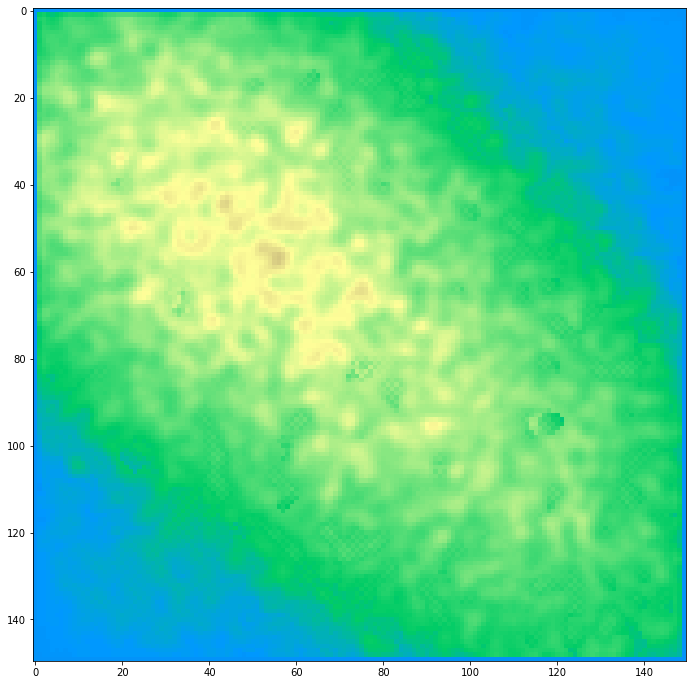

In [126]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
# plt.axis("off")

anim = True
ims = []
i = 260
# for i in np.arange(131):
# tmp = all_rock[i] + all_gravel[i]
tmp = all_gravel[i]
# tmp = all_gravel[i]
im1 = ax.imshow(tmp, cmap=plt.cm.terrain, vmin=-1000, vmax=6000, animated=anim)    
# im1 = ax.imshow(tmp, cmap=plt.cm.terrain, vmin=0, vmax=10, animated=anim)    

# alphas = all_ice[i] / 10
# alphas[alphas > 1] = 1
# im2 = ax.imshow(all_ice[i], cmap=plt.cm.bone, vmin=0, vmax=20, alpha=alphas, animated=anim)

# alphas = all_waters[i] / 10
# alphas[alphas > 1] = 1
# im3 = ax.imshow(all_waters[i], cmap=plt.cm.Blues, vmin=-100, vmax=40, alpha=alphas, animated=anim)

#     ims.append((im1, im2, im3))

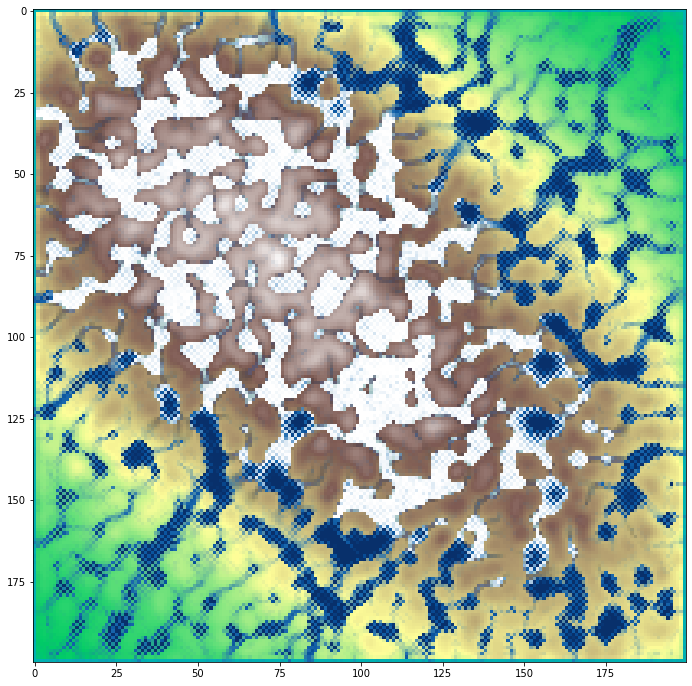

In [20]:
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111)
# plt.axis("off")
anim = True
ims = []
for i in np.arange(len(all_rock)):
    tmp = all_rock[i] + all_gravel[i]
    im1 = ax.imshow(tmp, cmap=plt.cm.terrain, vmin=-1000, vmax=4000, animated=anim)    

    alphas = all_ice[i] / 10
    alphas[alphas > 1] = 1
    im2 = ax.imshow(all_ice[i], cmap=plt.cm.bone, vmin=0, vmax=20, alpha=alphas, animated=anim)

    alphas = all_waters[i] / 10
    alphas[alphas > 1] = 1
    im3 = ax.imshow(all_waters[i], cmap=plt.cm.Blues, vmin=-100, vmax=40, alpha=alphas, animated=anim)
    ims.append((im1, im2, im3))

ani = animation.ArtistAnimation(fig, ims, interval=200, repeat_delay=200, blit=True)

HTML(ani.to_jshtml())

ani.save('animation_v6.gif', writer='imagemagick', fps=10)

In [89]:
ani